In [1]:
import numpy as np
import pandas as pd
import torch
import os
import time 
import copy
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
sns.set(font_scale=1)

from skbio import TreeNode
from SimulationResult import SimulationResult

/Users/sitarapersad/opt/anaconda3/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


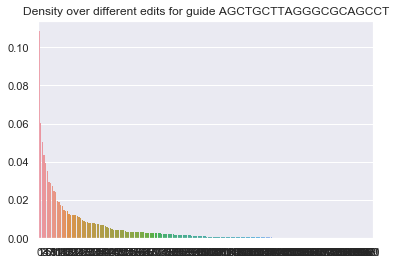

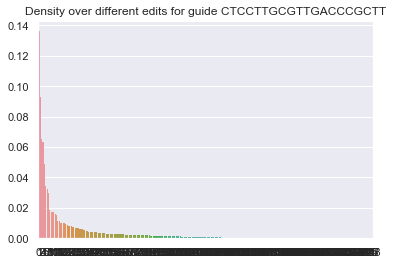

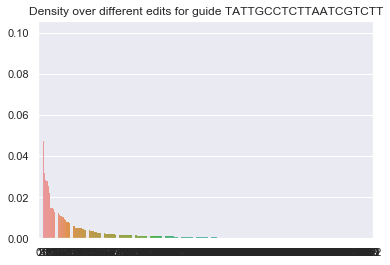

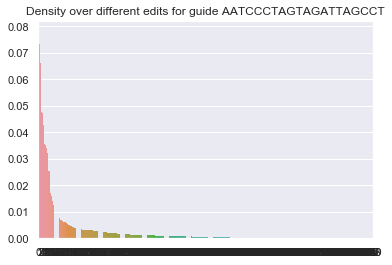

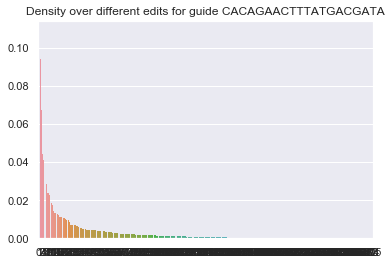

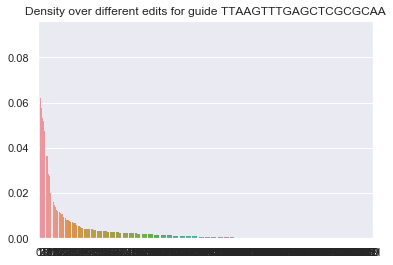

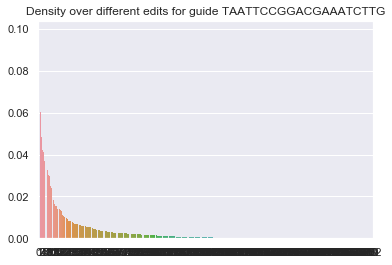

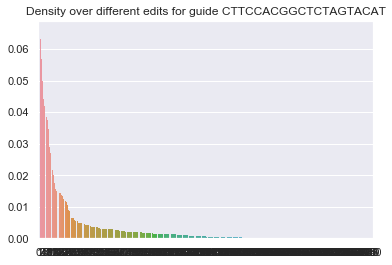

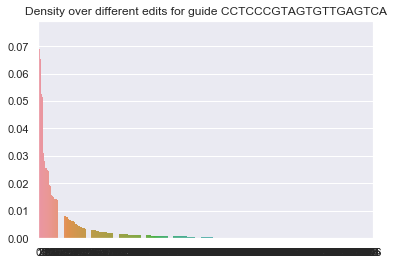

In [2]:
## How many cells does the real data end up with?
## Did this seed from one cell? 

import pickle
with open('d21_indel_distributions.p', 'rb') as f:
    indel_distributions = pickle.load(f)

slow_guides = ['AGCTGCTTAGGGCGCAGCCT', 'CTCCTTGCGTTGACCCGCTT', 'TATTGCCTCTTAATCGTCTT']
medium_guides = ['AATCCCTAGTAGATTAGCCT', 'CACAGAACTTTATGACGATA', 'TTAAGTTTGAGCTCGCGCAA']
fast_guides = ['TAATTCCGGACGAAATCTTG', 'CTTCCACGGCTCTAGTACAT', 'CCTCCCGTAGTGTTGAGTCA']

for li in [slow_guides, medium_guides, fast_guides]:
    for guide in li:
        dist = indel_distributions[guide]
        try:
            del dist['']
        except KeyError:
            pass
        distvals = np.array(sorted(list(dist.values()), reverse=True))
        distvals = distvals/distvals.sum()
        plt.figure()
        sns.barplot(np.arange(len(distvals)), distvals, linewidth=0)
        plt.title('Density over different edits for guide {0}'.format(guide))
        plt.show()
        plt.close()

# Estimate the mutation probability

# For a given site E_i[%] = E_{i-1}[%] + p(1-E_{i-1}[%])
# E_i = 1-q^i, where q = 1-p 
# Sanity check: 
# E_0 = 1-(1-p)^0 = 0 
# E_1 = 1-(1-p) = p 

# We can choose to use a combination of varying speed guides 

# 4, 7, 14, 21 days -> 4 generations, 7 generations etc (24 hrs for cell cycle?)

# How many generations does 1 day correspond to?
# Slow guides:
slow = [0.09, 0.15, 0.29, 0.4]

# Medium guides
medium = [0.15, 0.35, 0.6, 0.75]

# Fast guides
fast = [0.75, 0.9, 0.95, 0.96]




In [3]:
gens = [4,7,14,21]
print('\nSlow')
p_avg = 0
for i, x in enumerate(slow):
    G = 1/gens[i]
    p = 1 - (1-x)**G
    p_avg += p
    print(p)
print("Avg")
print(p_avg/4)

print('\nMedium')
p_avg = 0
for i, x in enumerate(medium):
    G = 1/gens[i]
    p = 1 - (1-x)**G
    p_avg += p
    print(p)
print("Avg")
print(p_avg/4)

print('\nFast')
p_avg = 0
for i, x in enumerate(fast):
    G = 1/gens[i]
    p = 1 - (1-x)**G
    p_avg += p
    print(p)
print("Avg")
print(p_avg/4)    

""" 
Questions
1. tree or forest
2. are the rates based on isolating a clone or from a forest
3. yosef lab was a single tree?? no

try this instead: 
start with many roots (a forest)

reproduction rate varying / same ?vfr 

"""


Slow
0.02330188829047808
0.02294954933760507
0.02416678505263603
0.024031560532588148
Avg
0.02361244580332683

Medium
0.03981541059581217
0.05968505934696777
0.06335350204906998
0.0638822575463951
Avg
0.056684057384561254

Fast
0.2928932188134524
0.28031432699884795
0.19263617565013524
0.14211035031316765
Avg
0.22698851794390082


' \nQuestions\n1. tree or forest\n2. are the rates based on isolating a clone or from a forest\n3. yosef lab was a single tree?? no\n\ntry this instead: \nstart with many roots (a forest)\n\nreproduction rate varying / same ?vfr \n\n'

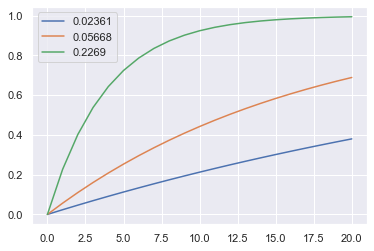

In [4]:
plt.figure()
for p in [0.02361, 0.05668, 0.2269]:
    q = 1-p
    plt.plot(np.arange(21), 1-q**np.arange(21), label=p)
plt.legend()
plt.show()
plt.close()

rate = {}
rate['slow'] = 0.02361
rate['medium'] = 0.05668
rate['fast'] = 0.2269

## Perform a lineage tracing experiment 

In [5]:
from crispr_lib import lineageSimulation, lineageSimulationFast

In [6]:
slow_guides = ['AGCTGCTTAGGGCGCAGCCT', 'CTCCTTGCGTTGACCCGCTT', 'TATTGCCTCTTAATCGTCTT']
medium_guides = ['AATCCCTAGTAGATTAGCCT', 'CACAGAACTTTATGACGATA', 'TTAAGTTTGAGCTCGCGCAA']
fast_guides = ['TAATTCCGGACGAAATCTTG', 'CTTCCACGGCTCTAGTACAT', 'CCTCCCGTAGTGTTGAGTCA']

ssm = ['AGCTGCTTAGGGCGCAGCCT', 'CTCCTTGCGTTGACCCGCTT','AATCCCTAGTAGATTAGCCT']
smm = ['AGCTGCTTAGGGCGCAGCCT', 'AATCCCTAGTAGATTAGCCT', 'CACAGAACTTTATGACGATA']
ssf = ['AGCTGCTTAGGGCGCAGCCT', 'CTCCTTGCGTTGACCCGCTT', 'CCTCCCGTAGTGTTGAGTCA']
smf = ['AGCTGCTTAGGGCGCAGCCT', 'AATCCCTAGTAGATTAGCCT', 'CCTCCCGTAGTGTTGAGTCA']
sff = ['AGCTGCTTAGGGCGCAGCCT', 'CTTCCACGGCTCTAGTACAT', 'CCTCCCGTAGTGTTGAGTCA']
mmf = ['AATCCCTAGTAGATTAGCCT', 'CACAGAACTTTATGACGATA', 'TAATTCCGGACGAAATCTTG']
mff = ['AATCCCTAGTAGATTAGCCT', 'TAATTCCGGACGAAATCTTG', 'CTTCCACGGCTCTAGTACAT']


results = {'Guides':[], 'Num_Distinct_Edits':[], 
           'Min_depths':[], 'Num_Mutations':[],
           'Recurring_Characters':[],  
           'Recurring_Characters_%':[],
           'Recurring_Mutations' : [],
           'Recurring_Mutations_%': []
          }

subsampled_results = {'Guides':[], 'Total_Mutations':[], 'Distinct_Mutations':[], 'Recurring_Mutations':[], 'Recurring_Mutations_%':[], 'Unique_Cells': [] }

timers = {}

lists_of_guides = [slow_guides, ssm, smm, ssf, smf, sff, medium_guides, mmf, mff, fast_guides]
labels = ['sss','ssm','smm','ssf','smf','sff', 'mmm', 'mmf','mff', 'fff']
verbose = False
tree_depth = 19
num_runs = 3
n_subsample = 10000
num_arrays = 10

debug = False
compute_tree = True

if debug:
    lists_of_guides = [smf]
    labels = ['smf']
    tree_depth = 20
    num_runs = 1
    n_subsample = 10000
    num_arrays = 10

Label: sss
List of targets:  [(0, 0), (0, 1), (0, 2), (1, 0), (1, 1), (1, 2), (2, 0), (2, 1), (2, 2), (3, 0), (3, 1), (3, 2), (4, 0), (4, 1), (4, 2), (5, 0), (5, 1), (5, 2), (6, 0), (6, 1), (6, 2), (7, 0), (7, 1), (7, 2), (8, 0), (8, 1), (8, 2), (9, 0), (9, 1), (9, 2)]
ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(253,)
(445,)
(633,)
(793,)
(887,)
(942,)
(969,)
(982,)
(991,)
(996,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


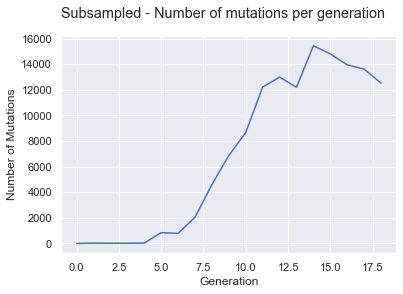

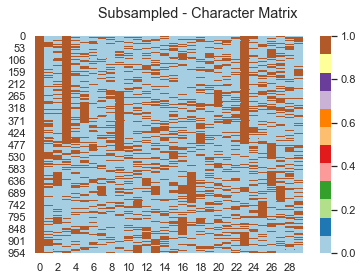

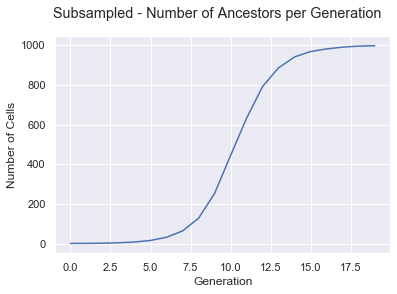

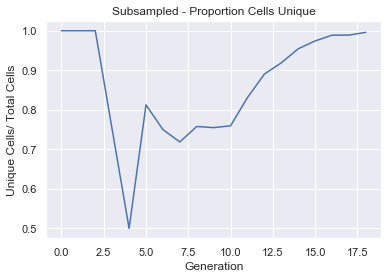

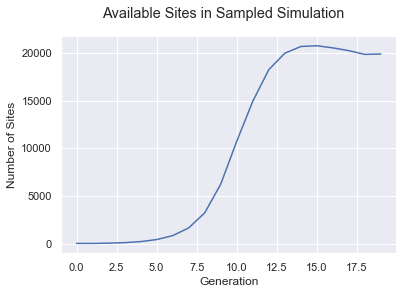

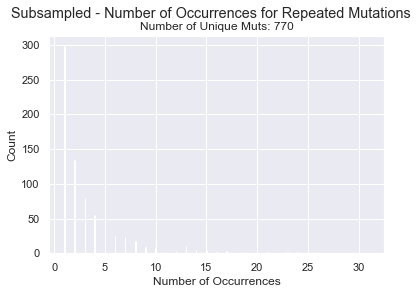

(998, 30)
Time 1: 0.018732786178588867
Compute dictionary: 26.551992893218994
Conflict matrix is symmetric?  True
Total time: 26.590006113052368
Number of true recurrent muts:  738
Number of detected recurrent muts:  920
Number of true recurrent muts not detected: 0 with prevalence []


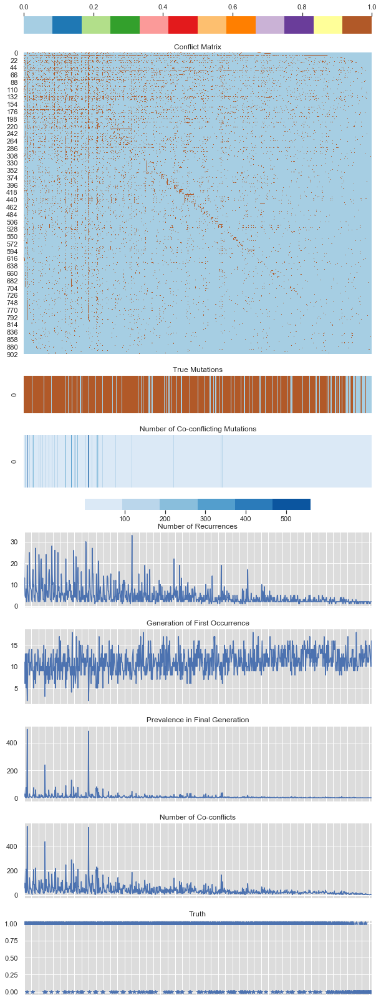

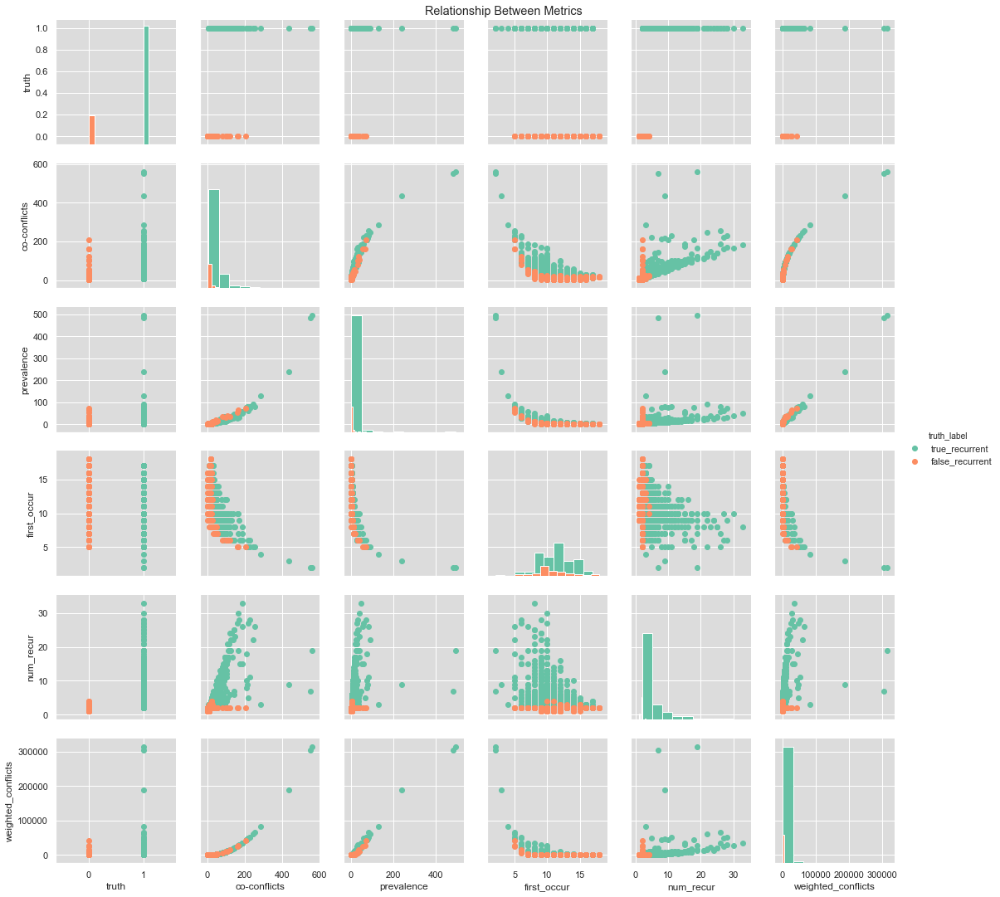

0.2102057933807373 fast?


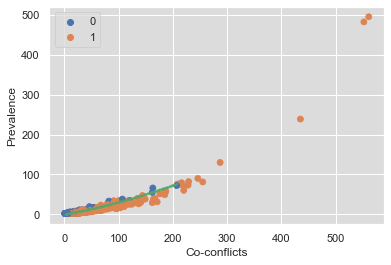

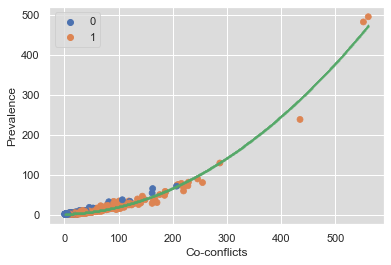

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(253,)
(449,)
(652,)
(814,)
(900,)
(950,)
(965,)
(984,)
(991,)
(999,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


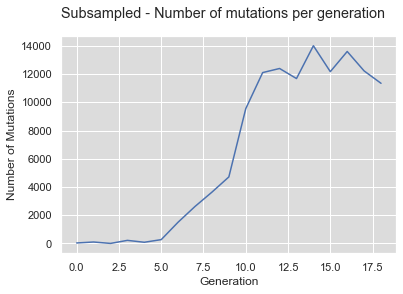

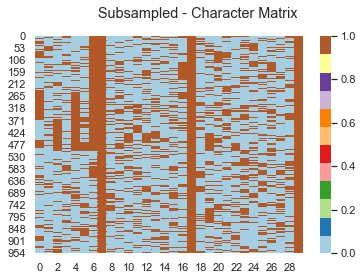

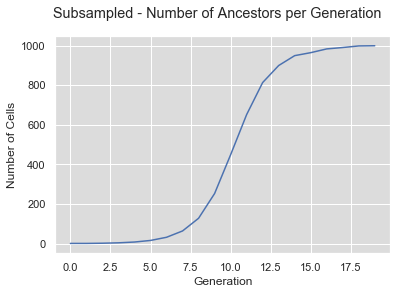

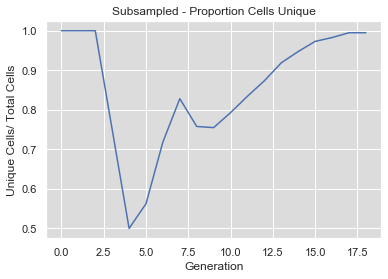

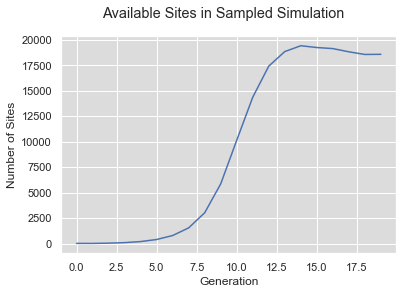

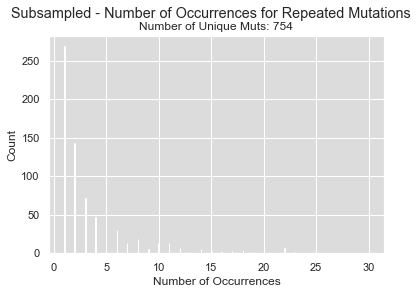

(1000, 30)
Time 1: 0.01906275749206543
Compute dictionary: 30.77716565132141
Conflict matrix is symmetric?  True
Total time: 30.798252820968628
Number of true recurrent muts:  686
Number of detected recurrent muts:  866
Number of true recurrent muts not detected: 1 with prevalence [1000]


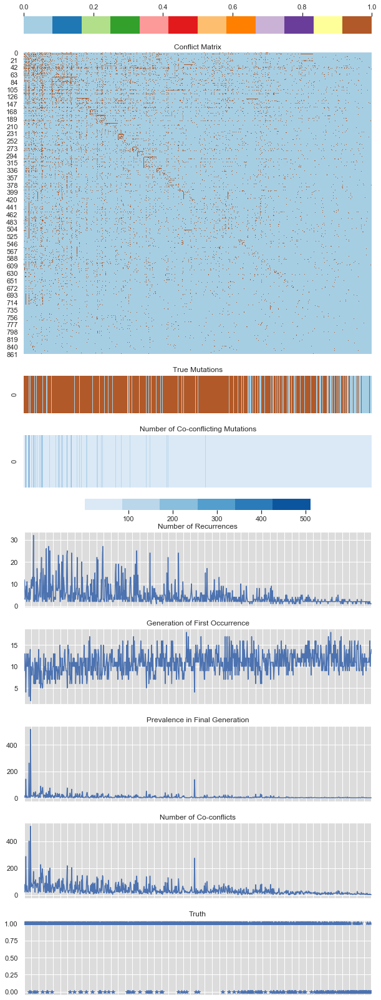

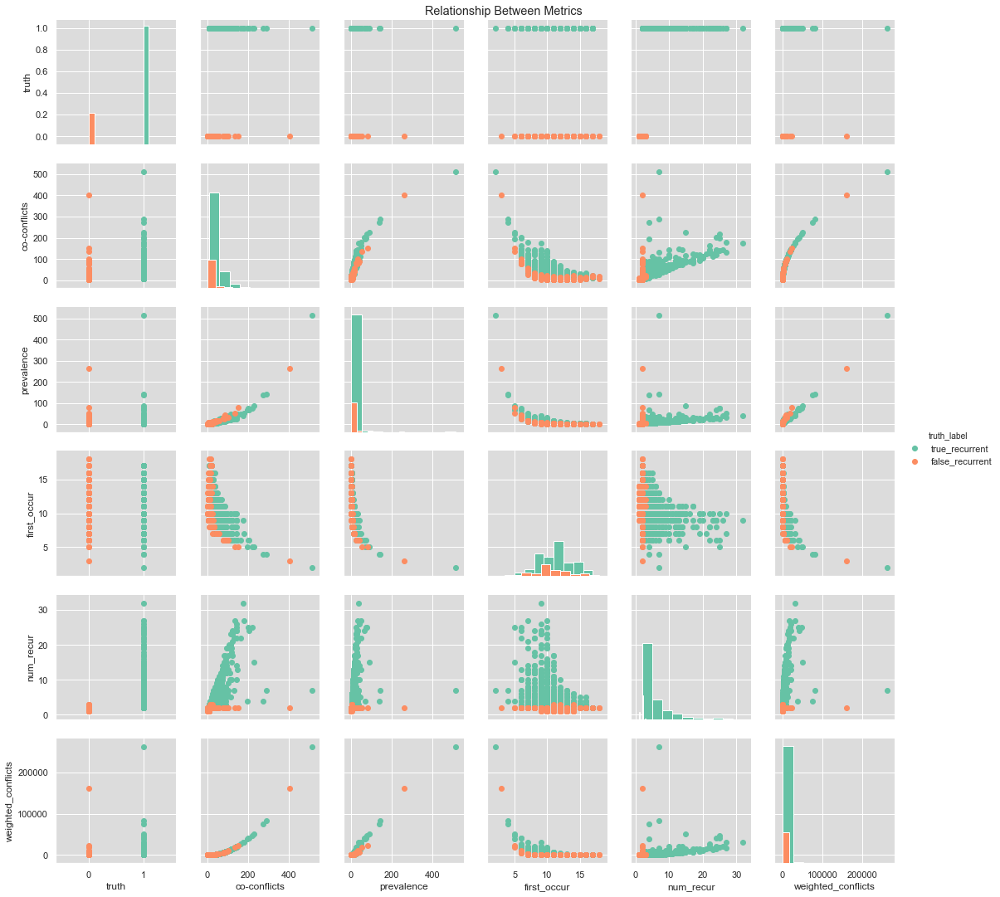

0.09481310844421387 fast?


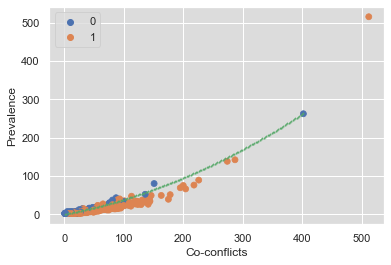

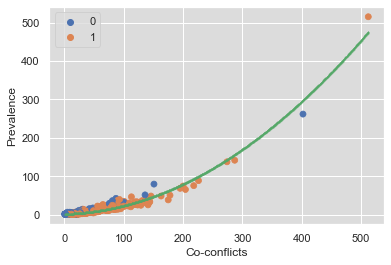

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(253,)
(439,)
(637,)
(787,)
(892,)
(941,)
(972,)
(988,)
(994,)
(998,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


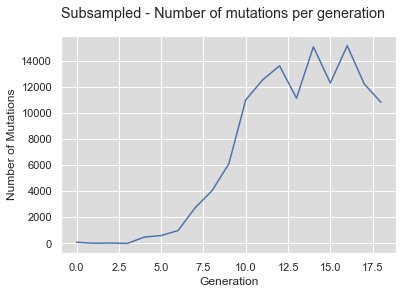

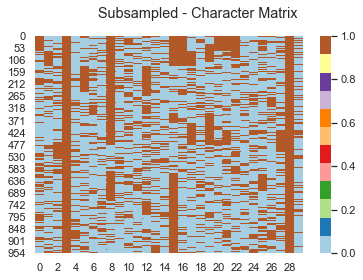

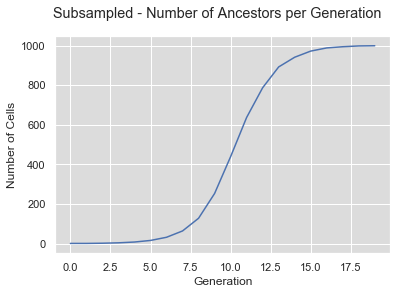

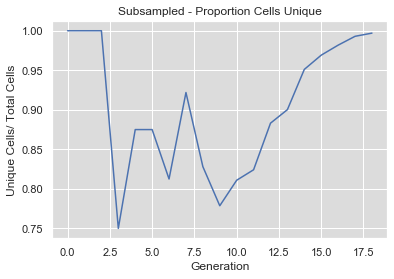

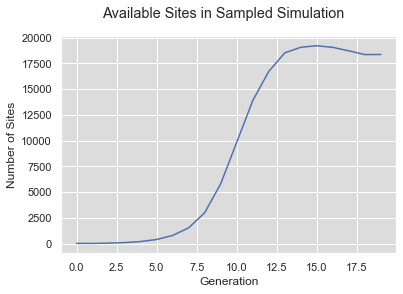

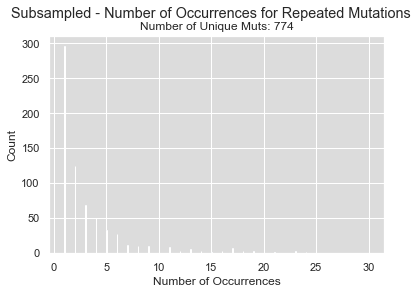

(999, 30)
Time 1: 0.017152070999145508
Compute dictionary: 26.652148008346558
Conflict matrix is symmetric?  True
Total time: 26.675924062728882
Number of true recurrent muts:  696
Number of detected recurrent muts:  886
Number of true recurrent muts not detected: 1 with prevalence [999]


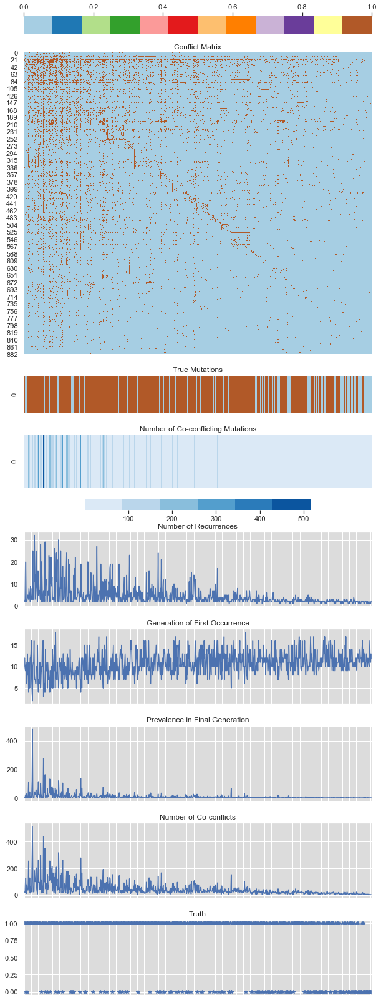

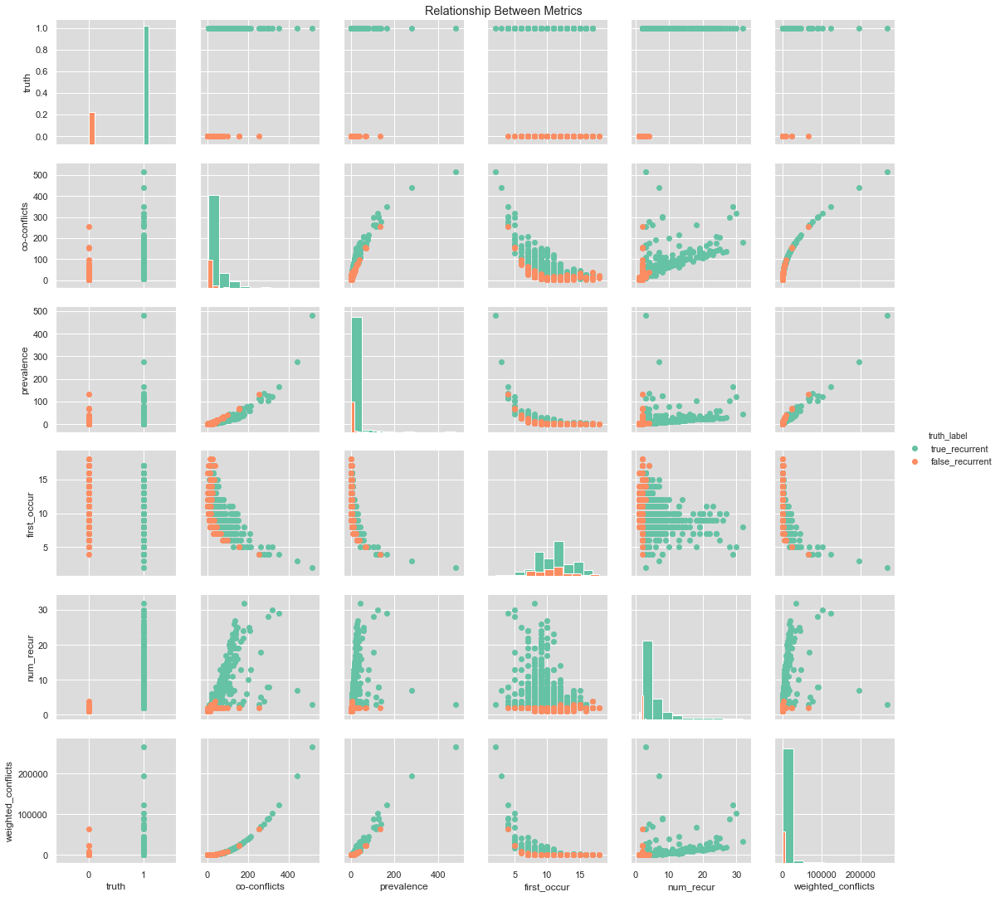

0.08722519874572754 fast?


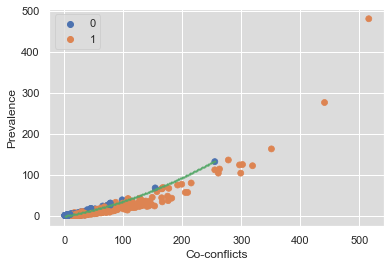

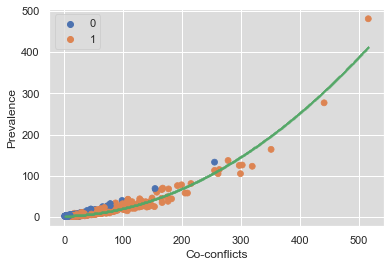

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(253,)
(439,)
(641,)
(783,)
(886,)
(942,)
(970,)
(981,)
(990,)
(997,)
(997,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


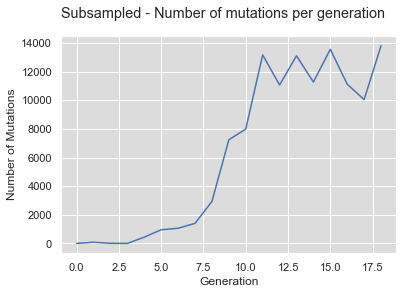

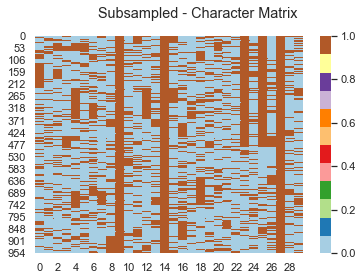

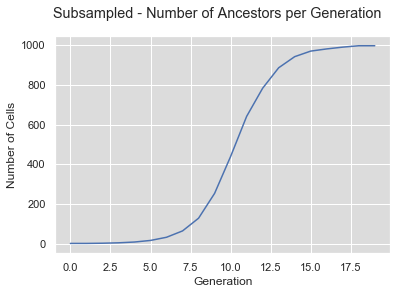

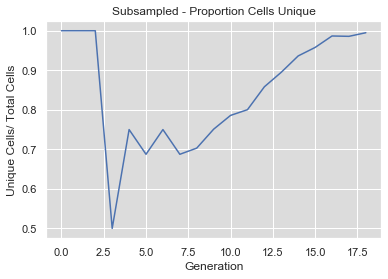

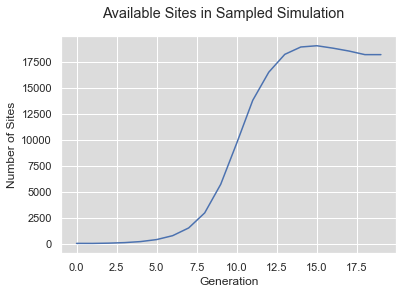

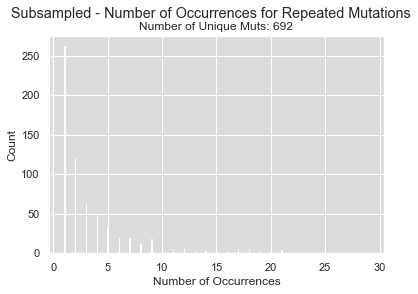

(997, 30)
Time 1: 0.015841960906982422
Compute dictionary: 28.584584951400757
Conflict matrix is symmetric?  True
Total time: 28.608646154403687
Number of true recurrent muts:  656
Number of detected recurrent muts:  859
Number of true recurrent muts not detected: 0 with prevalence []


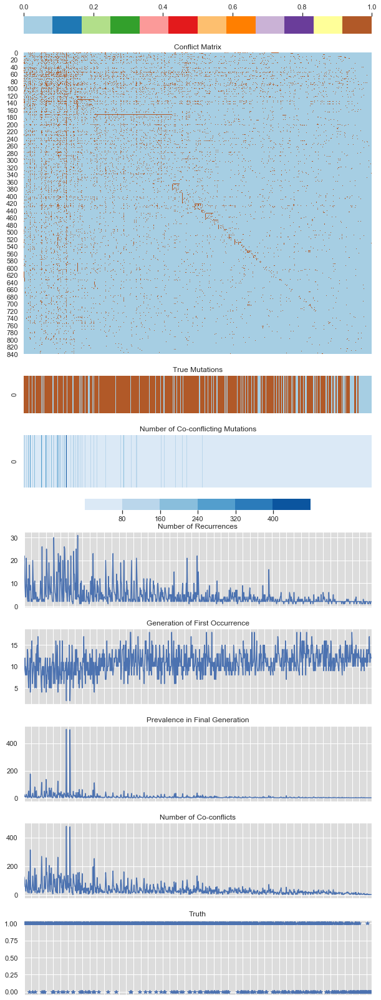

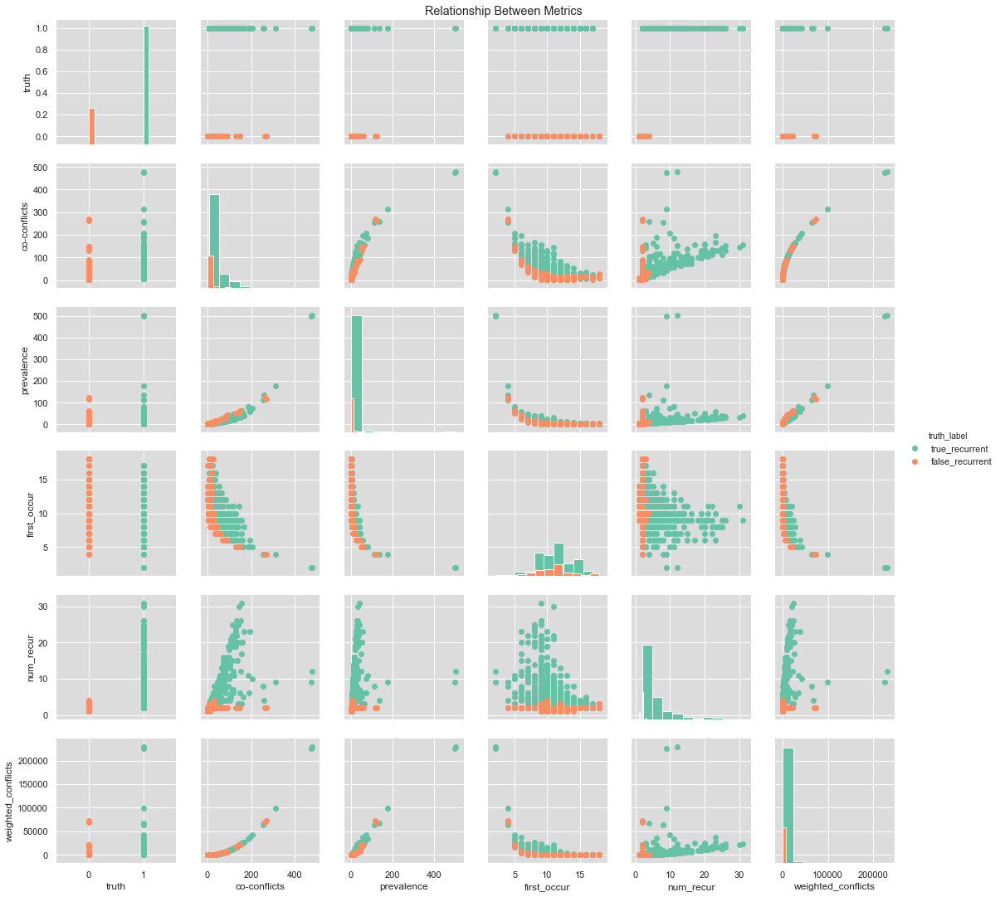

0.0884091854095459 fast?


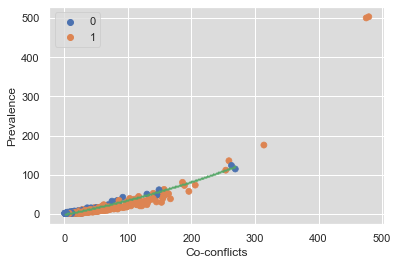

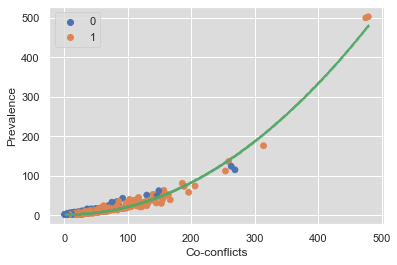

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(255,)
(452,)
(654,)
(796,)
(896,)
(959,)
(981,)
(989,)
(993,)
(996,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


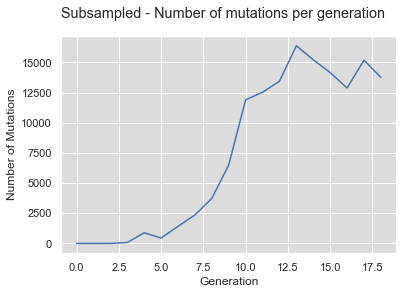

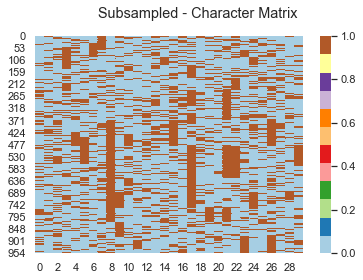

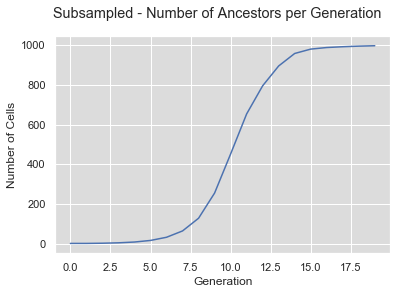

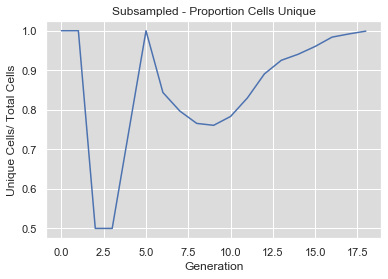

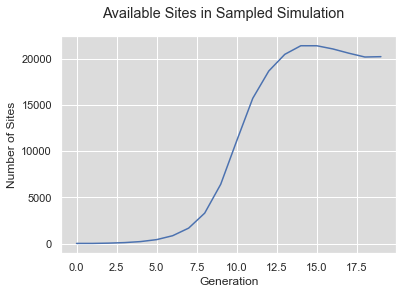

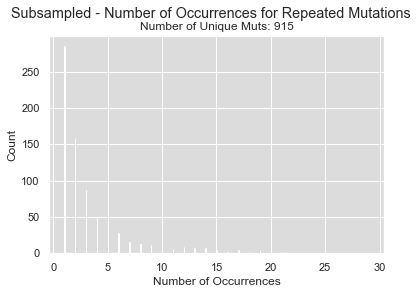

(998, 30)
Time 1: 0.020926237106323242
Compute dictionary: 31.14919424057007
Conflict matrix is symmetric?  True
Total time: 31.180588960647583
Number of true recurrent muts:  744
Number of detected recurrent muts:  936
Number of true recurrent muts not detected: 0 with prevalence []


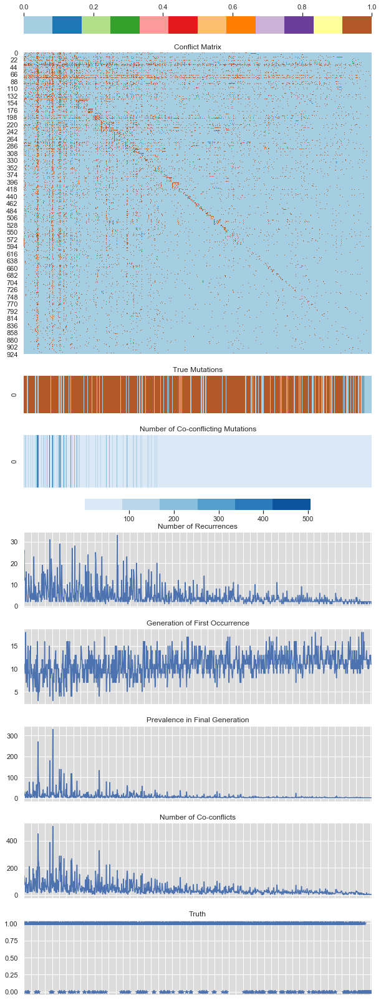

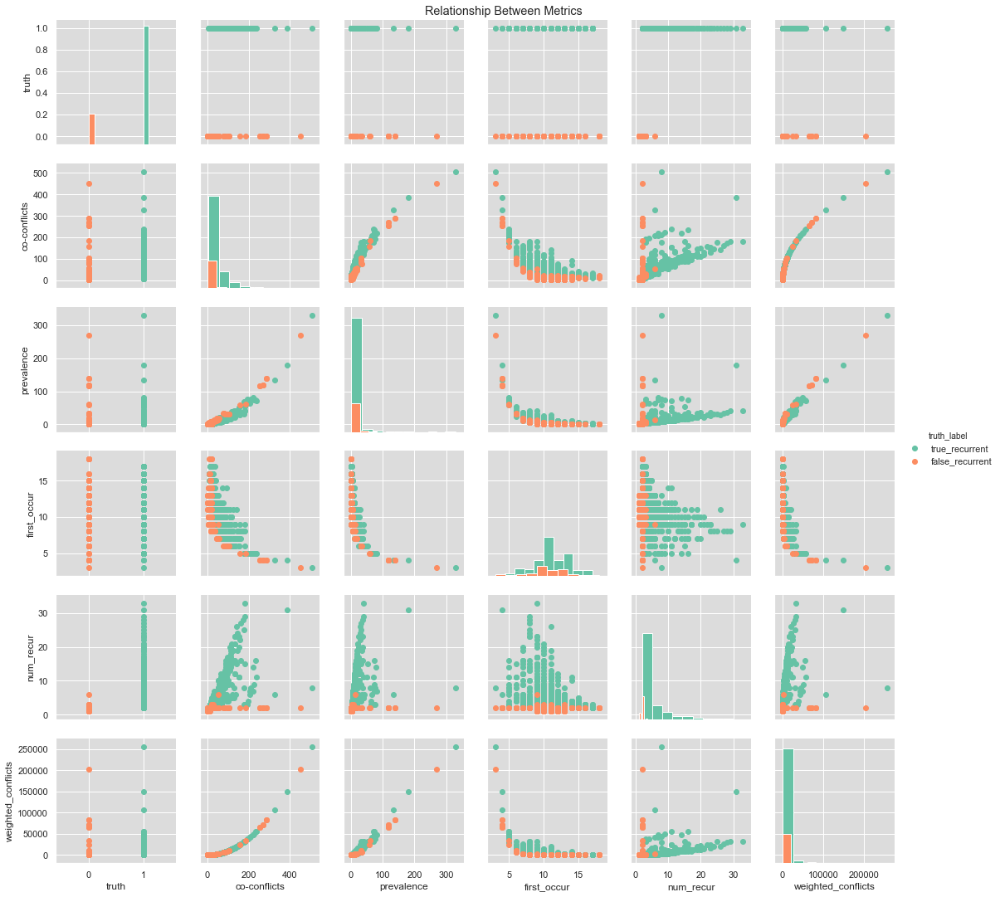

0.09876871109008789 fast?


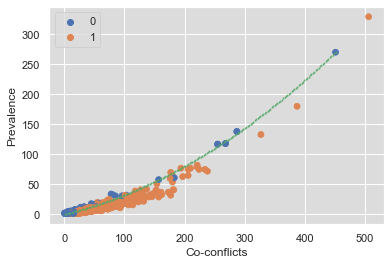

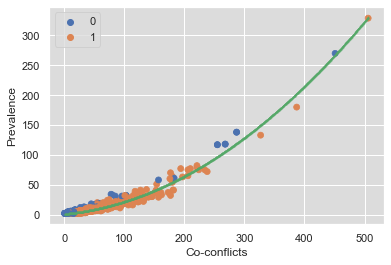

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(435,)
(657,)
(811,)
(905,)
(950,)
(982,)
(993,)
(996,)
(998,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


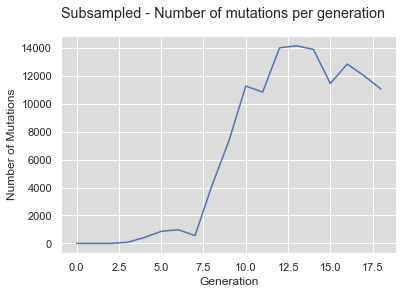

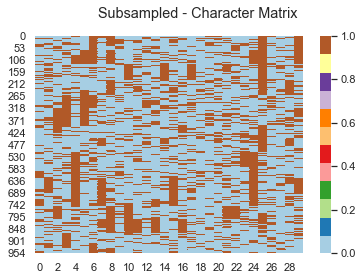

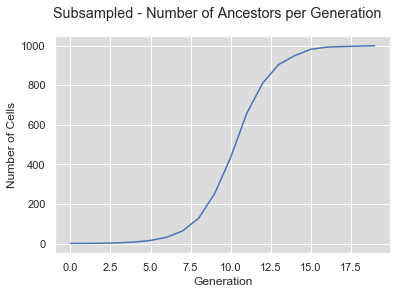

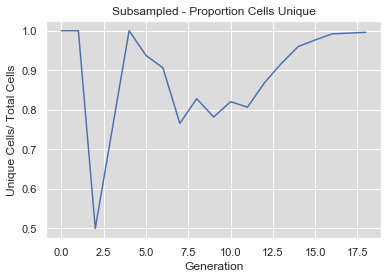

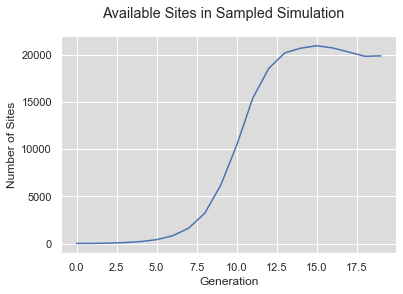

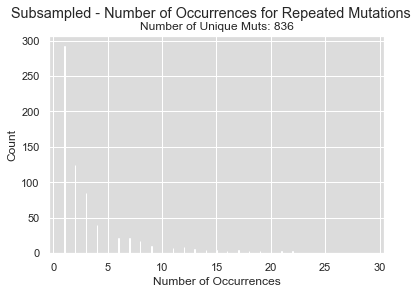

(1000, 30)
Time 1: 0.017580747604370117
Compute dictionary: 28.386404991149902
Conflict matrix is symmetric?  True
Total time: 28.412953853607178
Number of true recurrent muts:  711
Number of detected recurrent muts:  917
Number of true recurrent muts not detected: 0 with prevalence []


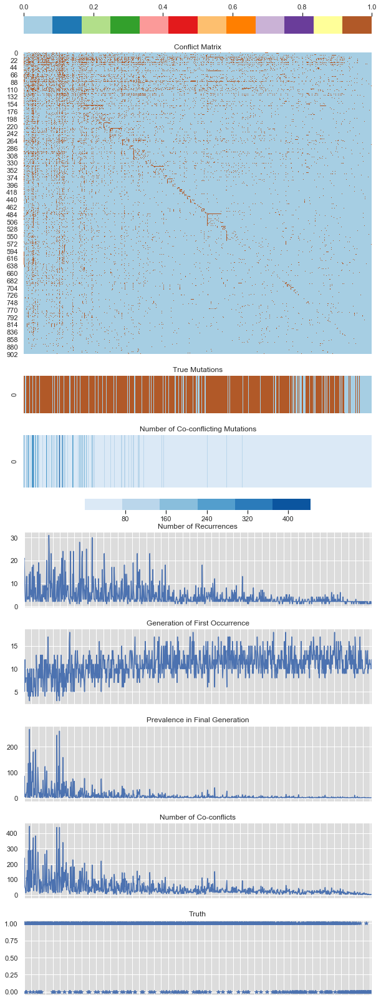

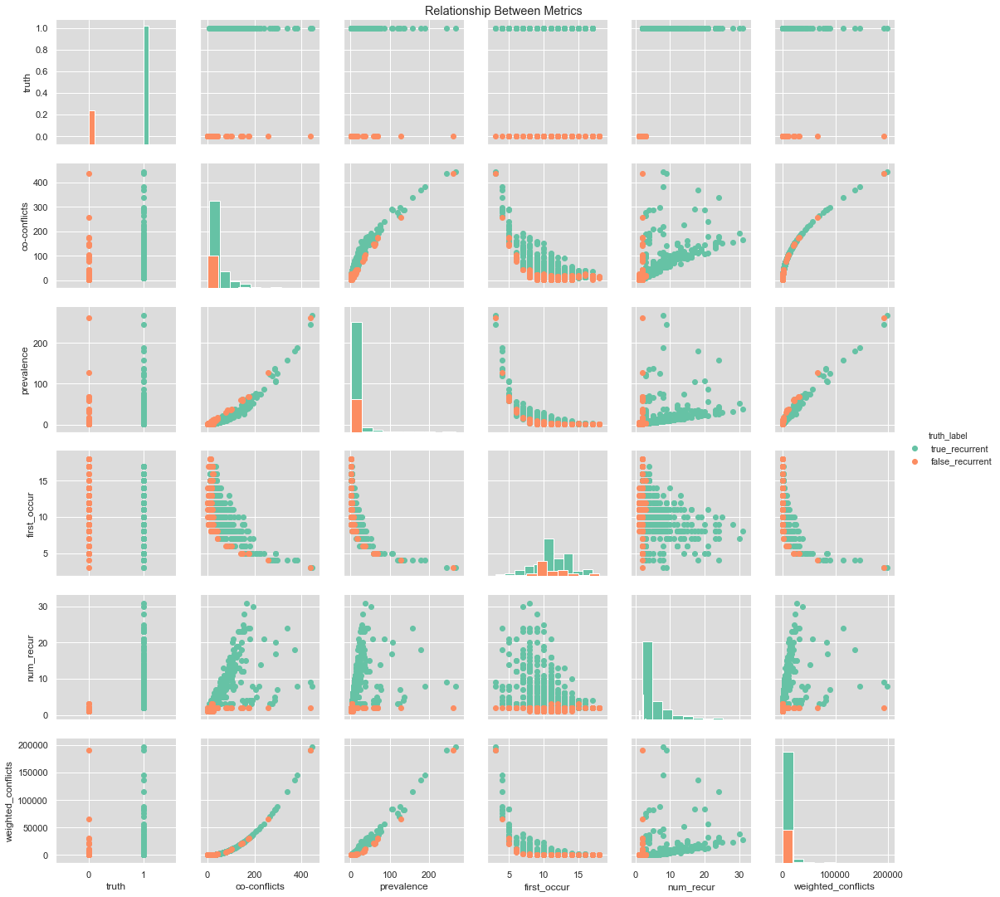

0.0873420238494873 fast?


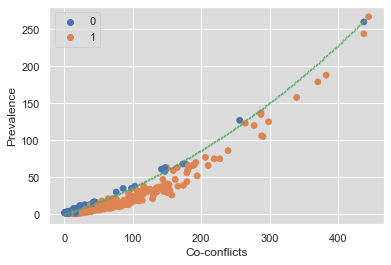

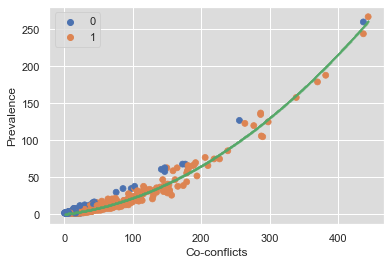

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(253,)
(450,)
(648,)
(789,)
(876,)
(934,)
(971,)
(984,)
(989,)
(996,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


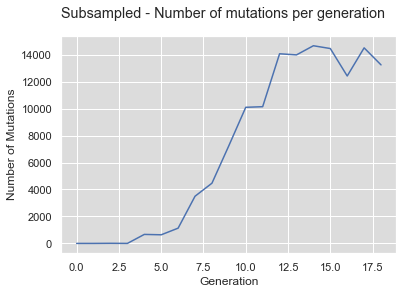

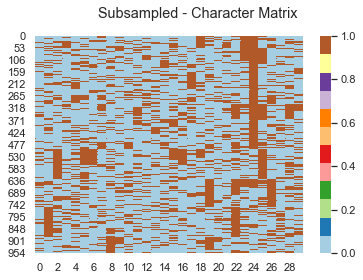

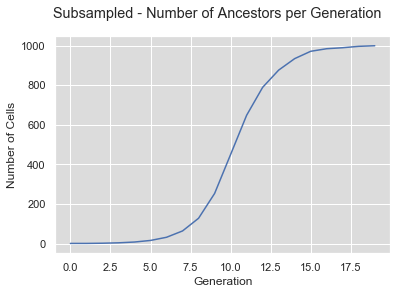

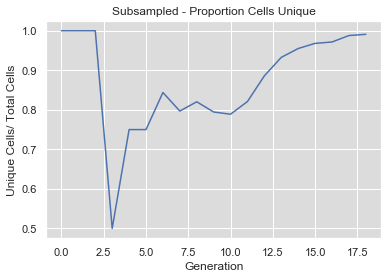

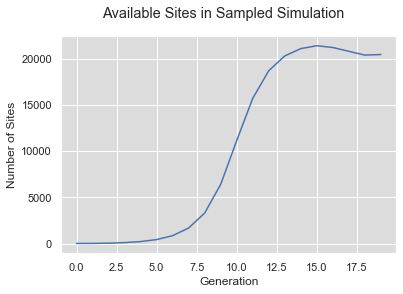

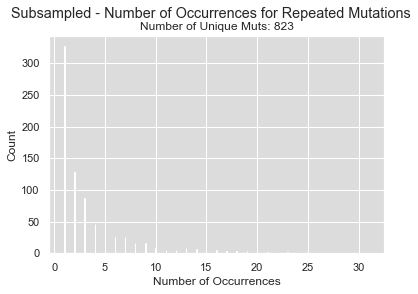

(999, 30)
Time 1: 0.019915103912353516
Compute dictionary: 33.00692629814148
Conflict matrix is symmetric?  True
Total time: 33.04084134101868
Number of true recurrent muts:  762
Number of detected recurrent muts:  971
Number of true recurrent muts not detected: 0 with prevalence []


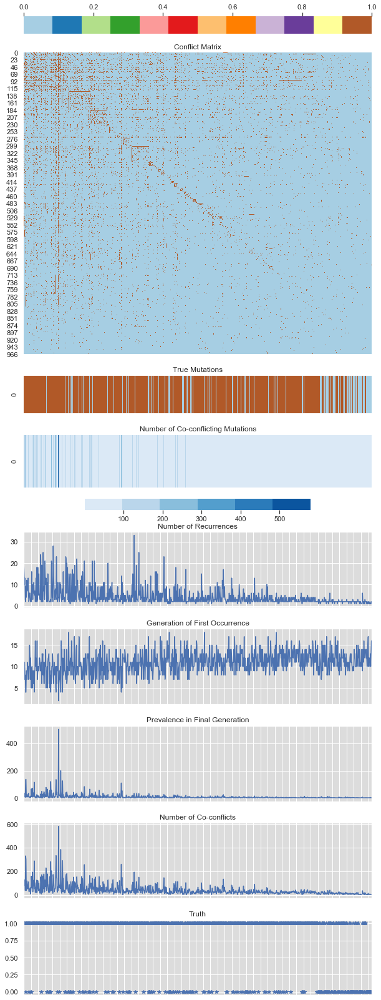

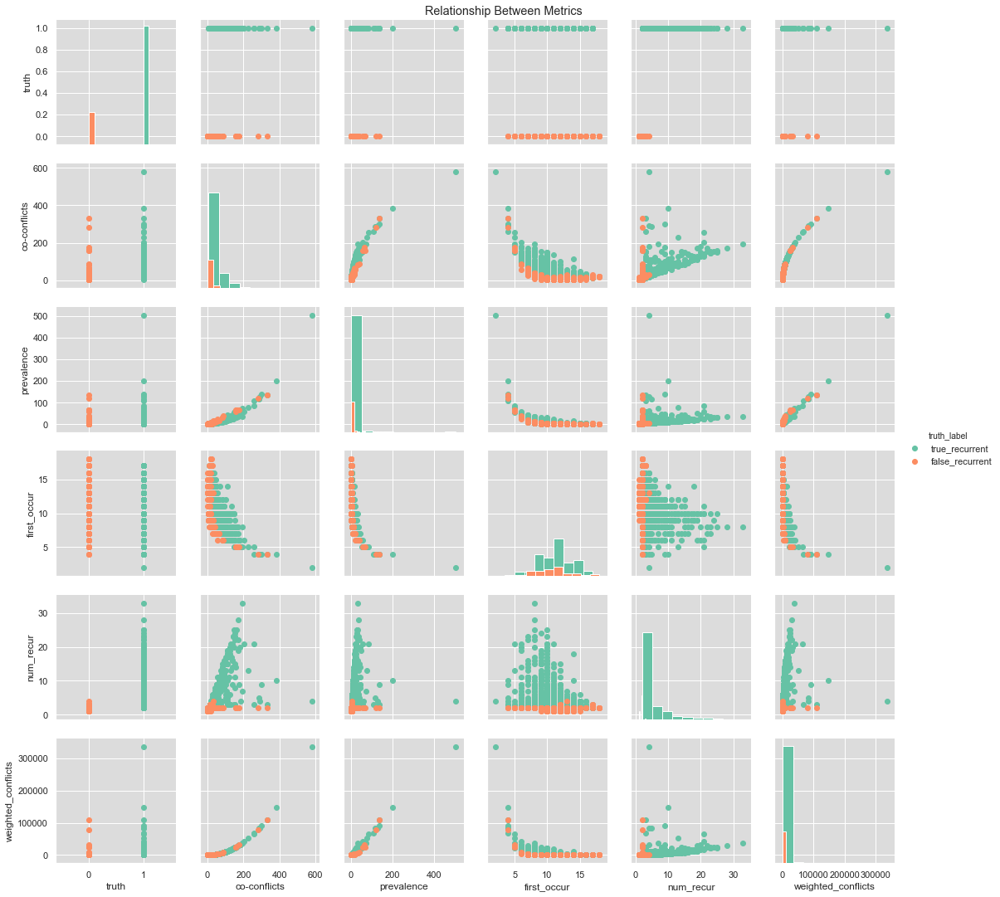

0.09476256370544434 fast?


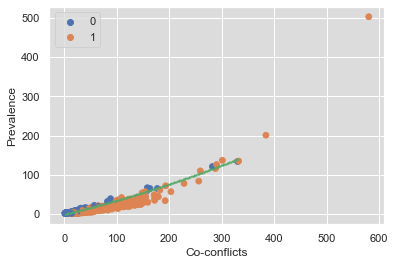

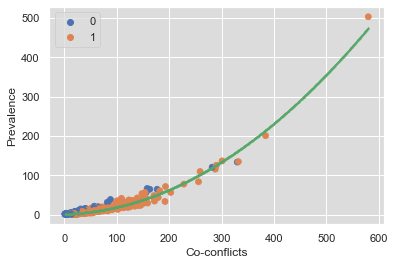

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(249,)
(438,)
(633,)
(780,)
(877,)
(934,)
(964,)
(982,)
(991,)
(996,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


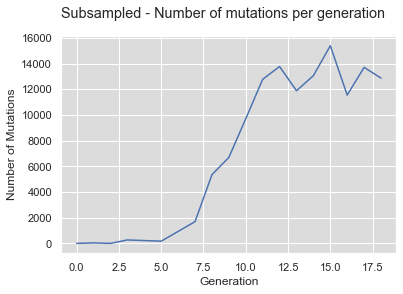

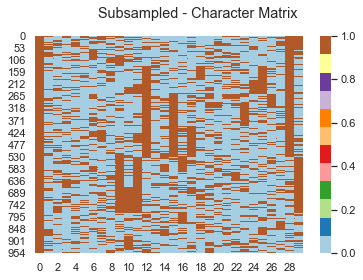

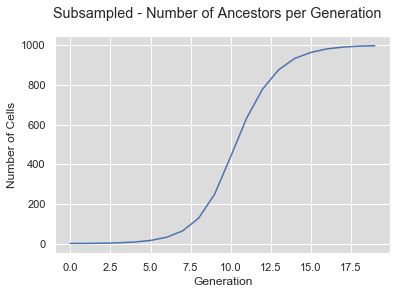

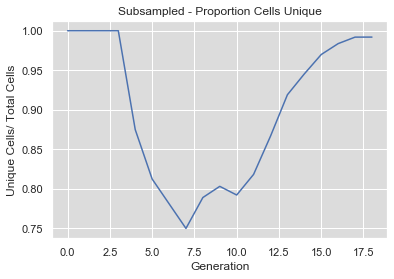

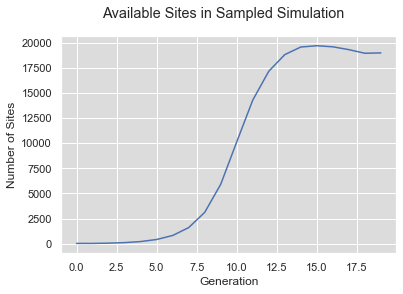

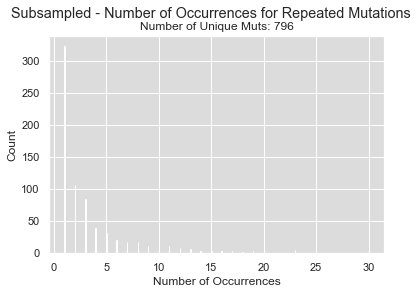

(998, 30)
Time 1: 0.018852949142456055
Compute dictionary: 29.8702290058136
Conflict matrix is symmetric?  True
Total time: 29.898473024368286
Number of true recurrent muts:  713
Number of detected recurrent muts:  910
Number of true recurrent muts not detected: 0 with prevalence []


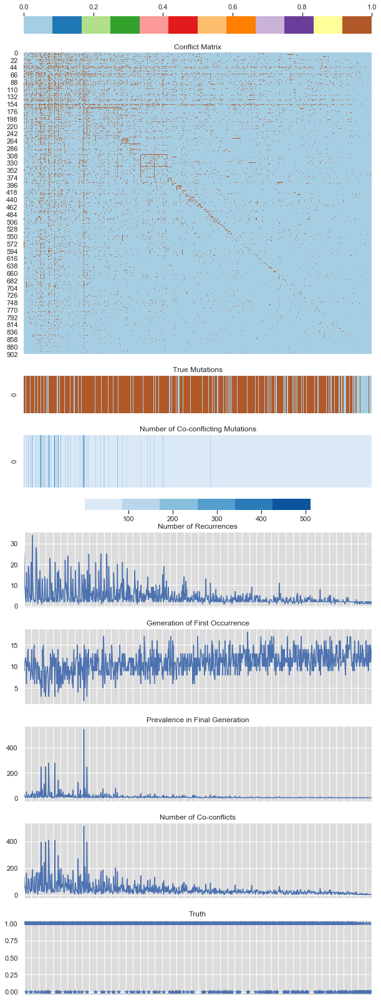

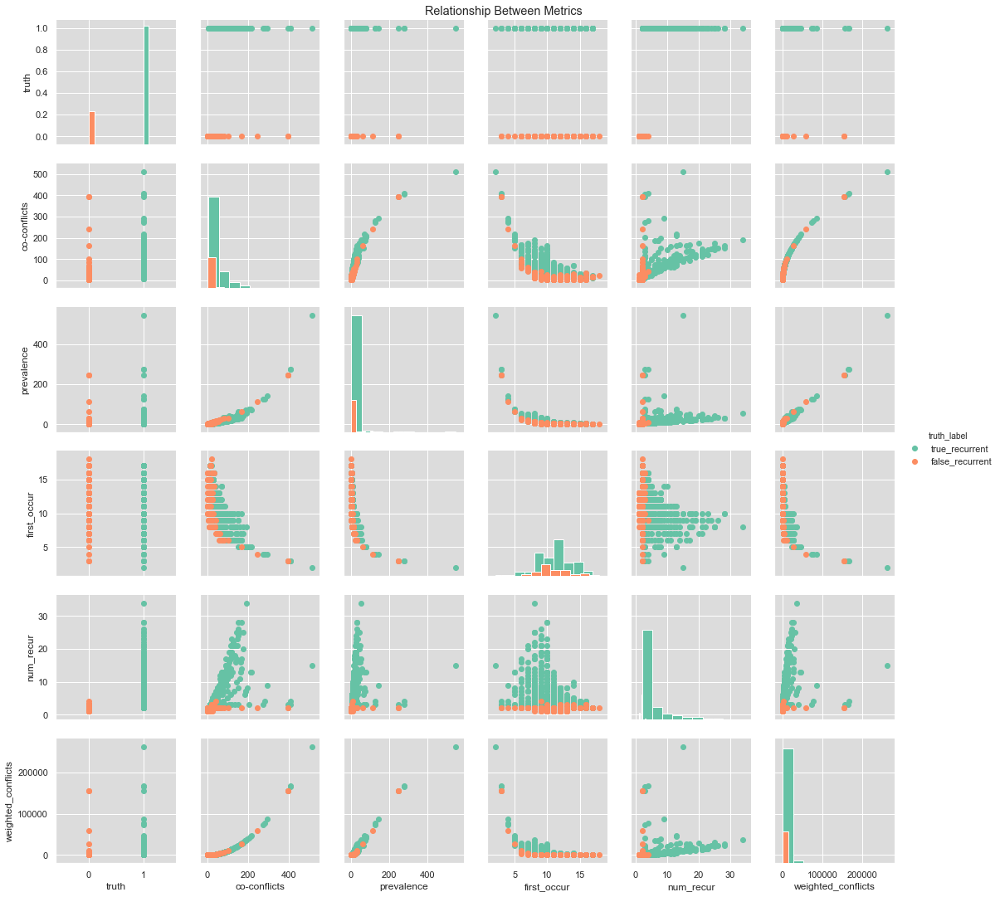

0.45941805839538574 fast?


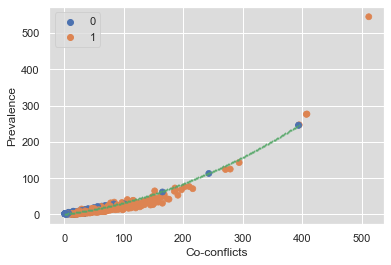

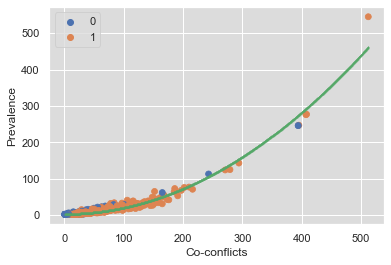

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(127,)
(247,)
(434,)
(625,)
(784,)
(881,)
(941,)
(973,)
(984,)
(996,)
(998,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


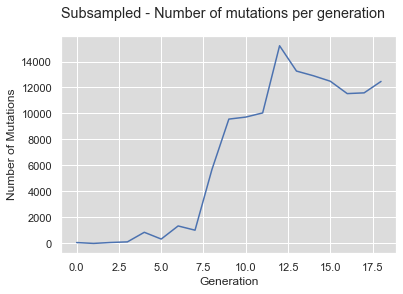

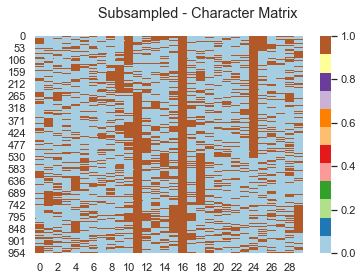

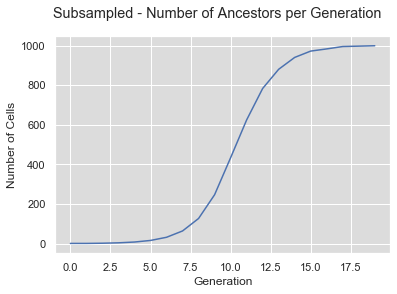

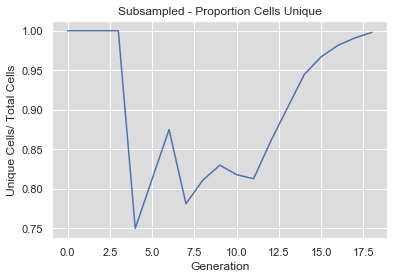

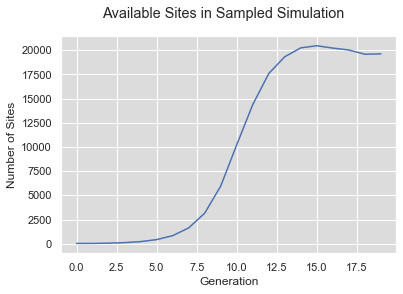

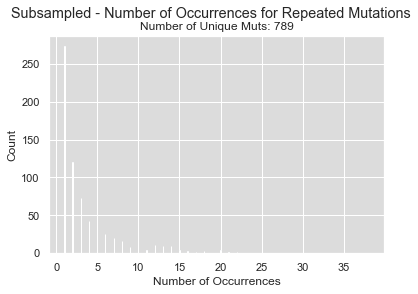

(1000, 30)
Time 1: 0.02006983757019043
Compute dictionary: 33.40150284767151
Conflict matrix is symmetric?  True
Total time: 33.427504777908325
Number of true recurrent muts:  673
Number of detected recurrent muts:  906
Number of true recurrent muts not detected: 1 with prevalence [1000]


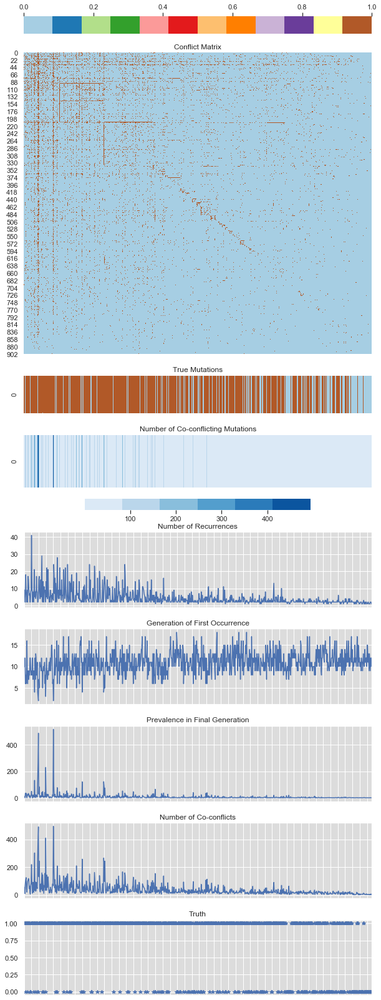

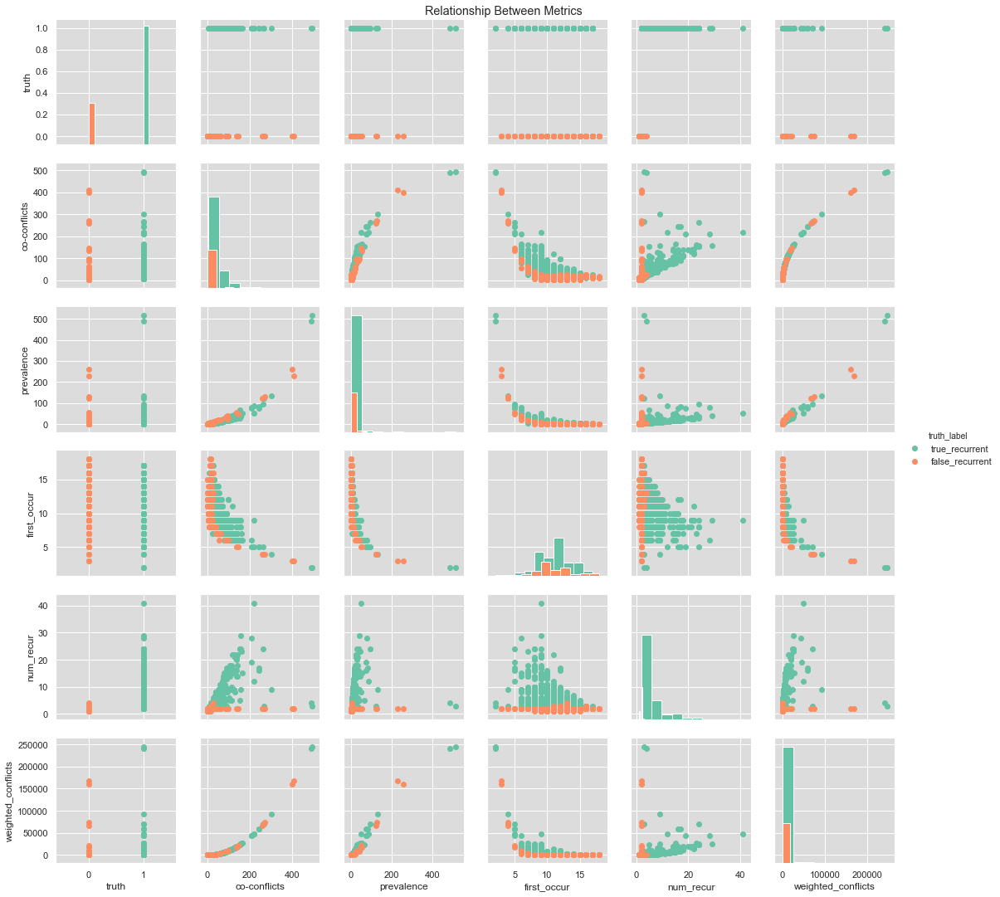

0.08771610260009766 fast?


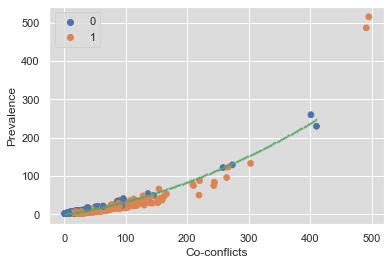

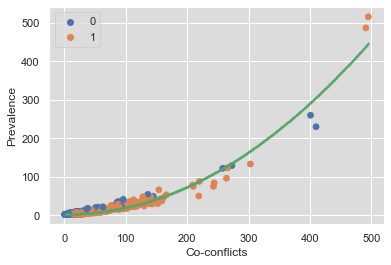

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(250,)
(430,)
(639,)
(792,)
(882,)
(932,)
(964,)
(987,)
(992,)
(996,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


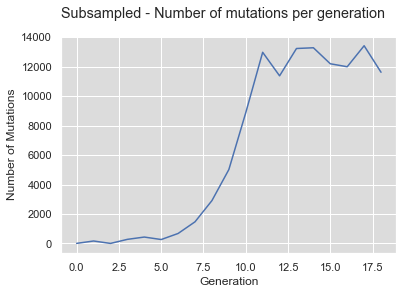

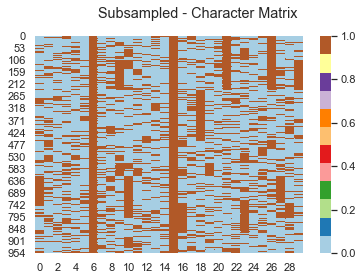

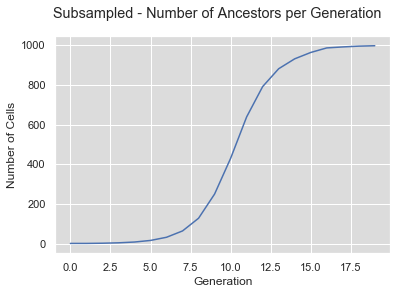

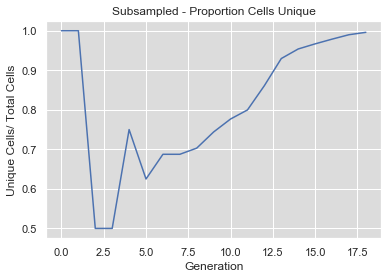

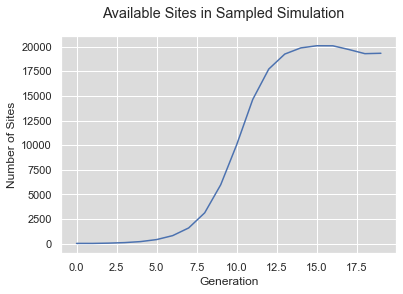

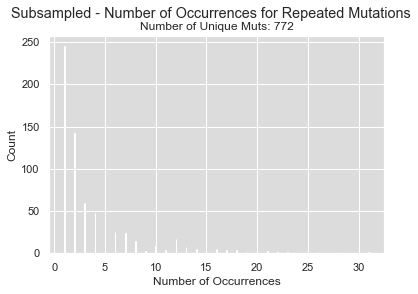

(998, 30)
Time 1: 0.015150785446166992
Compute dictionary: 29.364560842514038
Conflict matrix is symmetric?  True
Total time: 29.384150981903076
Number of true recurrent muts:  665
Number of detected recurrent muts:  871
Number of true recurrent muts not detected: 1 with prevalence [998]


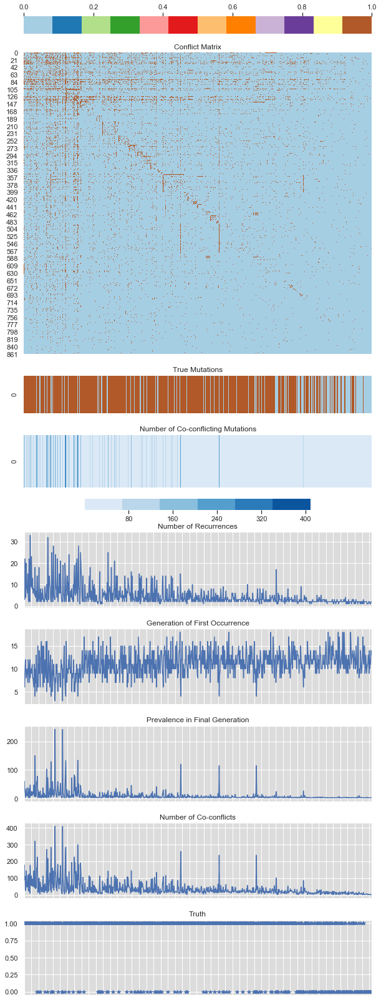

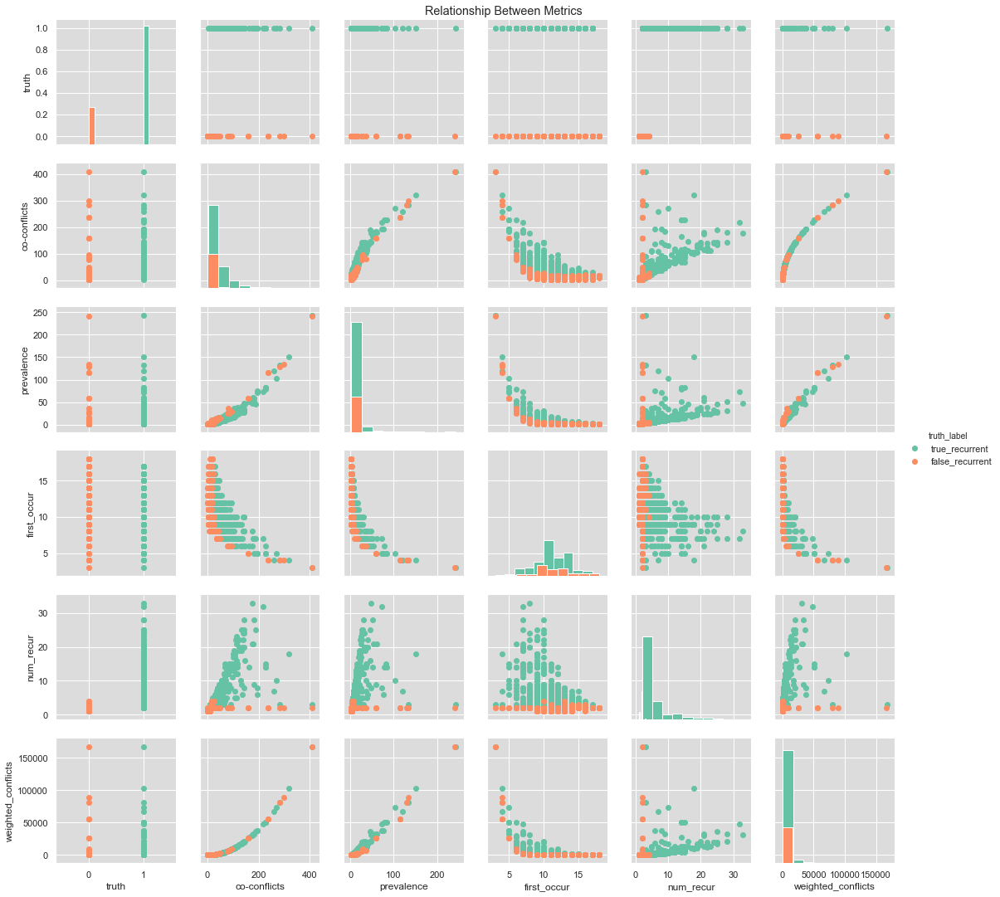

0.08694982528686523 fast?


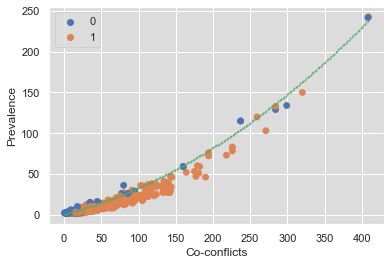

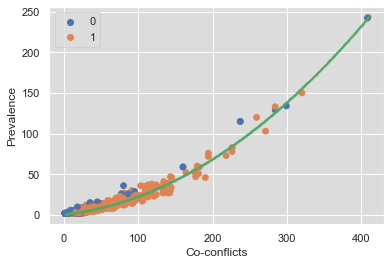

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(251,)
(451,)
(643,)
(789,)
(891,)
(945,)
(976,)
(985,)
(991,)
(995,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


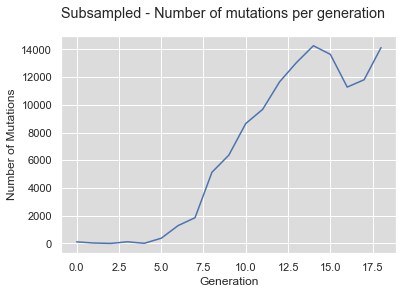

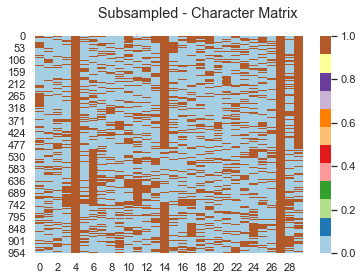

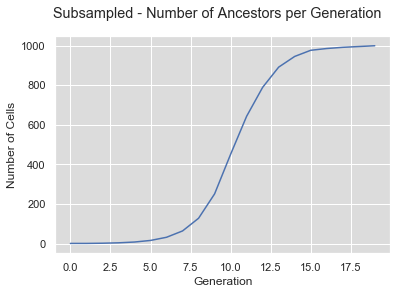

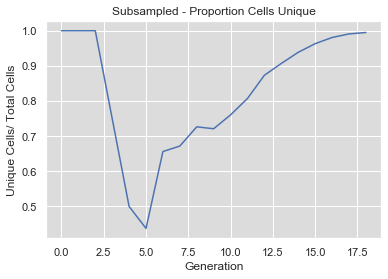

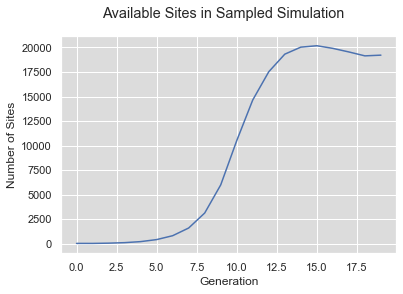

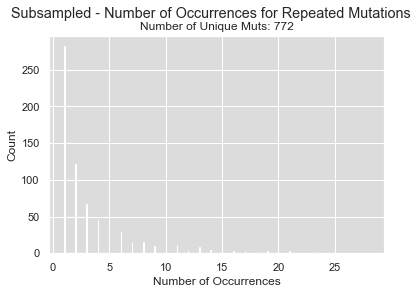

(999, 30)
Time 1: 0.015056133270263672
Compute dictionary: 27.42798686027527
Conflict matrix is symmetric?  True
Total time: 27.449219942092896
Number of true recurrent muts:  687
Number of detected recurrent muts:  894
Number of true recurrent muts not detected: 1 with prevalence [999]


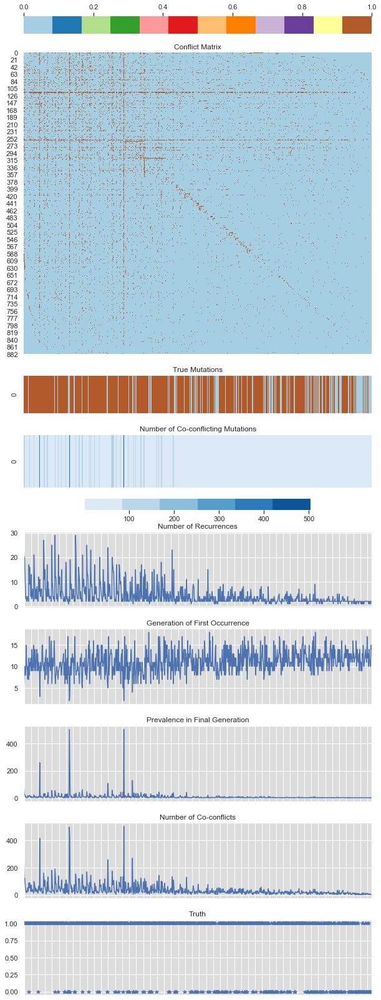

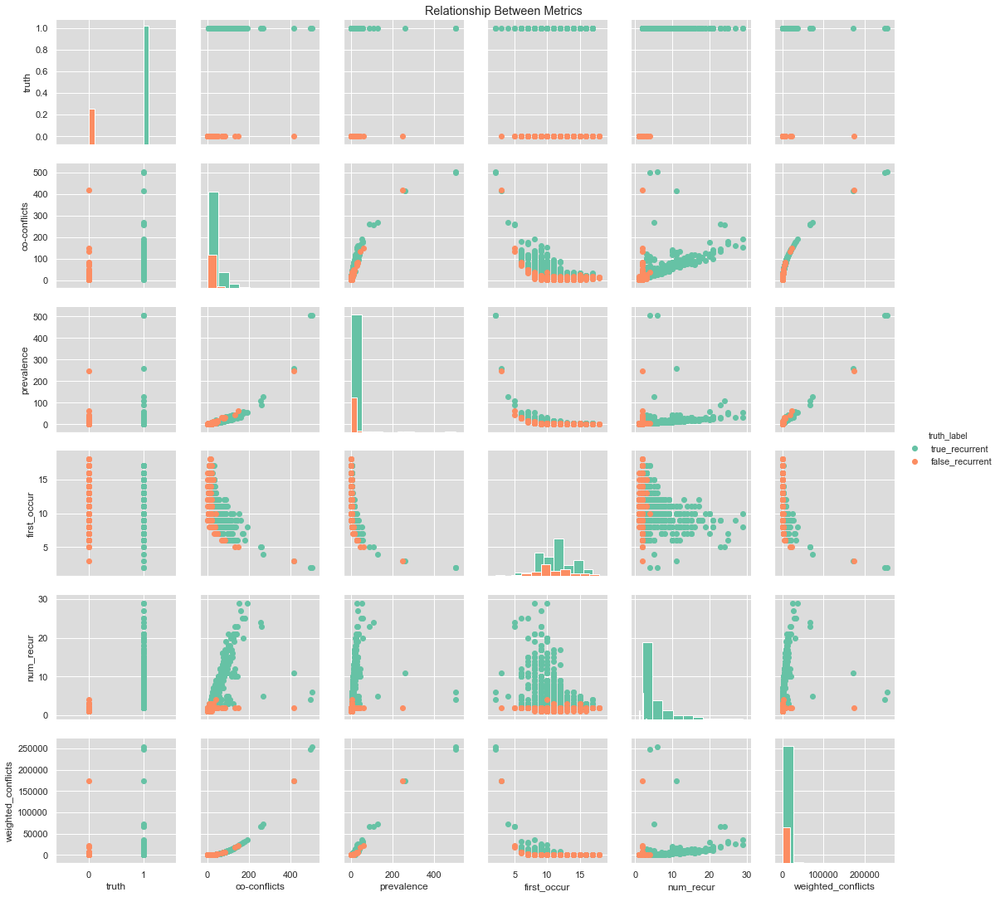

0.44704294204711914 fast?


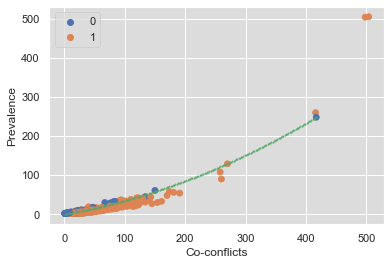

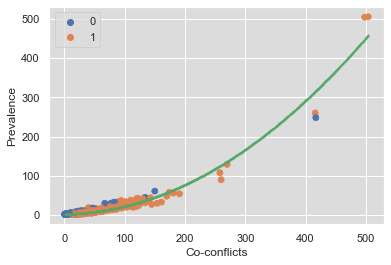

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(254,)
(450,)
(637,)
(790,)
(889,)
(941,)
(968,)
(982,)
(993,)
(998,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


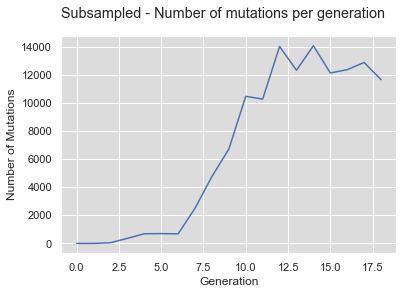

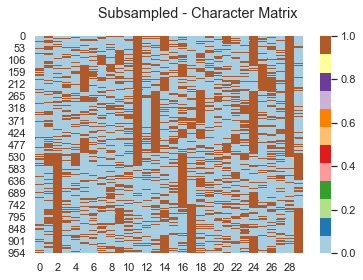

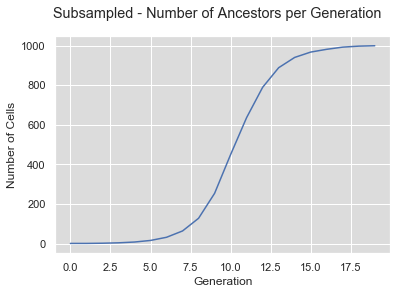

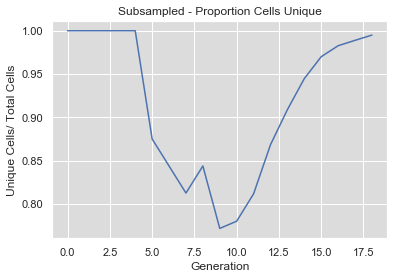

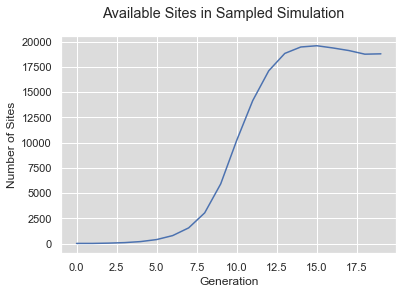

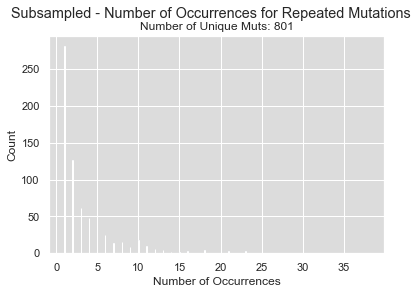

(1000, 30)
Time 1: 0.018332242965698242
Compute dictionary: 28.630585193634033
Conflict matrix is symmetric?  True
Total time: 28.657275199890137
Number of true recurrent muts:  688
Number of detected recurrent muts:  907
Number of true recurrent muts not detected: 0 with prevalence []


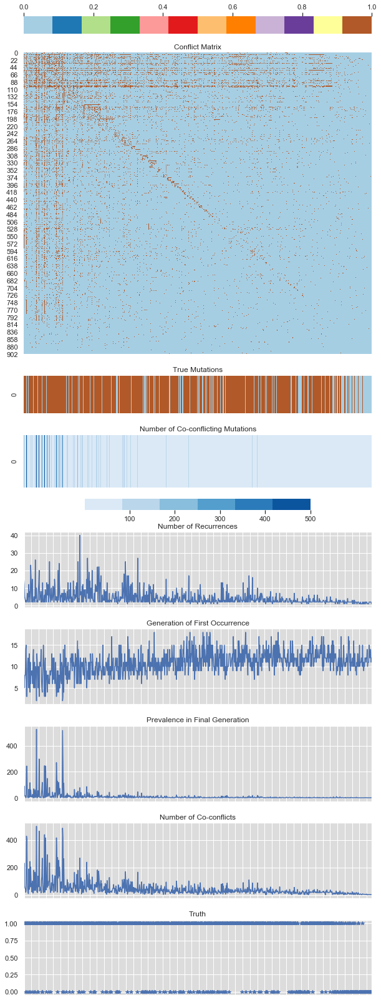

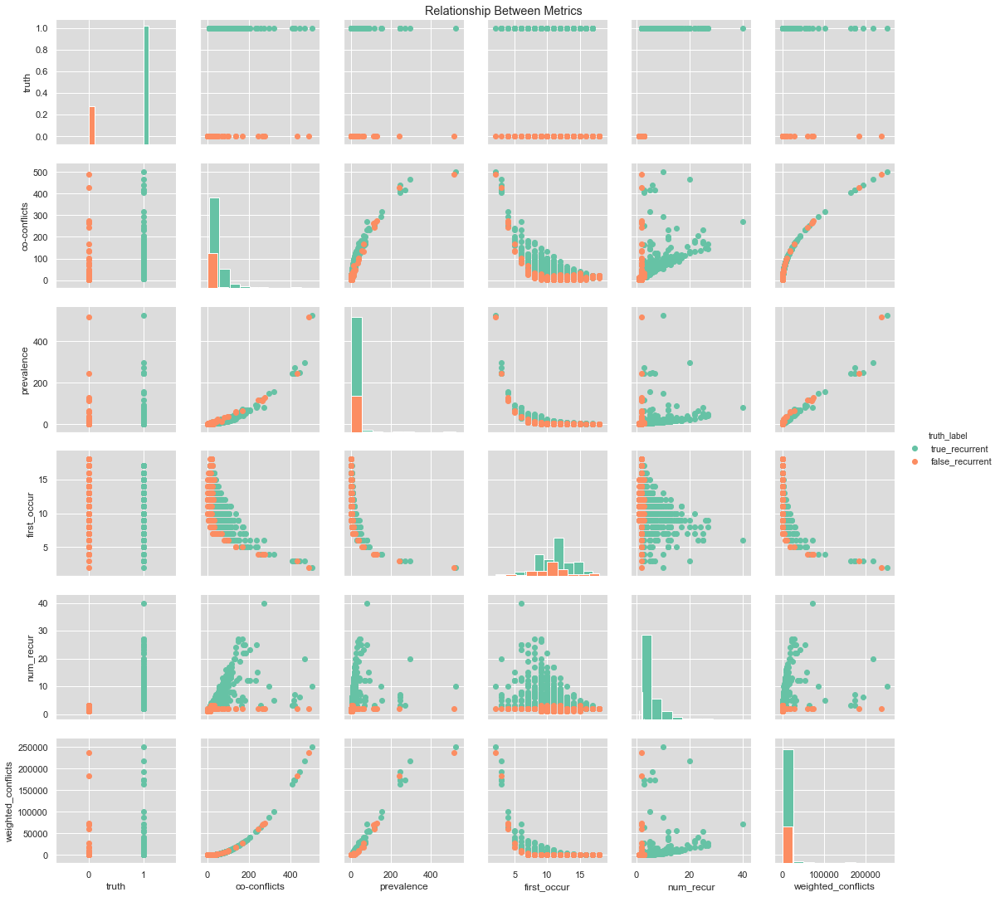

0.45442819595336914 fast?


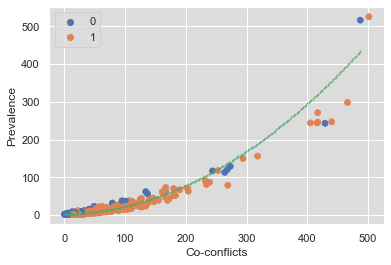

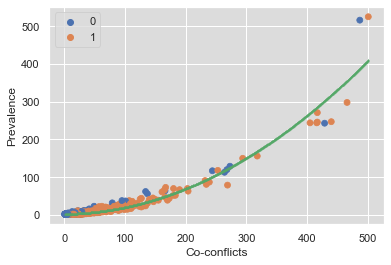

Label: ssm
List of targets:  [(0, 0), (0, 1), (0, 2), (1, 0), (1, 1), (1, 2), (2, 0), (2, 1), (2, 2), (3, 0), (3, 1), (3, 2), (4, 0), (4, 1), (4, 2), (5, 0), (5, 1), (5, 2), (6, 0), (6, 1), (6, 2), (7, 0), (7, 1), (7, 2), (8, 0), (8, 1), (8, 2), (9, 0), (9, 1), (9, 2)]
ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(251,)
(443,)
(645,)
(782,)
(875,)
(936,)
(969,)
(985,)
(991,)
(997,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


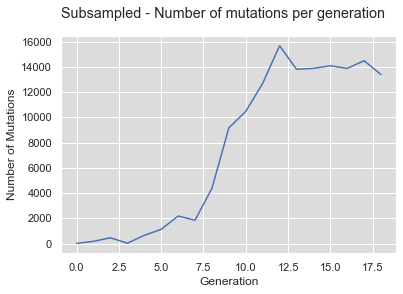

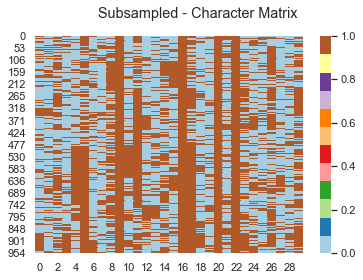

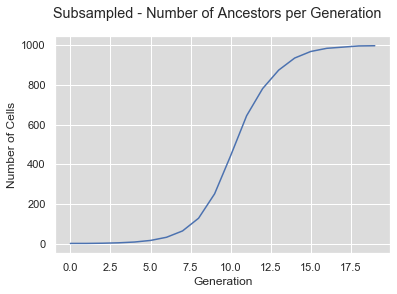

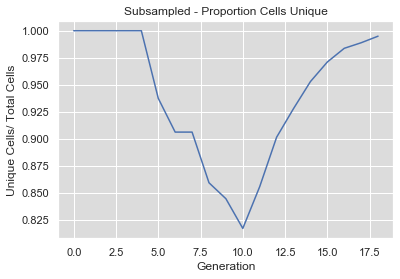

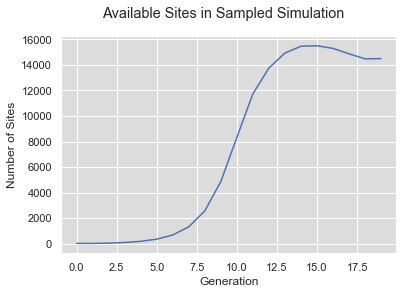

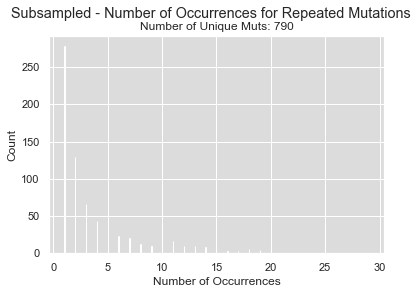

(998, 30)
Time 1: 0.019207239151000977
Compute dictionary: 27.998411893844604
Conflict matrix is symmetric?  True
Total time: 28.02570104598999
Number of true recurrent muts:  708
Number of detected recurrent muts:  910
Number of true recurrent muts not detected: 2 with prevalence [998, 998]


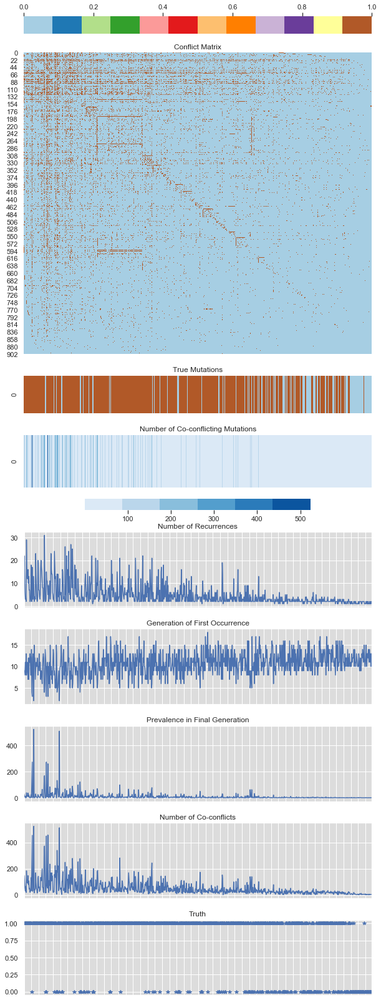

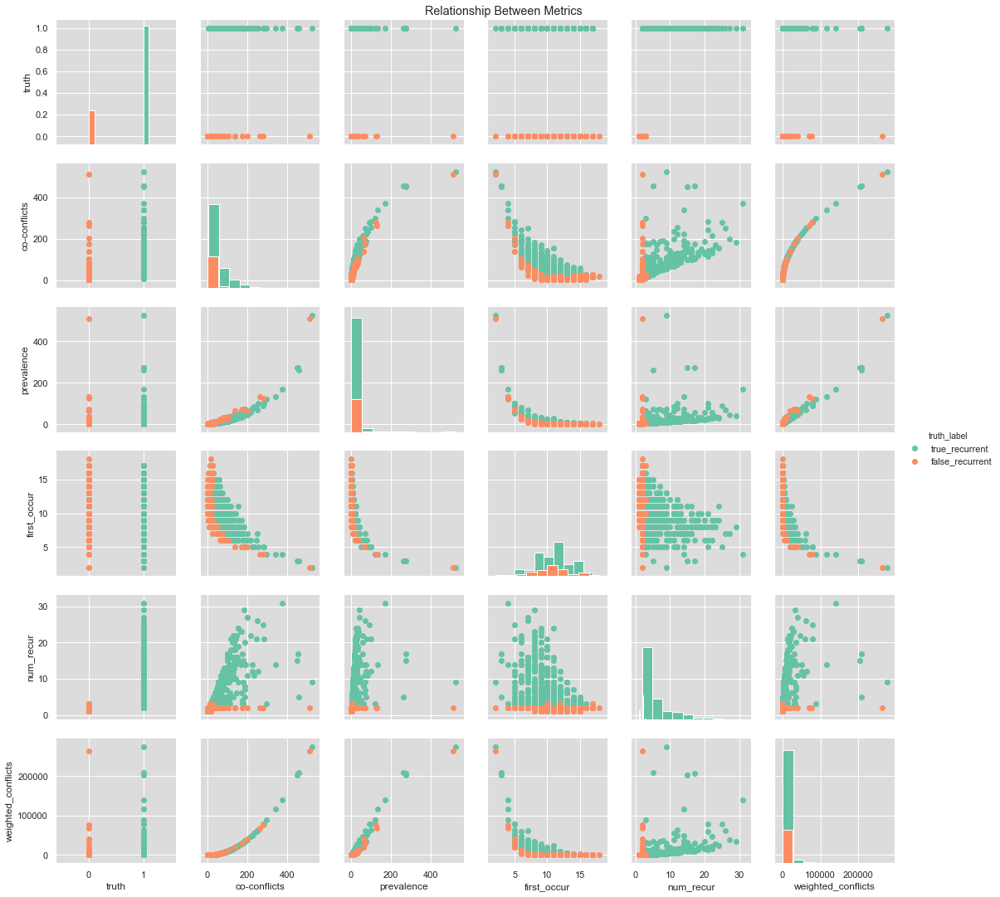

0.47170376777648926 fast?


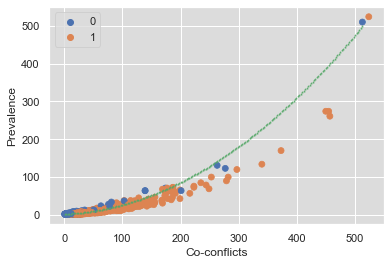

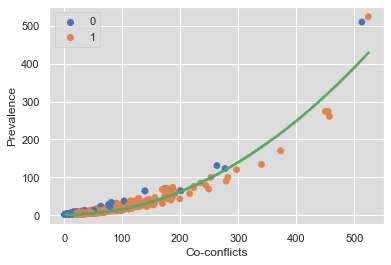

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(441,)
(634,)
(787,)
(886,)
(949,)
(974,)
(986,)
(995,)
(997,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


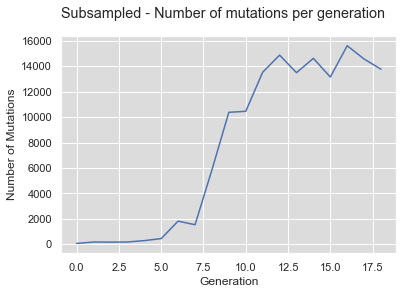

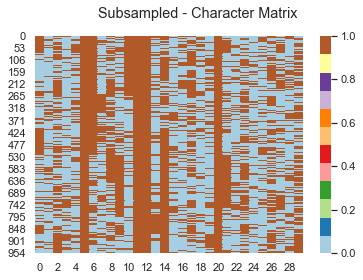

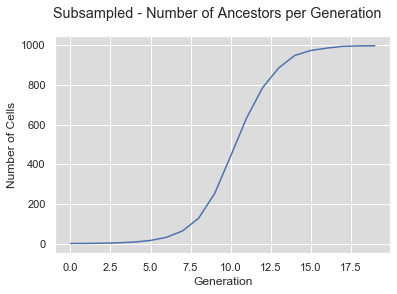

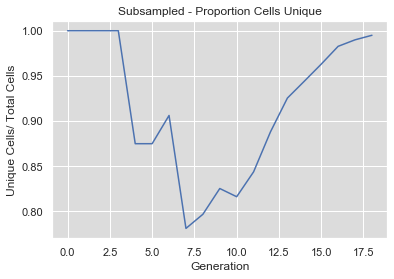

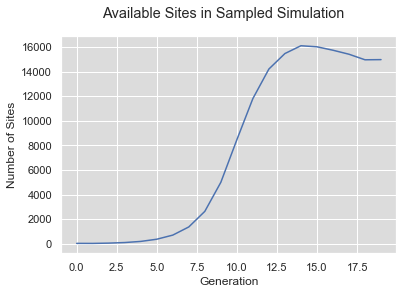

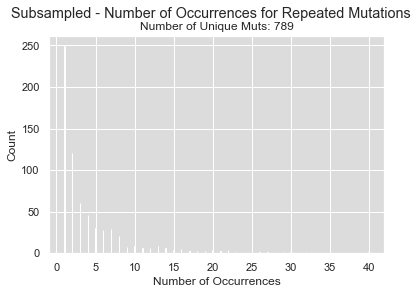

(998, 30)
Time 1: 0.01746392250061035
Compute dictionary: 27.09150791168213
Conflict matrix is symmetric?  True
Total time: 27.122843980789185
Number of true recurrent muts:  668
Number of detected recurrent muts:  893
Number of true recurrent muts not detected: 1 with prevalence [998]


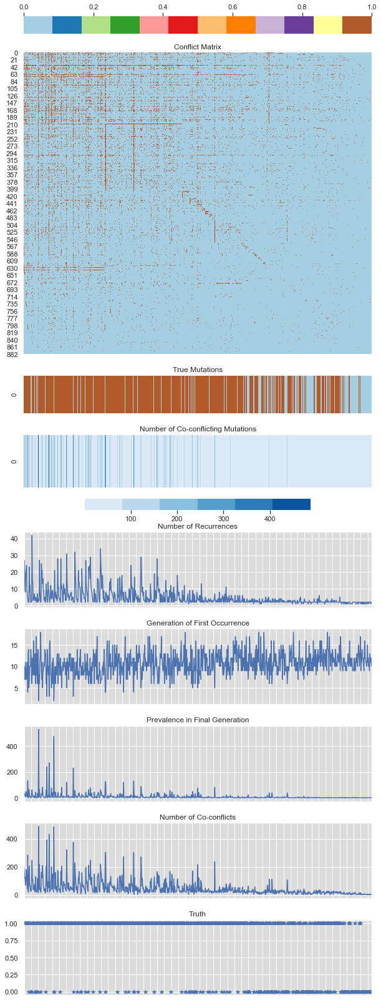

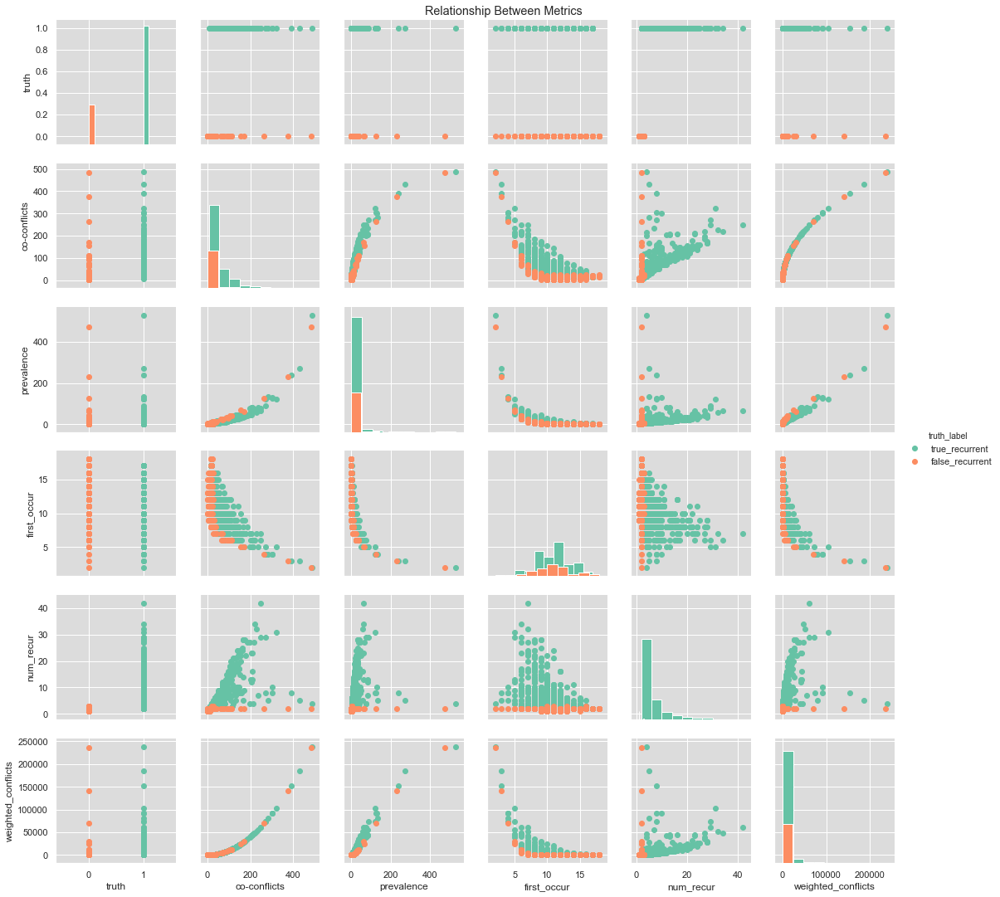

0.08579206466674805 fast?


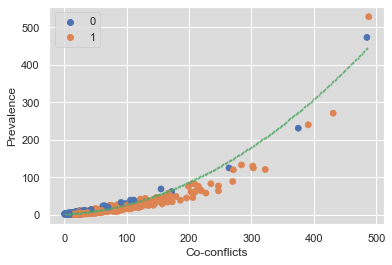

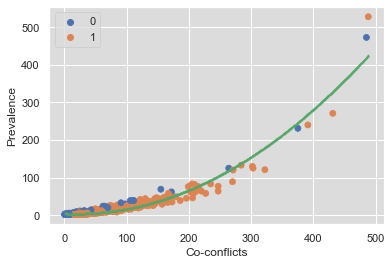

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(250,)
(448,)
(644,)
(800,)
(897,)
(950,)
(974,)
(988,)
(994,)
(996,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


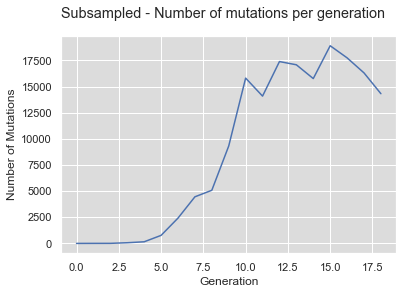

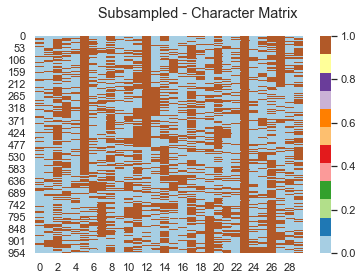

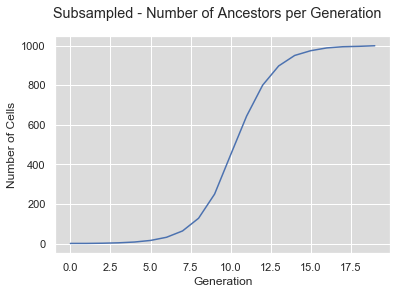

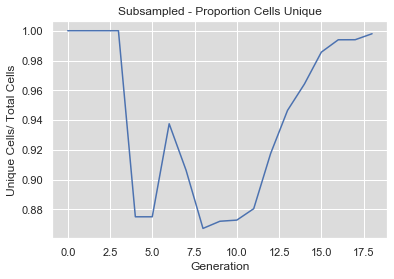

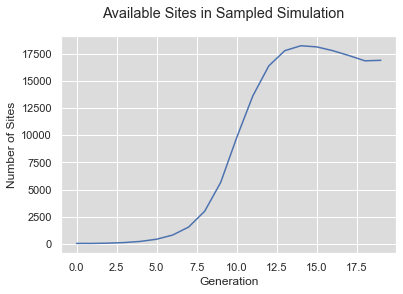

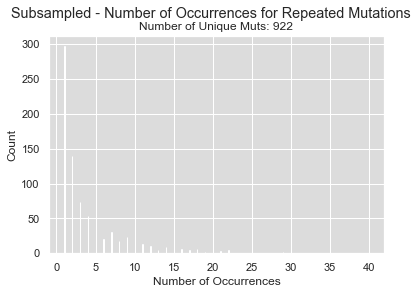

(999, 30)
Time 1: 0.022008180618286133
Compute dictionary: 36.612165212631226
Conflict matrix is symmetric?  True
Total time: 36.662490129470825
Number of true recurrent muts:  780
Number of detected recurrent muts:  1013
Number of true recurrent muts not detected: 0 with prevalence []


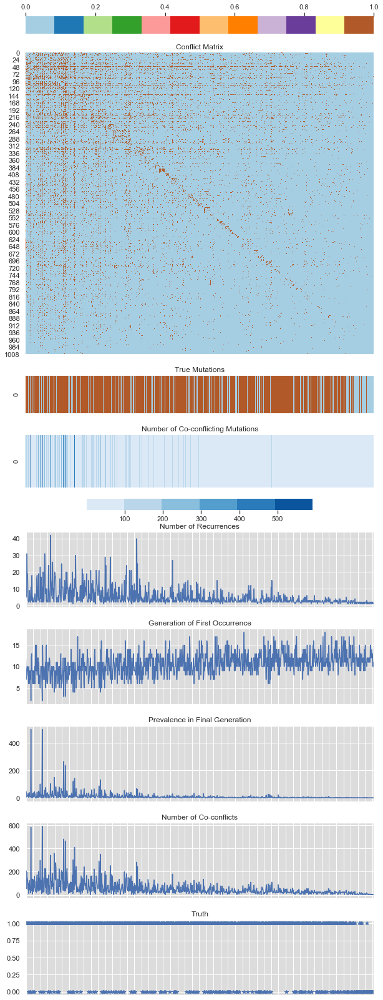

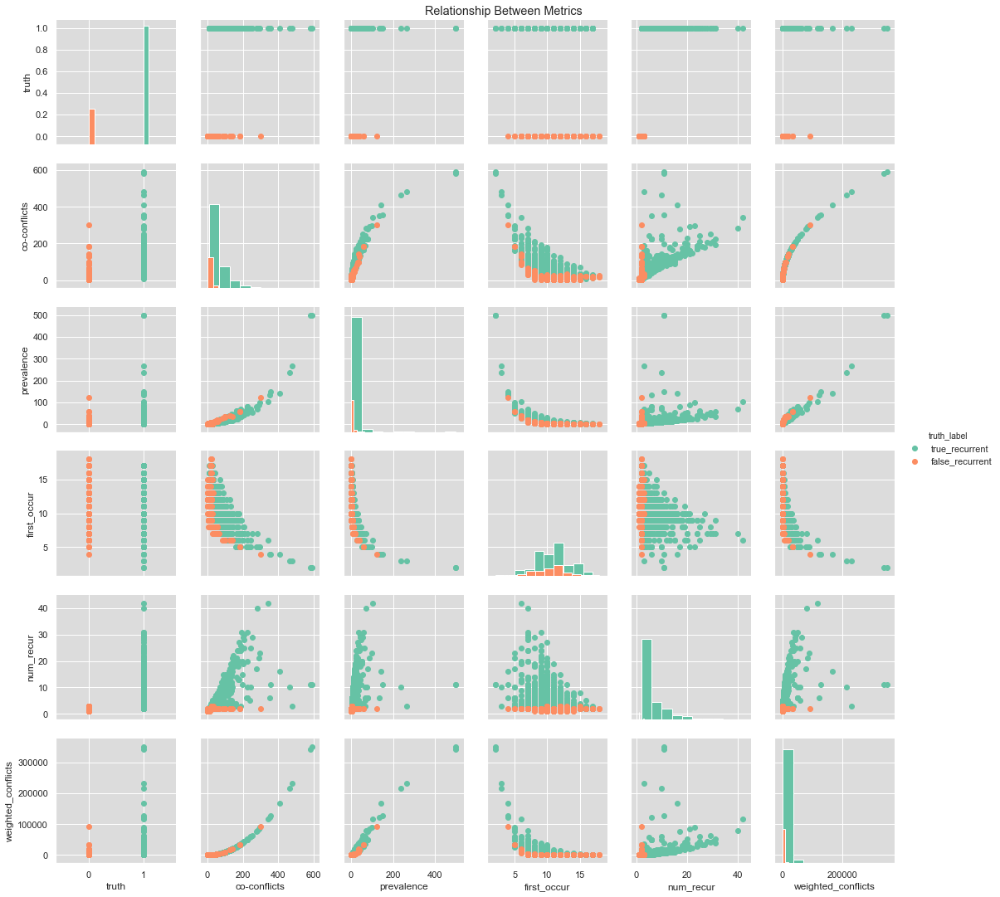

0.12297797203063965 fast?


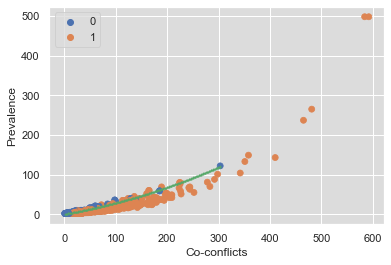

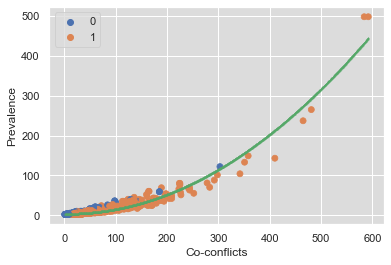

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(440,)
(642,)
(810,)
(892,)
(948,)
(976,)
(985,)
(995,)
(999,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


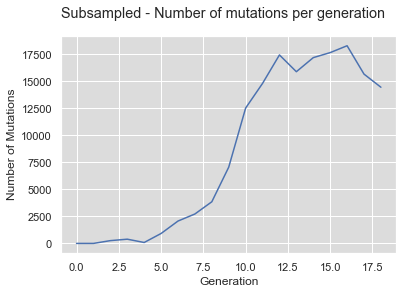

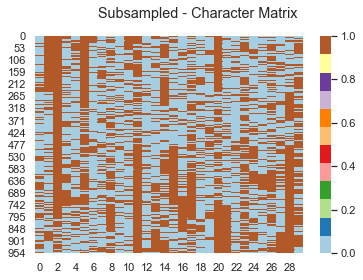

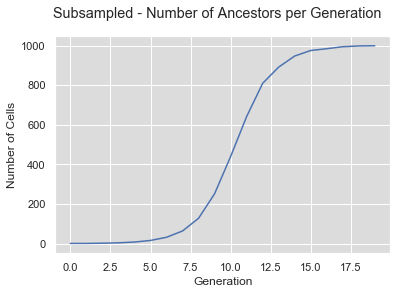

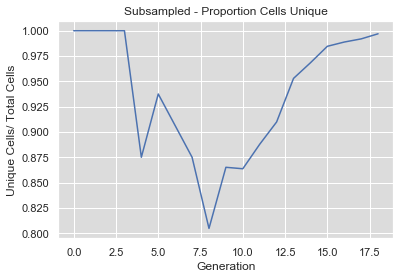

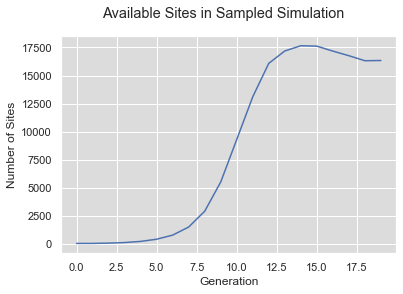

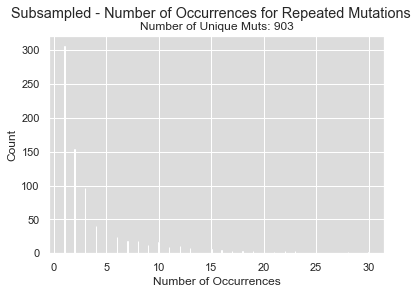

(1000, 30)
Time 1: 0.021563053131103516
Compute dictionary: 35.39677405357361
Conflict matrix is symmetric?  True
Total time: 35.433013916015625
Number of true recurrent muts:  808
Number of detected recurrent muts:  1043
Number of true recurrent muts not detected: 0 with prevalence []


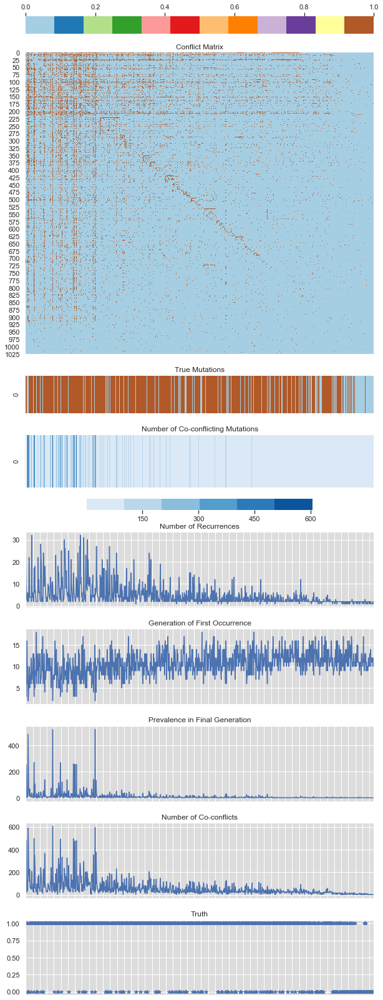

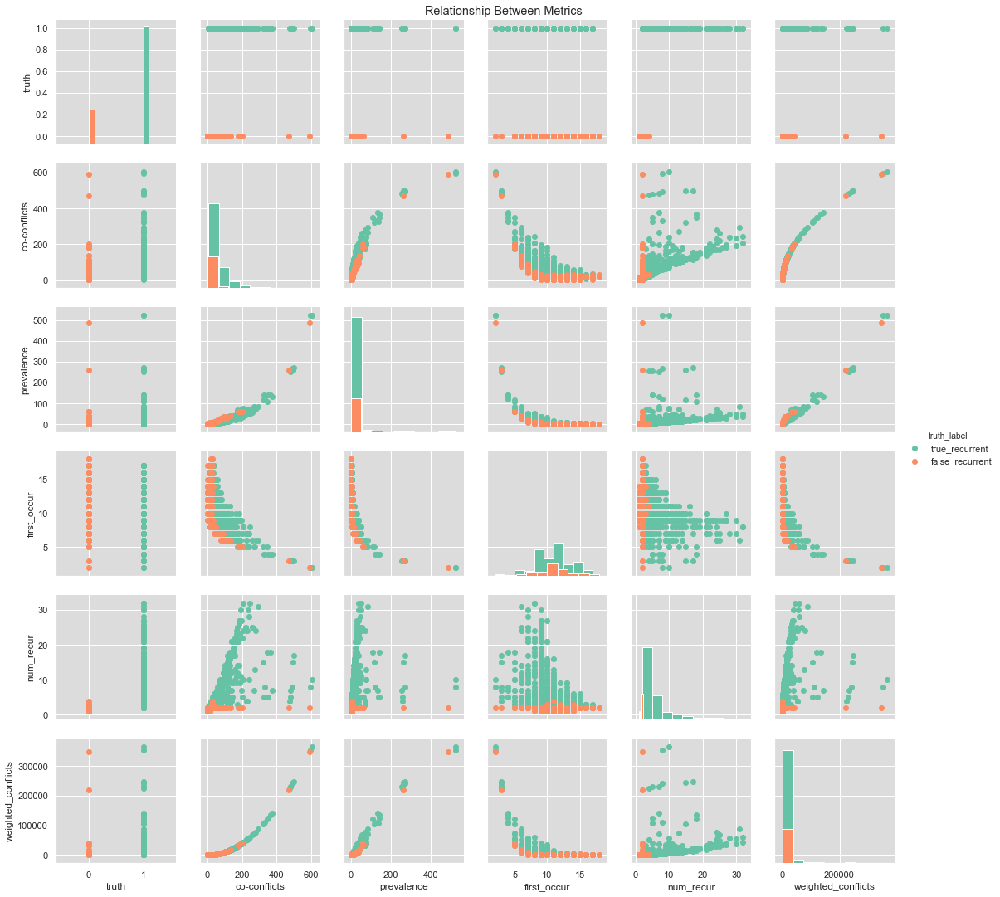

0.09254288673400879 fast?


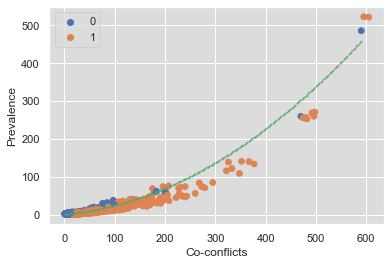

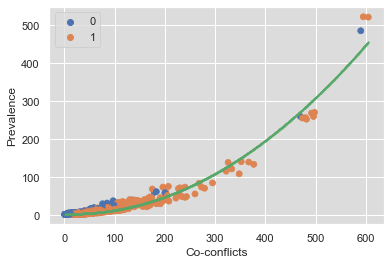

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(444,)
(661,)
(813,)
(895,)
(942,)
(969,)
(982,)
(990,)
(996,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


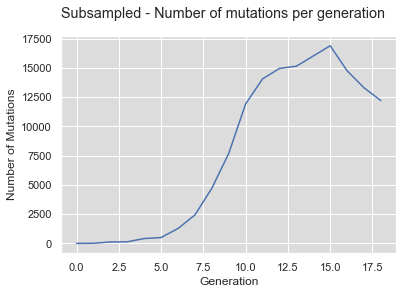

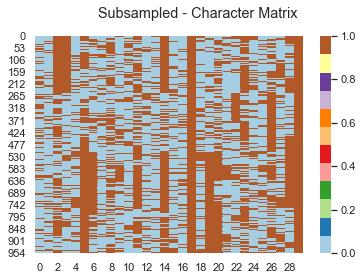

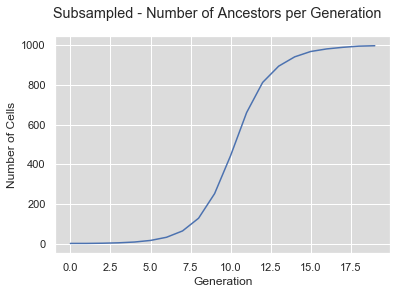

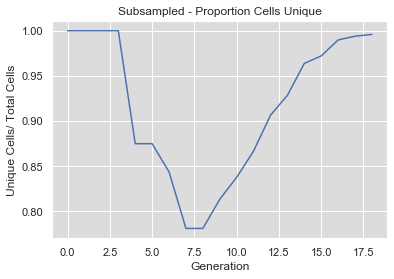

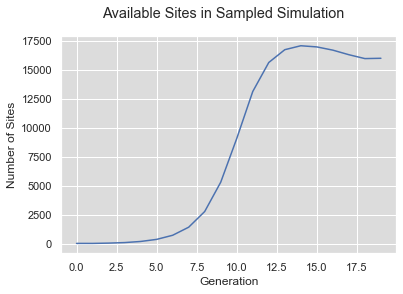

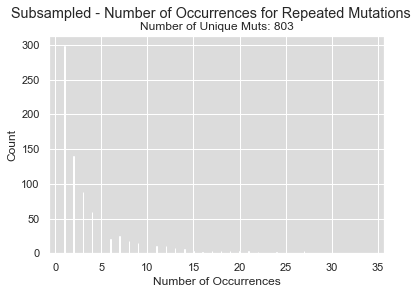

(998, 30)
Time 1: 0.019758939743041992
Compute dictionary: 34.502580881118774
Conflict matrix is symmetric?  True
Total time: 34.53946399688721
Number of true recurrent muts:  762
Number of detected recurrent muts:  959
Number of true recurrent muts not detected: 1 with prevalence [998]


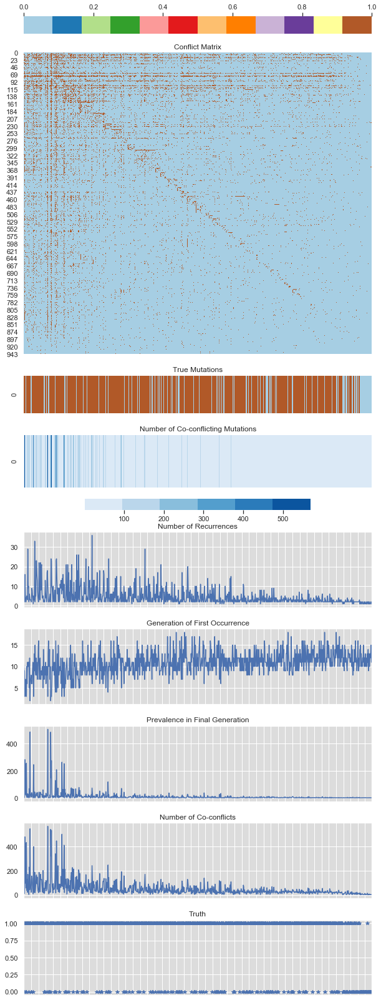

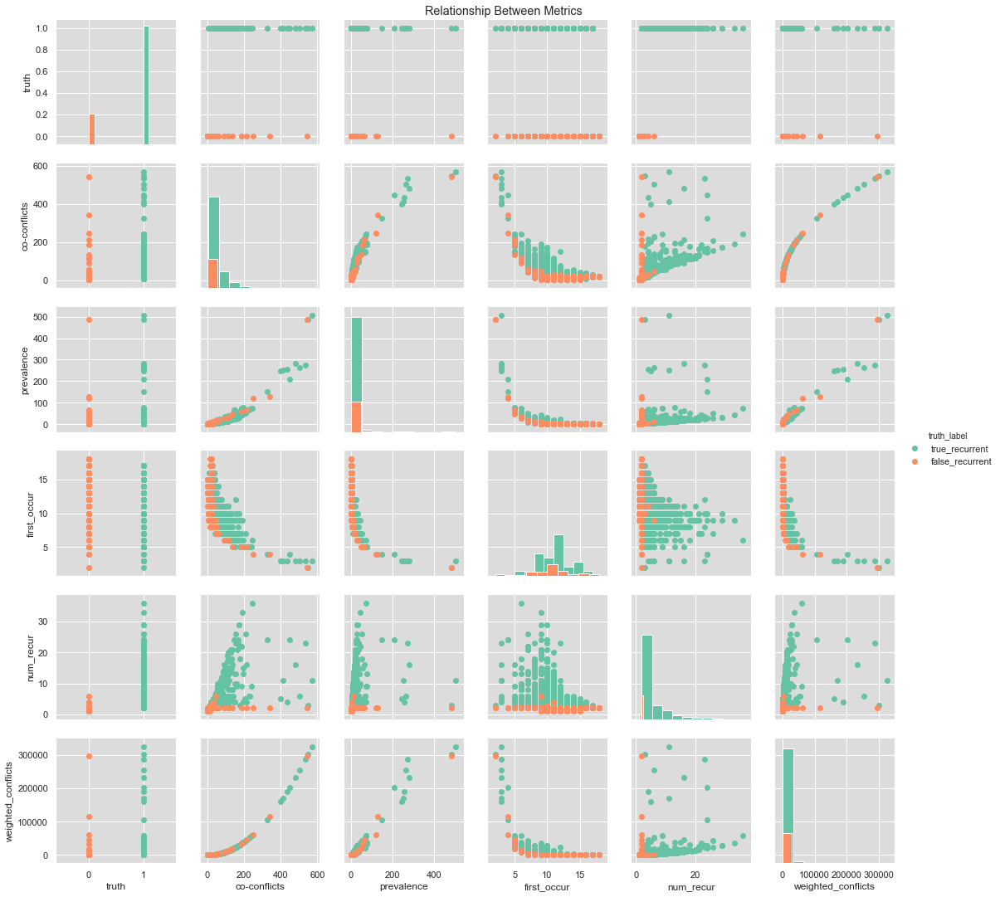

0.08262205123901367 fast?


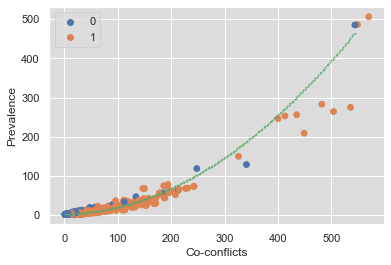

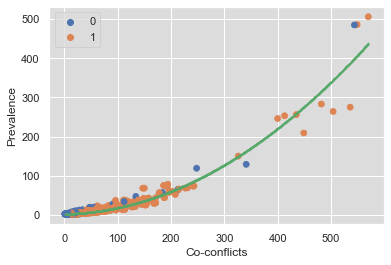

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(438,)
(634,)
(781,)
(876,)
(934,)
(967,)
(983,)
(993,)
(999,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


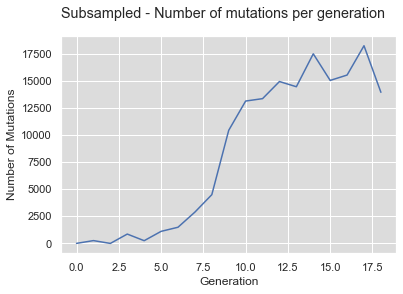

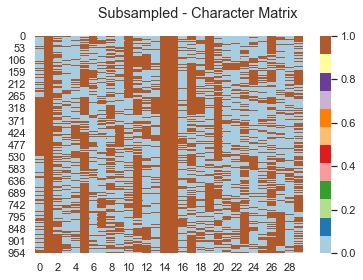

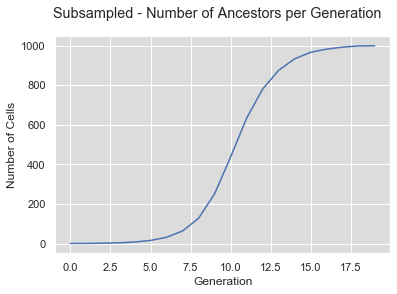

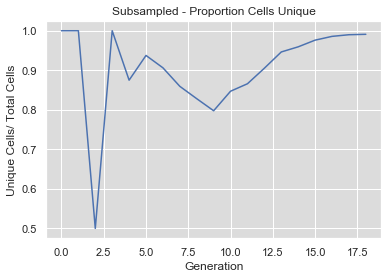

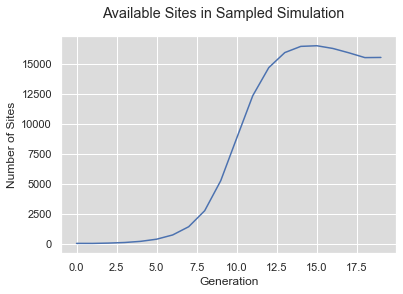

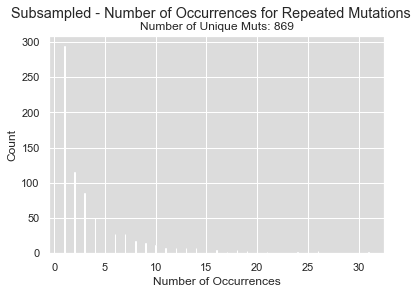

(1000, 30)
Time 1: 0.02017688751220703
Compute dictionary: 28.445878982543945
Conflict matrix is symmetric?  True
Total time: 28.477070093154907
Number of true recurrent muts:  743
Number of detected recurrent muts:  944
Number of true recurrent muts not detected: 1 with prevalence [1000]


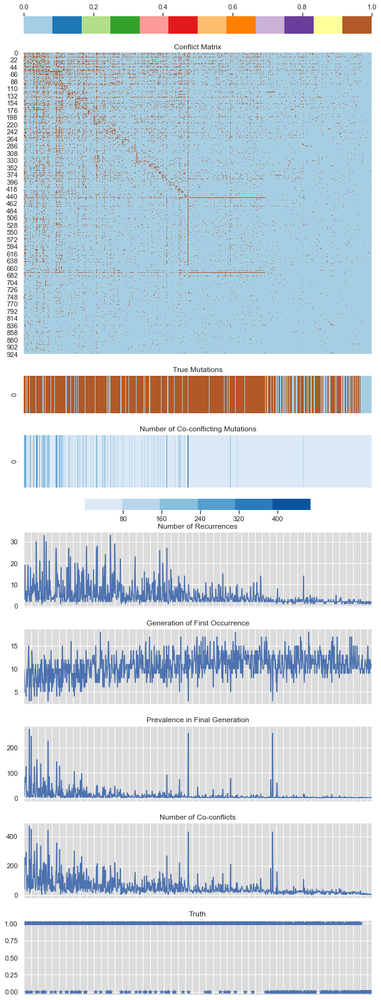

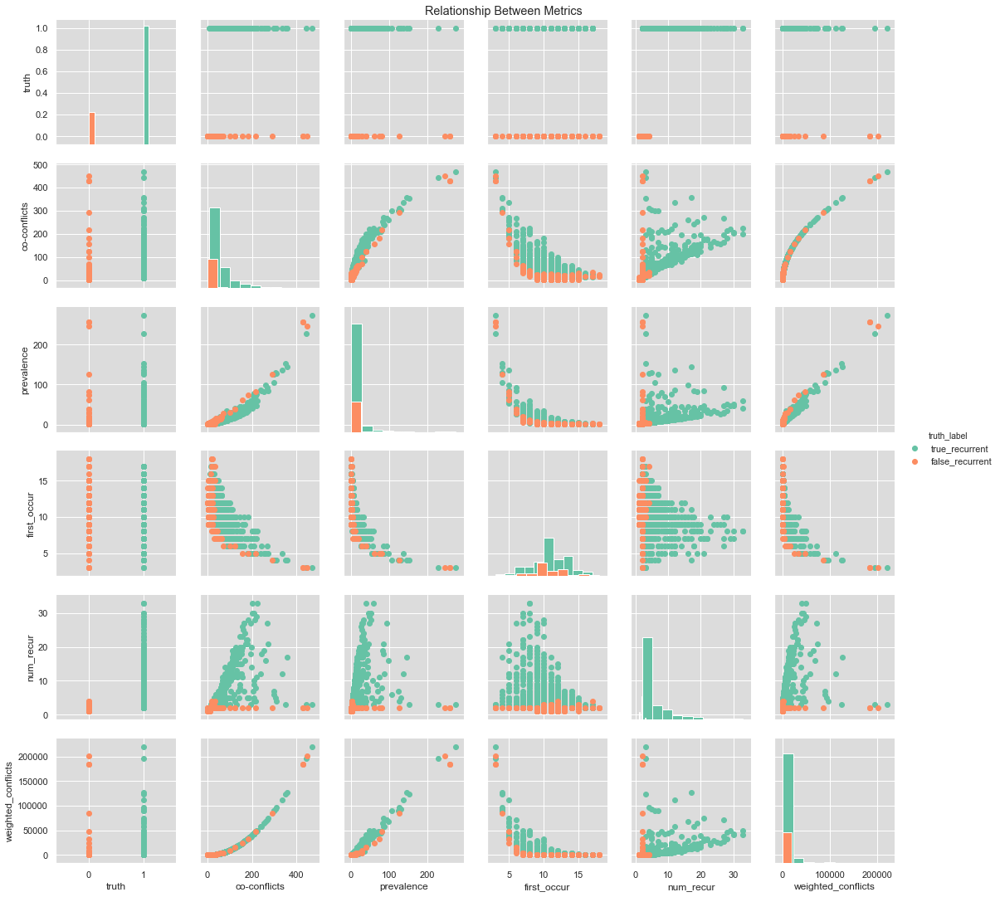

0.08552789688110352 fast?


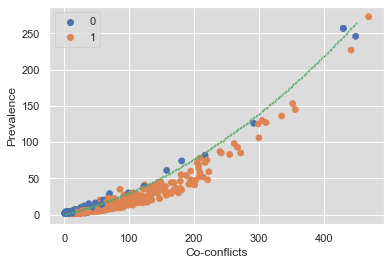

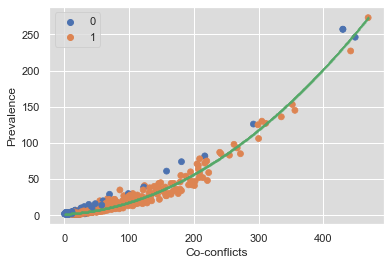

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(254,)
(447,)
(655,)
(812,)
(907,)
(956,)
(973,)
(987,)
(996,)
(998,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


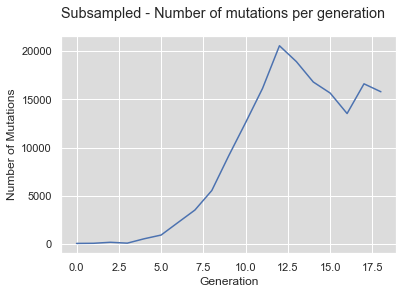

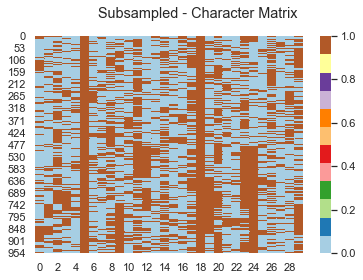

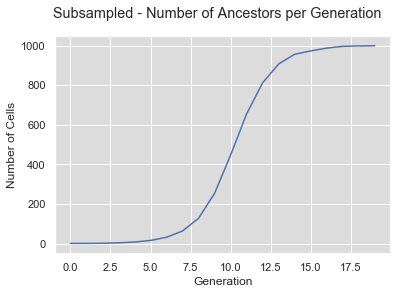

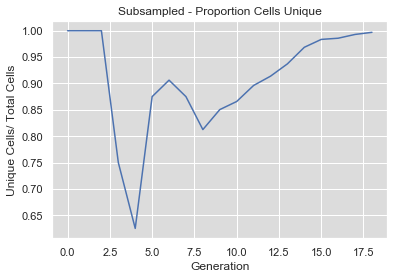

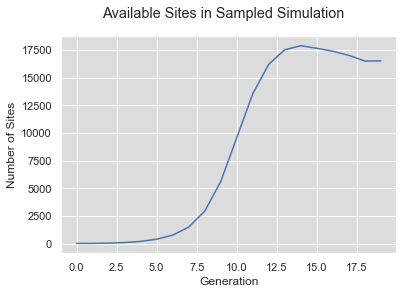

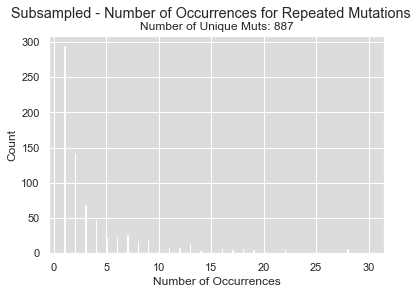

(999, 30)
Time 1: 0.022151947021484375
Compute dictionary: 34.84036087989807
Conflict matrix is symmetric?  True
Total time: 34.873936891555786
Number of true recurrent muts:  756
Number of detected recurrent muts:  1001
Number of true recurrent muts not detected: 1 with prevalence [999]


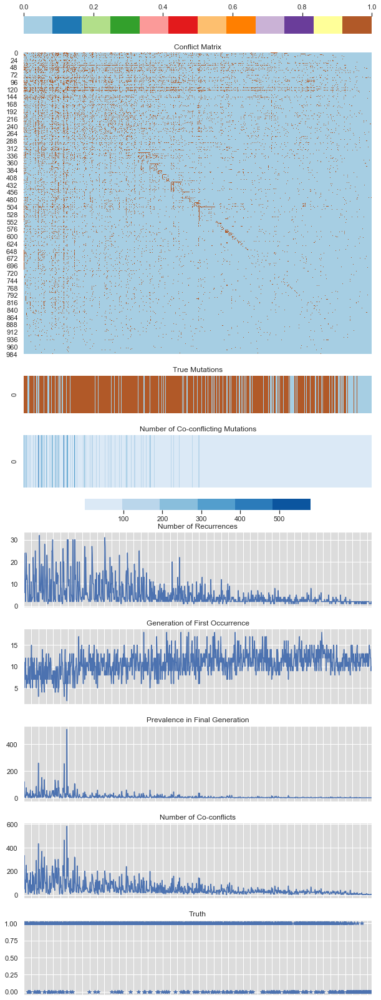

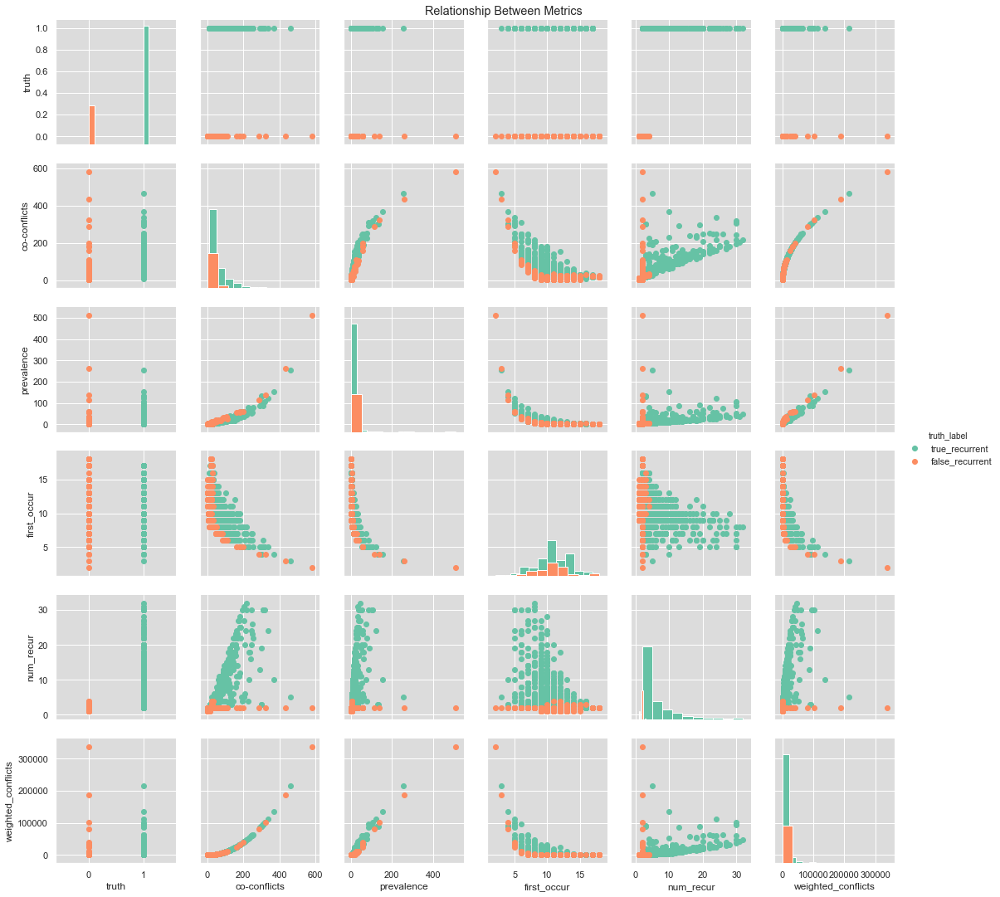

0.08253312110900879 fast?


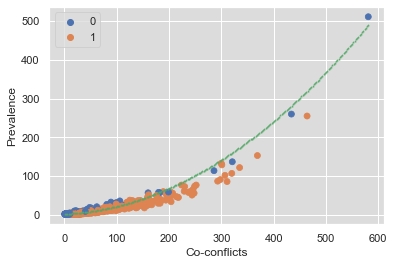

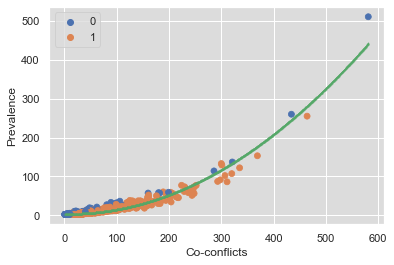

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(249,)
(448,)
(660,)
(815,)
(901,)
(951,)
(971,)
(981,)
(992,)
(997,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


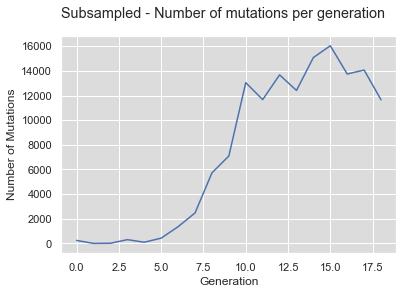

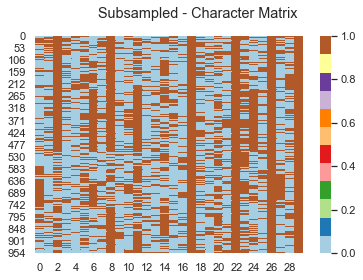

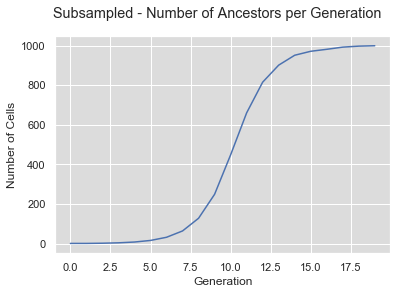

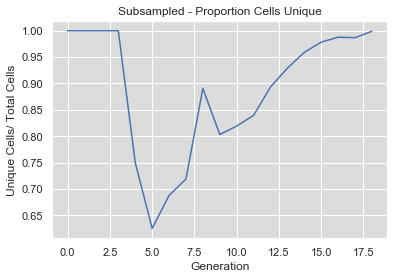

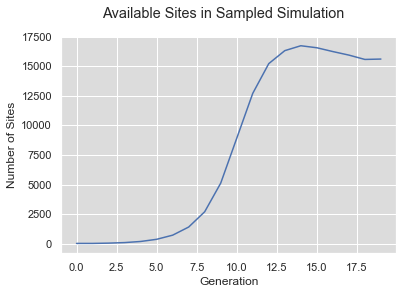

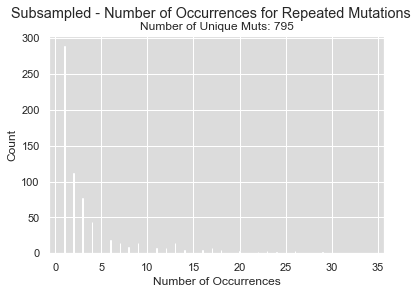

(999, 30)
Time 1: 0.01965785026550293
Compute dictionary: 30.447224140167236
Conflict matrix is symmetric?  True
Total time: 30.46997094154358
Number of true recurrent muts:  688
Number of detected recurrent muts:  879
Number of true recurrent muts not detected: 4 with prevalence [999, 999, 999, 999]


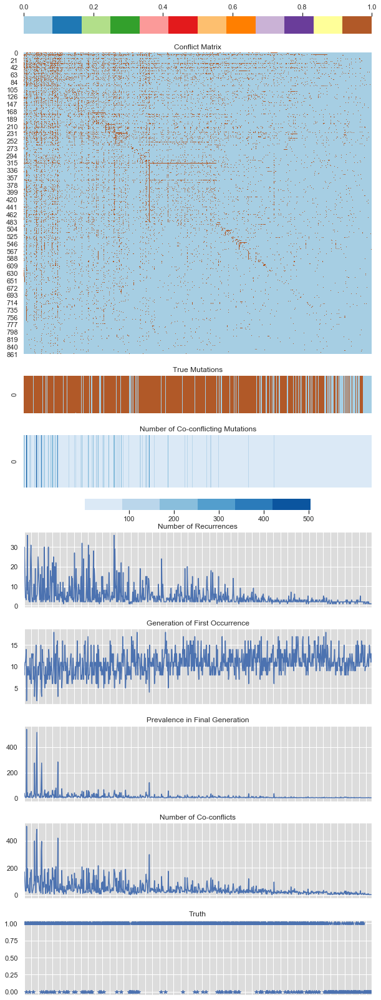

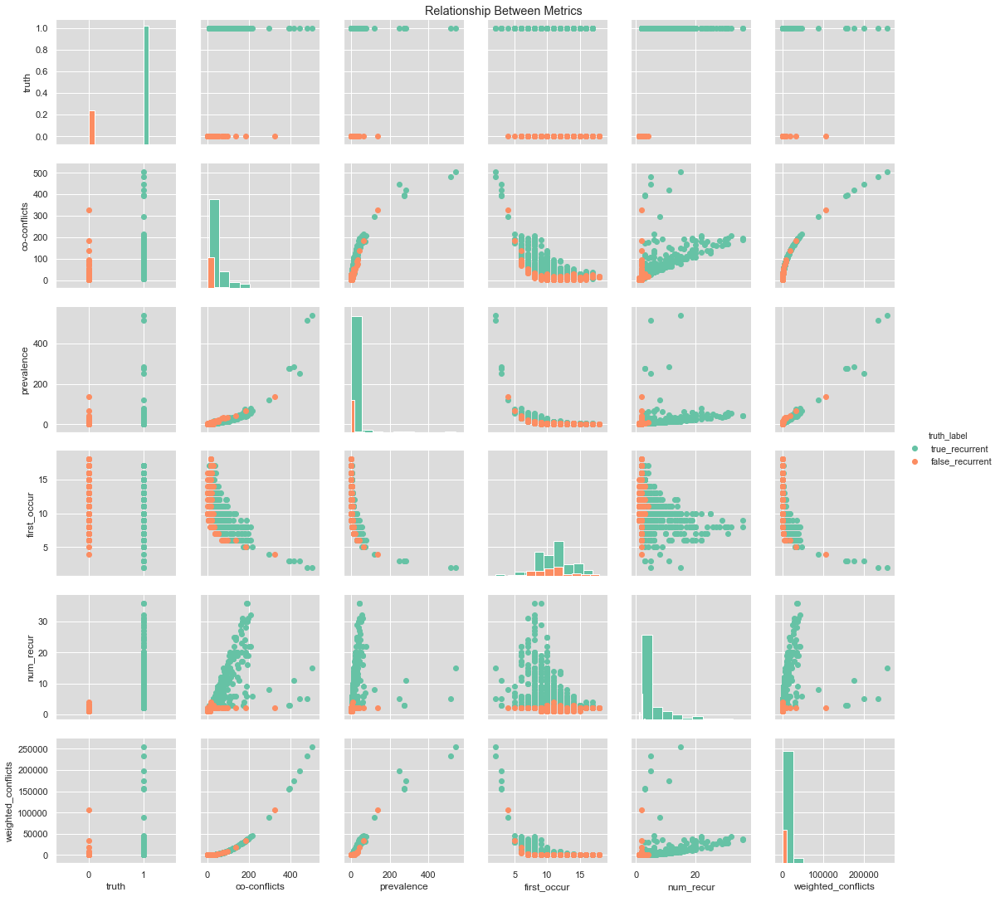

0.6670467853546143 fast?


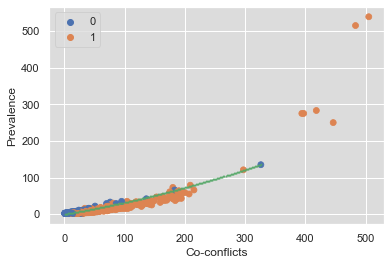

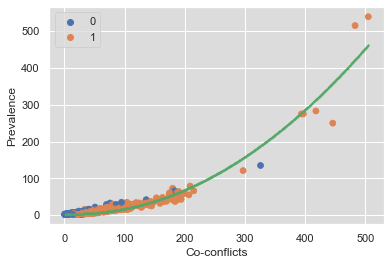

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(250,)
(438,)
(642,)
(803,)
(894,)
(940,)
(965,)
(982,)
(989,)
(995,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


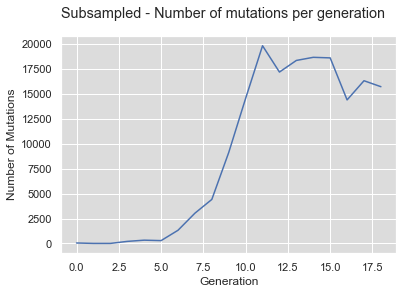

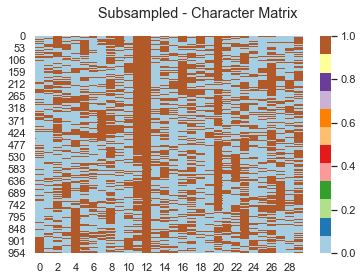

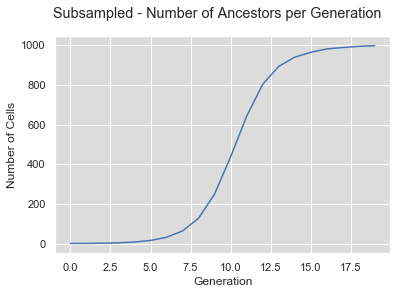

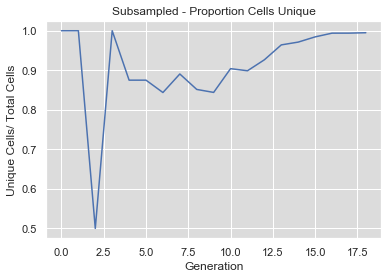

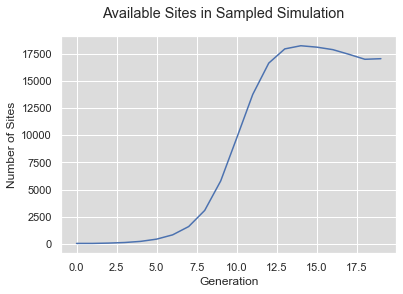

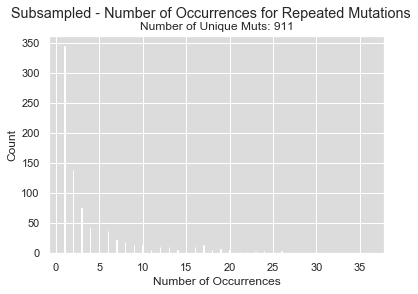

(998, 30)
Time 1: 0.01898336410522461
Compute dictionary: 35.601402282714844
Conflict matrix is symmetric?  True
Total time: 35.64447617530823
Number of true recurrent muts:  838
Number of detected recurrent muts:  1079
Number of true recurrent muts not detected: 1 with prevalence [998]


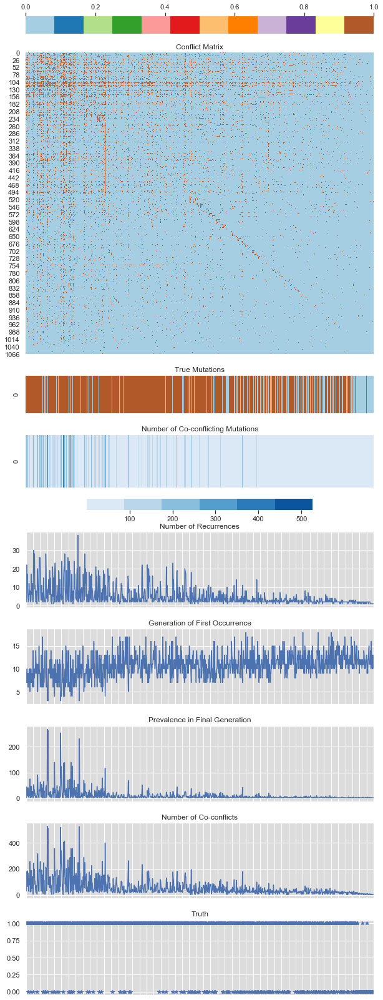

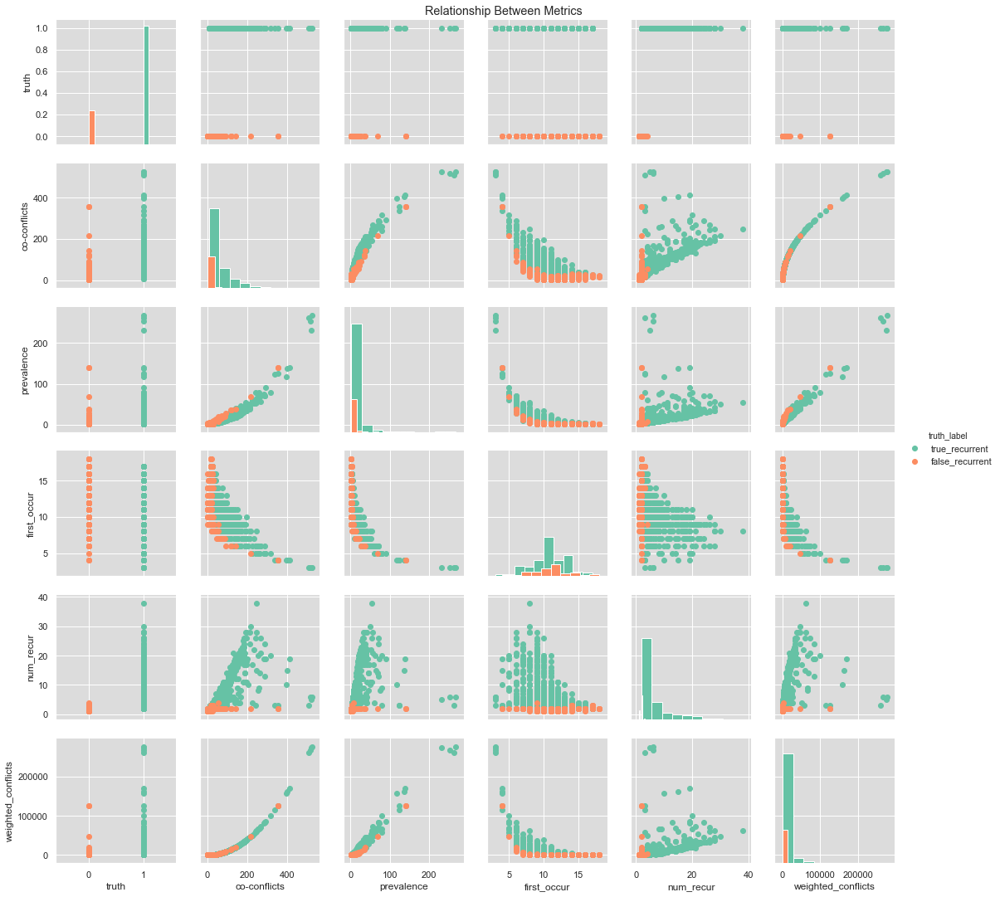

0.10516691207885742 fast?


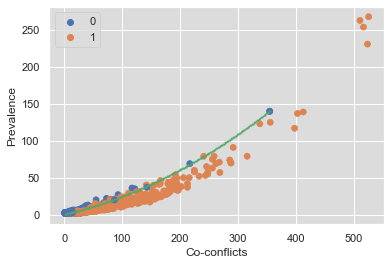

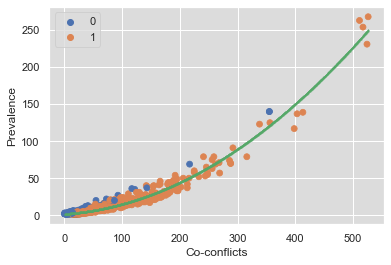

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(445,)
(640,)
(798,)
(893,)
(947,)
(976,)
(986,)
(995,)
(998,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


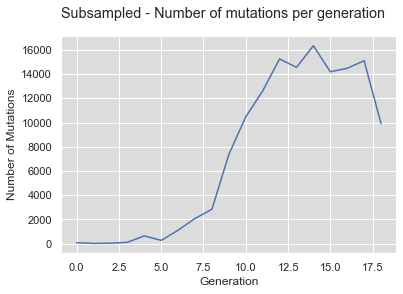

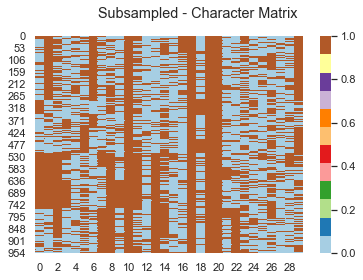

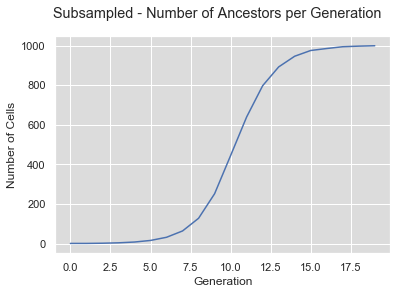

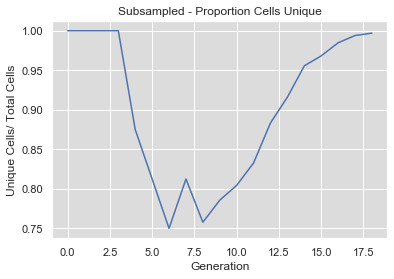

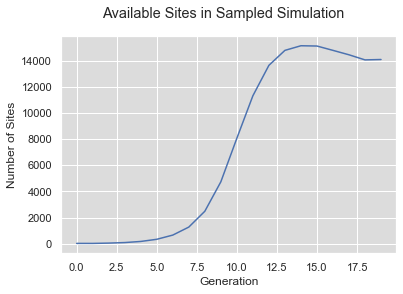

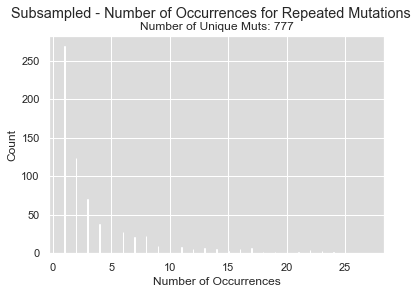

(1000, 30)
Time 1: 0.016835689544677734
Compute dictionary: 28.093341827392578
Conflict matrix is symmetric?  True
Total time: 28.118494987487793
Number of true recurrent muts:  682
Number of detected recurrent muts:  872
Number of true recurrent muts not detected: 3 with prevalence [1000, 1000, 1000]


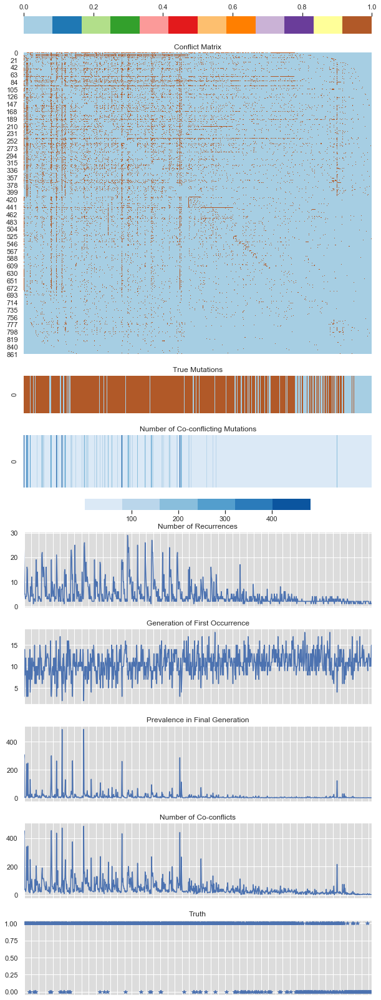

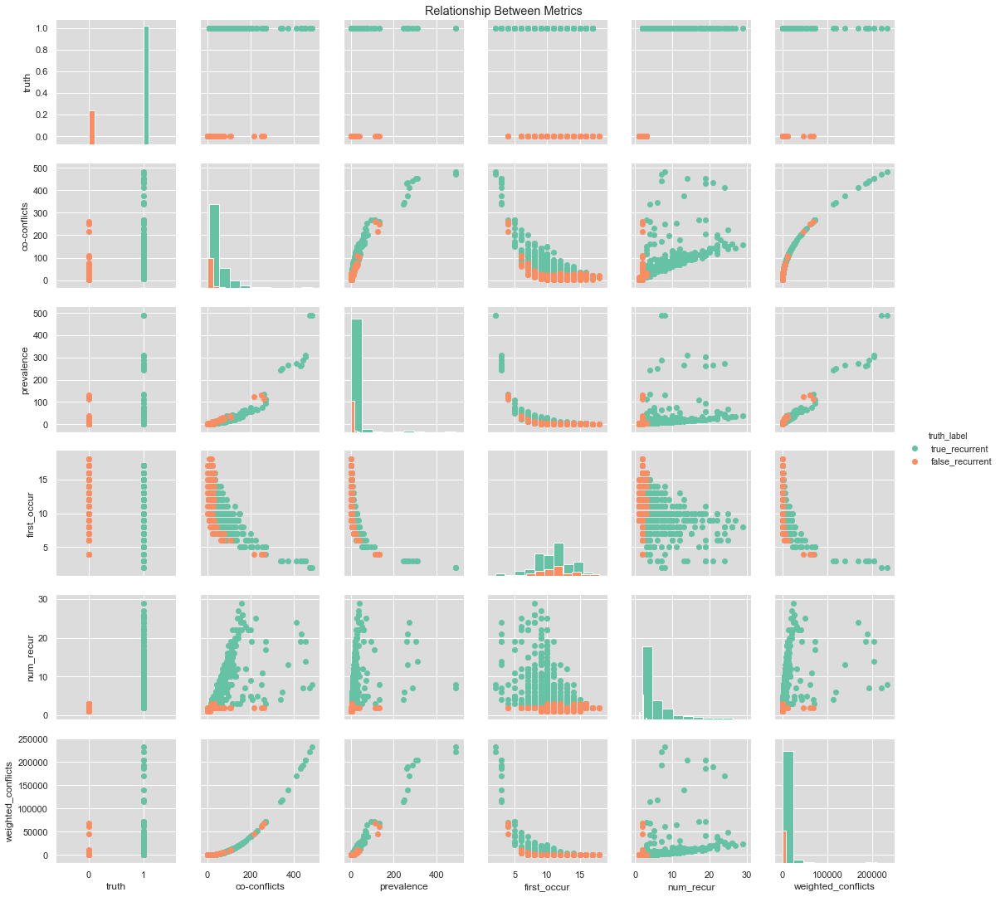

0.08497786521911621 fast?


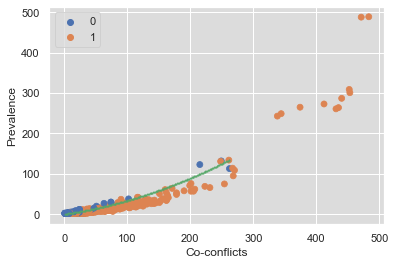

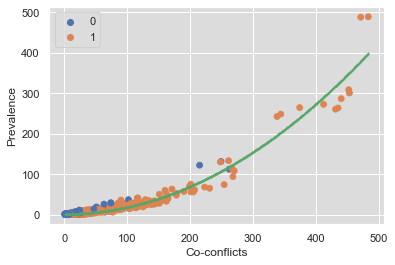

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(449,)
(639,)
(793,)
(885,)
(945,)
(972,)
(985,)
(994,)
(999,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


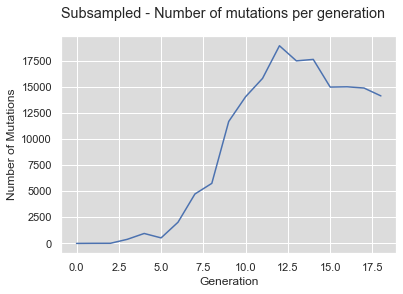

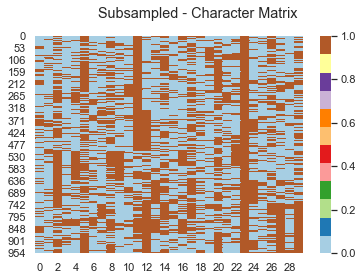

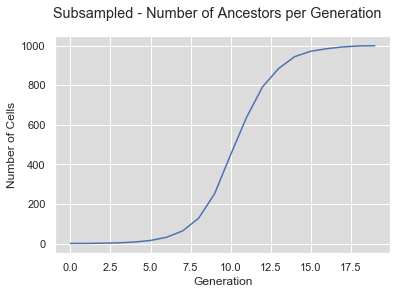

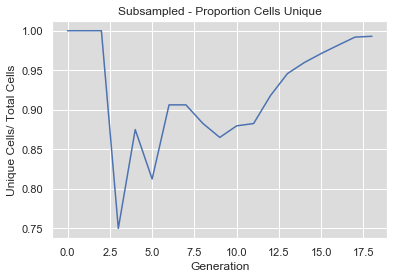

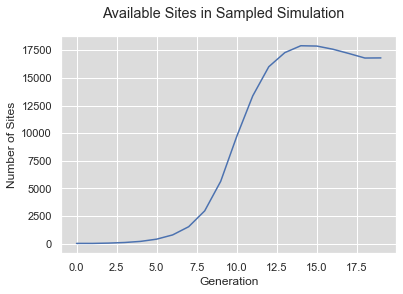

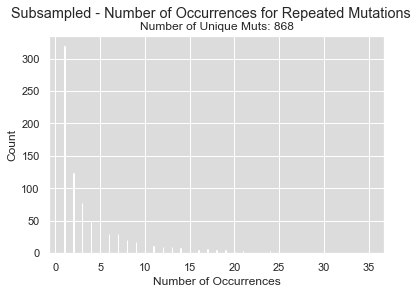

(1000, 30)
Time 1: 0.021611690521240234
Compute dictionary: 36.299704790115356
Conflict matrix is symmetric?  True
Total time: 36.33976483345032
Number of true recurrent muts:  792
Number of detected recurrent muts:  1050
Number of true recurrent muts not detected: 0 with prevalence []


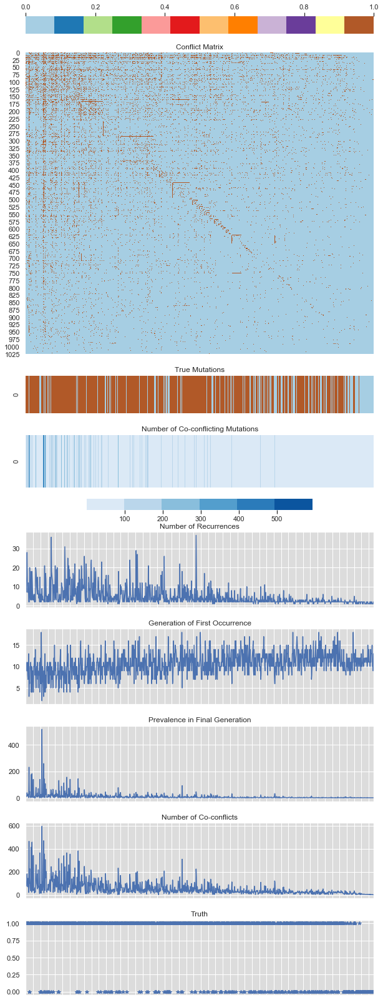

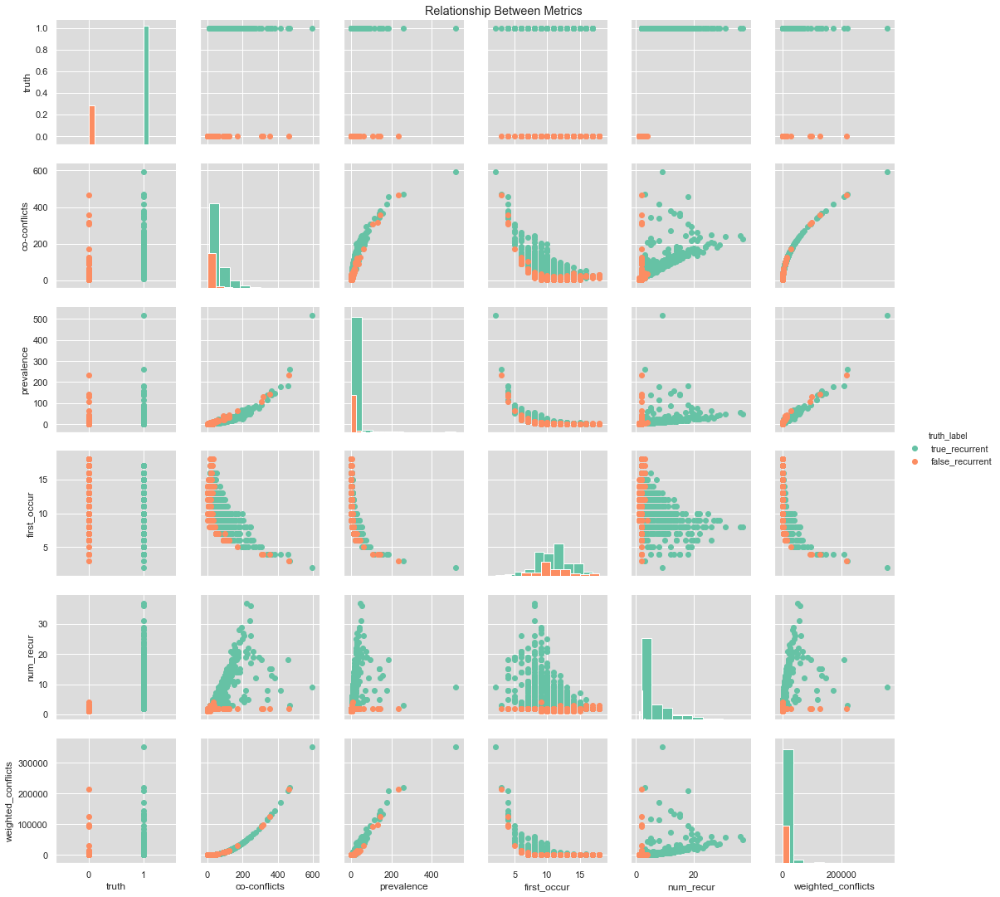

0.10192203521728516 fast?


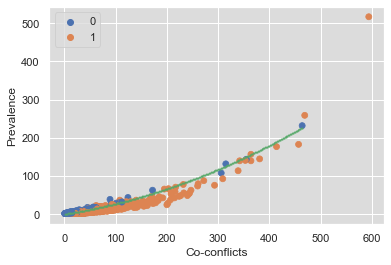

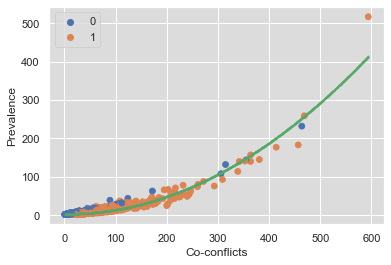

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(254,)
(448,)
(650,)
(795,)
(887,)
(949,)
(971,)
(986,)
(989,)
(991,)
(996,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


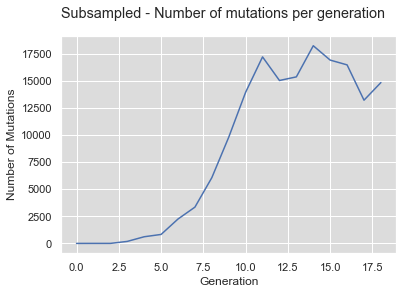

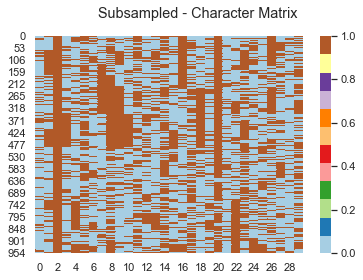

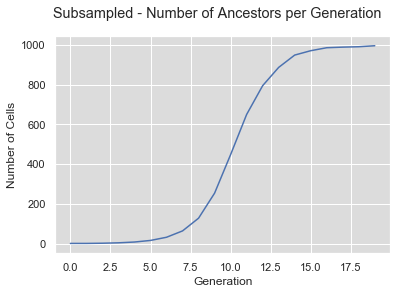

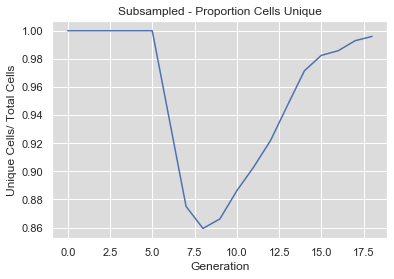

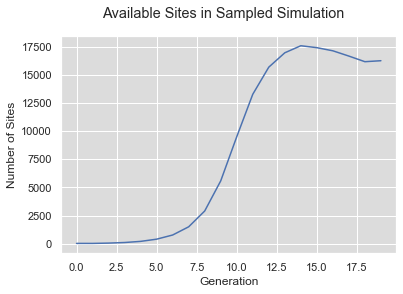

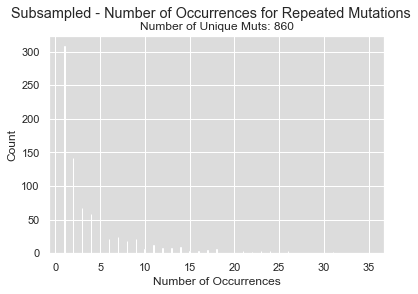

(996, 30)
Time 1: 0.019617080688476562
Compute dictionary: 31.642088174819946
Conflict matrix is symmetric?  True
Total time: 31.675495147705078
Number of true recurrent muts:  778
Number of detected recurrent muts:  1032
Number of true recurrent muts not detected: 0 with prevalence []


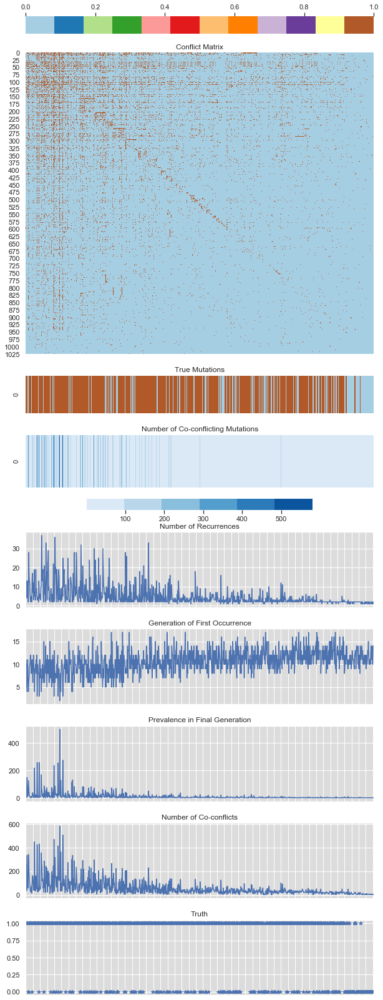

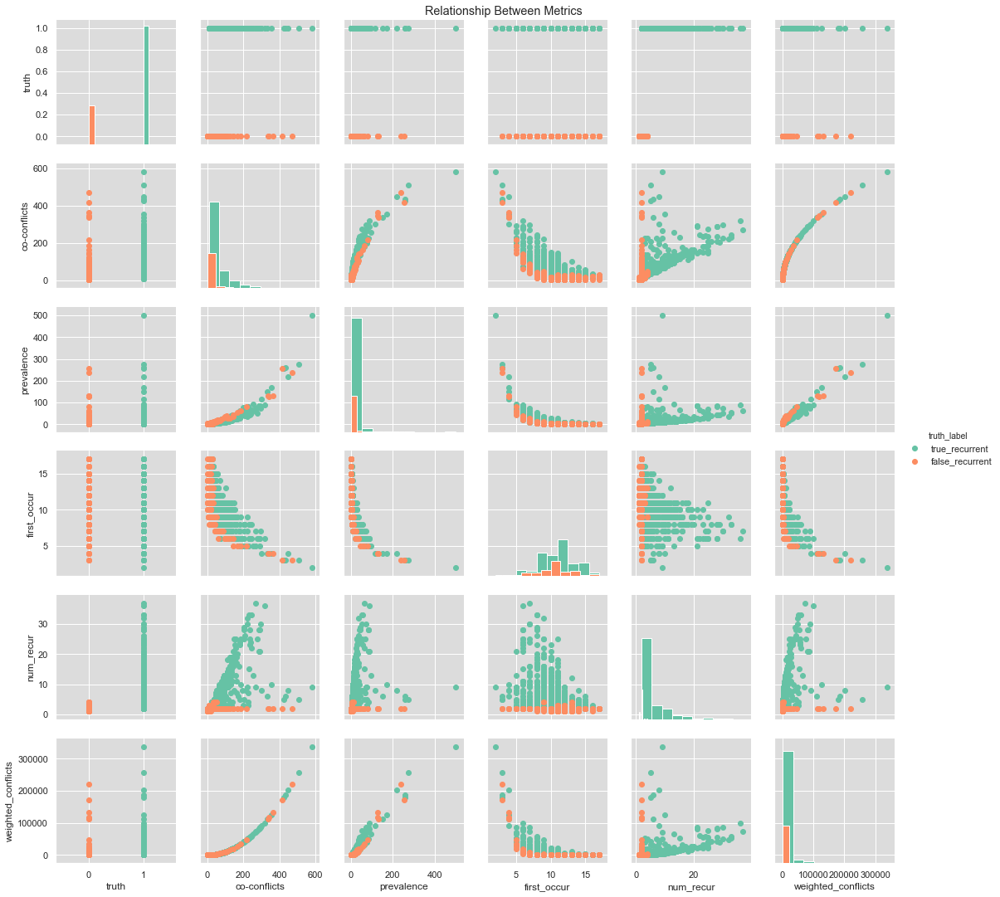

0.08452296257019043 fast?


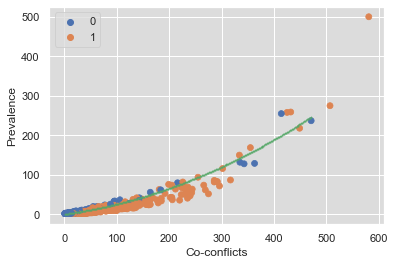

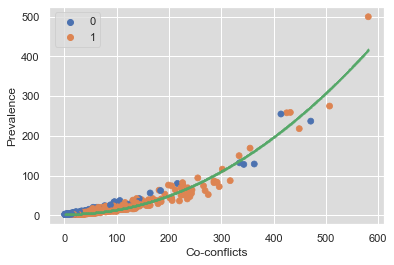

Label: smm
List of targets:  [(0, 0), (0, 1), (0, 2), (1, 0), (1, 1), (1, 2), (2, 0), (2, 1), (2, 2), (3, 0), (3, 1), (3, 2), (4, 0), (4, 1), (4, 2), (5, 0), (5, 1), (5, 2), (6, 0), (6, 1), (6, 2), (7, 0), (7, 1), (7, 2), (8, 0), (8, 1), (8, 2), (9, 0), (9, 1), (9, 2)]
ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(450,)
(647,)
(797,)
(887,)
(939,)
(967,)
(988,)
(994,)
(998,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


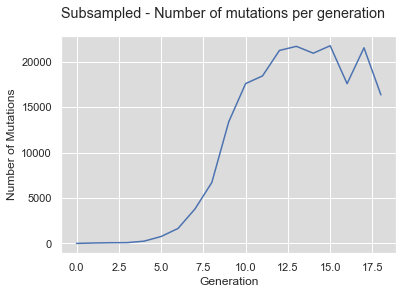

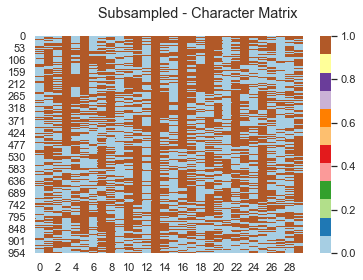

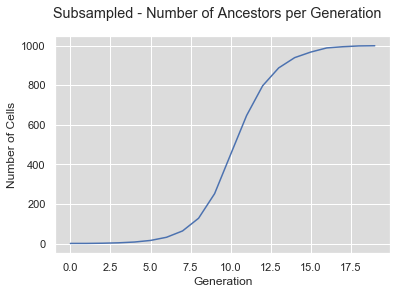

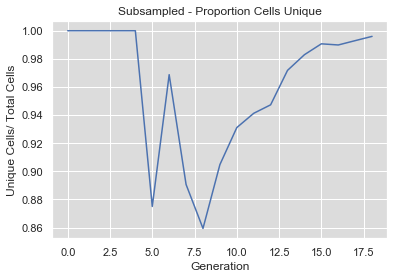

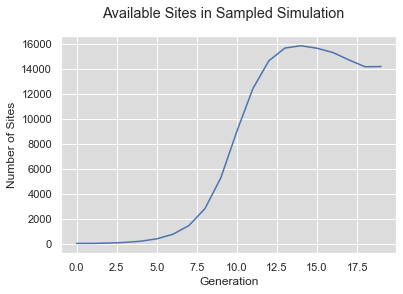

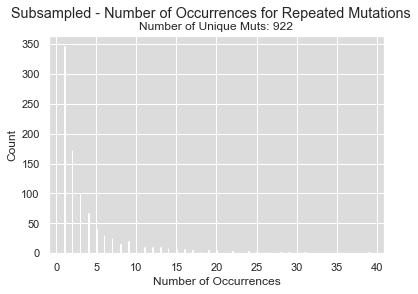

(999, 30)
Time 1: 0.024161100387573242
Compute dictionary: 38.27920413017273
Conflict matrix is symmetric?  True
Total time: 38.33400082588196
Number of true recurrent muts:  941
Number of detected recurrent muts:  1219
Number of true recurrent muts not detected: 0 with prevalence []


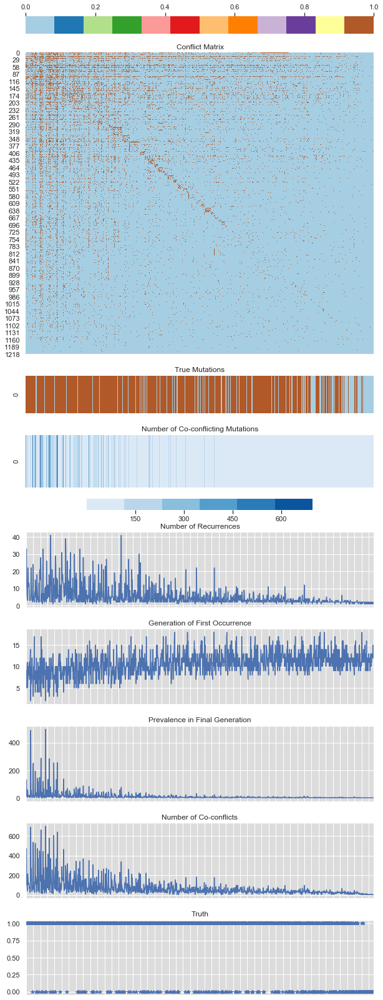

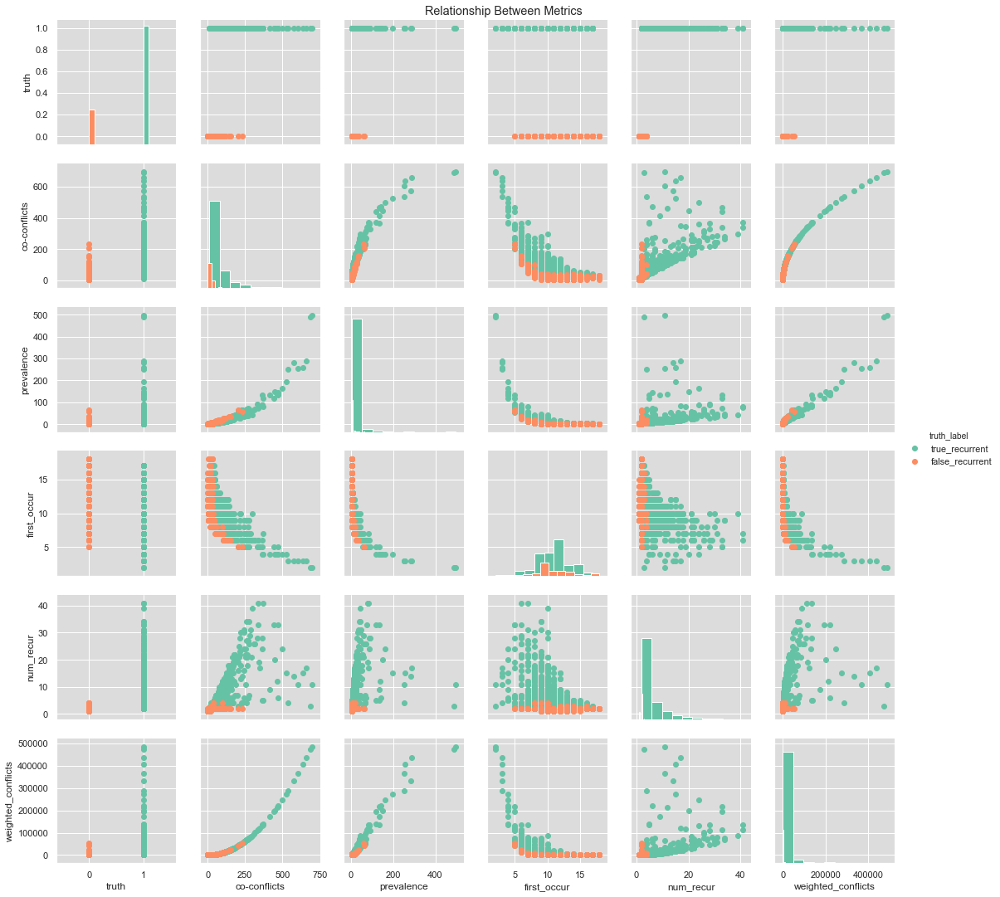

0.08375811576843262 fast?


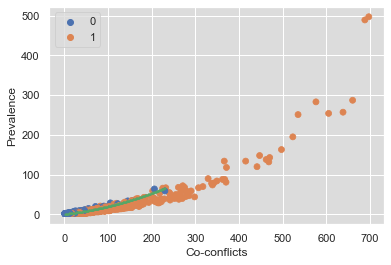

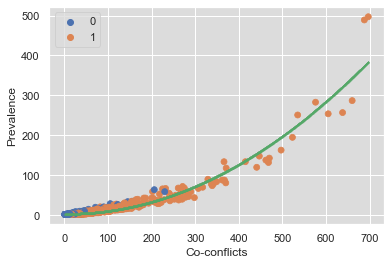

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(249,)
(438,)
(645,)
(796,)
(882,)
(940,)
(967,)
(982,)
(992,)
(995,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


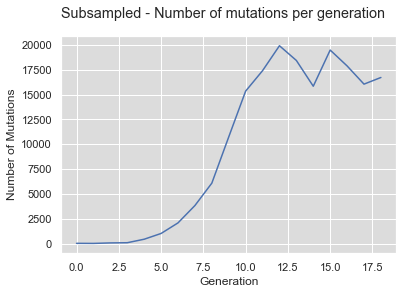

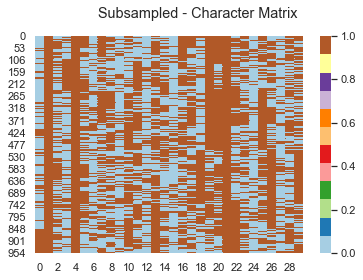

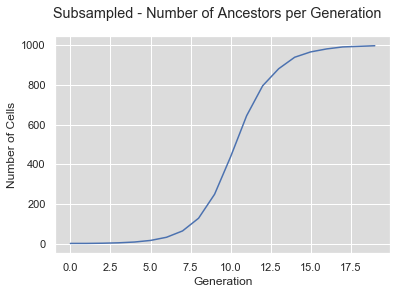

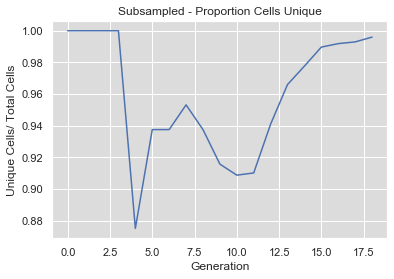

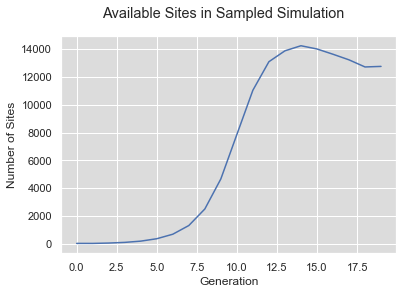

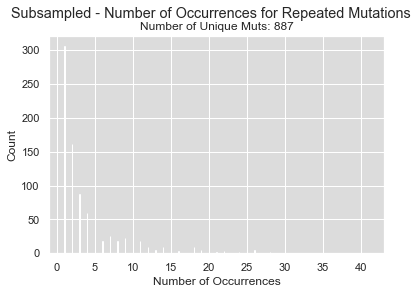

(998, 30)
Time 1: 0.02006387710571289
Compute dictionary: 33.104109048843384
Conflict matrix is symmetric?  True
Total time: 33.14258909225464
Number of true recurrent muts:  843
Number of detected recurrent muts:  1070
Number of true recurrent muts not detected: 2 with prevalence [998, 998]


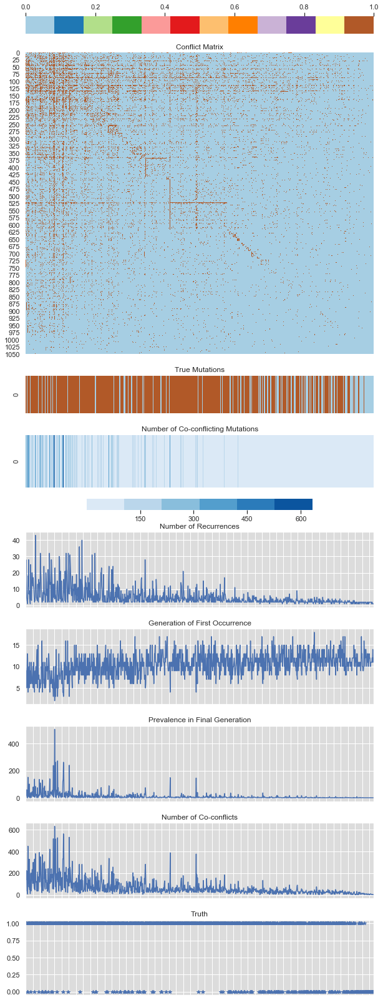

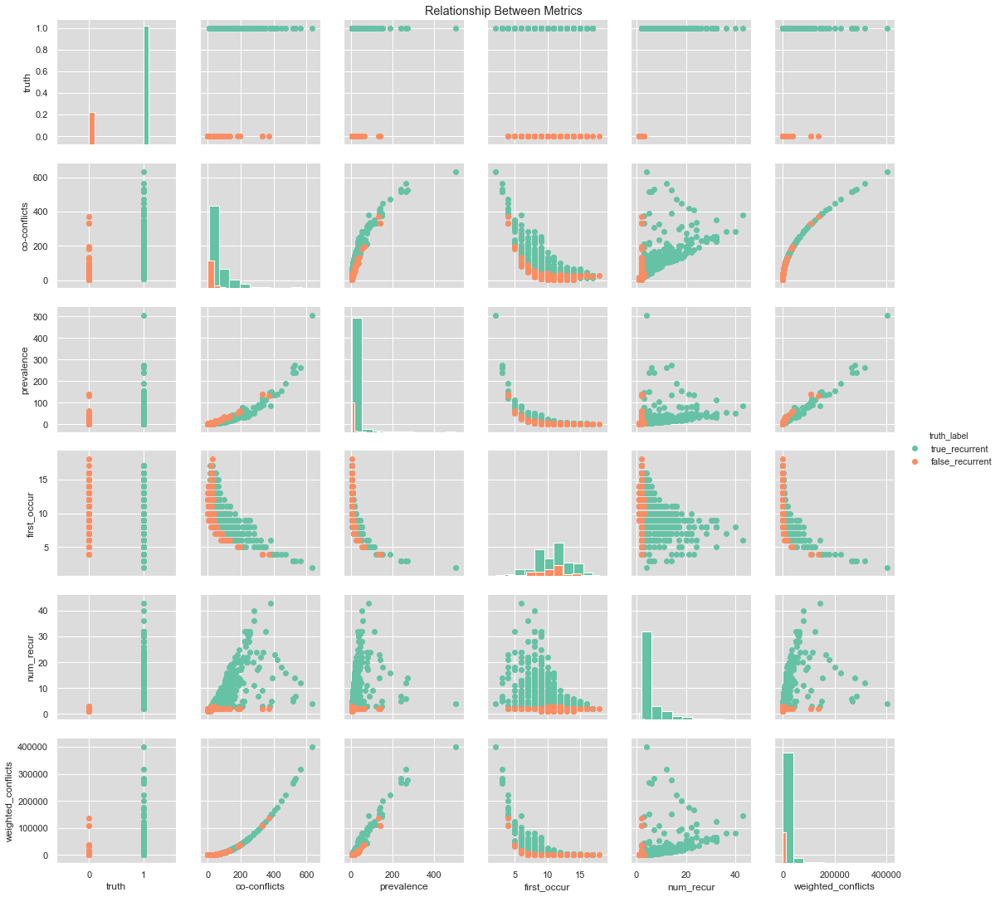

0.0788431167602539 fast?


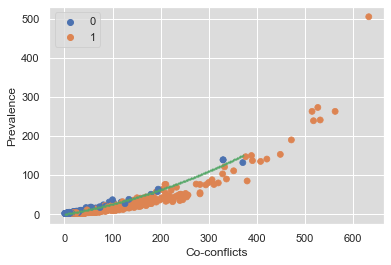

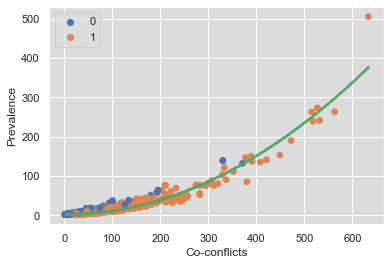

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(251,)
(429,)
(628,)
(797,)
(892,)
(946,)
(976,)
(987,)
(997,)
(998,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


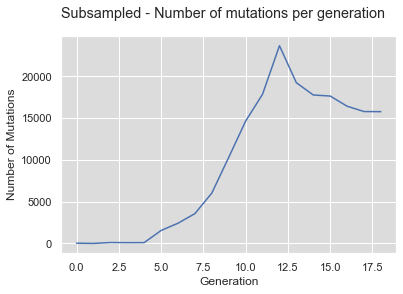

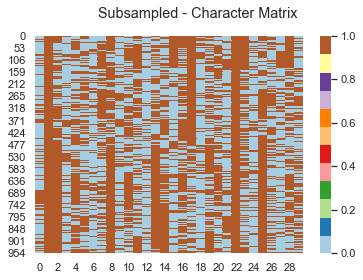

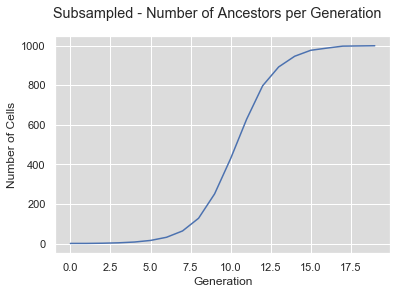

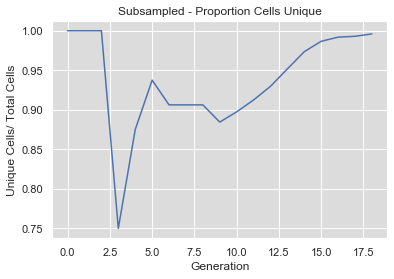

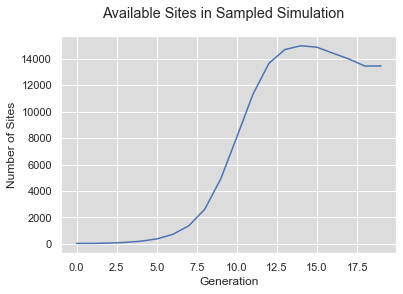

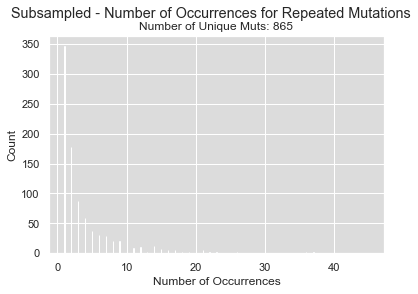

(999, 30)
Time 1: 0.021260976791381836
Compute dictionary: 34.43733096122742
Conflict matrix is symmetric?  True
Total time: 34.4822940826416
Number of true recurrent muts:  900
Number of detected recurrent muts:  1124
Number of true recurrent muts not detected: 2 with prevalence [999, 999]


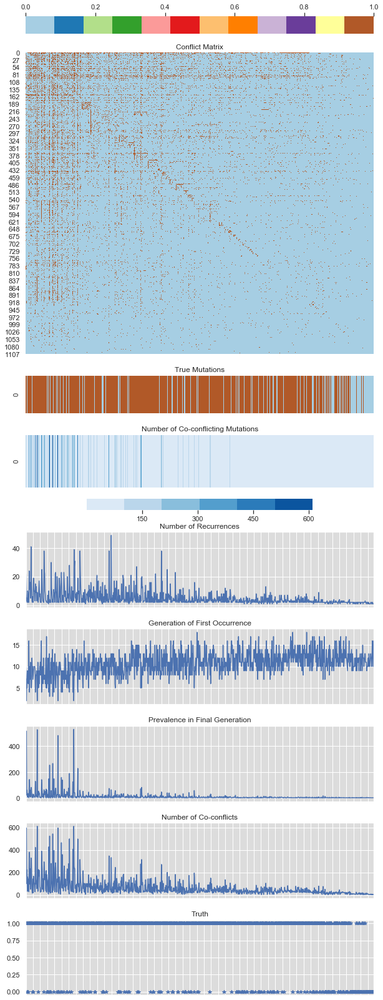

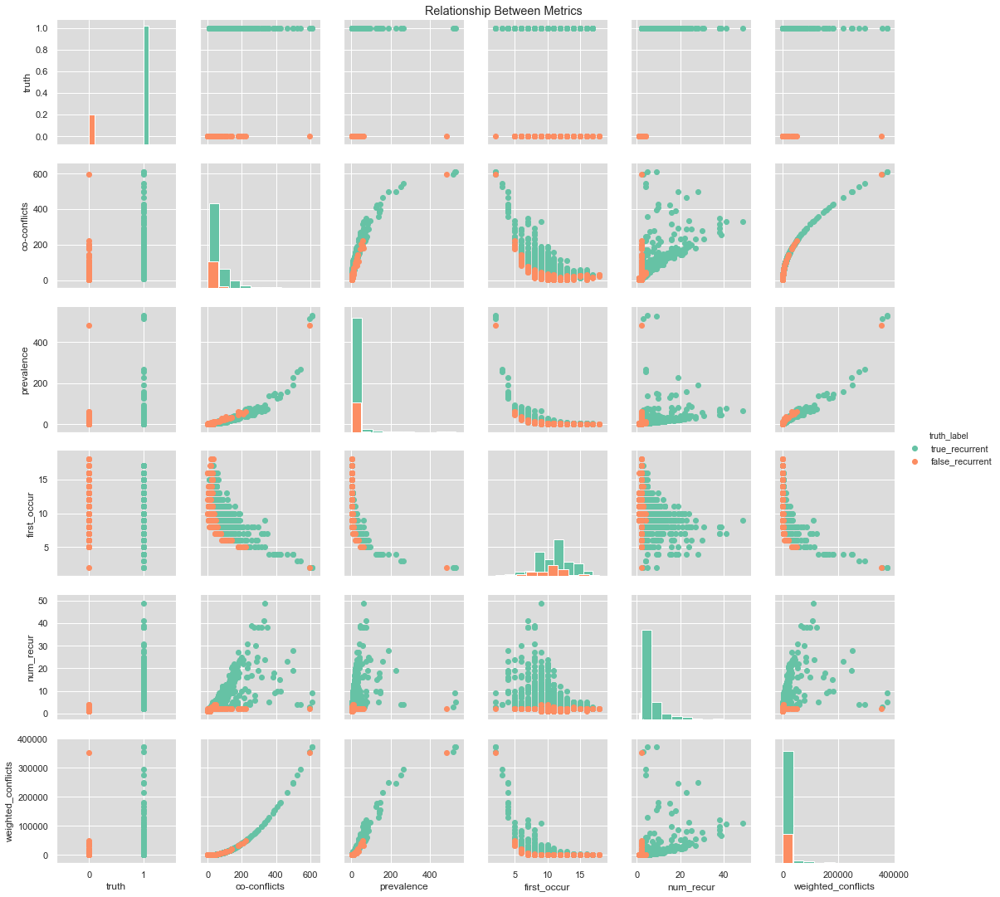

0.08209419250488281 fast?


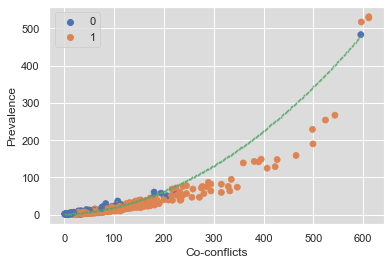

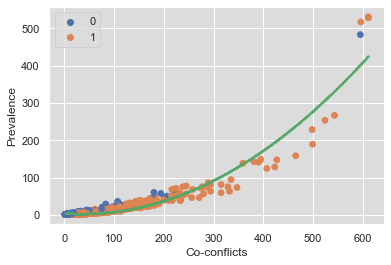

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(442,)
(649,)
(787,)
(898,)
(942,)
(966,)
(981,)
(989,)
(995,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


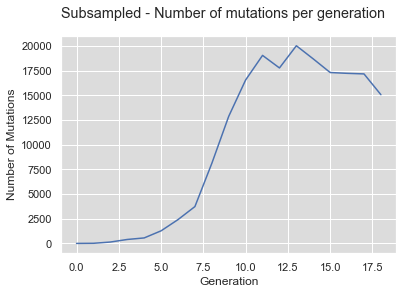

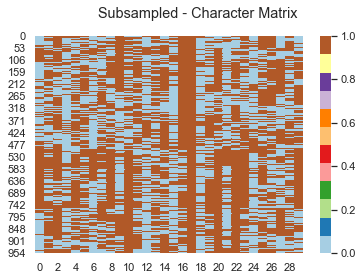

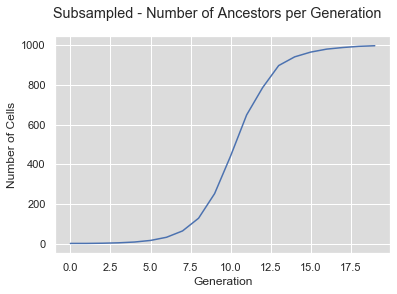

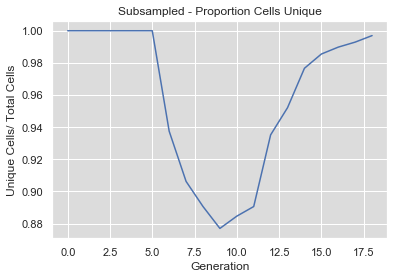

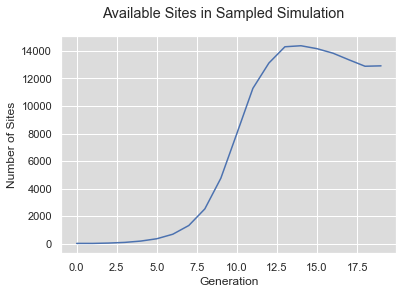

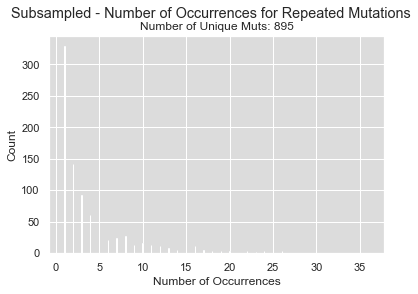

(998, 30)
Time 1: 0.02167510986328125
Compute dictionary: 35.965224266052246
Conflict matrix is symmetric?  True
Total time: 36.01595115661621
Number of true recurrent muts:  850
Number of detected recurrent muts:  1141
Number of true recurrent muts not detected: 0 with prevalence []


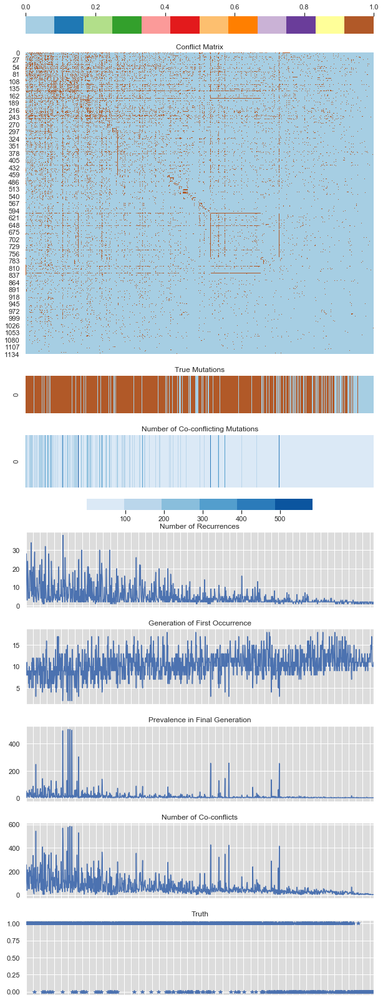

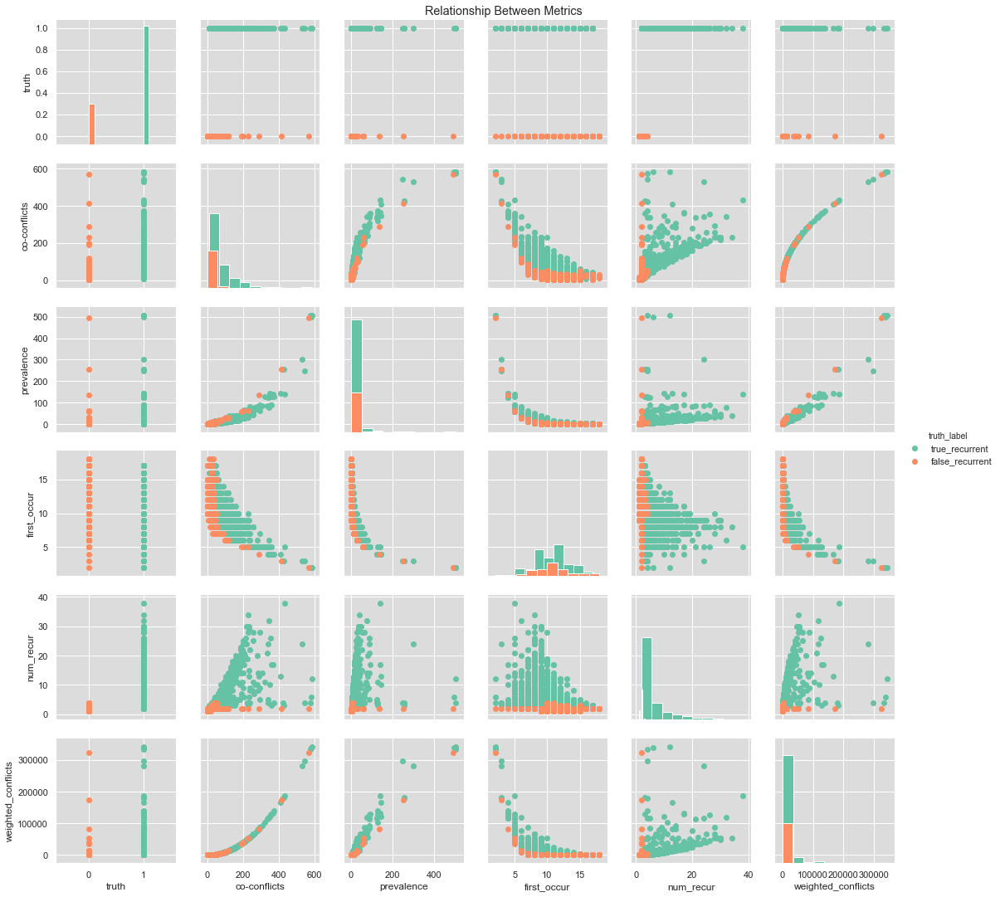

0.09014558792114258 fast?


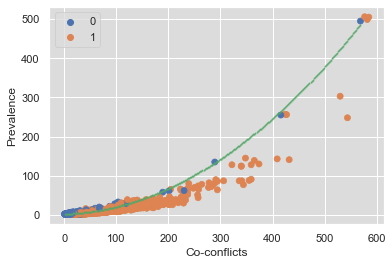

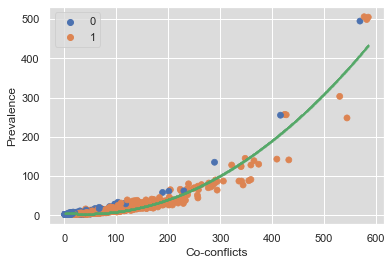

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(249,)
(442,)
(641,)
(784,)
(883,)
(938,)
(974,)
(989,)
(995,)
(999,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


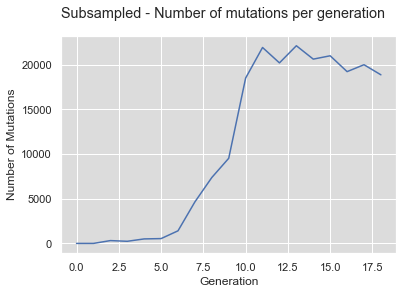

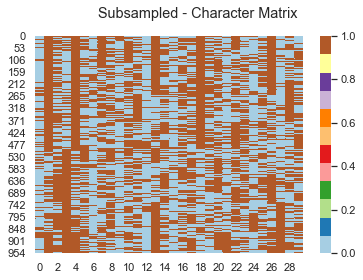

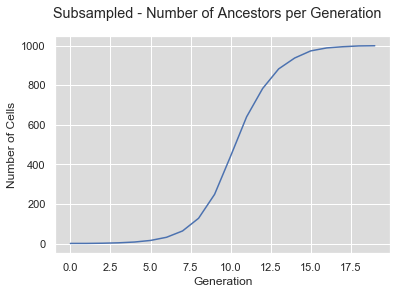

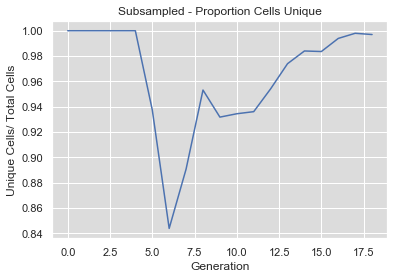

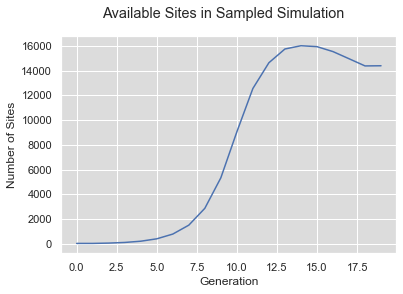

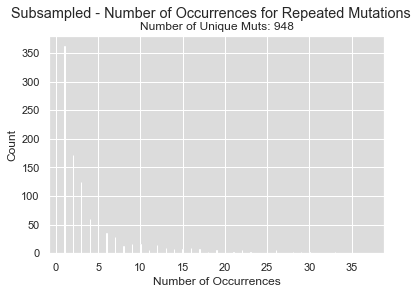

(1000, 30)
Time 1: 0.023463010787963867
Compute dictionary: 37.205475091934204
Conflict matrix is symmetric?  True
Total time: 37.26062488555908
Number of true recurrent muts:  964
Number of detected recurrent muts:  1221
Number of true recurrent muts not detected: 0 with prevalence []


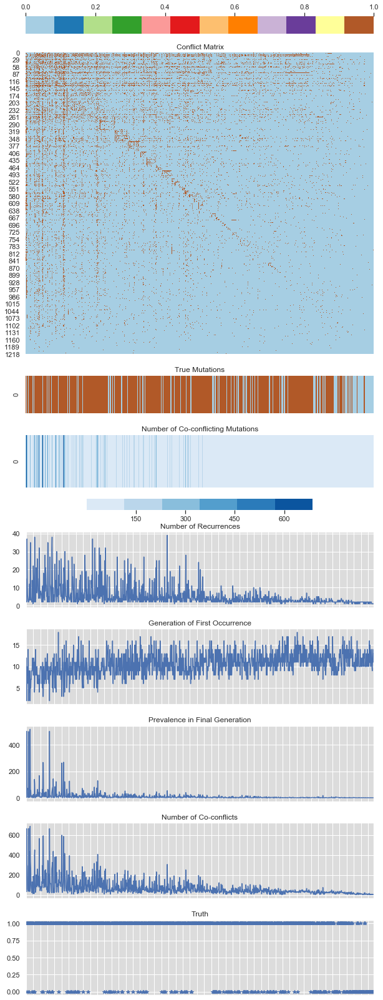

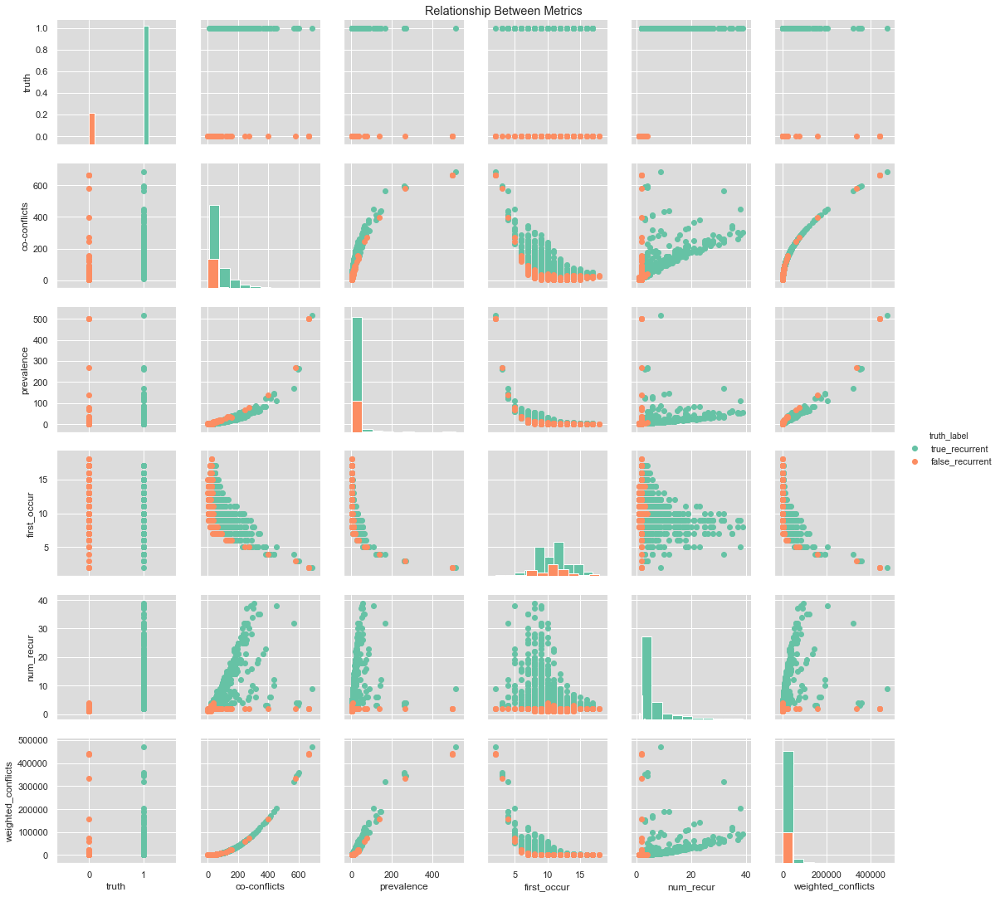

0.08845281600952148 fast?


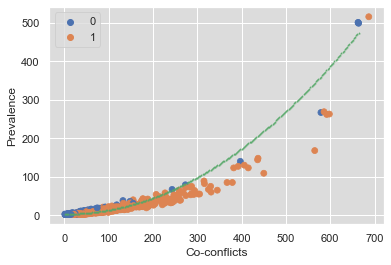

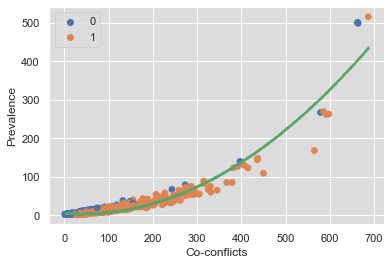

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(250,)
(438,)
(635,)
(793,)
(886,)
(943,)
(971,)
(987,)
(992,)
(996,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


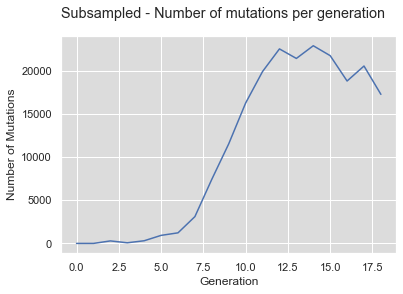

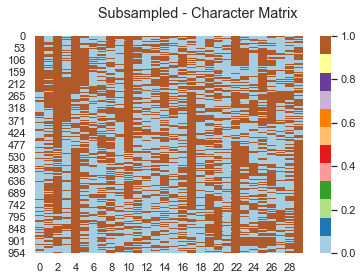

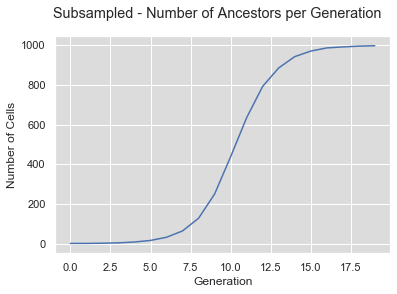

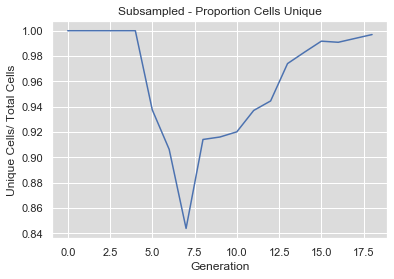

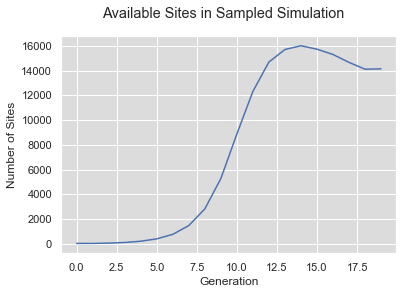

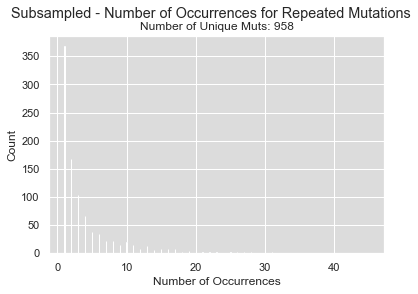

(998, 30)
Time 1: 0.023177385330200195
Compute dictionary: 36.46583604812622
Conflict matrix is symmetric?  True
Total time: 36.52034020423889
Number of true recurrent muts:  959
Number of detected recurrent muts:  1223
Number of true recurrent muts not detected: 0 with prevalence []


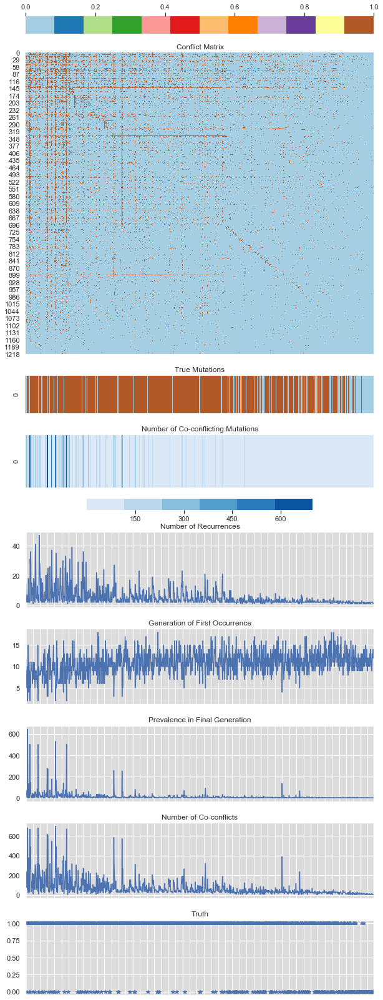

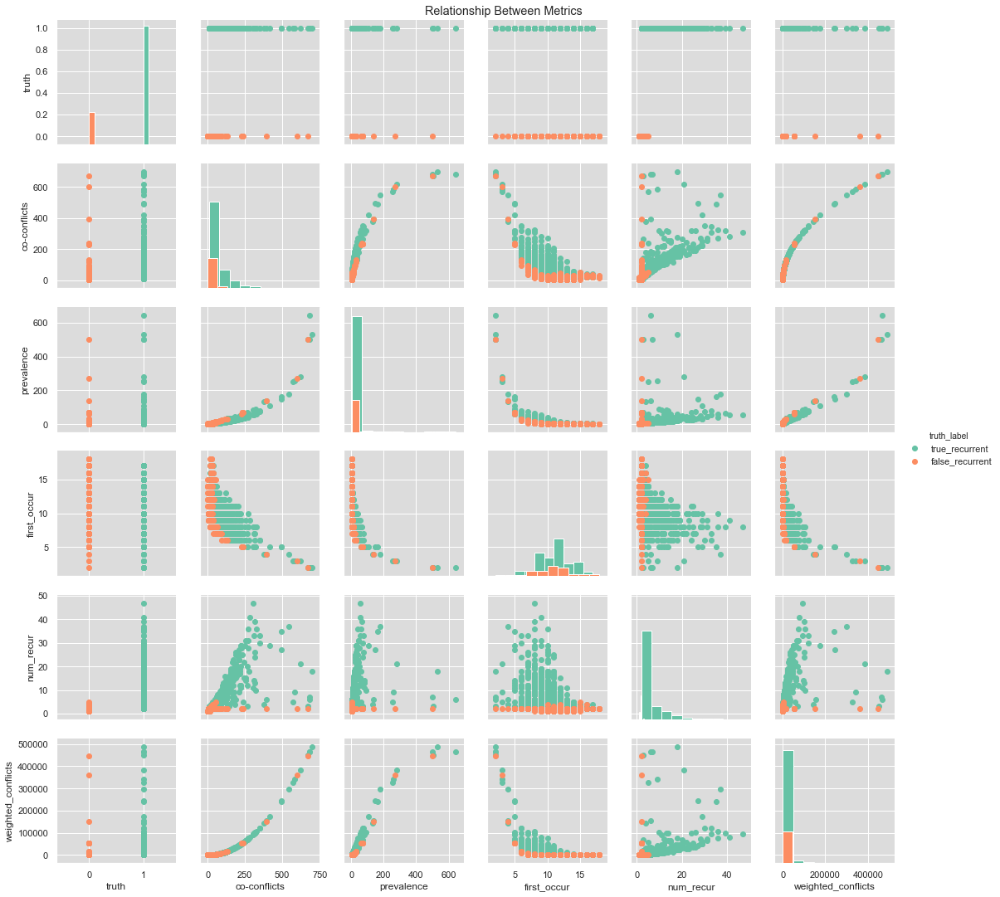

0.08540201187133789 fast?


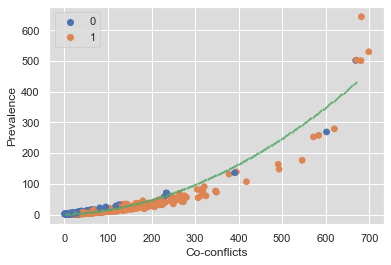

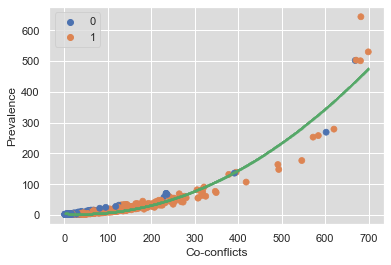

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(251,)
(449,)
(655,)
(800,)
(899,)
(952,)
(976,)
(987,)
(997,)
(998,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


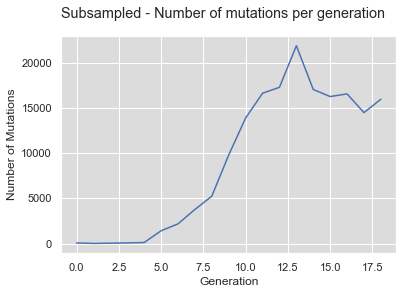

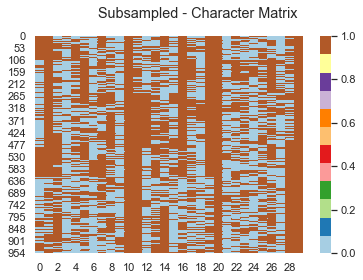

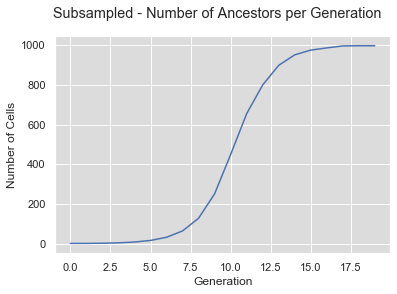

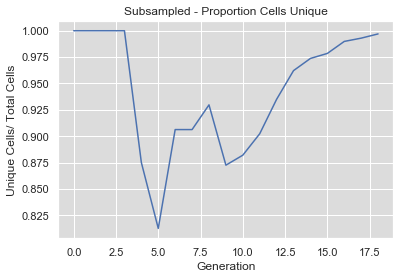

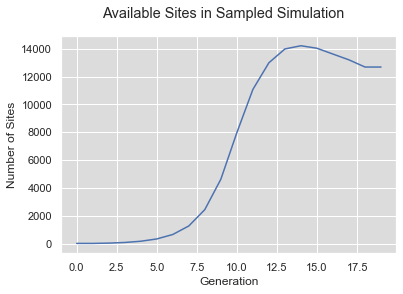

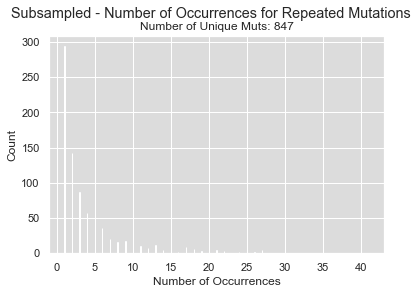

(998, 30)
Time 1: 0.017488956451416016
Compute dictionary: 33.74899411201477
Conflict matrix is symmetric?  True
Total time: 33.785332918167114
Number of true recurrent muts:  805
Number of detected recurrent muts:  1019
Number of true recurrent muts not detected: 2 with prevalence [998, 998]


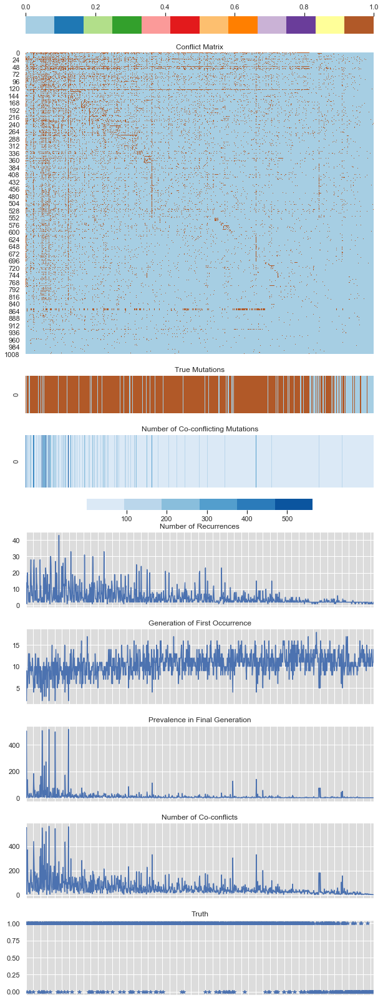

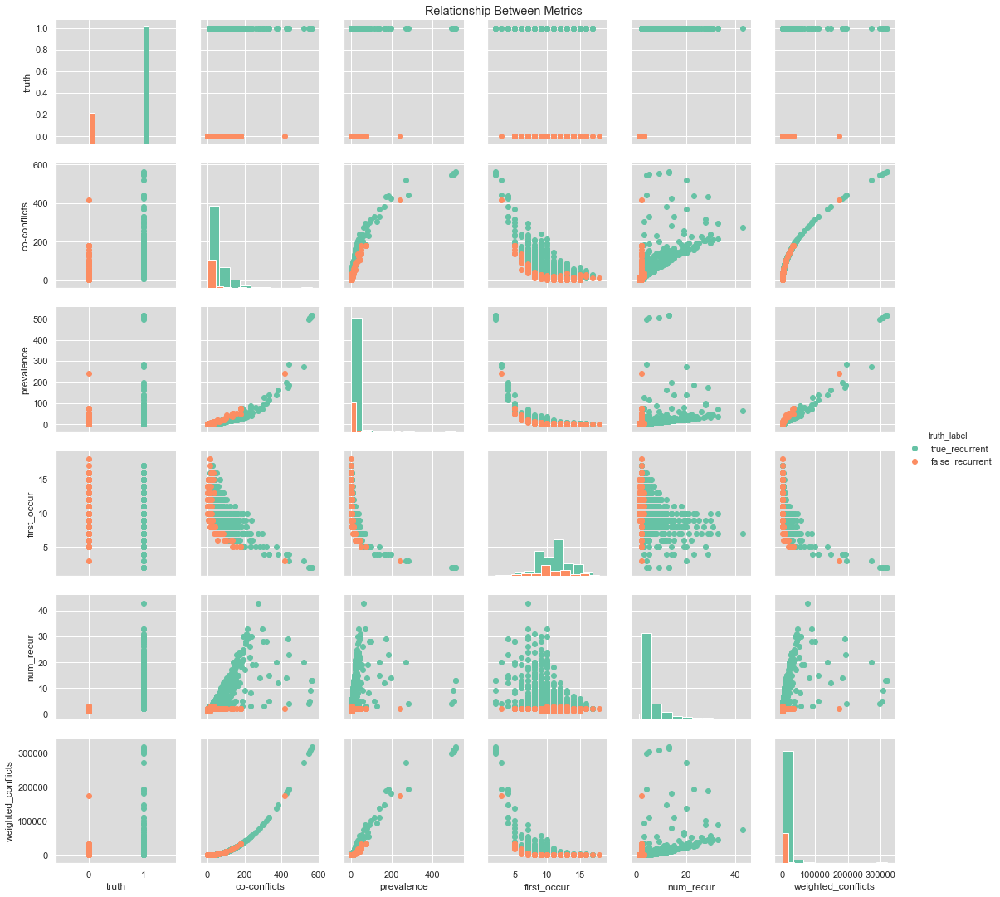

0.08352303504943848 fast?


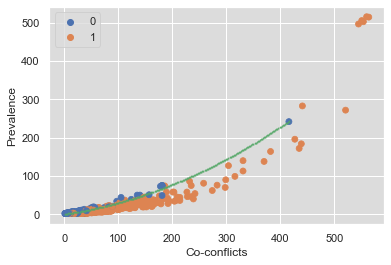

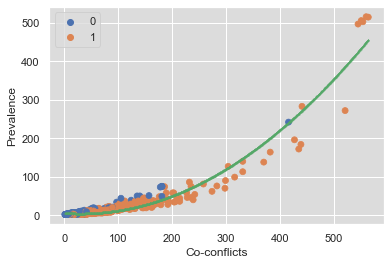

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(253,)
(440,)
(635,)
(794,)
(896,)
(951,)
(976,)
(985,)
(990,)
(994,)
(997,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


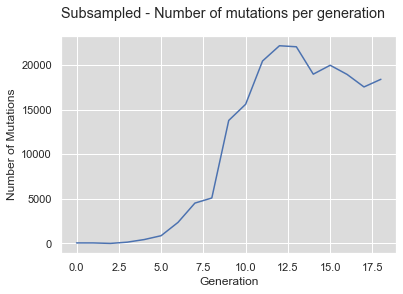

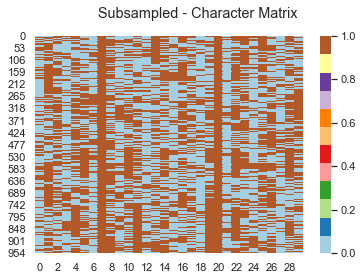

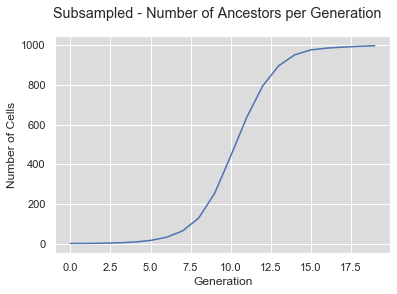

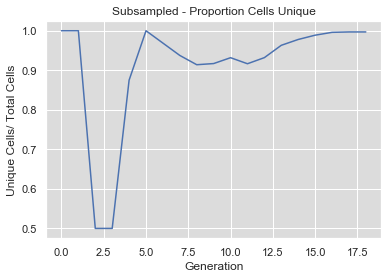

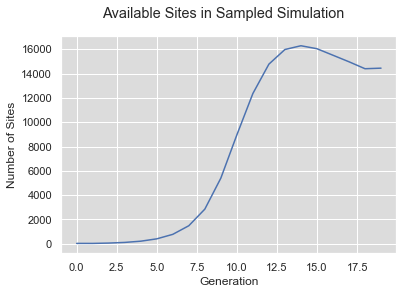

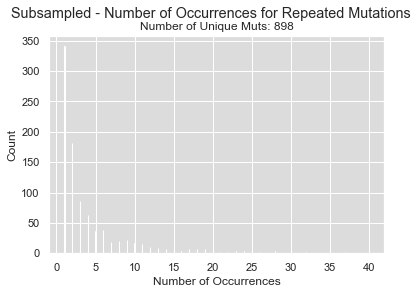

(997, 30)
Time 1: 0.01794600486755371
Compute dictionary: 39.237879037857056
Conflict matrix is symmetric?  True
Total time: 39.295555114746094
Number of true recurrent muts:  928
Number of detected recurrent muts:  1196
Number of true recurrent muts not detected: 1 with prevalence [997]


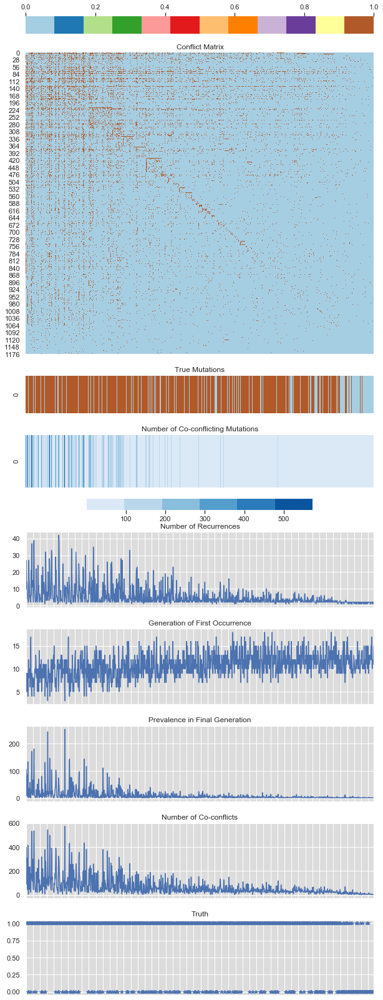

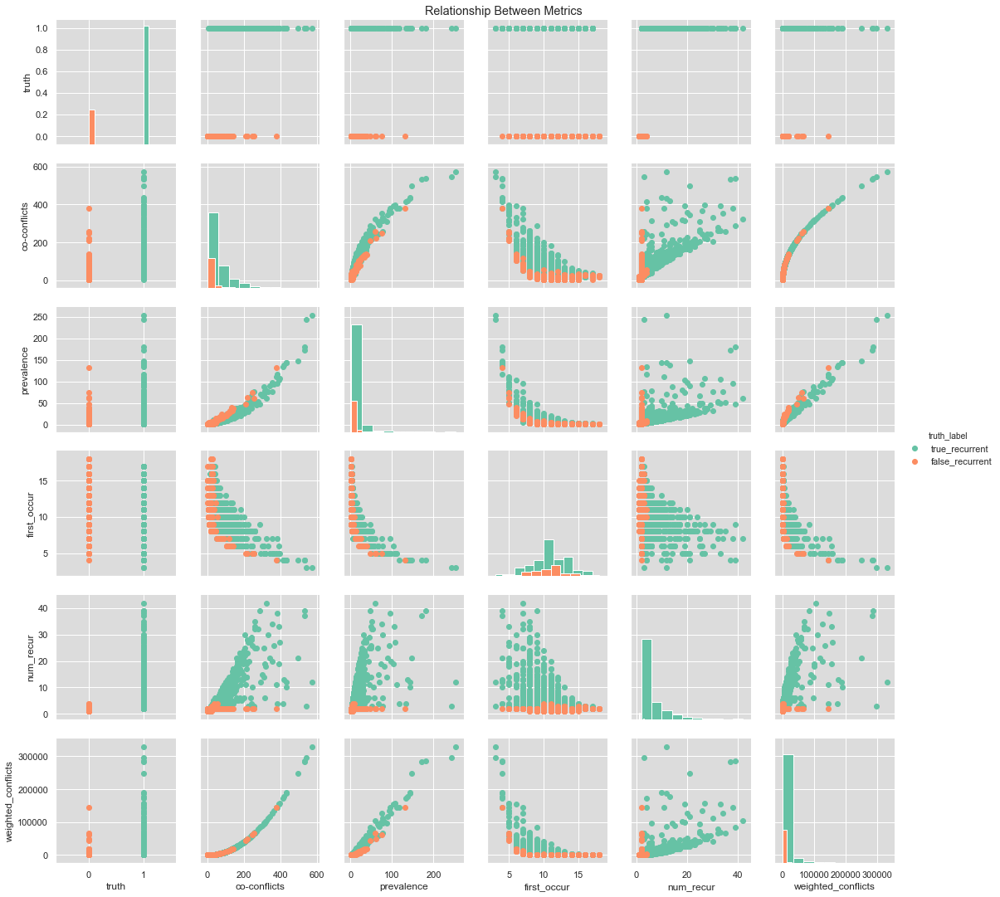

0.08492016792297363 fast?


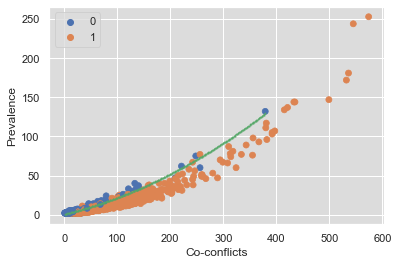

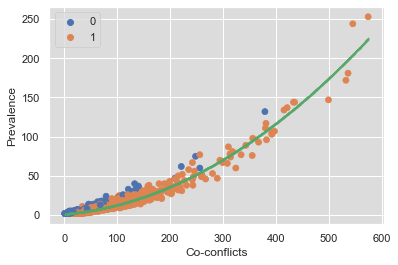

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(438,)
(643,)
(786,)
(883,)
(933,)
(971,)
(986,)
(991,)
(995,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


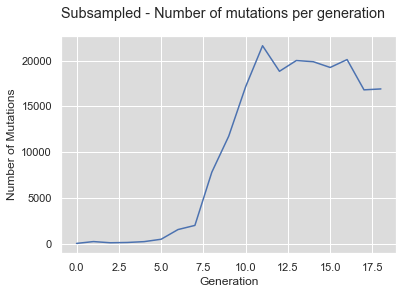

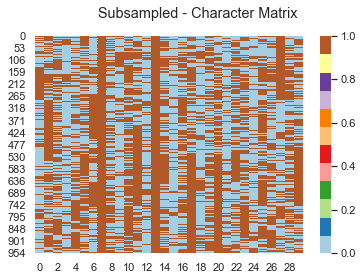

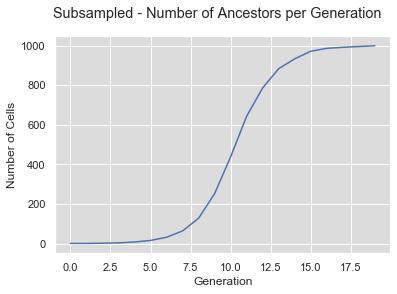

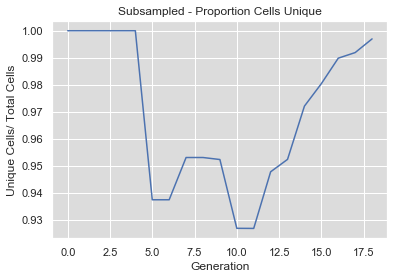

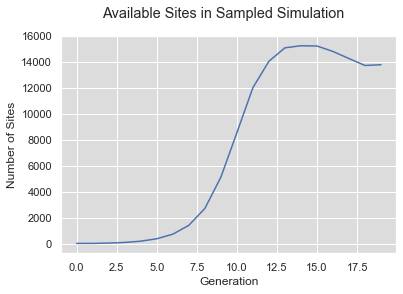

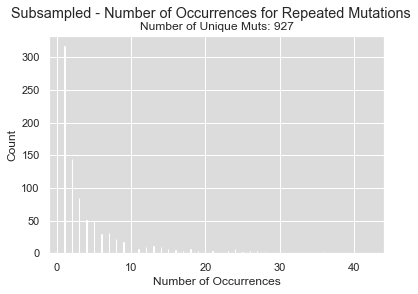

(999, 30)
Time 1: 0.022168874740600586
Compute dictionary: 37.16746807098389
Conflict matrix is symmetric?  True
Total time: 37.212722063064575
Number of true recurrent muts:  865
Number of detected recurrent muts:  1134
Number of true recurrent muts not detected: 1 with prevalence [999]


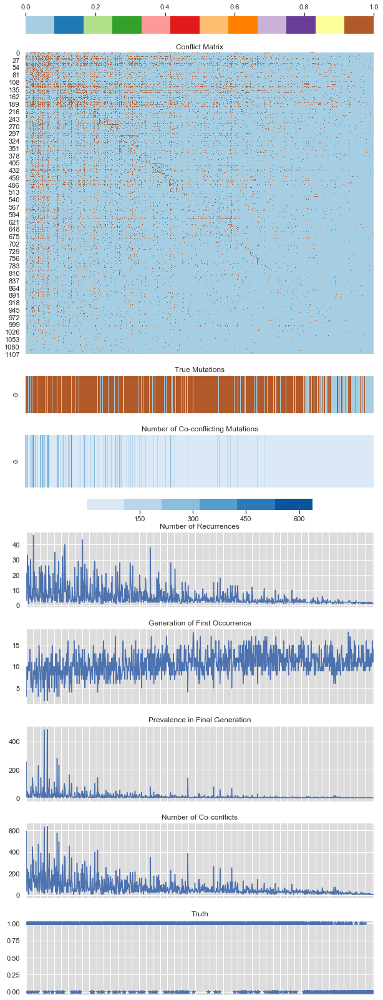

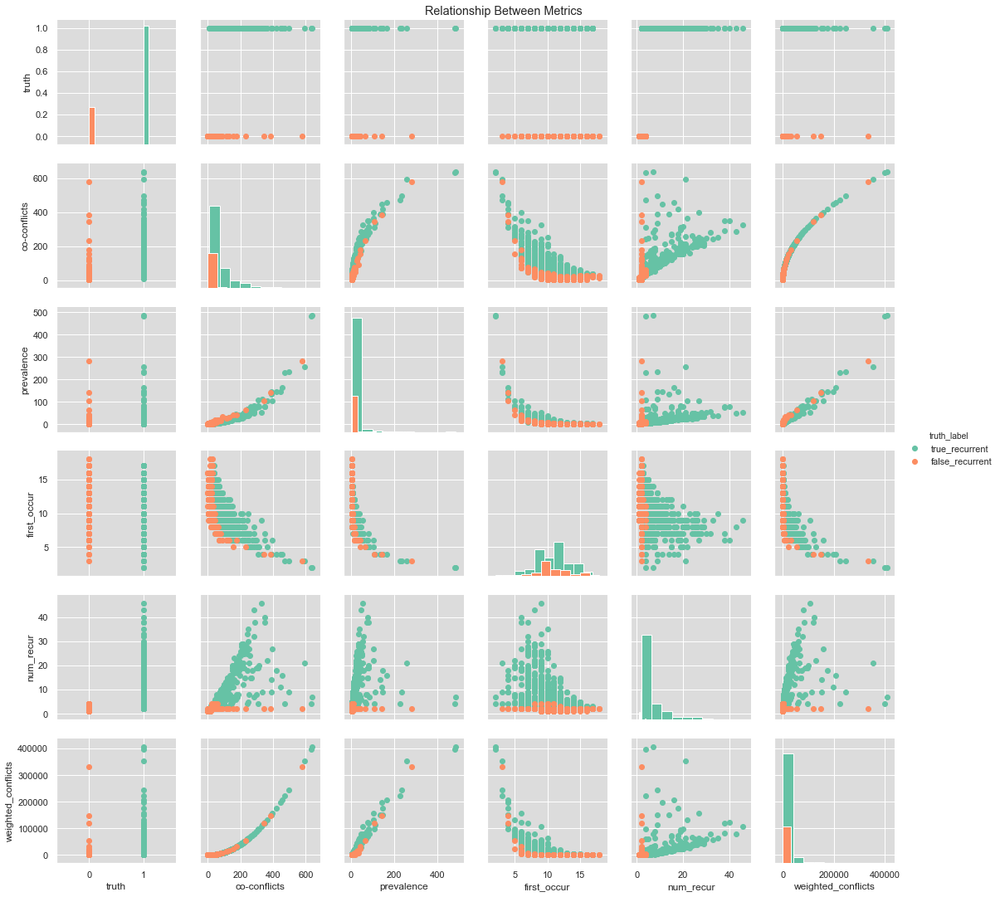

0.10188674926757812 fast?


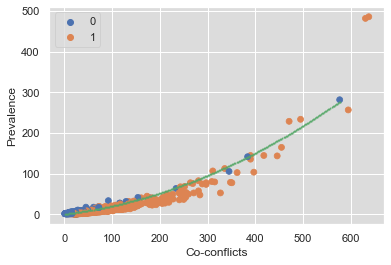

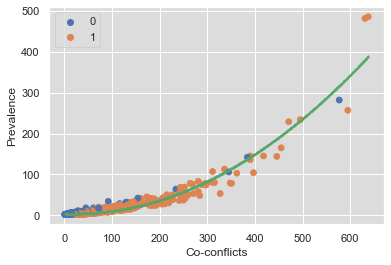

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(247,)
(438,)
(647,)
(807,)
(892,)
(944,)
(972,)
(982,)
(993,)
(997,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


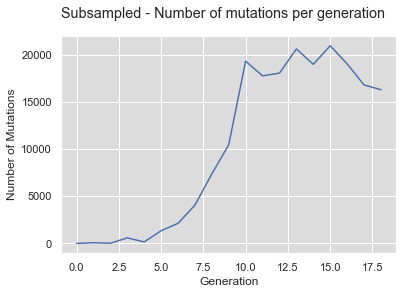

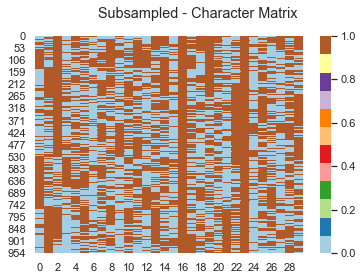

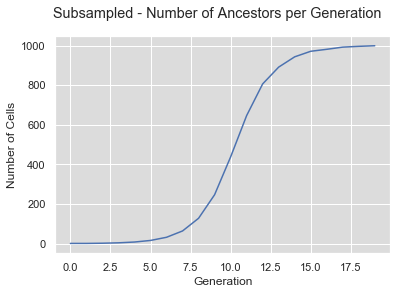

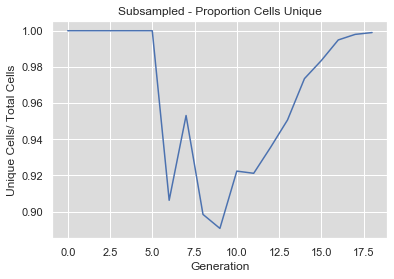

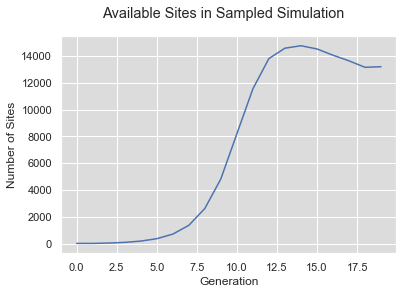

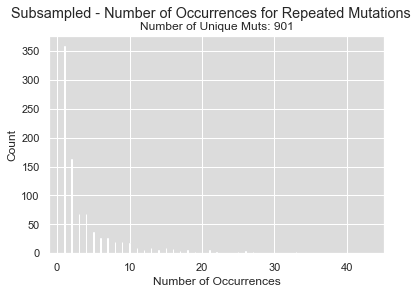

(1000, 30)
Time 1: 0.029546022415161133
Compute dictionary: 41.32121396064758
Conflict matrix is symmetric?  True
Total time: 41.368074893951416
Number of true recurrent muts:  895
Number of detected recurrent muts:  1136
Number of true recurrent muts not detected: 0 with prevalence []


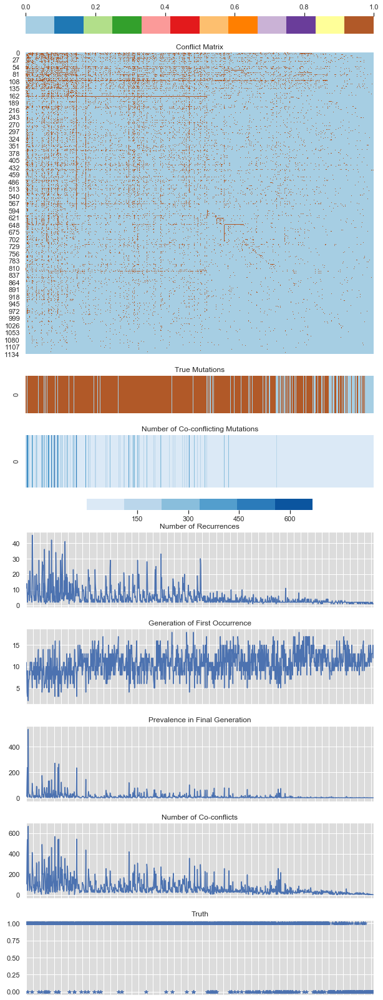

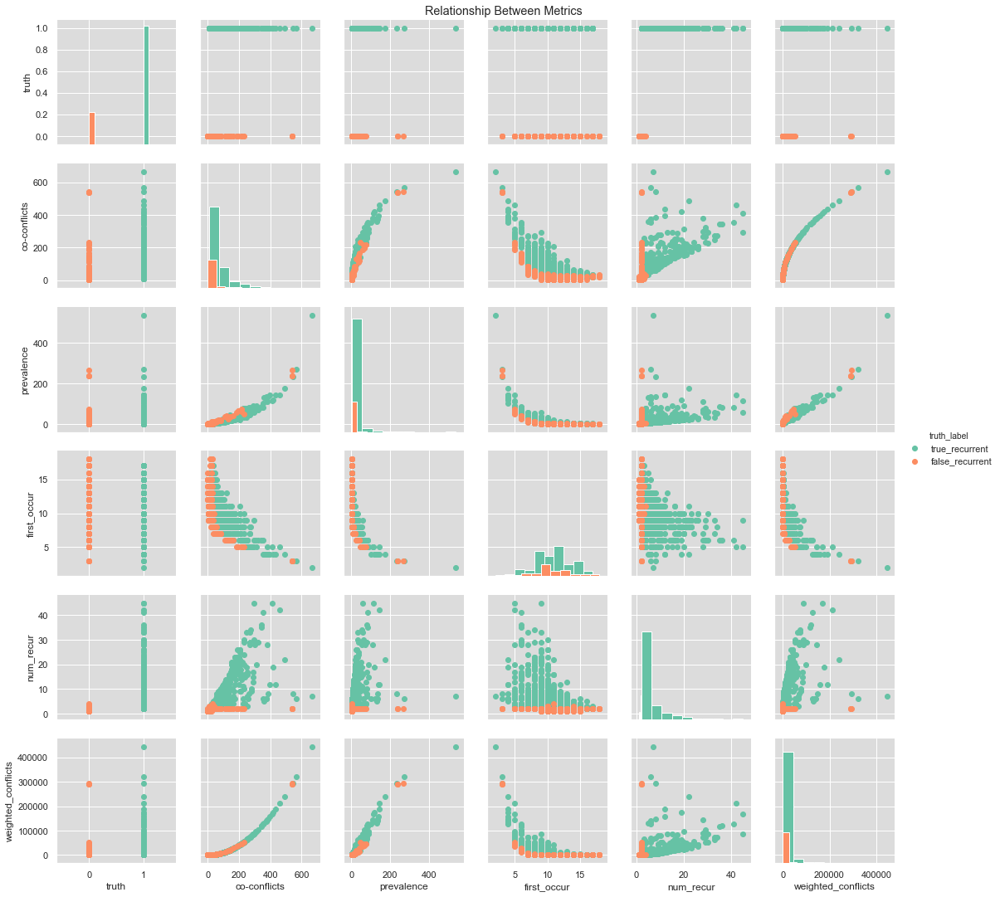

0.10838484764099121 fast?


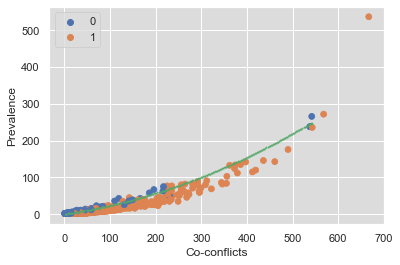

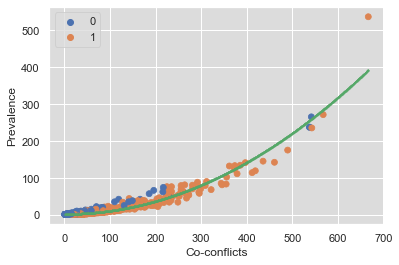

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(248,)
(441,)
(645,)
(793,)
(887,)
(936,)
(974,)
(989,)
(992,)
(998,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


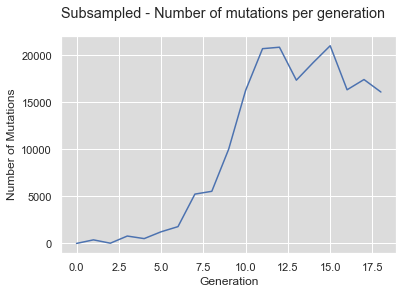

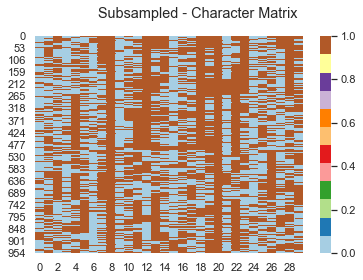

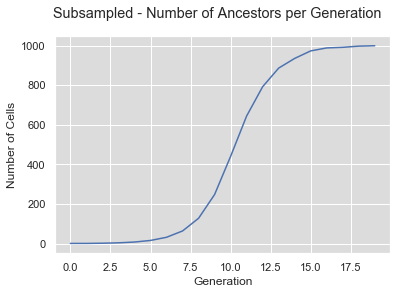

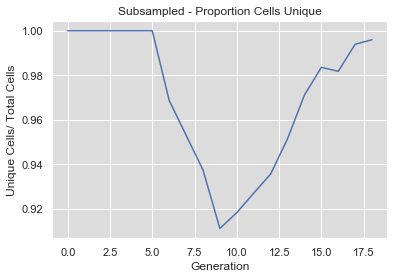

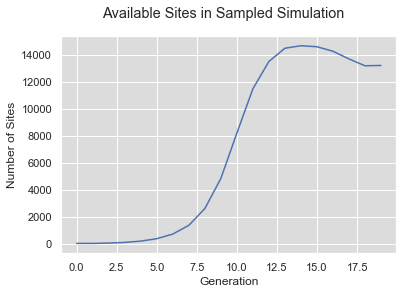

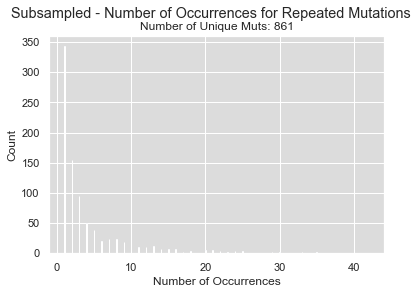

(1000, 30)
Time 1: 0.02324986457824707
Compute dictionary: 39.55507302284241
Conflict matrix is symmetric?  True
Total time: 39.60359287261963
Number of true recurrent muts:  879
Number of detected recurrent muts:  1163
Number of true recurrent muts not detected: 0 with prevalence []


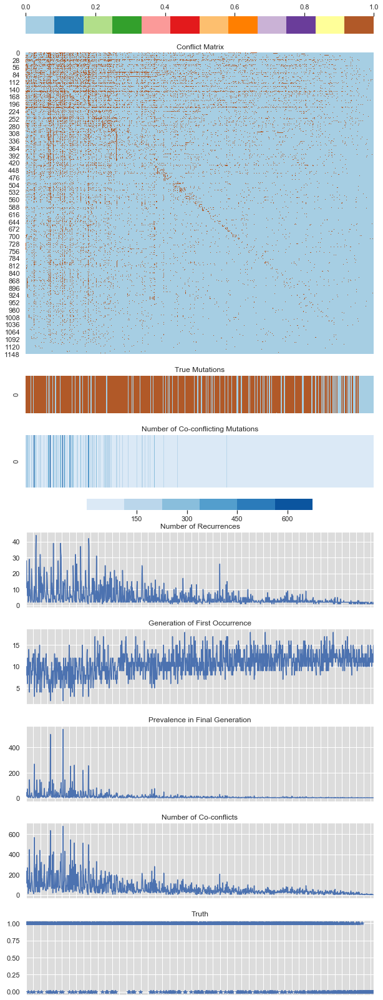

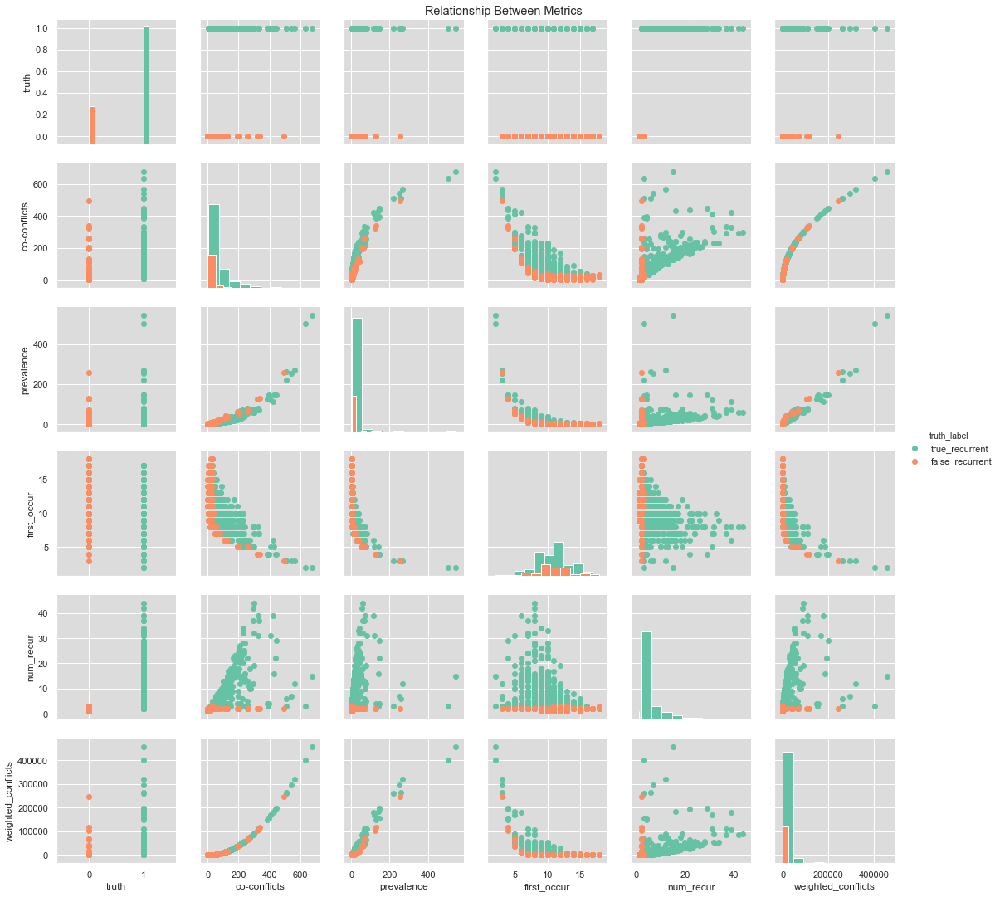

0.08394289016723633 fast?


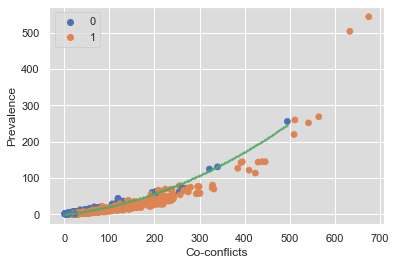

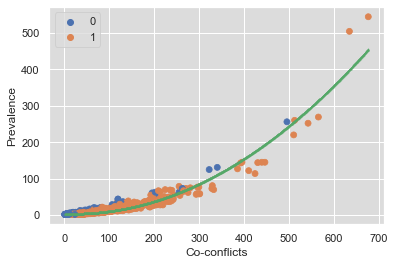

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(253,)
(430,)
(633,)
(791,)
(889,)
(936,)
(966,)
(984,)
(995,)
(998,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


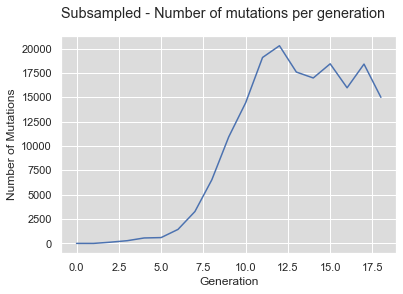

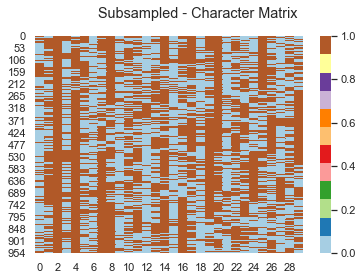

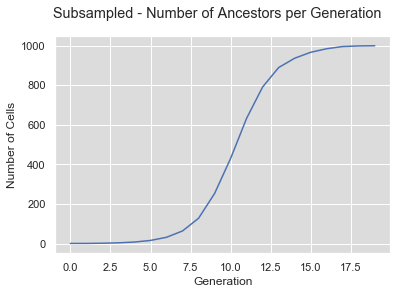

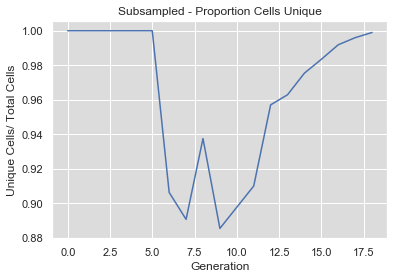

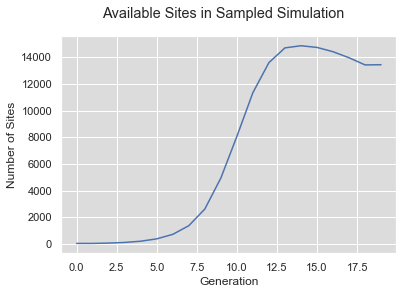

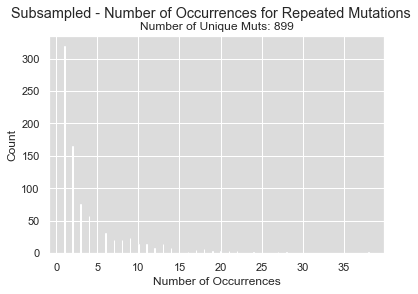

(999, 30)
Time 1: 0.022693157196044922
Compute dictionary: 34.41712999343872
Conflict matrix is symmetric?  True
Total time: 34.4628369808197
Number of true recurrent muts:  864
Number of detected recurrent muts:  1104
Number of true recurrent muts not detected: 1 with prevalence [999]


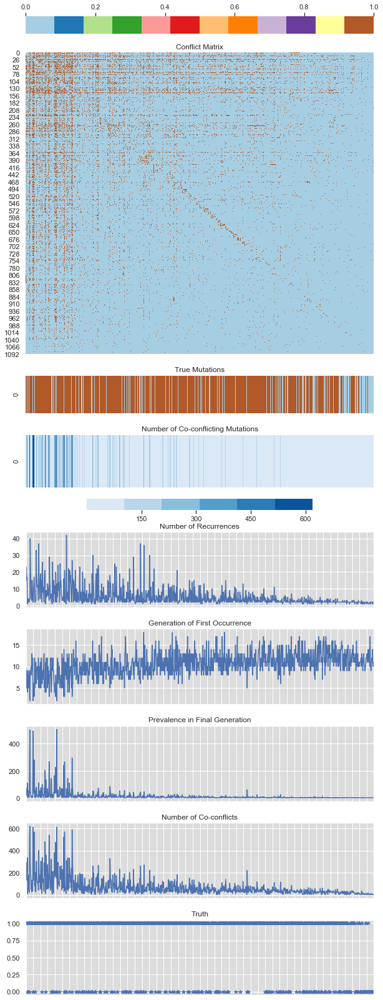

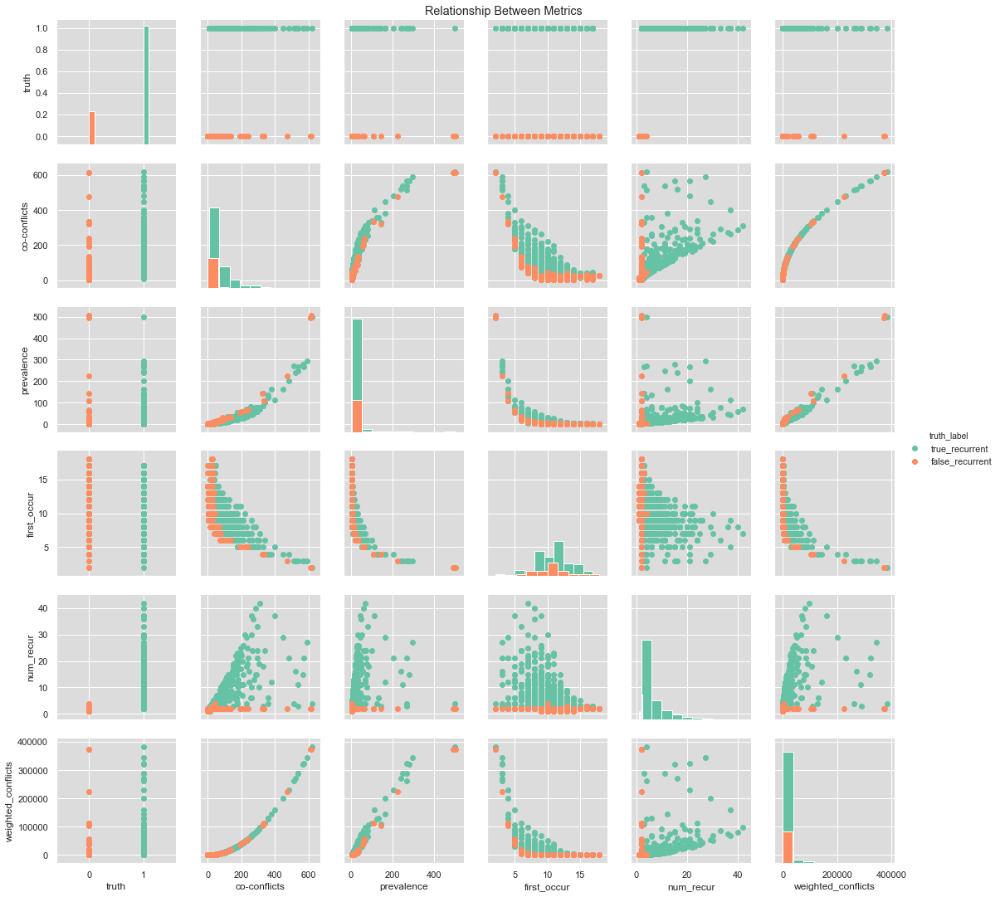

0.09275412559509277 fast?


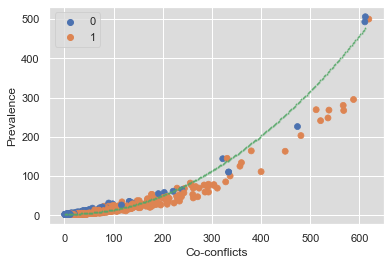

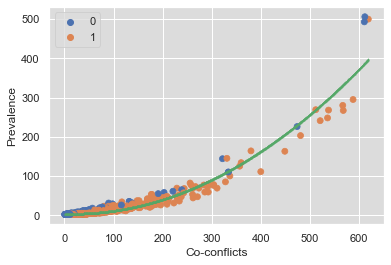

Label: ssf
List of targets:  [(0, 0), (0, 1), (0, 2), (1, 0), (1, 1), (1, 2), (2, 0), (2, 1), (2, 2), (3, 0), (3, 1), (3, 2), (4, 0), (4, 1), (4, 2), (5, 0), (5, 1), (5, 2), (6, 0), (6, 1), (6, 2), (7, 0), (7, 1), (7, 2), (8, 0), (8, 1), (8, 2), (9, 0), (9, 1), (9, 2)]
ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(253,)
(446,)
(656,)
(815,)
(897,)
(941,)
(967,)
(987,)
(993,)
(995,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


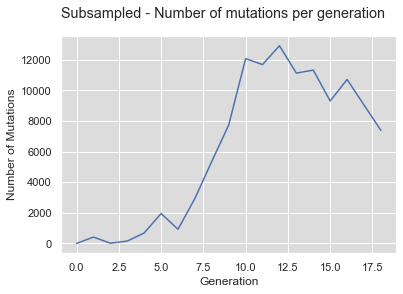

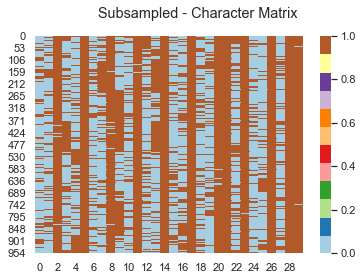

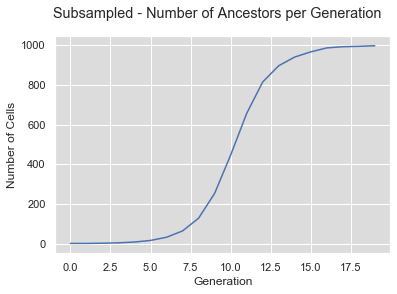

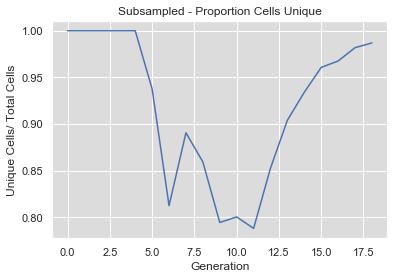

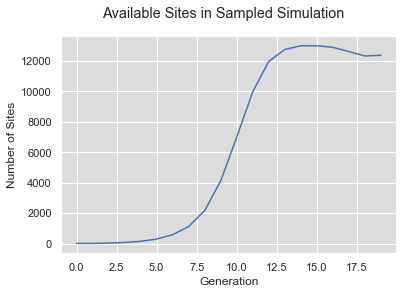

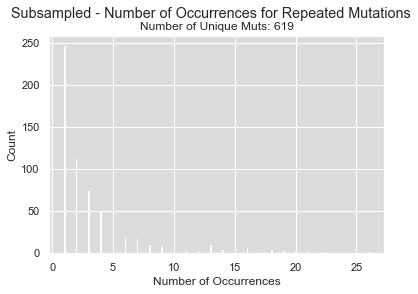

(998, 30)
Time 1: 0.016419172286987305
Compute dictionary: 27.35999321937561
Conflict matrix is symmetric?  True
Total time: 27.382684230804443
Number of true recurrent muts:  624
Number of detected recurrent muts:  822
Number of true recurrent muts not detected: 2 with prevalence [998, 998]


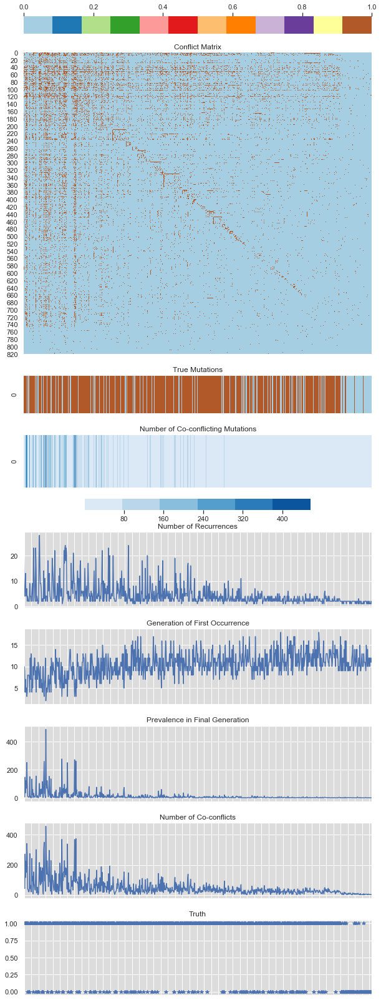

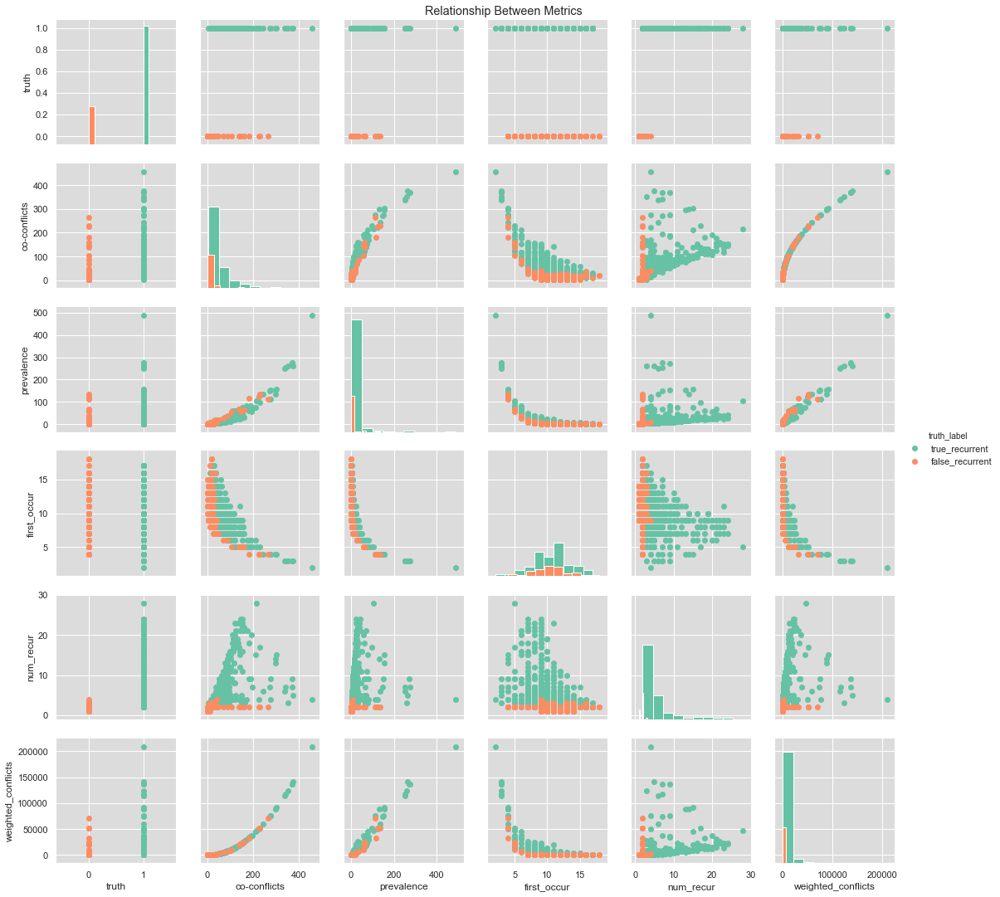

0.08162498474121094 fast?


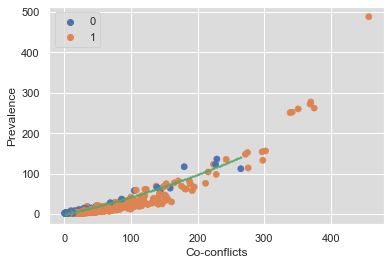

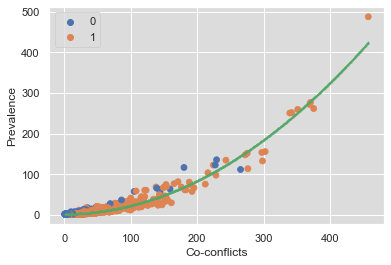

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(251,)
(440,)
(638,)
(779,)
(884,)
(938,)
(967,)
(989,)
(991,)
(995,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


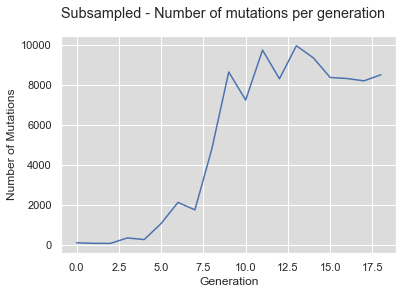

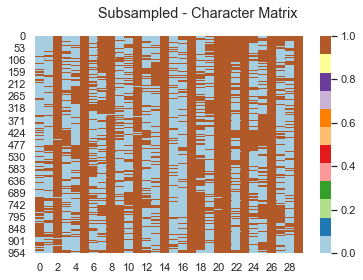

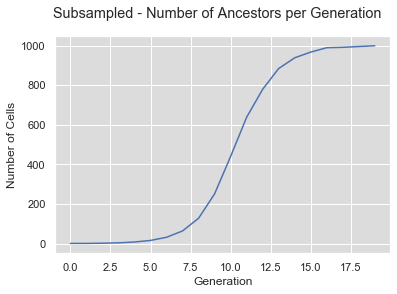

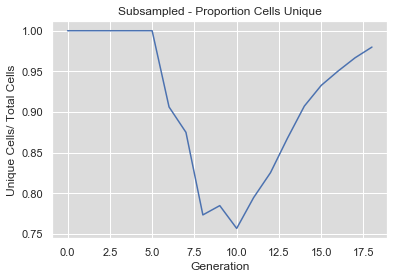

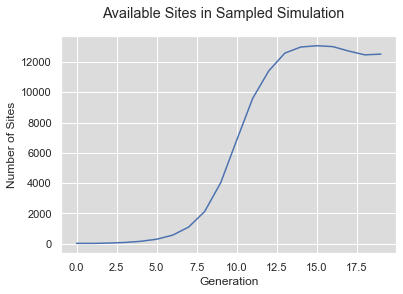

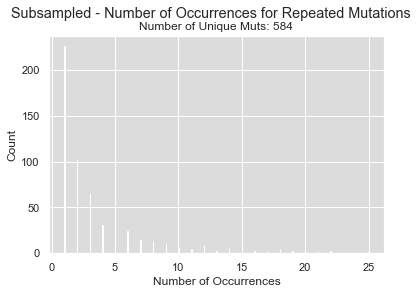

(999, 30)
Time 1: 0.015537261962890625
Compute dictionary: 25.979916095733643
Conflict matrix is symmetric?  True
Total time: 25.99923300743103
Number of true recurrent muts:  555
Number of detected recurrent muts:  750
Number of true recurrent muts not detected: 3 with prevalence [999, 999, 999]


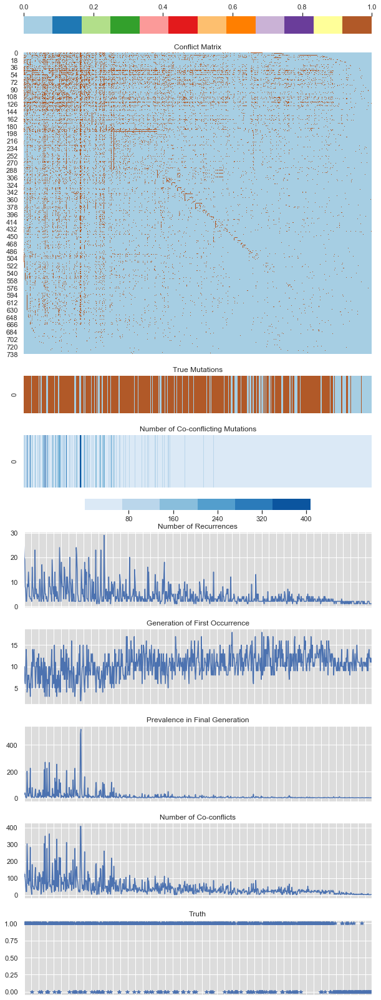

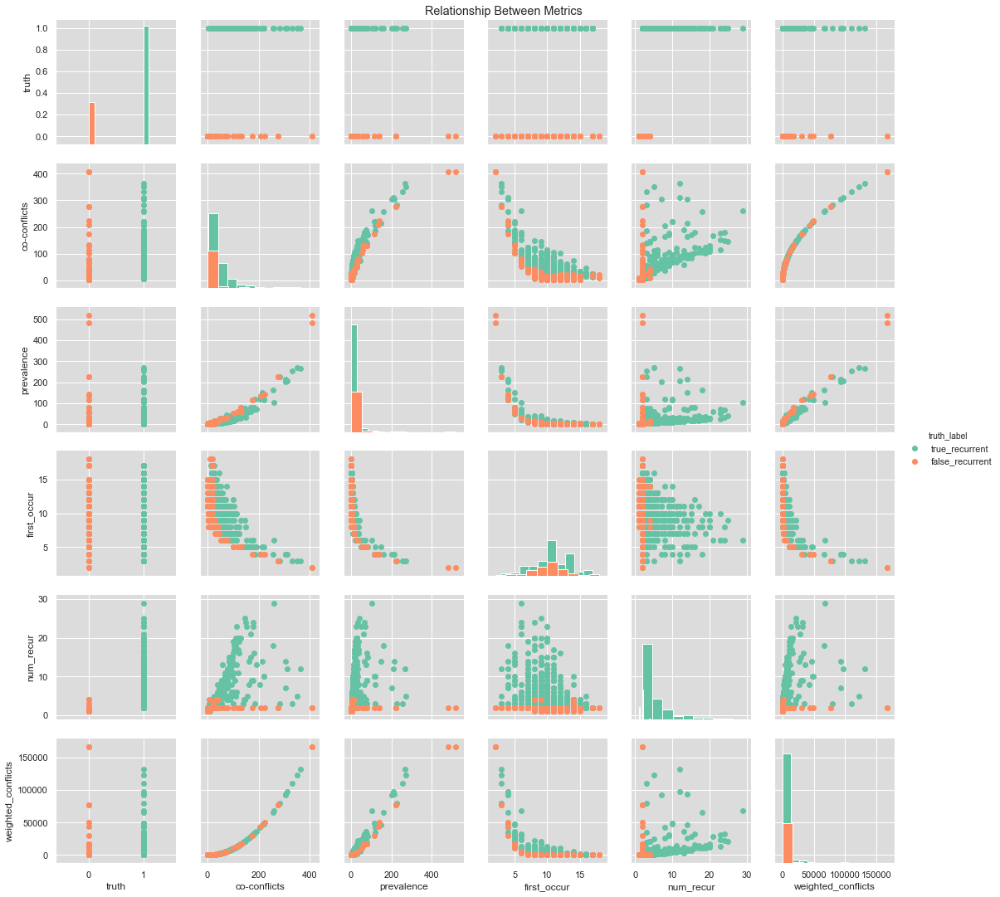

0.08523797988891602 fast?


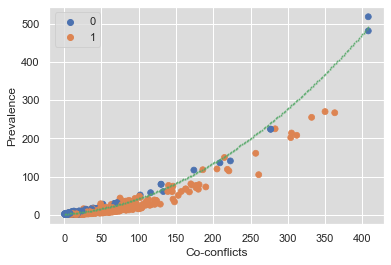

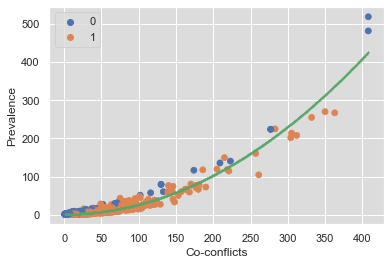

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(247,)
(438,)
(625,)
(790,)
(896,)
(950,)
(972,)
(985,)
(995,)
(997,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


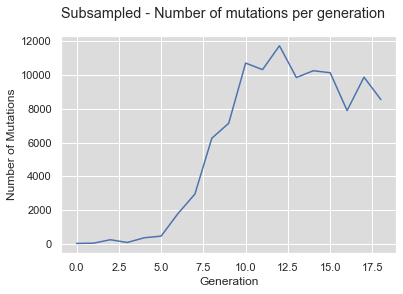

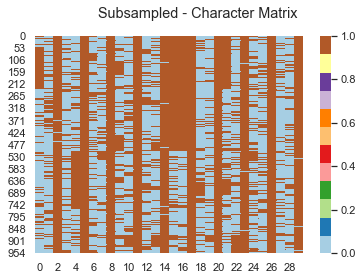

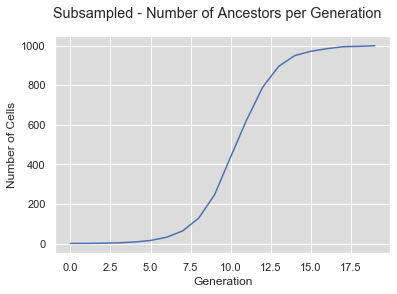

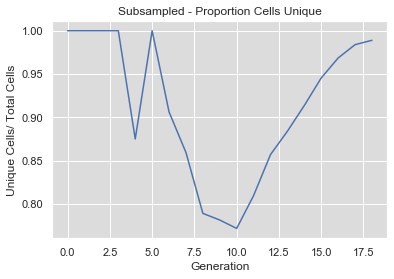

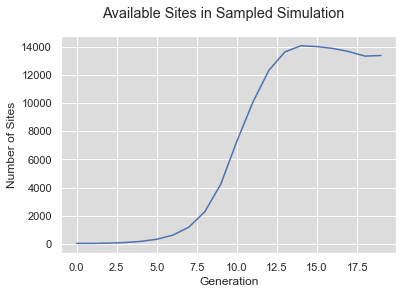

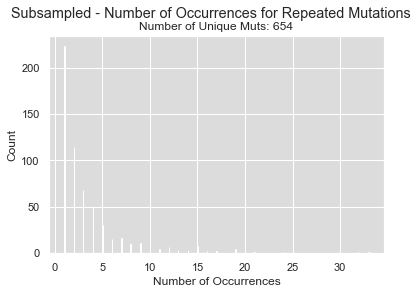

(1000, 30)
Time 1: 0.01485896110534668
Compute dictionary: 24.73423171043396
Conflict matrix is symmetric?  True
Total time: 24.754246950149536
Number of true recurrent muts:  589
Number of detected recurrent muts:  783
Number of true recurrent muts not detected: 2 with prevalence [1000, 1000]


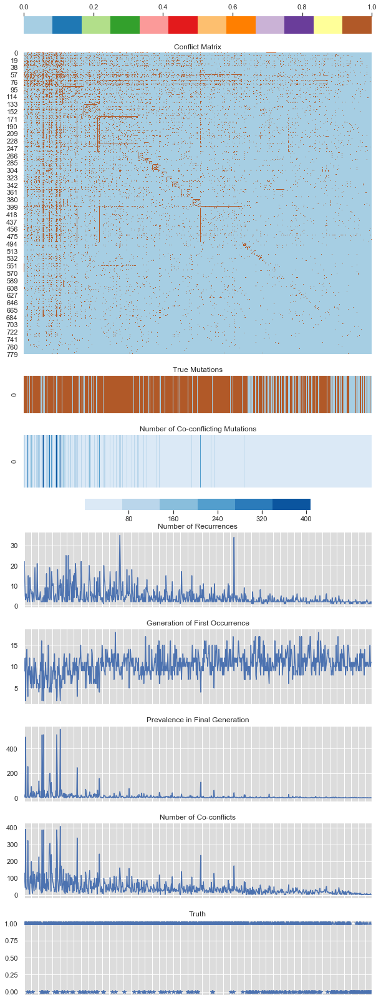

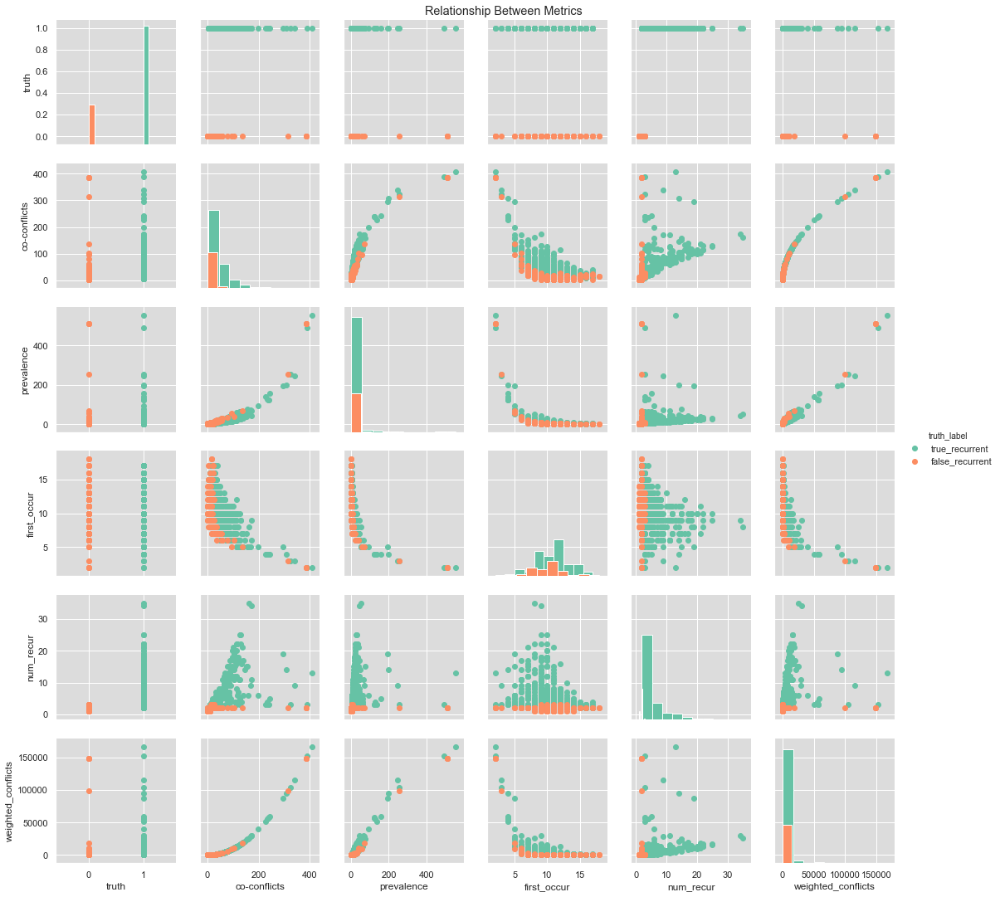

0.090972900390625 fast?


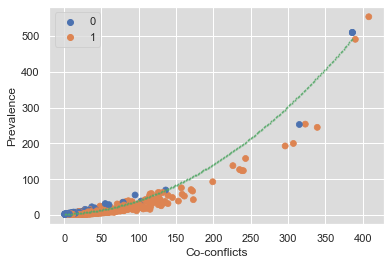

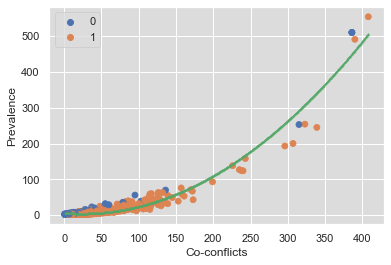

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(430,)
(635,)
(787,)
(881,)
(942,)
(969,)
(990,)
(993,)
(995,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


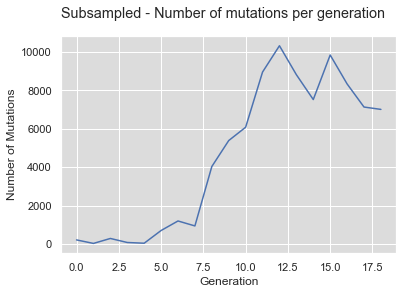

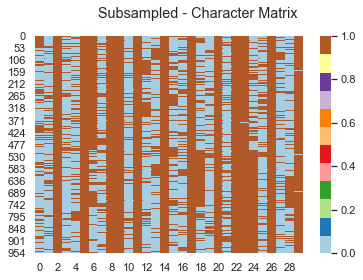

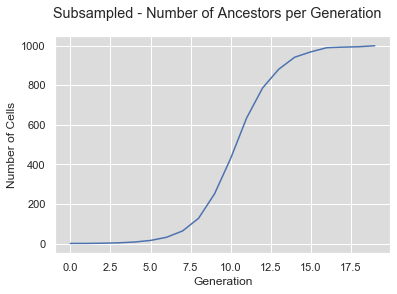

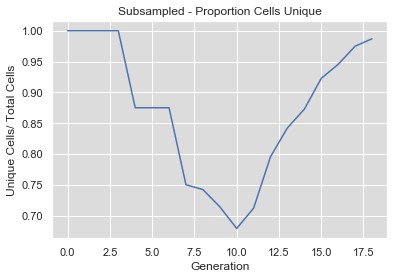

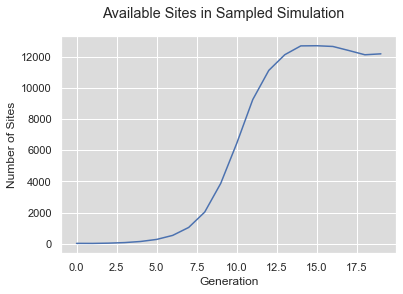

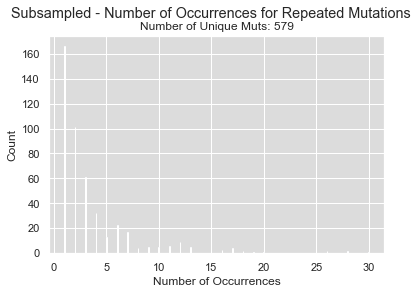

(1000, 30)
Time 1: 0.01247406005859375
Compute dictionary: 18.440773248672485
Conflict matrix is symmetric?  True
Total time: 18.454041242599487
Number of true recurrent muts:  470
Number of detected recurrent muts:  629
Number of true recurrent muts not detected: 5 with prevalence [1000, 1000, 1000, 1000, 1000]


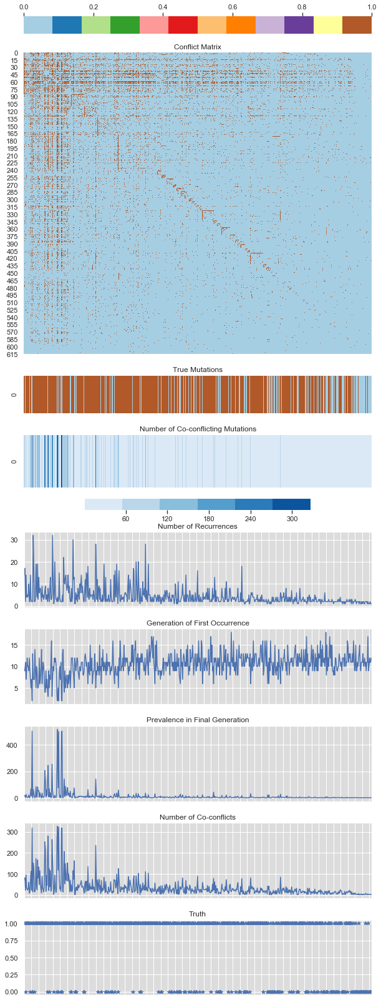

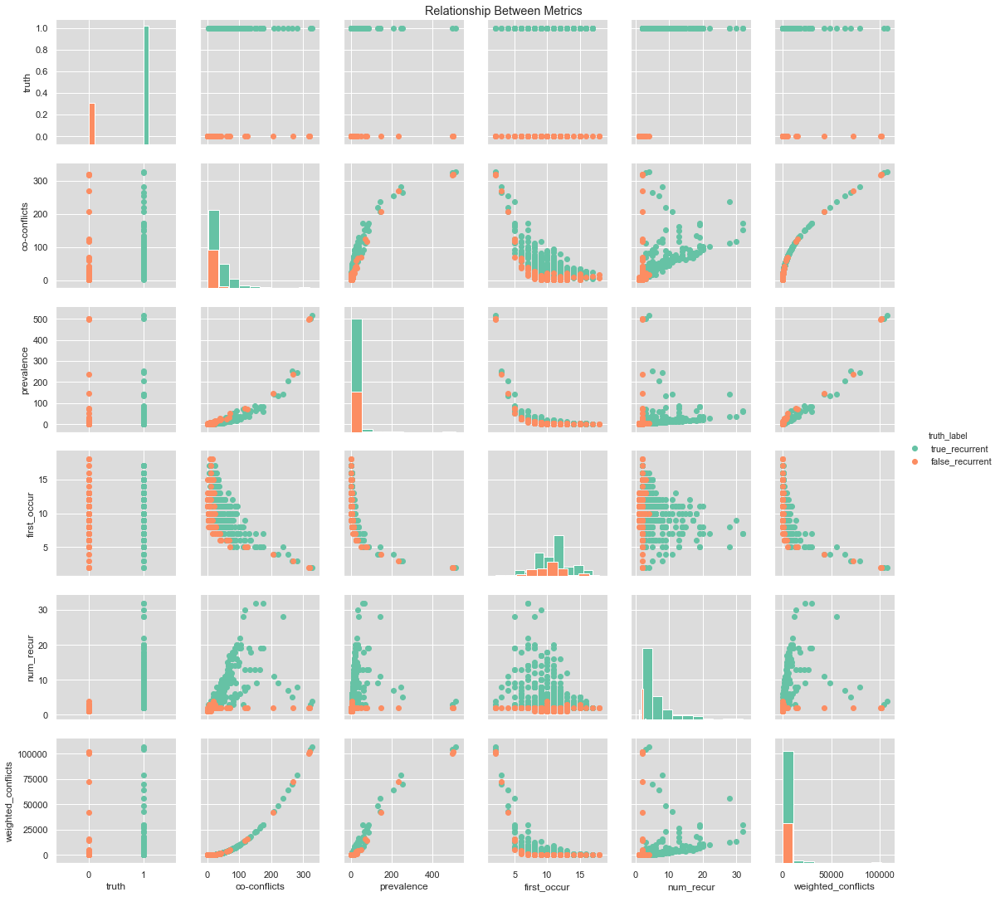

0.08924722671508789 fast?


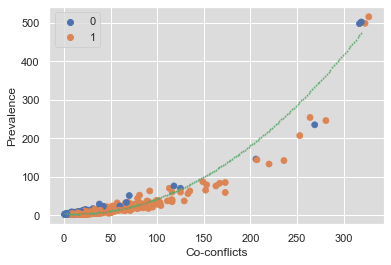

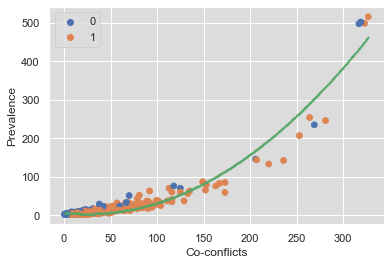

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(249,)
(426,)
(636,)
(791,)
(890,)
(952,)
(973,)
(986,)
(994,)
(996,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


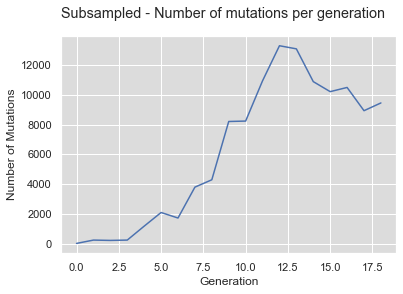

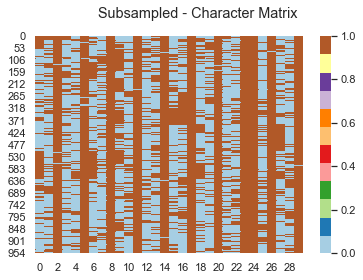

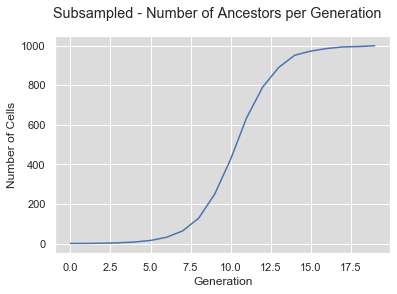

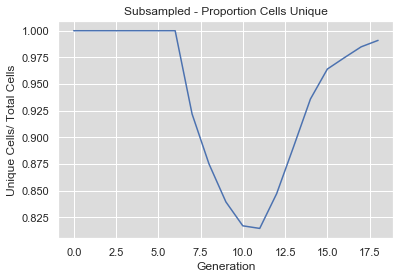

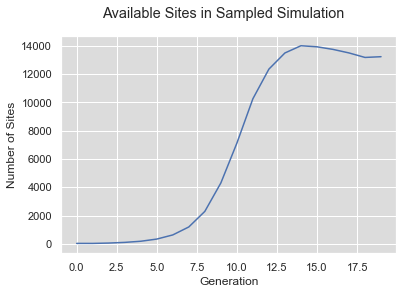

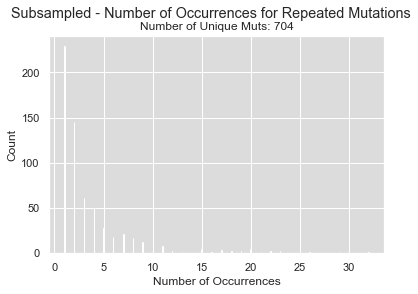

(1000, 30)
Time 1: 0.01610708236694336
Compute dictionary: 28.36271619796753
Conflict matrix is symmetric?  True
Total time: 28.389708042144775
Number of true recurrent muts:  631
Number of detected recurrent muts:  858
Number of true recurrent muts not detected: 2 with prevalence [1000, 1000]


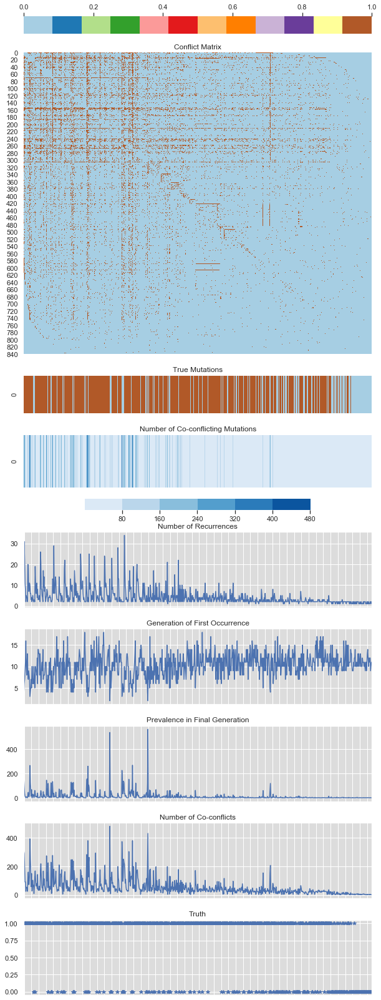

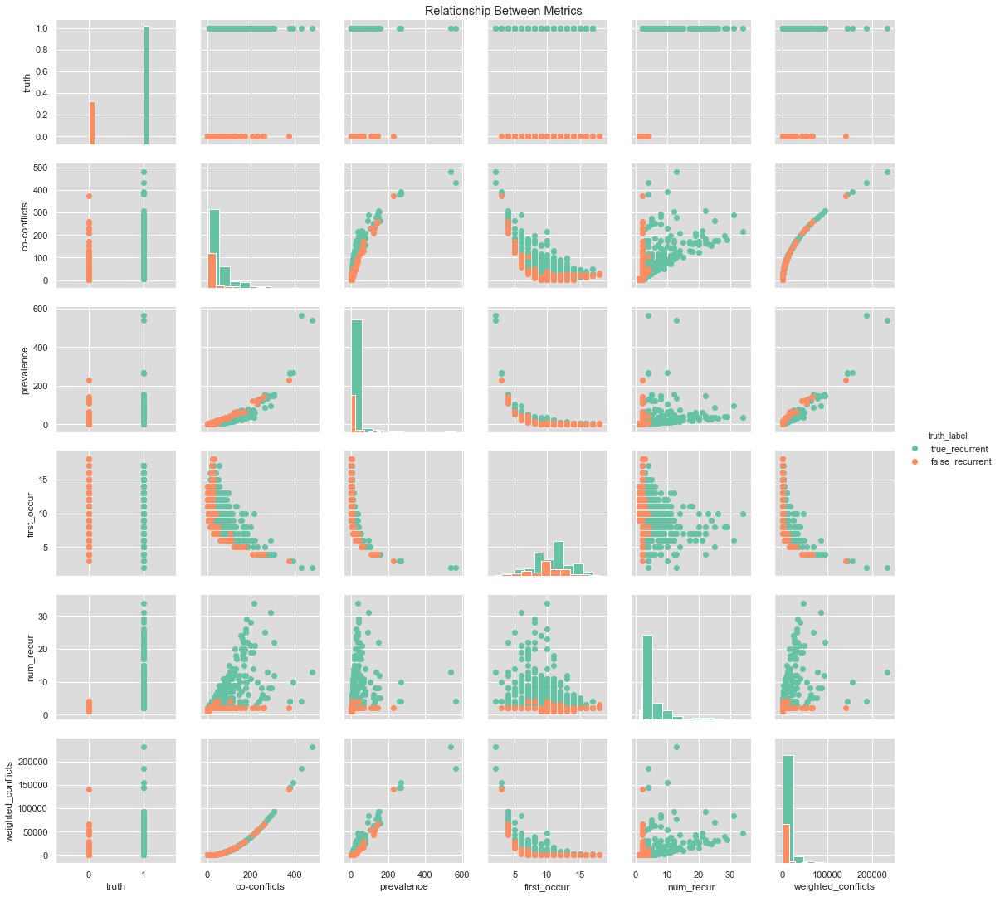

0.0820777416229248 fast?


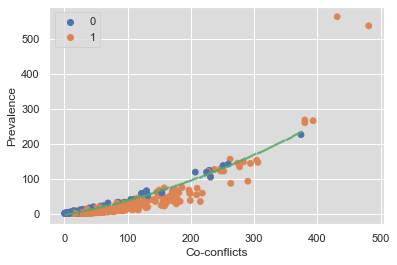

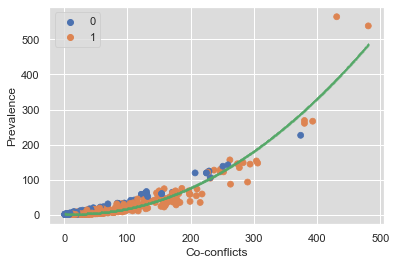

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(243,)
(433,)
(636,)
(789,)
(890,)
(950,)
(973,)
(984,)
(996,)
(997,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


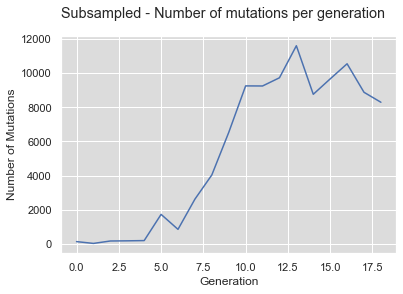

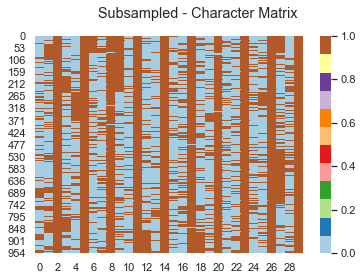

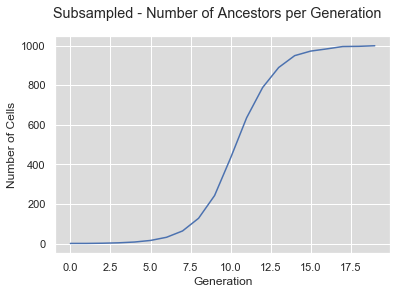

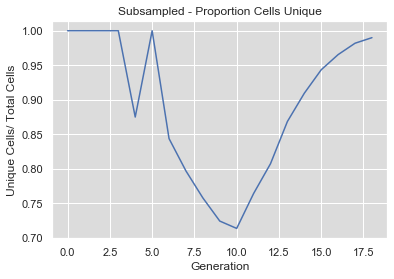

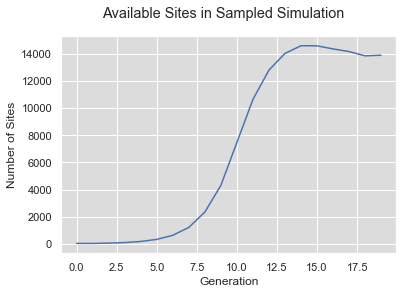

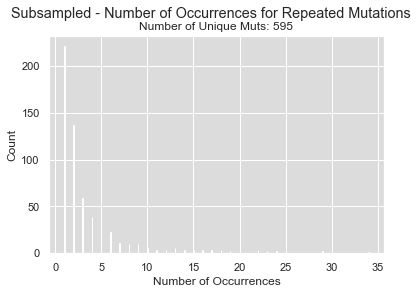

(1000, 30)
Time 1: 0.013792991638183594
Compute dictionary: 23.208643198013306
Conflict matrix is symmetric?  True
Total time: 23.22876214981079
Number of true recurrent muts:  577
Number of detected recurrent muts:  763
Number of true recurrent muts not detected: 4 with prevalence [1000, 1000, 1000, 1000]


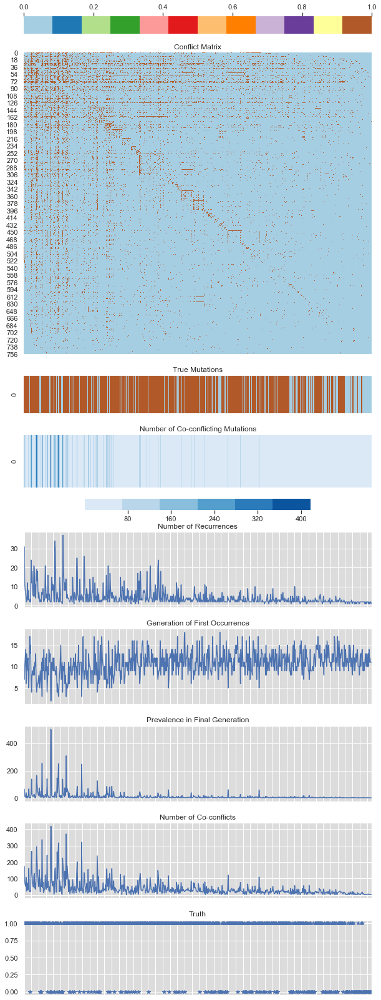

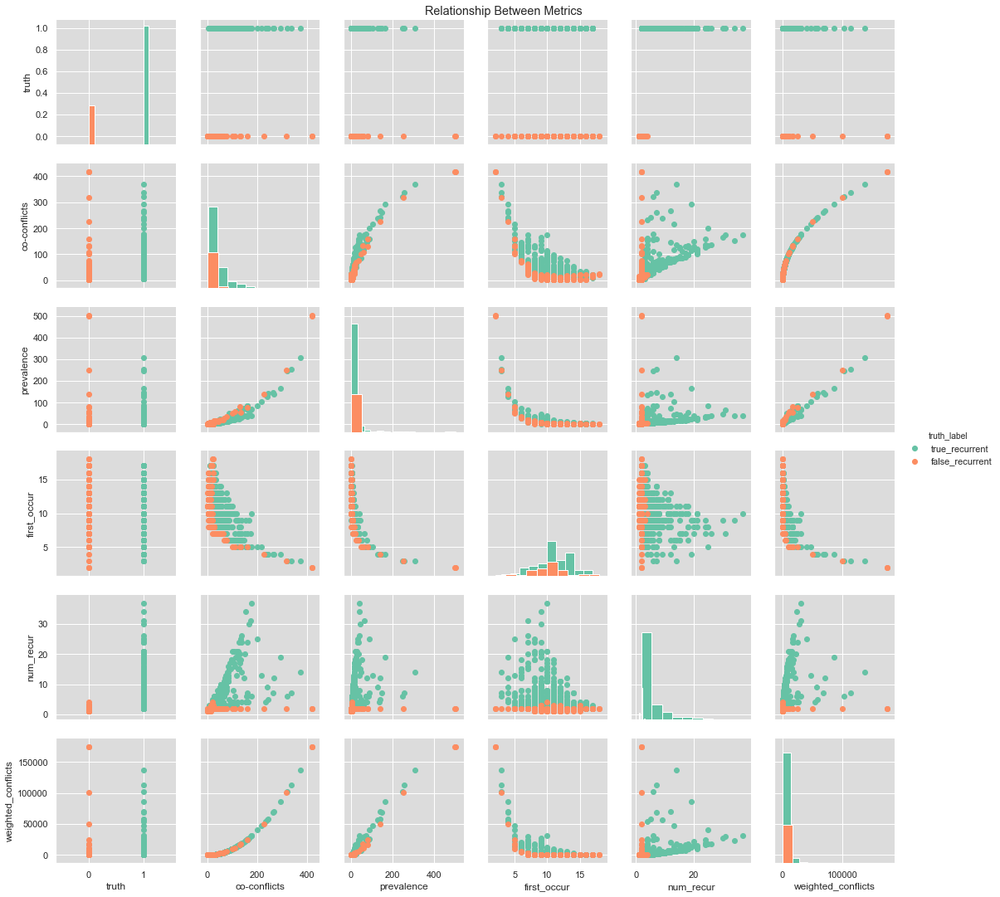

0.08383607864379883 fast?


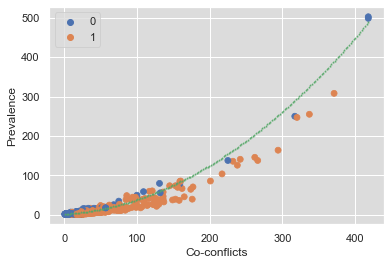

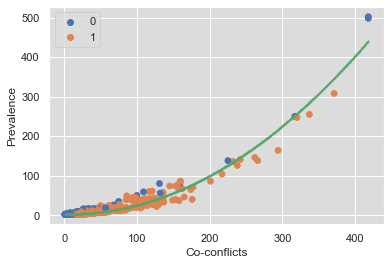

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(253,)
(446,)
(631,)
(784,)
(888,)
(942,)
(964,)
(982,)
(993,)
(997,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


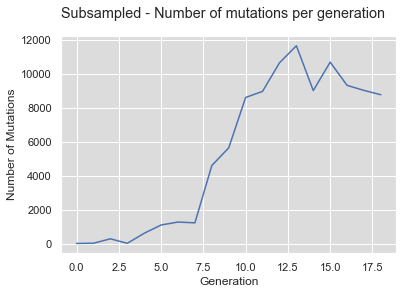

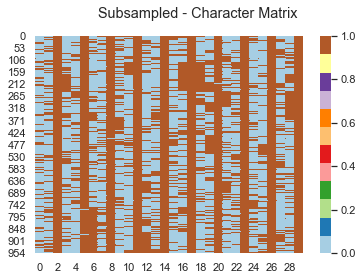

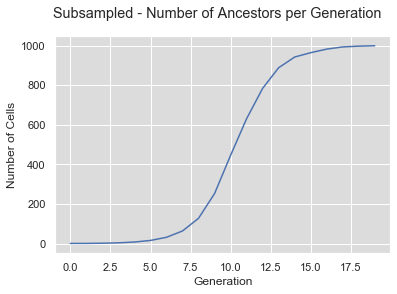

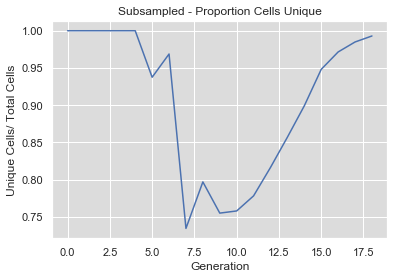

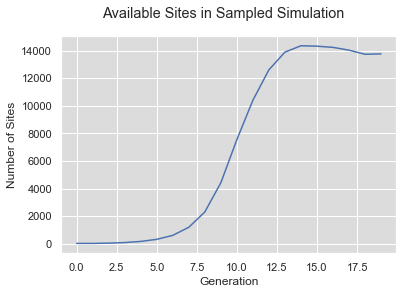

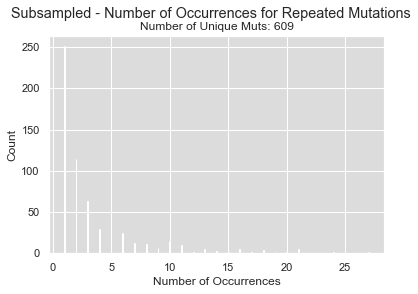

(999, 30)
Time 1: 0.013872146606445312
Compute dictionary: 24.370031118392944
Conflict matrix is symmetric?  True
Total time: 24.38935923576355
Number of true recurrent muts:  591
Number of detected recurrent muts:  773
Number of true recurrent muts not detected: 2 with prevalence [999, 999]


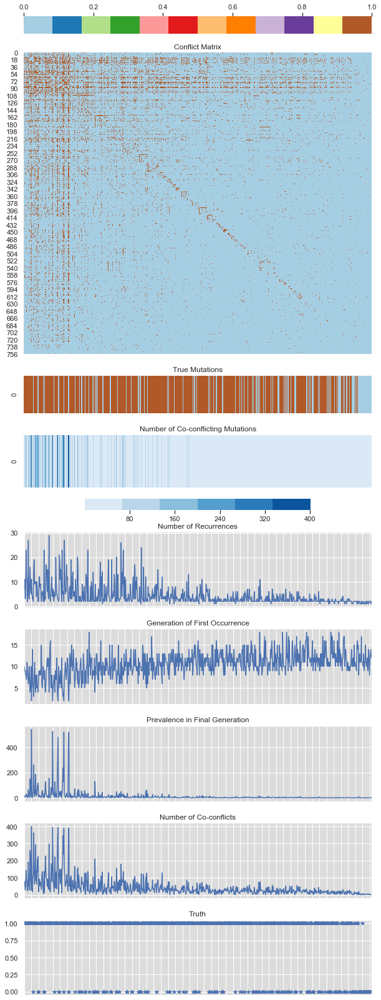

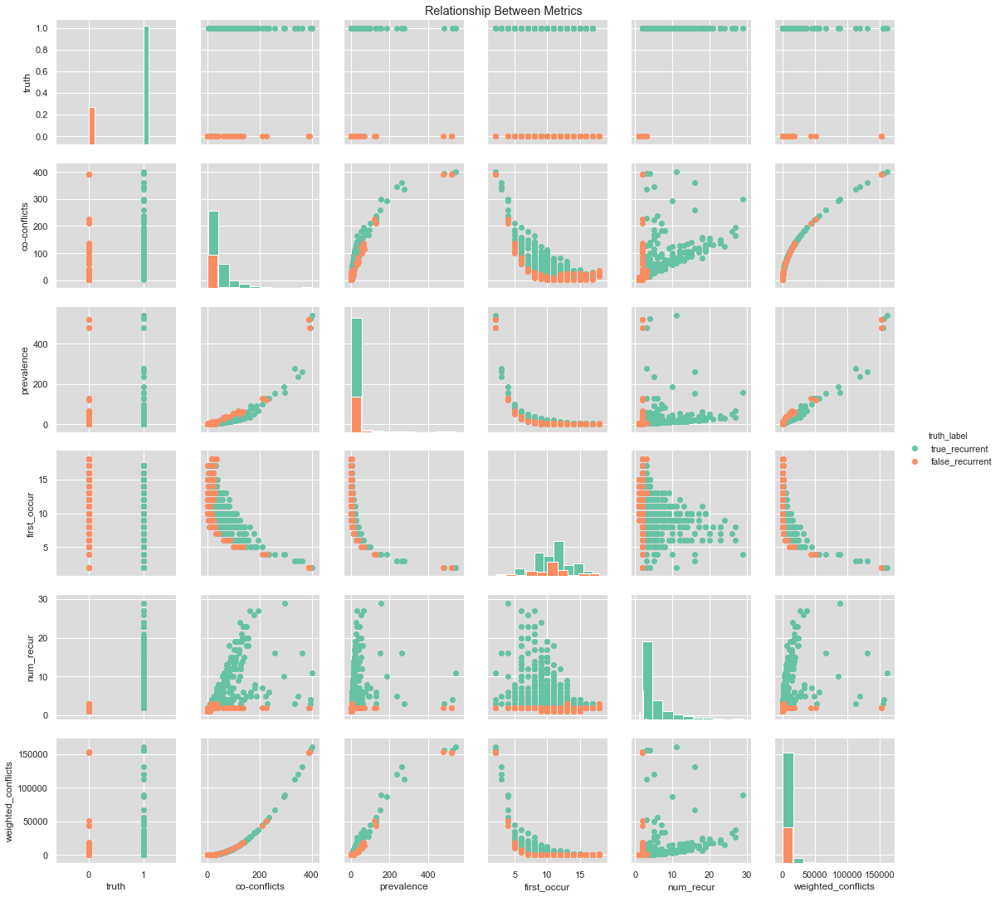

0.08453226089477539 fast?


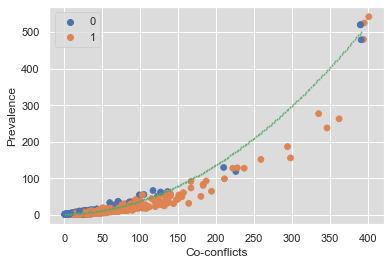

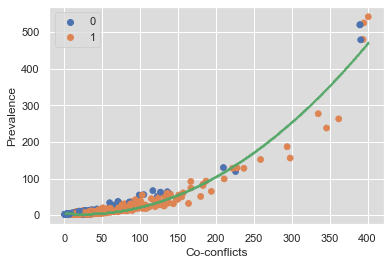

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(249,)
(444,)
(638,)
(792,)
(891,)
(941,)
(972,)
(984,)
(992,)
(999,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


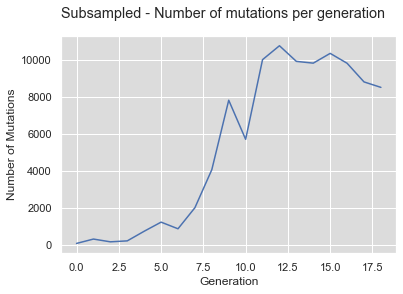

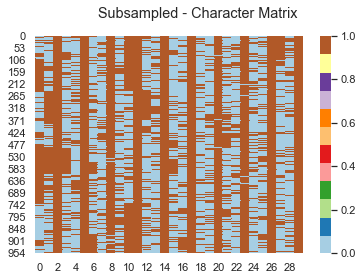

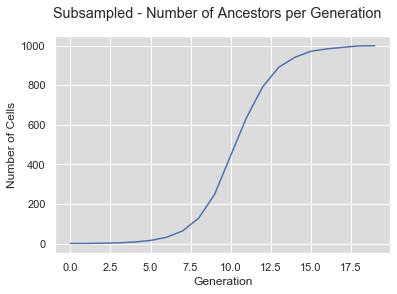

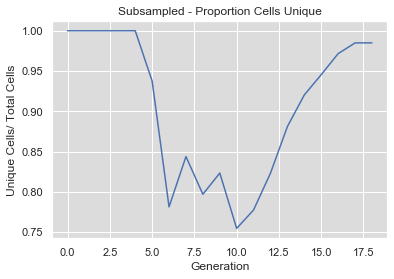

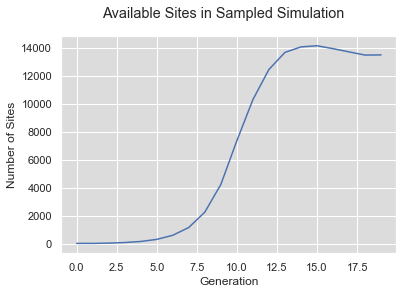

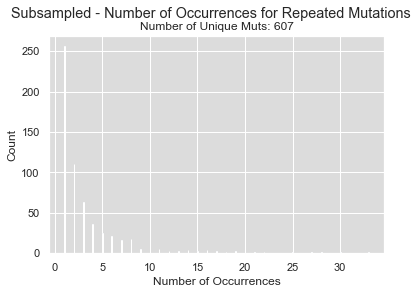

(1000, 30)
Time 1: 0.013417959213256836
Compute dictionary: 21.43805480003357
Conflict matrix is symmetric?  True
Total time: 21.456464767456055
Number of true recurrent muts:  595
Number of detected recurrent muts:  780
Number of true recurrent muts not detected: 2 with prevalence [1000, 1000]


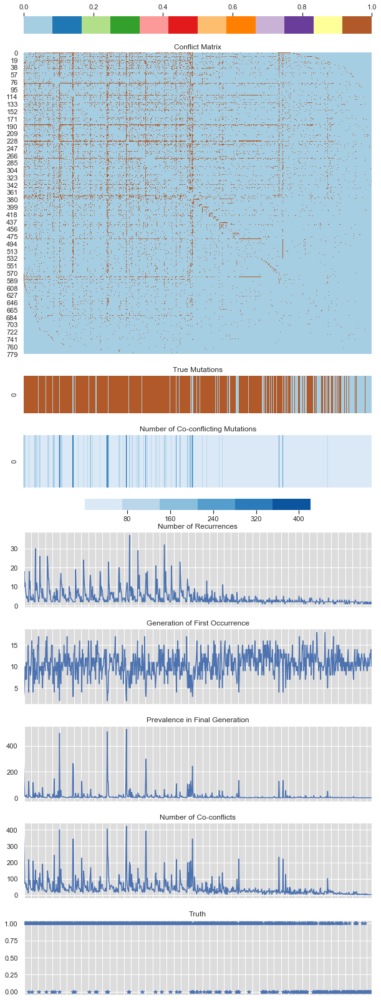

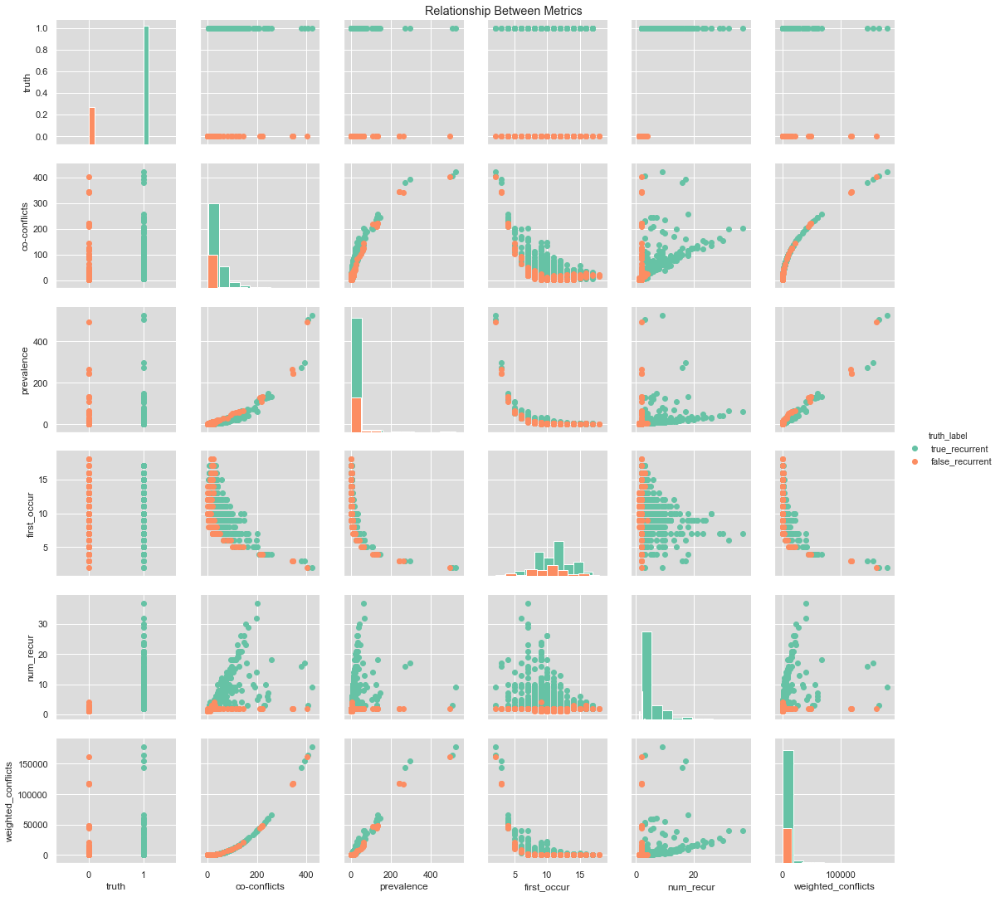

0.07944488525390625 fast?


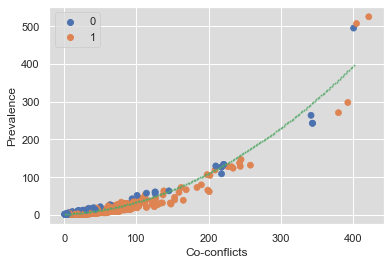

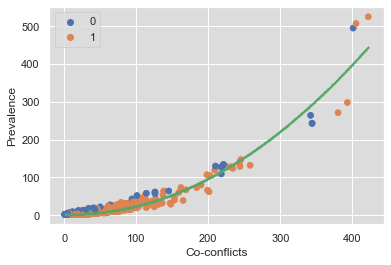

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(251,)
(435,)
(633,)
(790,)
(891,)
(939,)
(964,)
(981,)
(993,)
(998,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


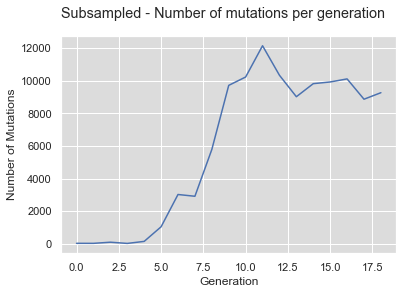

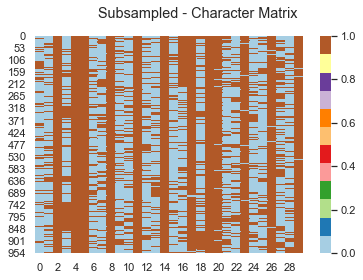

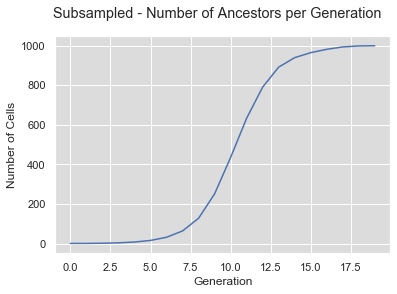

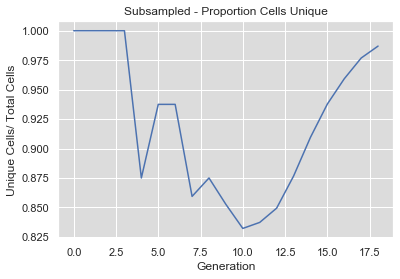

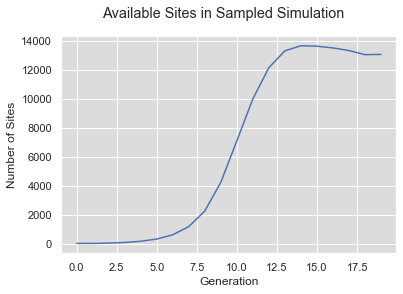

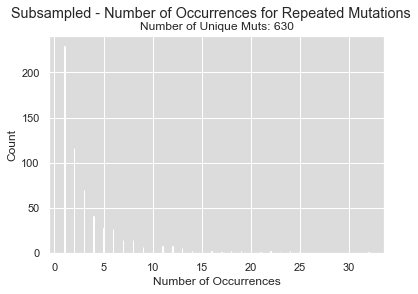

(999, 30)
Time 1: 0.015011072158813477
Compute dictionary: 21.187390327453613
Conflict matrix is symmetric?  True
Total time: 21.20896816253662
Number of true recurrent muts:  607
Number of detected recurrent muts:  823
Number of true recurrent muts not detected: 3 with prevalence [999, 999, 999]


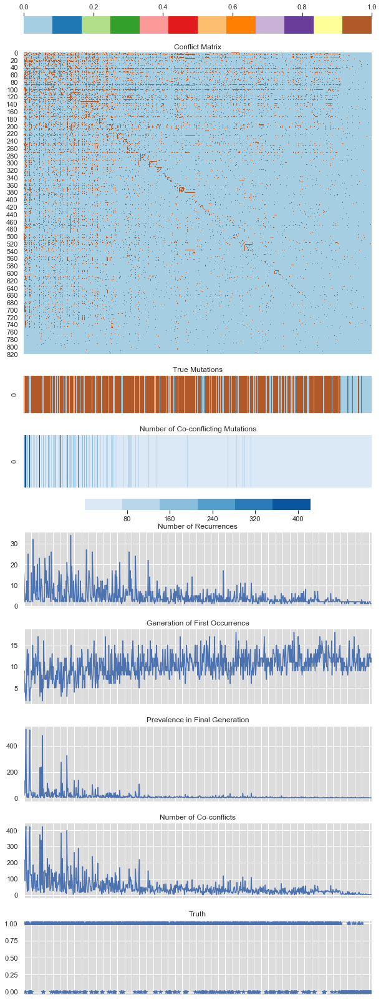

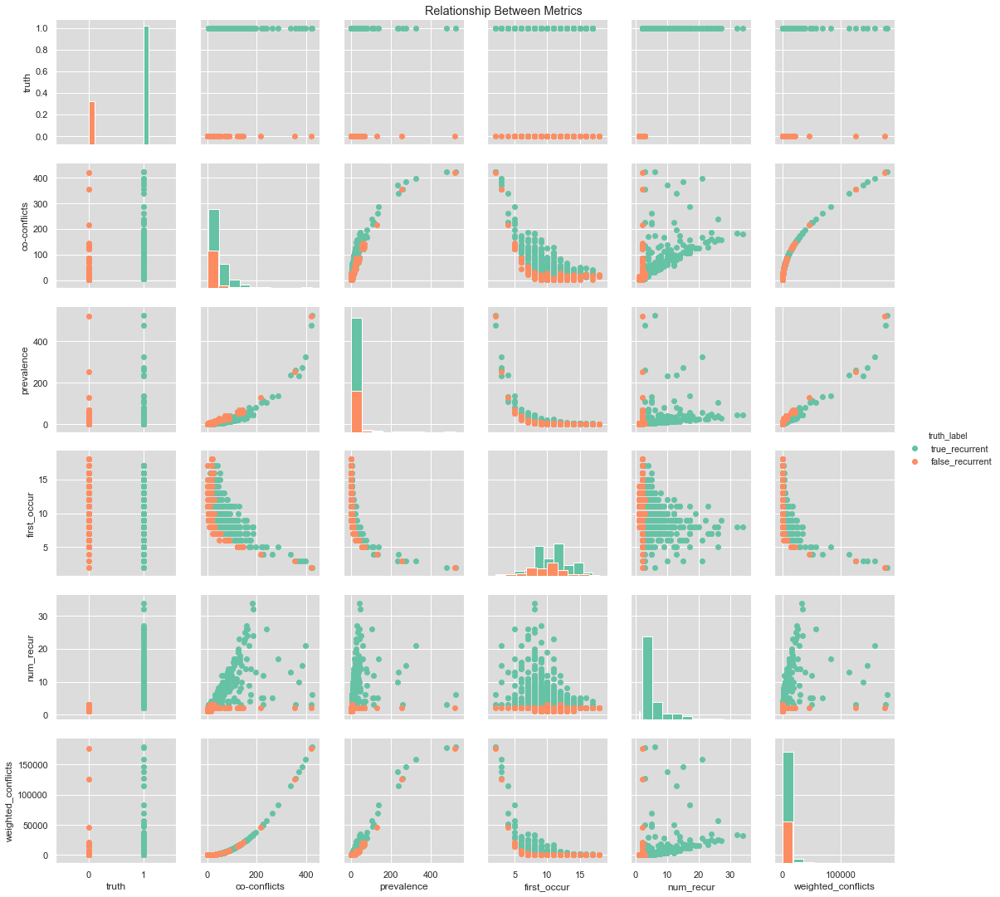

0.08502507209777832 fast?


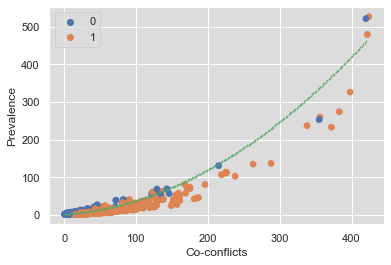

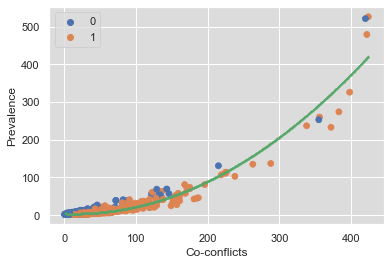

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(251,)
(427,)
(631,)
(790,)
(887,)
(945,)
(969,)
(989,)
(994,)
(998,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


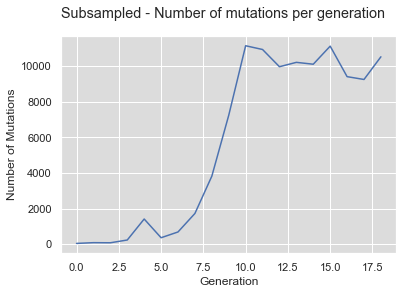

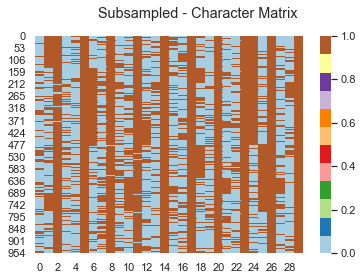

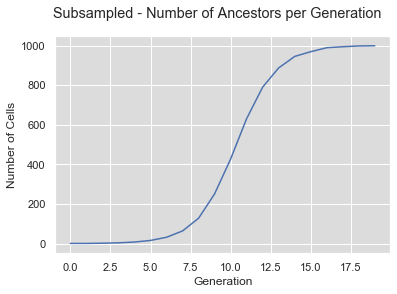

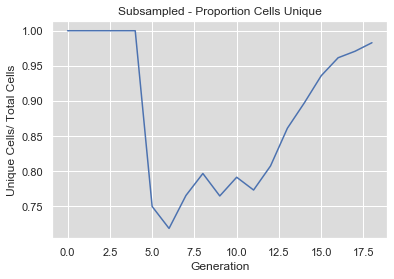

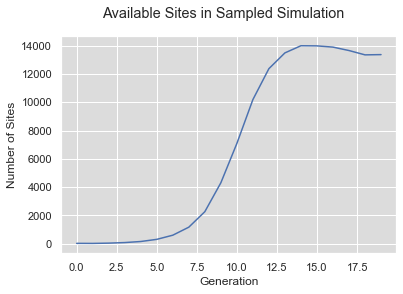

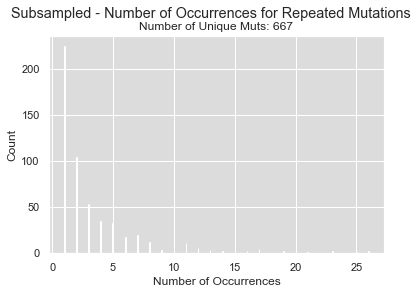

(999, 30)
Time 1: 0.014393091201782227
Compute dictionary: 24.735899209976196
Conflict matrix is symmetric?  True
Total time: 24.75287699699402
Number of true recurrent muts:  556
Number of detected recurrent muts:  759
Number of true recurrent muts not detected: 1 with prevalence [999]


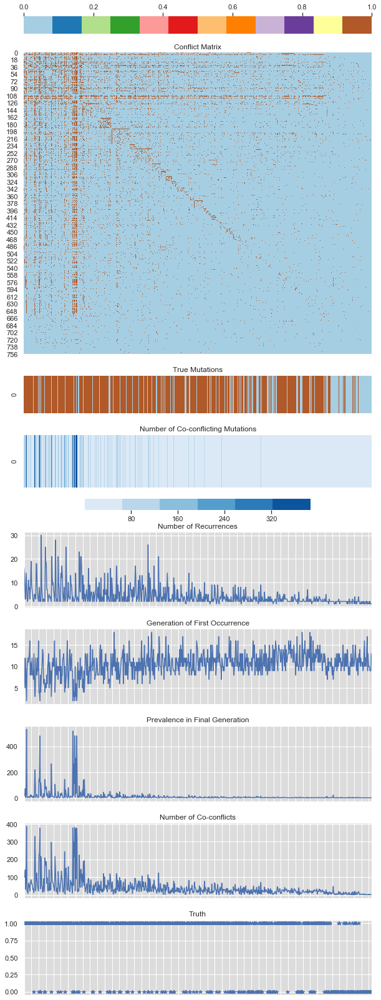

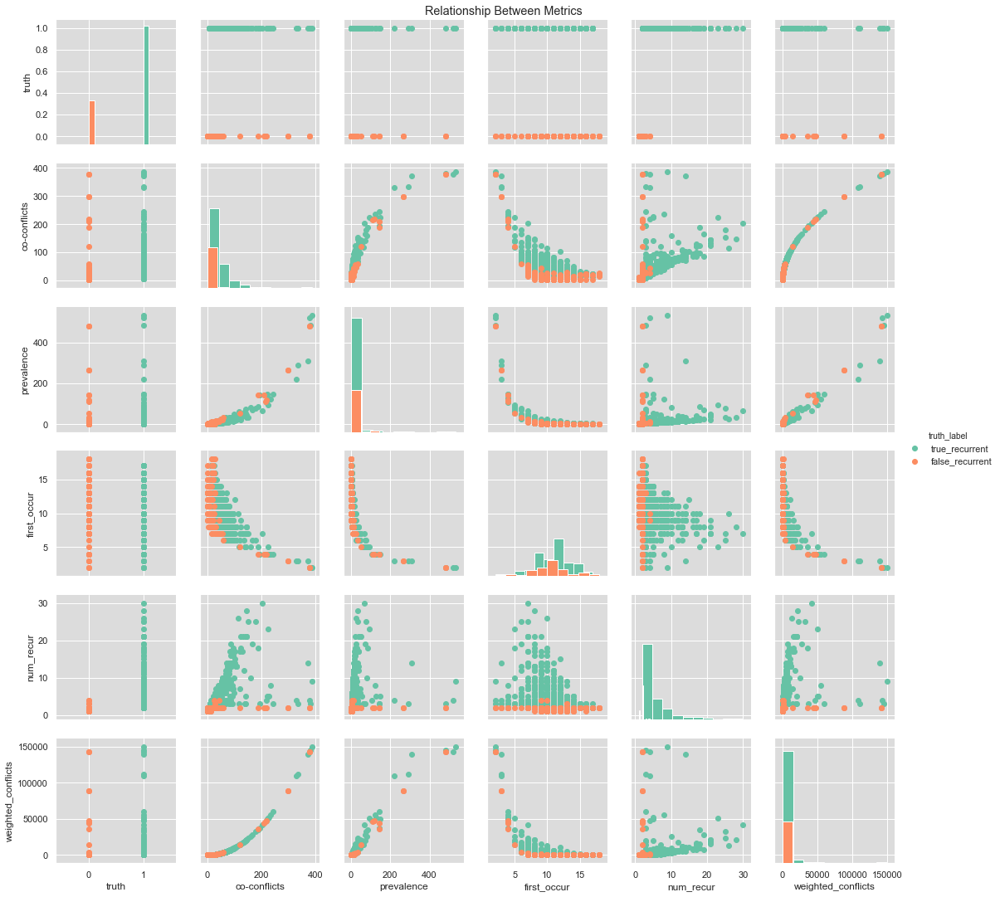

0.08308005332946777 fast?


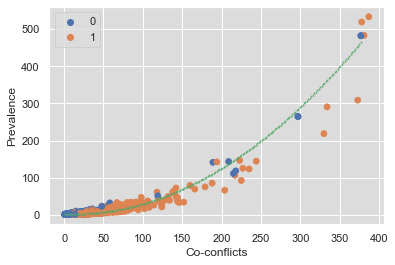

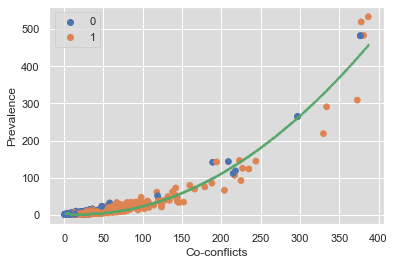

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(250,)
(438,)
(643,)
(803,)
(903,)
(948,)
(971,)
(986,)
(993,)
(996,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


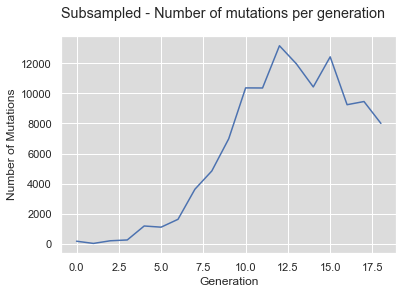

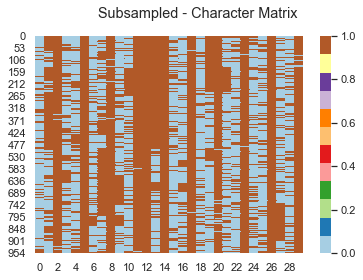

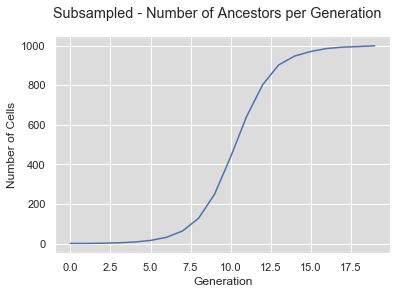

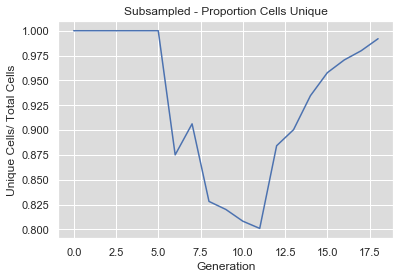

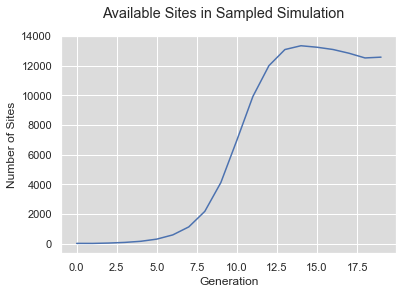

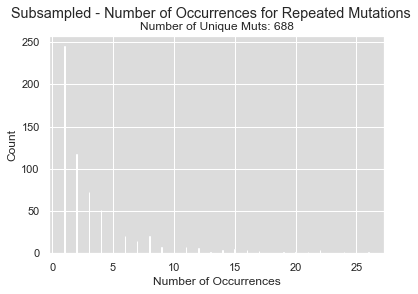

(1000, 30)
Time 1: 0.014452934265136719
Compute dictionary: 25.20337200164795
Conflict matrix is symmetric?  True
Total time: 25.22845196723938
Number of true recurrent muts:  628
Number of detected recurrent muts:  846
Number of true recurrent muts not detected: 2 with prevalence [1000, 1000]


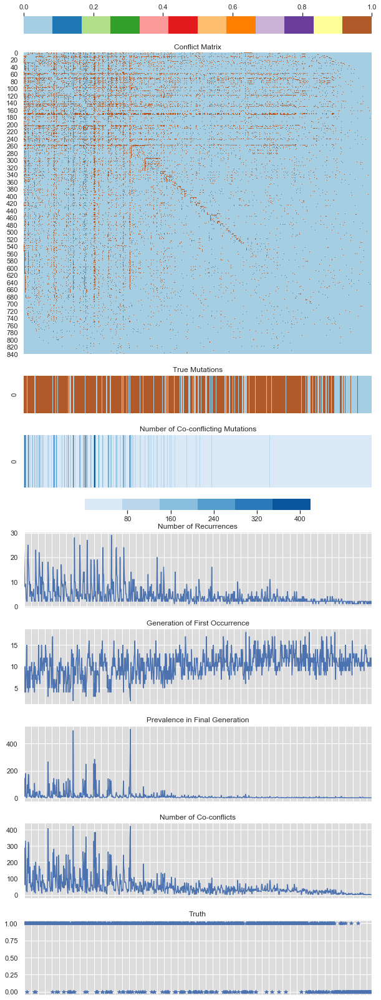

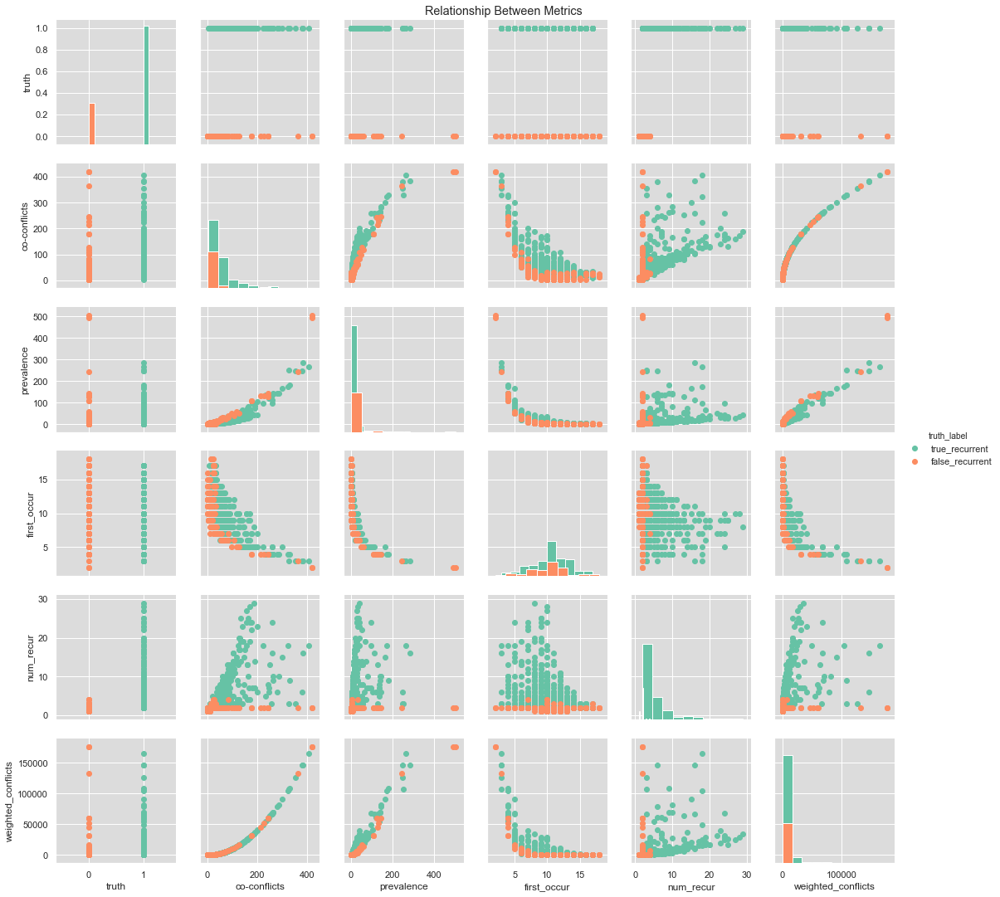

0.08060431480407715 fast?


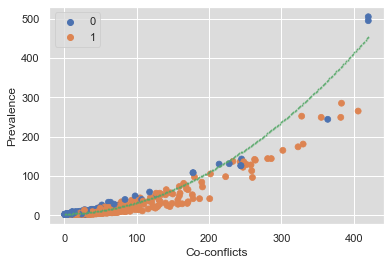

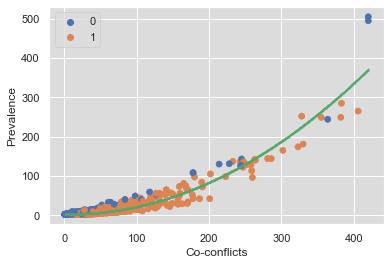

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(254,)
(444,)
(654,)
(800,)
(897,)
(950,)
(981,)
(991,)
(996,)
(998,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


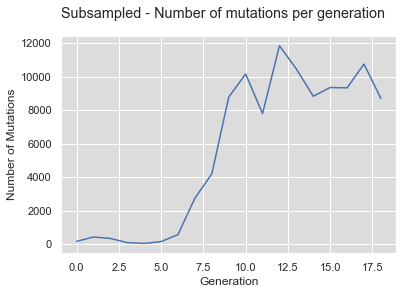

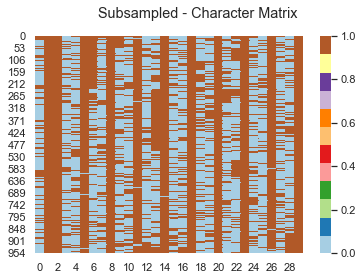

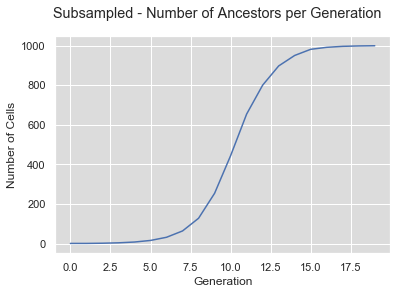

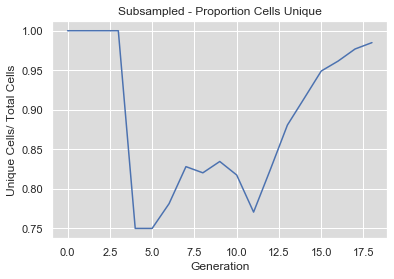

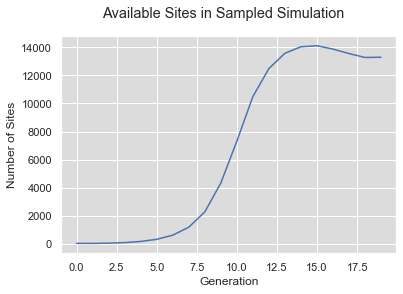

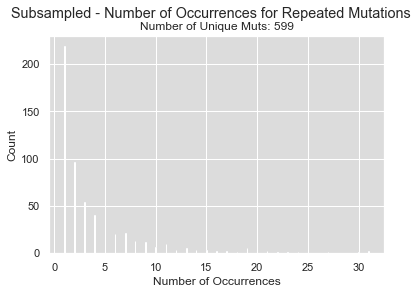

(999, 30)
Time 1: 0.014279842376708984
Compute dictionary: 22.86925482749939
Conflict matrix is symmetric?  True
Total time: 22.886230945587158
Number of true recurrent muts:  565
Number of detected recurrent muts:  767
Number of true recurrent muts not detected: 3 with prevalence [999, 999, 999]


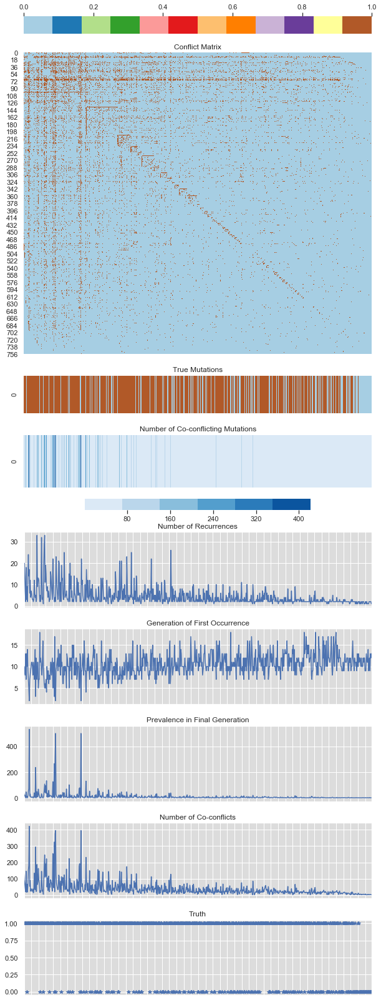

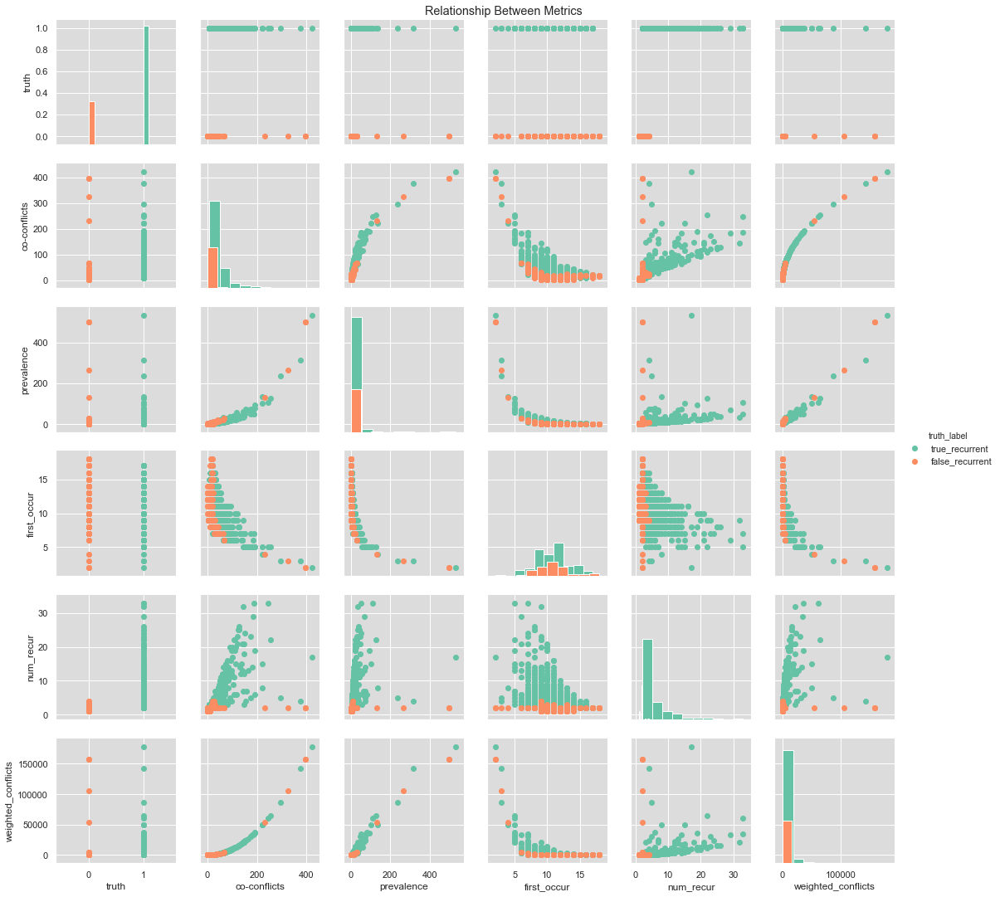

0.08293986320495605 fast?


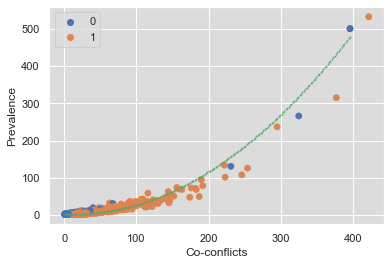

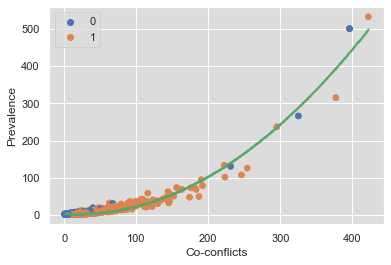

Label: smf
List of targets:  [(0, 0), (0, 1), (0, 2), (1, 0), (1, 1), (1, 2), (2, 0), (2, 1), (2, 2), (3, 0), (3, 1), (3, 2), (4, 0), (4, 1), (4, 2), (5, 0), (5, 1), (5, 2), (6, 0), (6, 1), (6, 2), (7, 0), (7, 1), (7, 2), (8, 0), (8, 1), (8, 2), (9, 0), (9, 1), (9, 2)]
ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(127,)
(250,)
(438,)
(631,)
(792,)
(889,)
(951,)
(973,)
(986,)
(994,)
(999,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


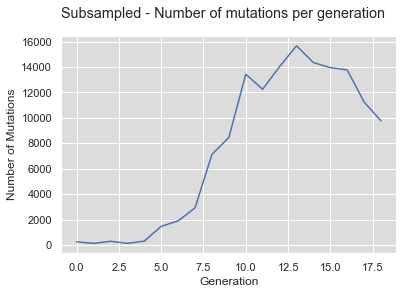

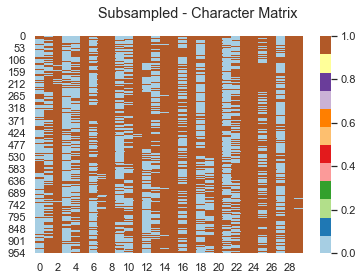

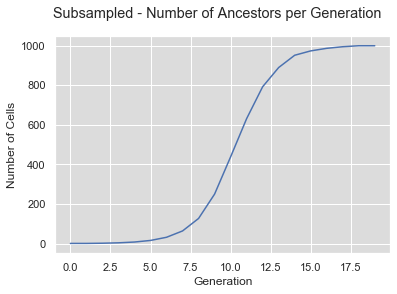

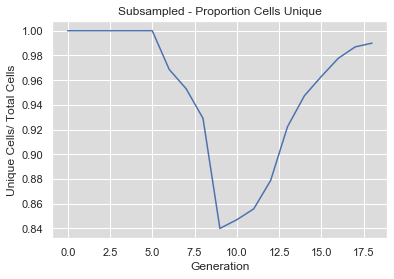

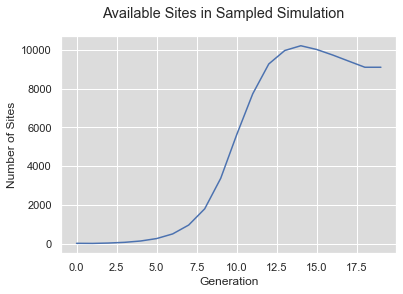

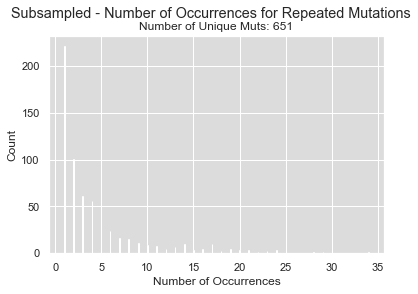

(999, 30)
Time 1: 0.016652822494506836
Compute dictionary: 28.993741750717163
Conflict matrix is symmetric?  True
Total time: 29.018845796585083
Number of true recurrent muts:  607
Number of detected recurrent muts:  833
Number of true recurrent muts not detected: 3 with prevalence [999, 999, 999]


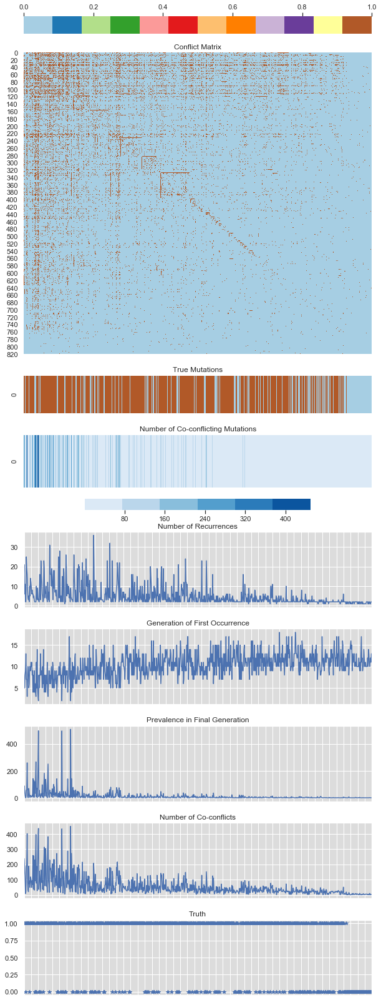

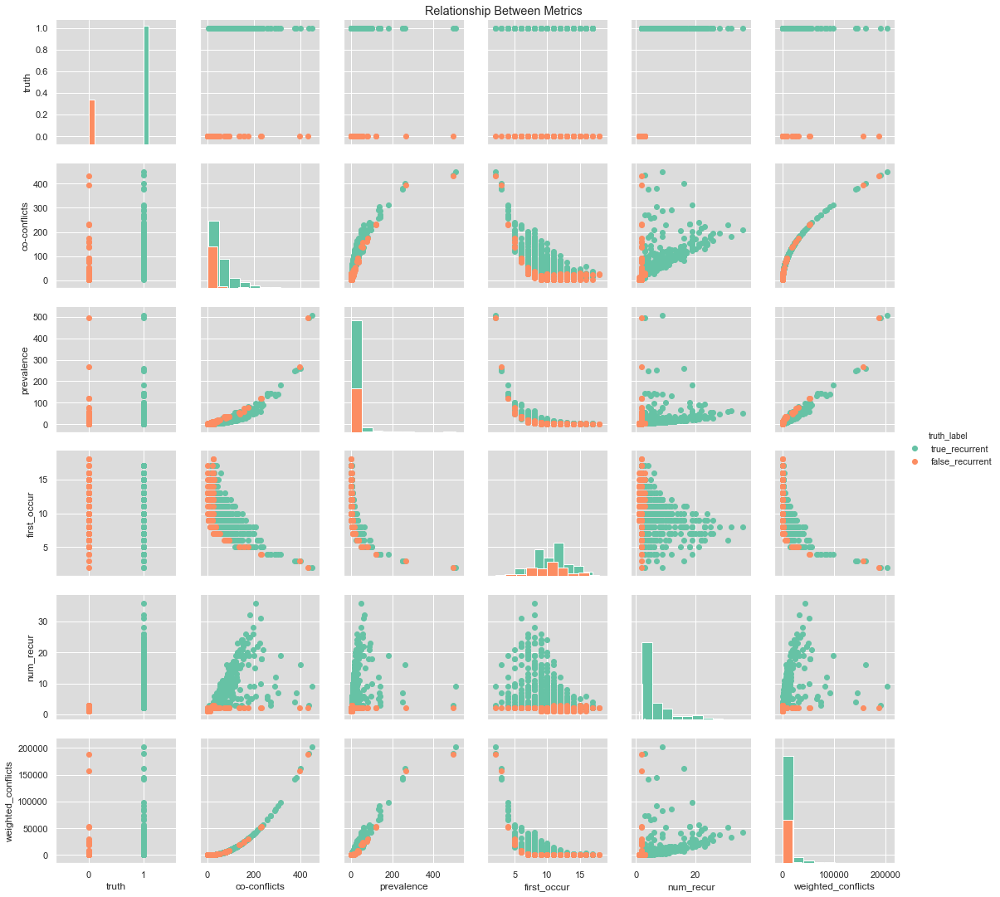

0.07950592041015625 fast?


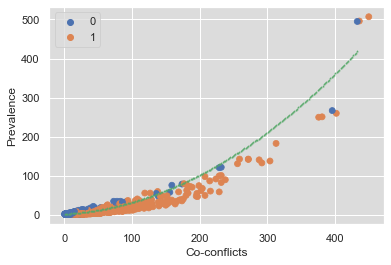

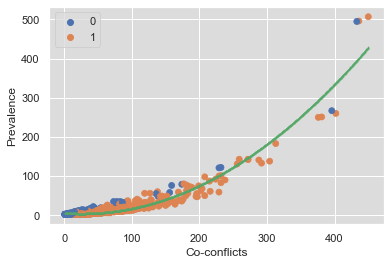

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(253,)
(444,)
(641,)
(802,)
(888,)
(945,)
(982,)
(992,)
(995,)
(997,)
(998,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


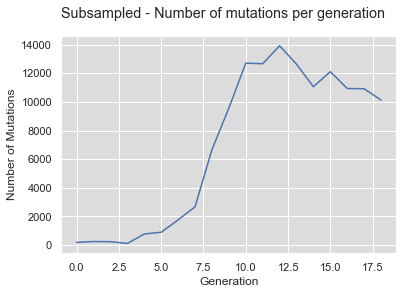

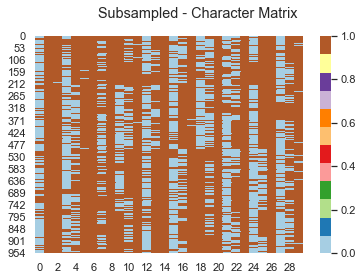

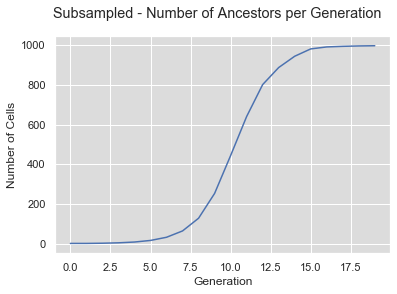

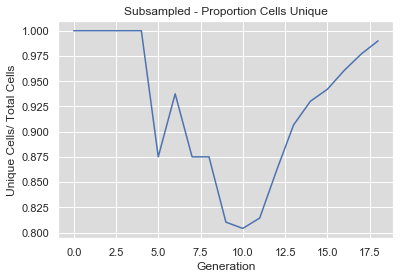

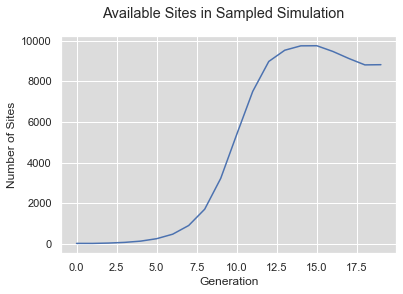

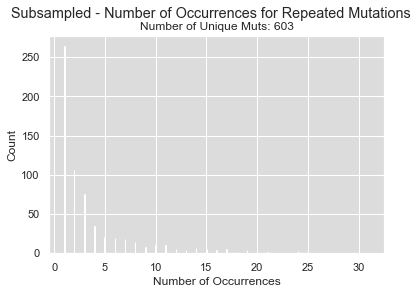

(998, 30)
Time 1: 0.013558149337768555
Compute dictionary: 25.27594232559204
Conflict matrix is symmetric?  True
Total time: 25.30094003677368
Number of true recurrent muts:  629
Number of detected recurrent muts:  842
Number of true recurrent muts not detected: 6 with prevalence [998, 998, 998, 998, 998, 998]


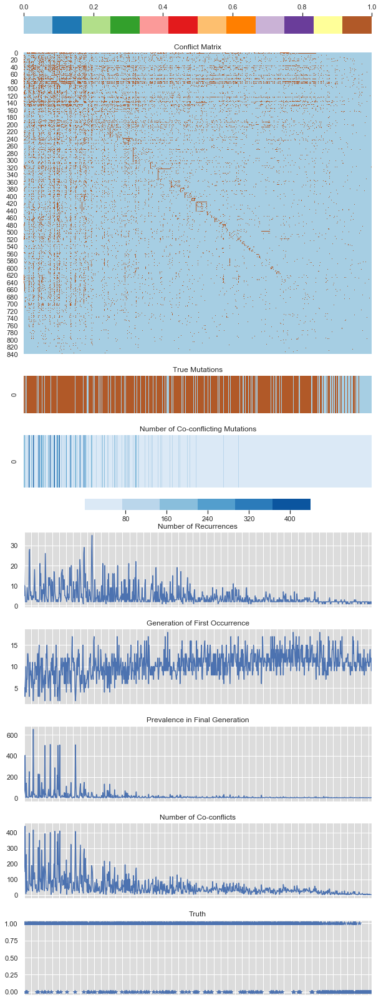

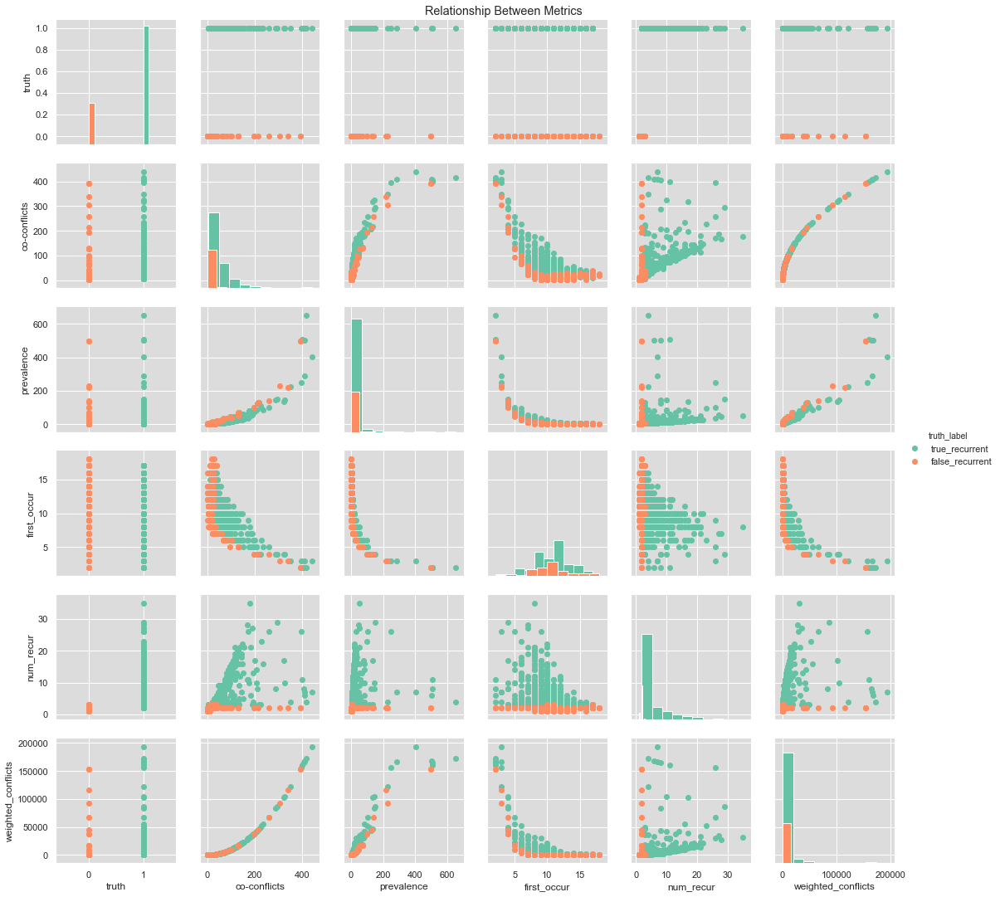

0.08319497108459473 fast?


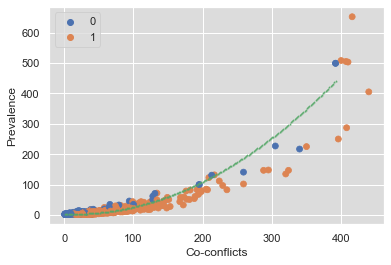

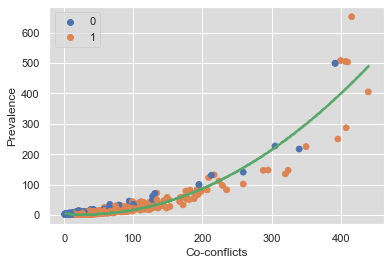

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(250,)
(437,)
(634,)
(783,)
(887,)
(941,)
(962,)
(982,)
(990,)
(996,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


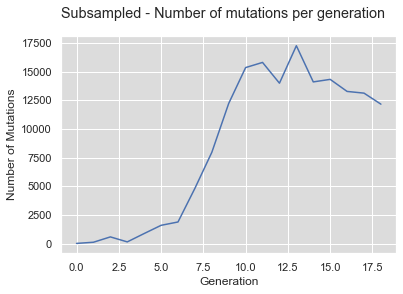

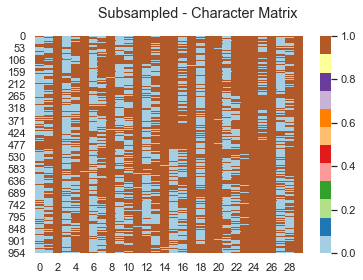

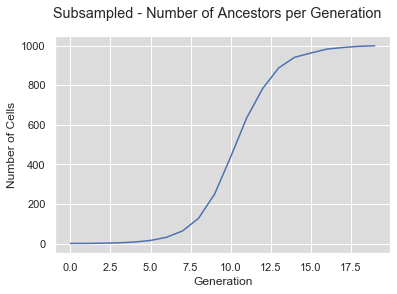

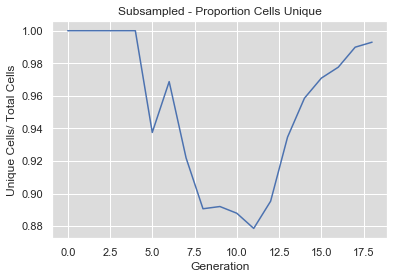

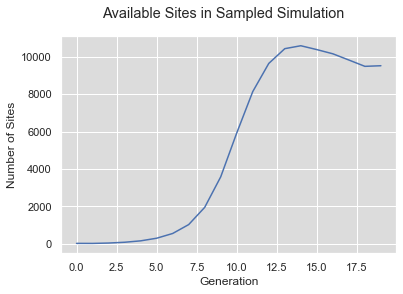

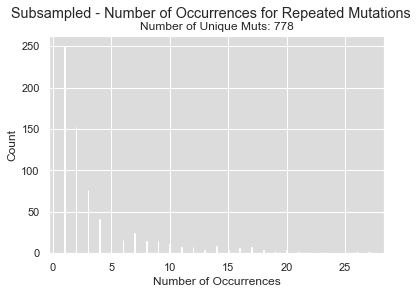

(999, 30)
Time 1: 0.01732778549194336
Compute dictionary: 31.913064002990723
Conflict matrix is symmetric?  True
Total time: 31.947306632995605
Number of true recurrent muts:  695
Number of detected recurrent muts:  984
Number of true recurrent muts not detected: 1 with prevalence [999]


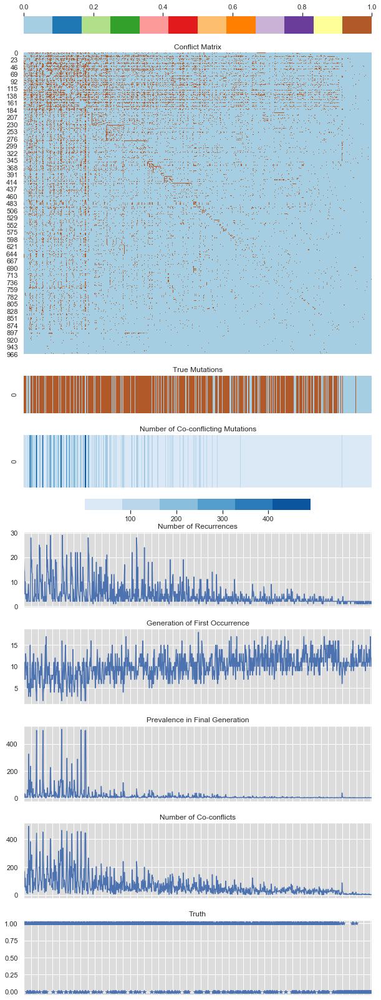

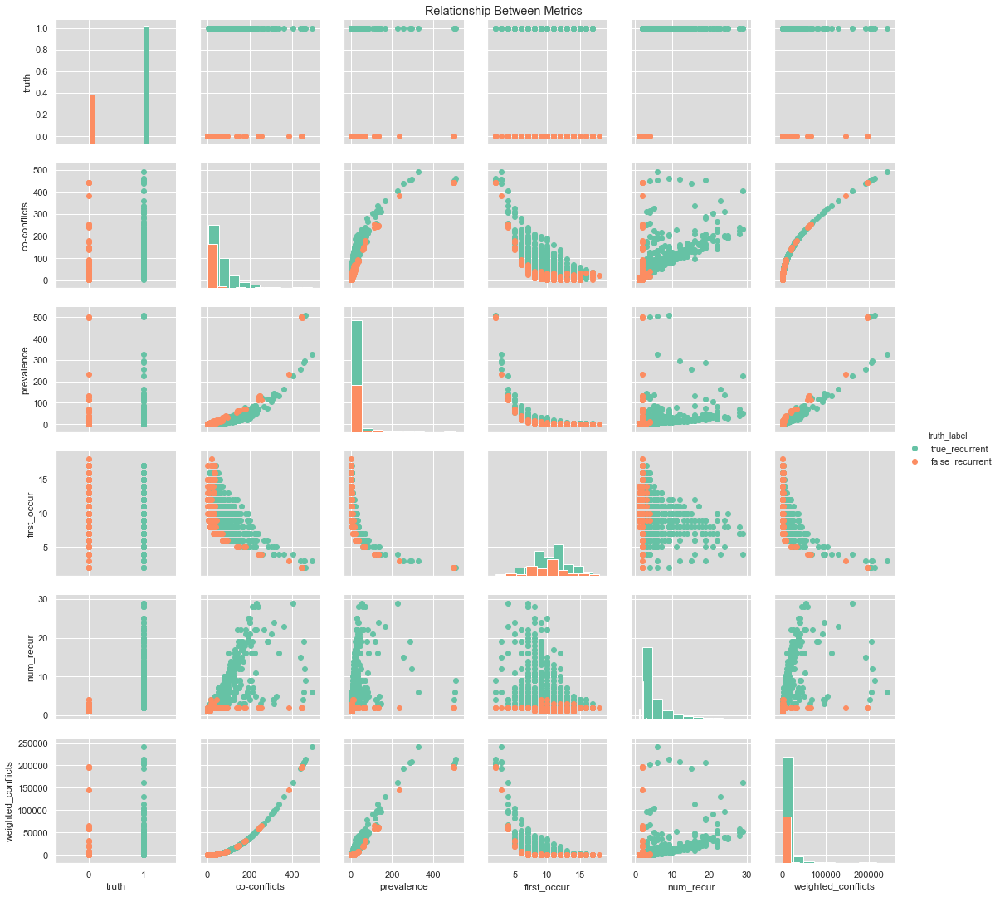

0.07915806770324707 fast?


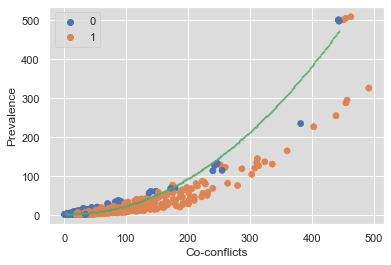

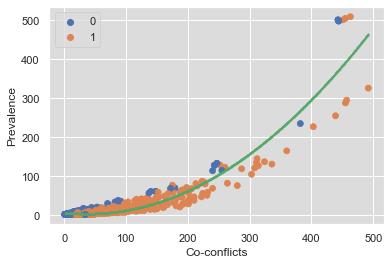

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(250,)
(433,)
(638,)
(777,)
(889,)
(946,)
(966,)
(983,)
(993,)
(996,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


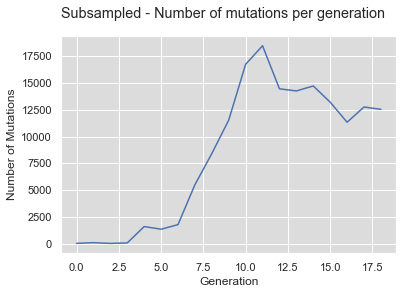

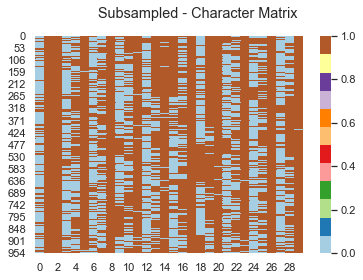

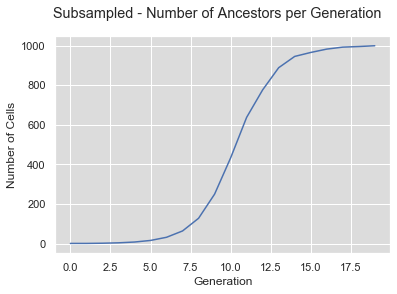

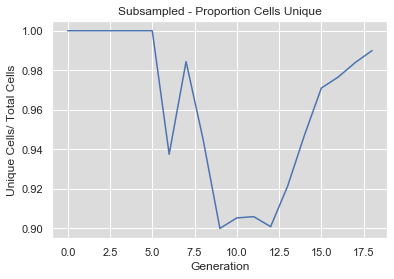

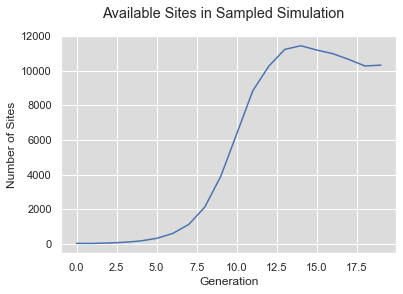

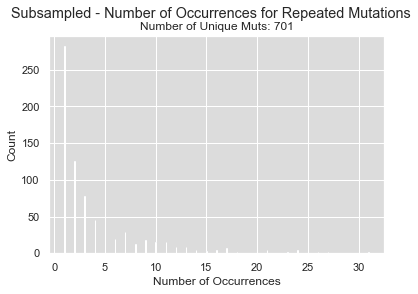

(1000, 30)
Time 1: 0.01778411865234375
Compute dictionary: 29.216719150543213
Conflict matrix is symmetric?  True
Total time: 29.25017499923706
Number of true recurrent muts:  733
Number of detected recurrent muts:  999
Number of true recurrent muts not detected: 3 with prevalence [1000, 1000, 1000]


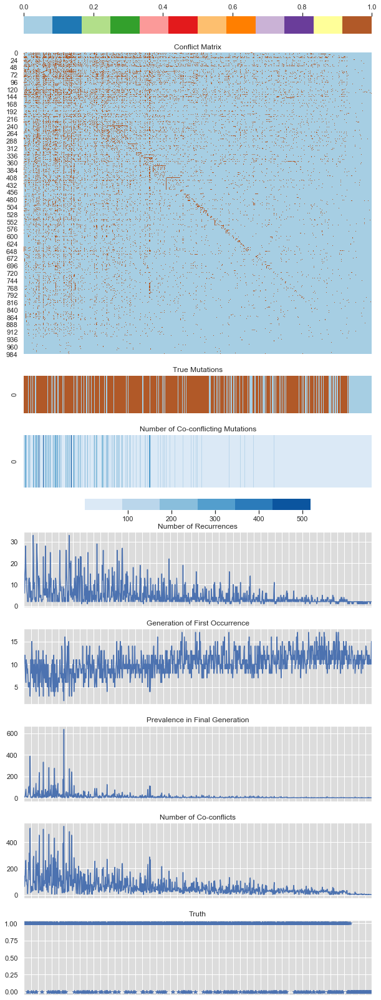

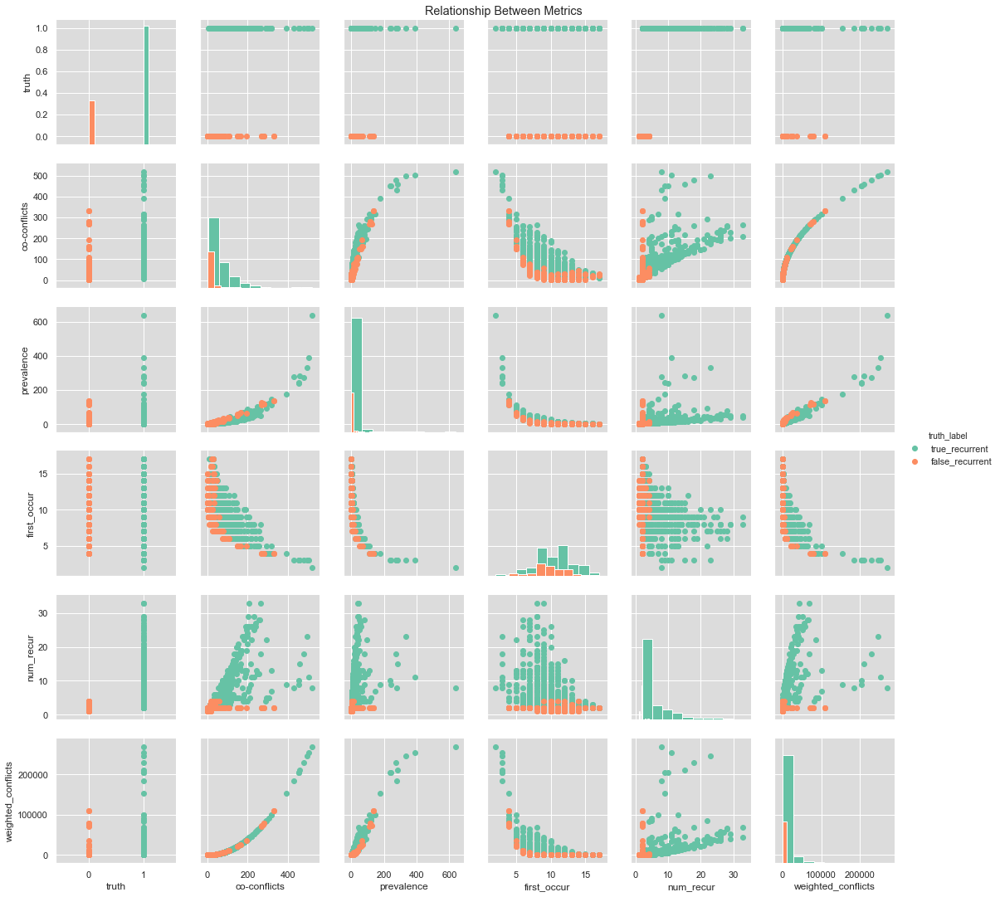

0.08186817169189453 fast?


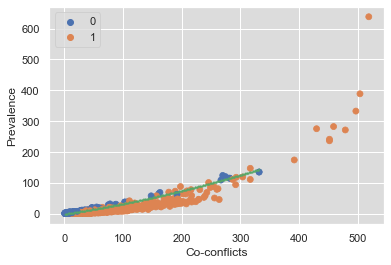

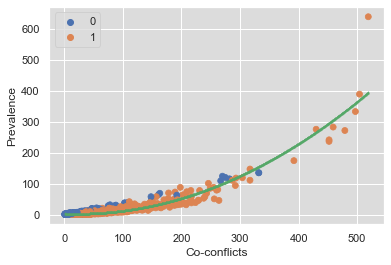

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(249,)
(438,)
(617,)
(769,)
(874,)
(934,)
(959,)
(975,)
(989,)
(995,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


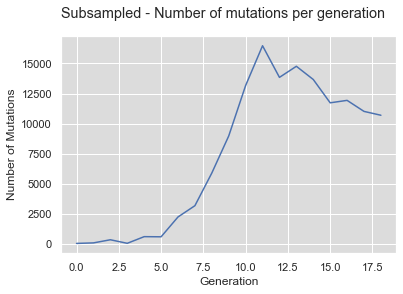

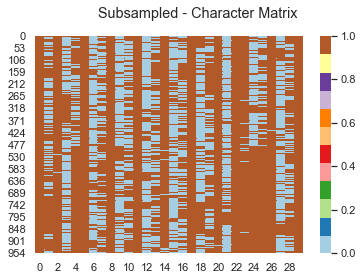

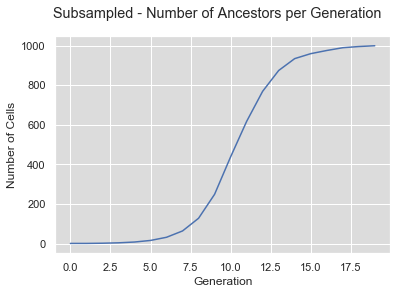

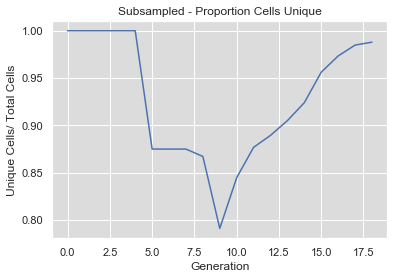

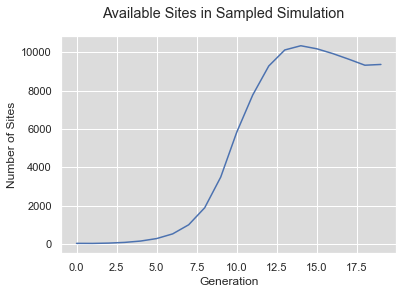

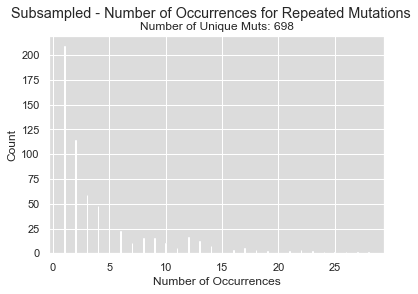

(999, 30)
Time 1: 0.016335725784301758
Compute dictionary: 25.757019758224487
Conflict matrix is symmetric?  True
Total time: 25.7824387550354
Number of true recurrent muts:  614
Number of detected recurrent muts:  855
Number of true recurrent muts not detected: 3 with prevalence [999, 999, 999]


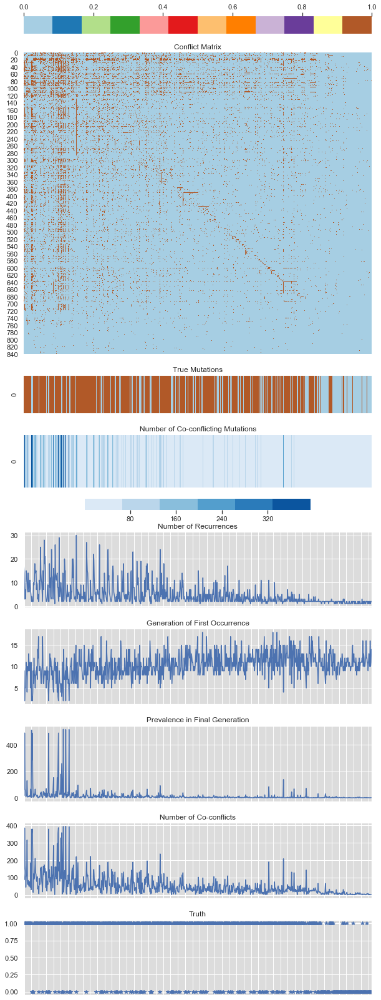

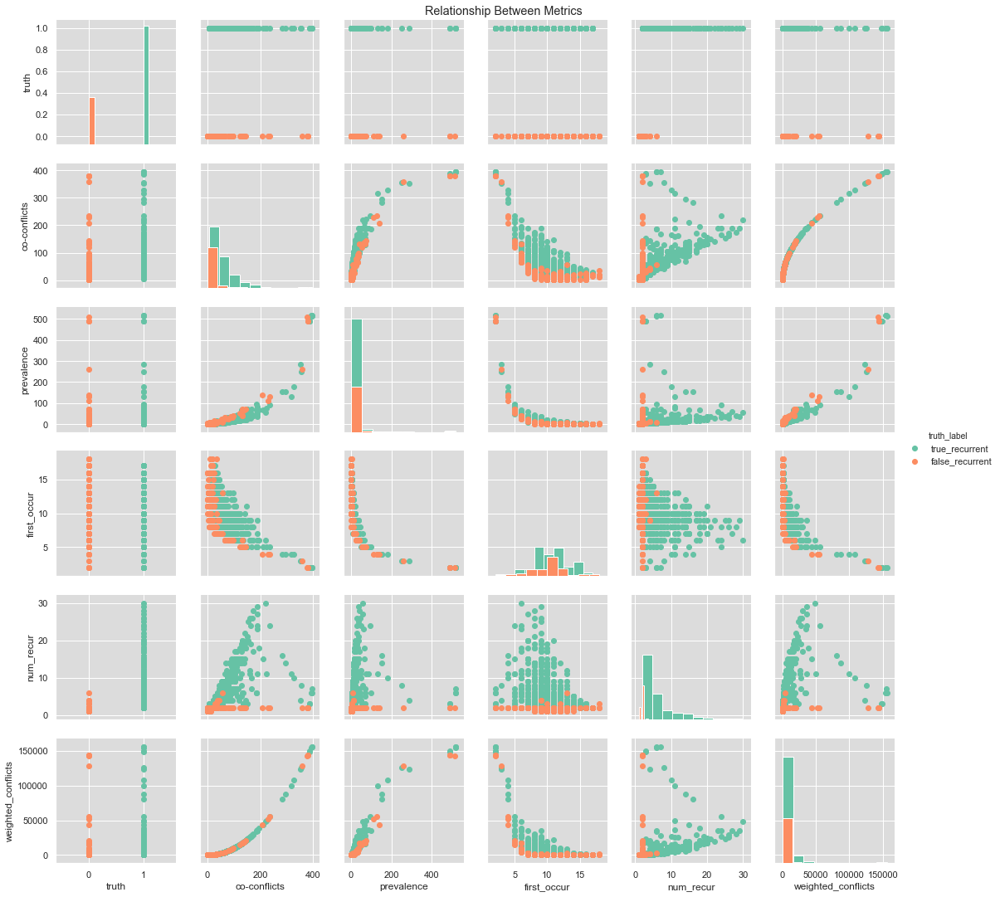

0.08285117149353027 fast?


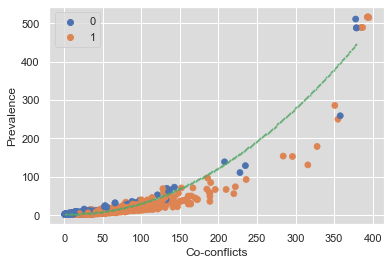

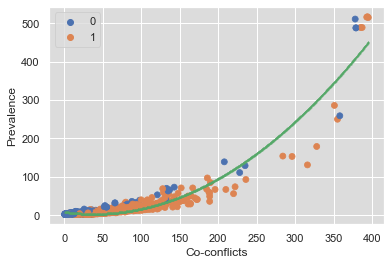

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(127,)
(249,)
(435,)
(638,)
(787,)
(880,)
(937,)
(964,)
(983,)
(993,)
(997,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


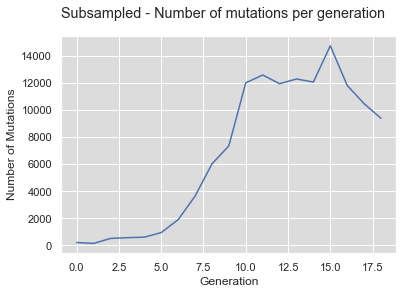

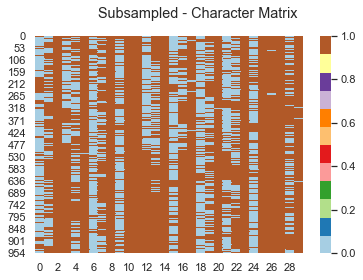

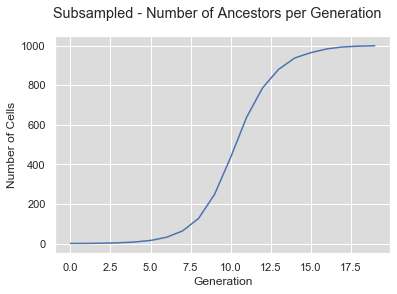

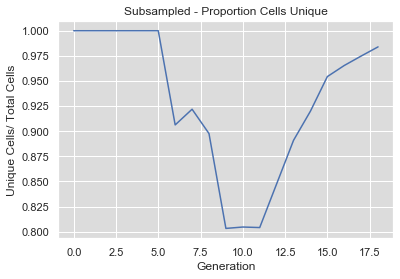

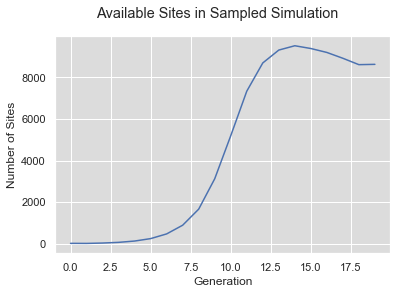

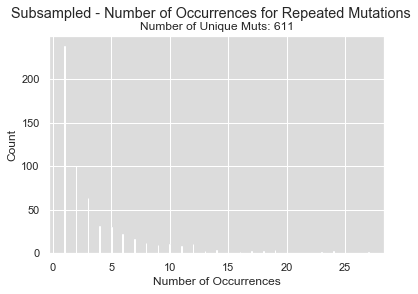

(999, 30)
Time 1: 0.013607978820800781
Compute dictionary: 25.47253727912903
Conflict matrix is symmetric?  True
Total time: 25.495833158493042
Number of true recurrent muts:  586
Number of detected recurrent muts:  814
Number of true recurrent muts not detected: 4 with prevalence [999, 999, 999, 999]


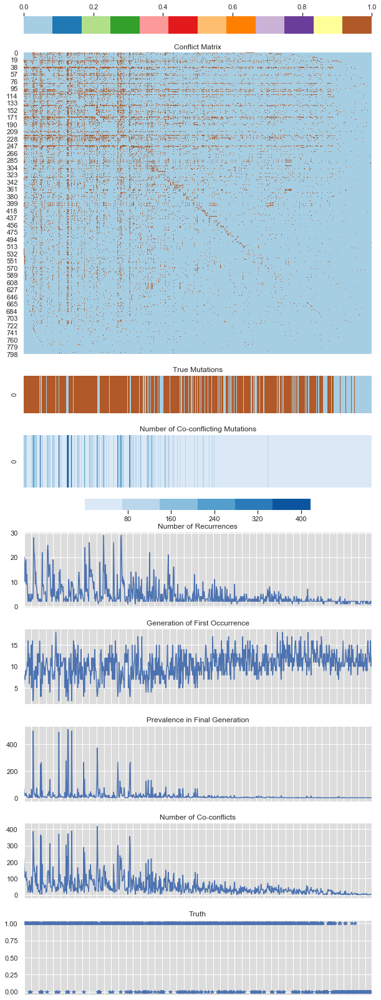

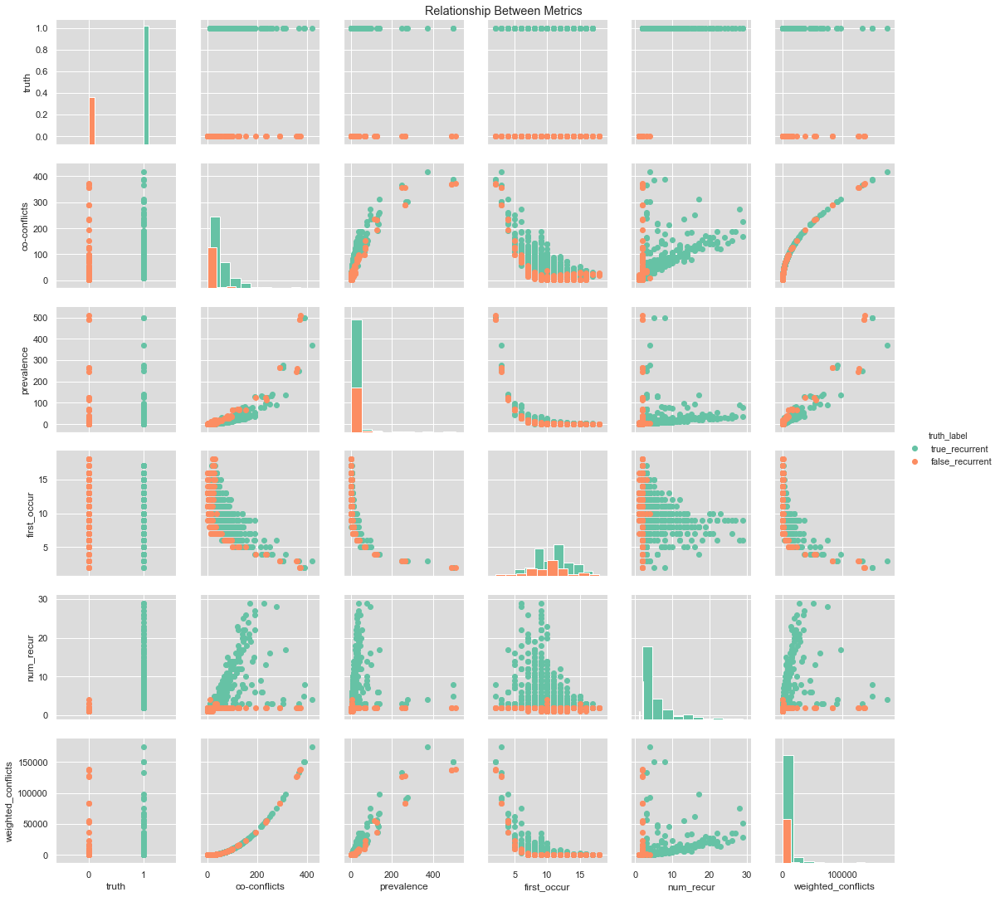

0.0846409797668457 fast?


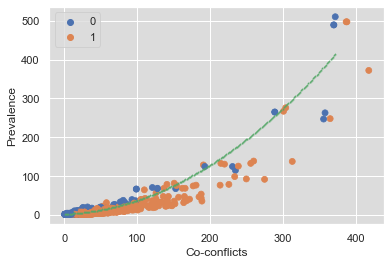

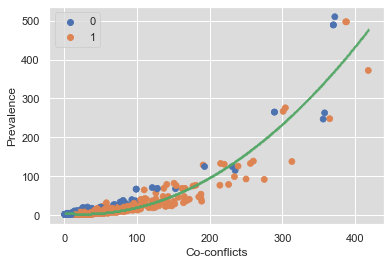

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(245,)
(417,)
(610,)
(777,)
(879,)
(927,)
(962,)
(984,)
(993,)
(998,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


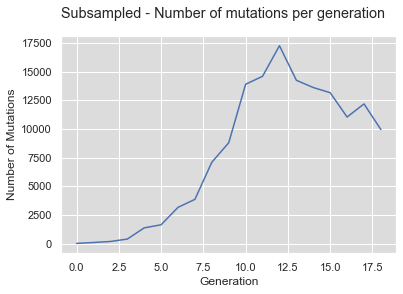

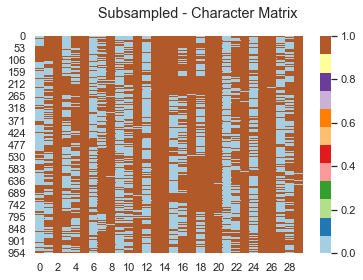

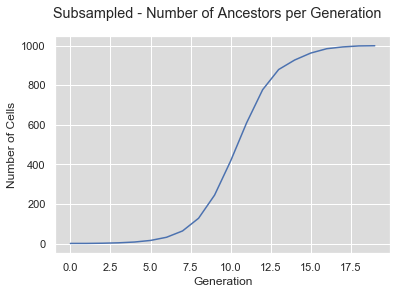

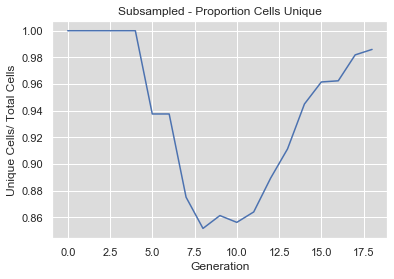

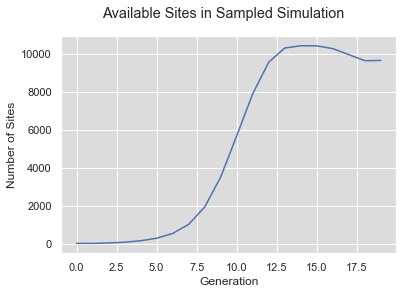

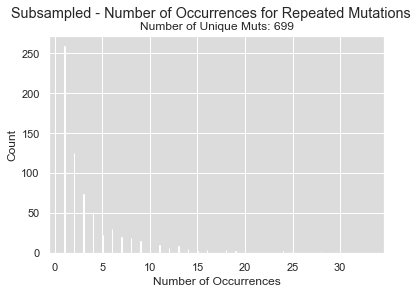

(999, 30)
Time 1: 0.016386032104492188
Compute dictionary: 29.133672952651978
Conflict matrix is symmetric?  True
Total time: 29.166334867477417
Number of true recurrent muts:  689
Number of detected recurrent muts:  933
Number of true recurrent muts not detected: 2 with prevalence [999, 999]


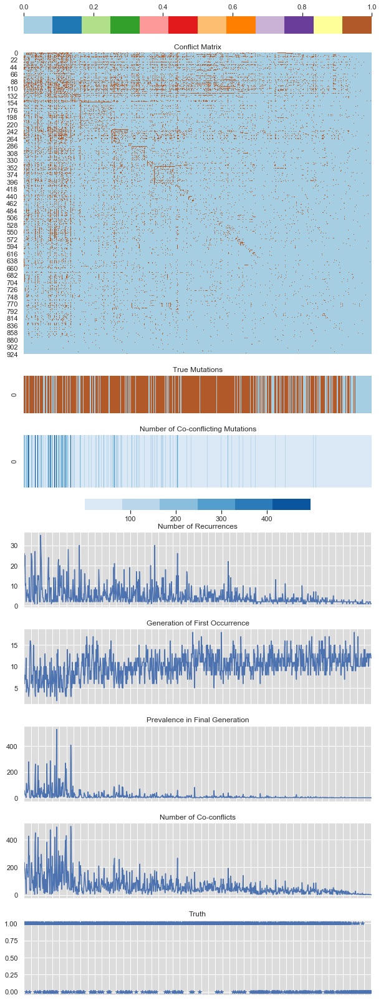

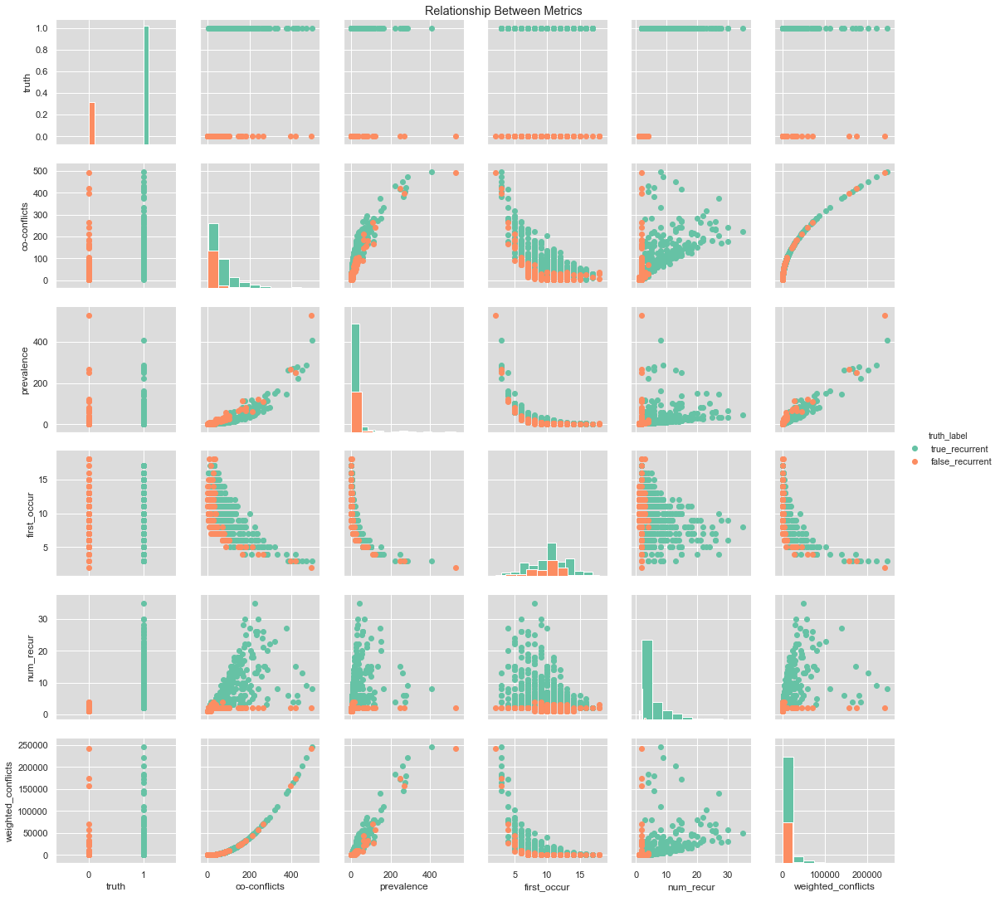

0.08210110664367676 fast?


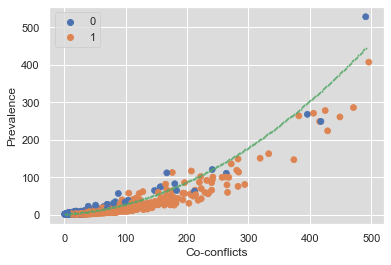

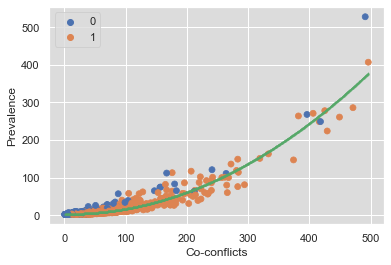

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(436,)
(621,)
(783,)
(887,)
(943,)
(963,)
(976,)
(985,)
(991,)
(997,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


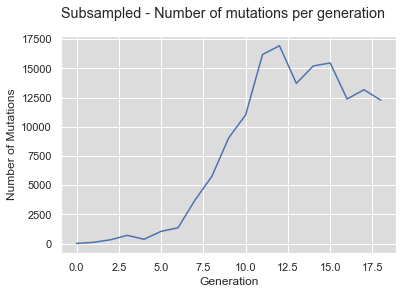

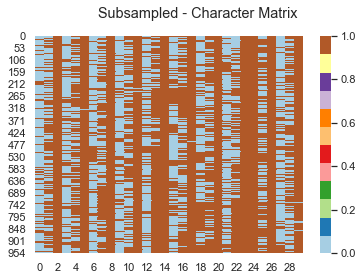

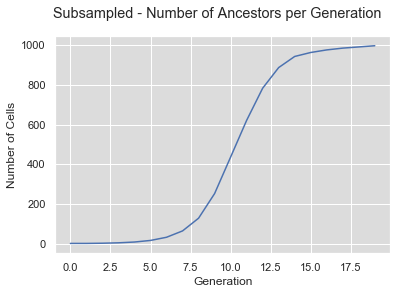

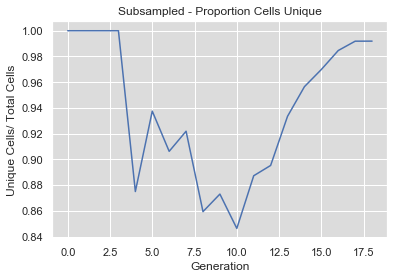

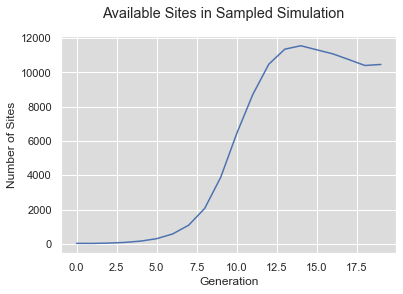

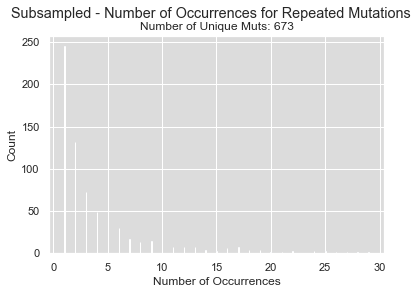

(997, 30)
Time 1: 0.0168609619140625
Compute dictionary: 28.993881940841675
Conflict matrix is symmetric?  True
Total time: 29.024462938308716
Number of true recurrent muts:  679
Number of detected recurrent muts:  930
Number of true recurrent muts not detected: 2 with prevalence [997, 997]


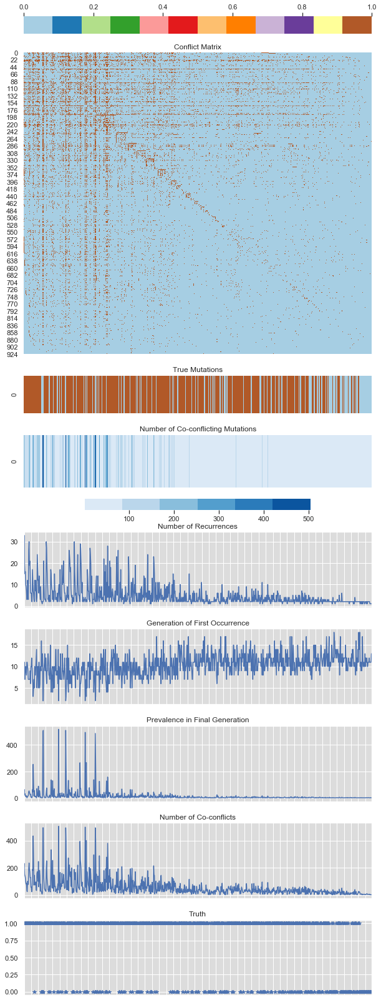

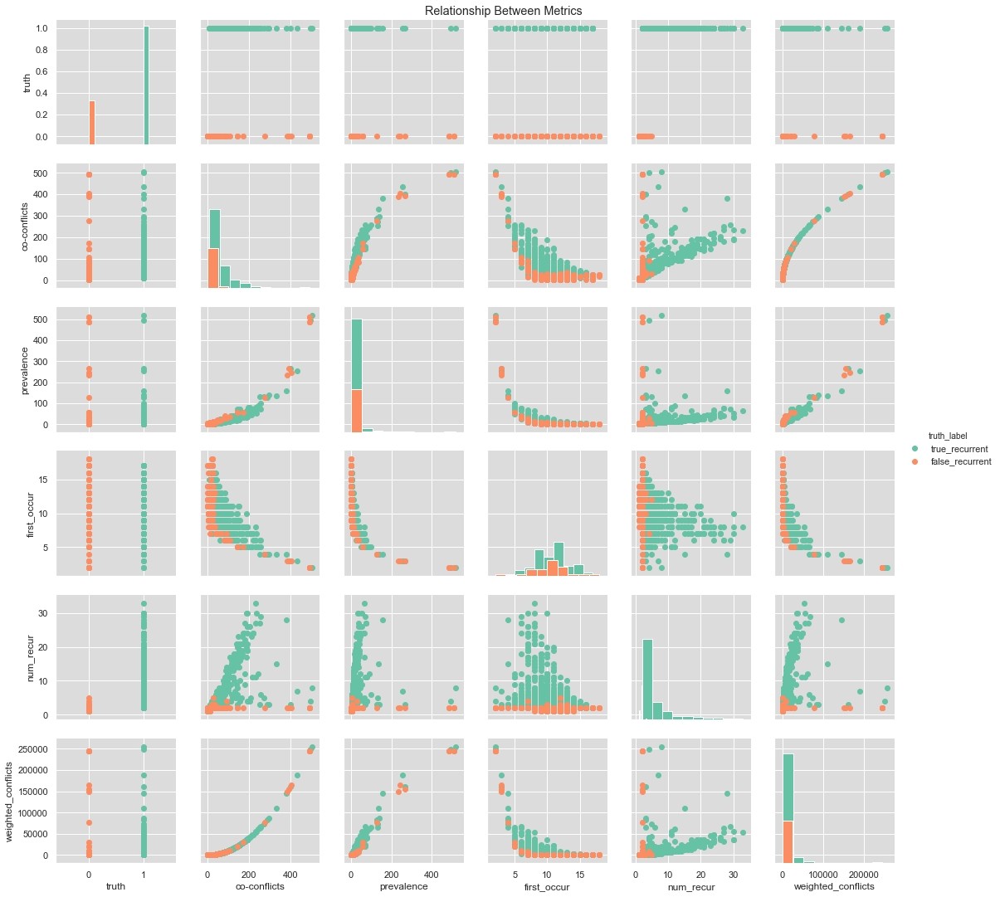

0.08275103569030762 fast?


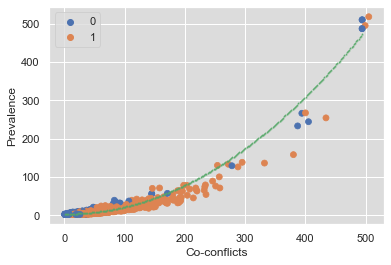

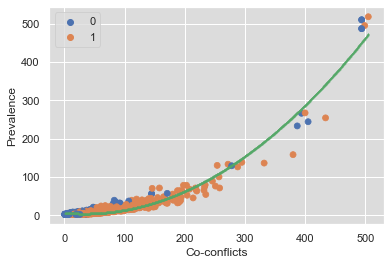

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(252,)
(445,)
(649,)
(793,)
(895,)
(947,)
(972,)
(985,)
(998,)
(999,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


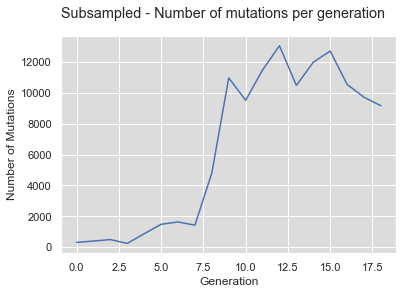

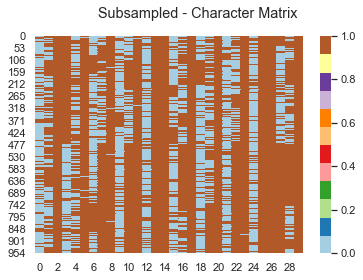

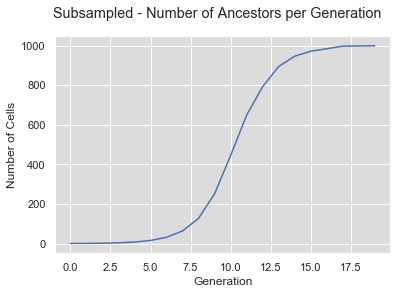

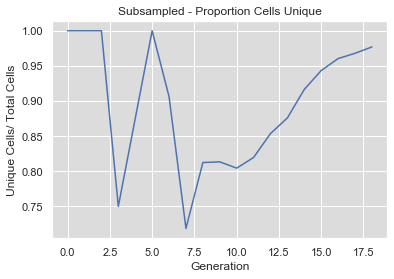

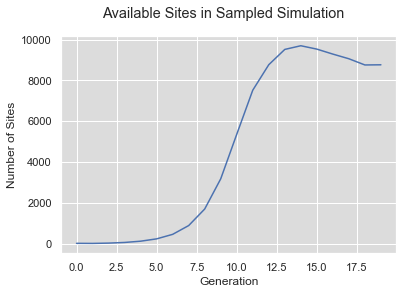

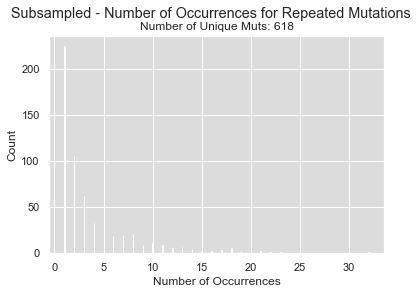

(1000, 30)
Time 1: 0.013810873031616211
Compute dictionary: 26.167311191558838
Conflict matrix is symmetric?  True
Total time: 26.186936140060425
Number of true recurrent muts:  582
Number of detected recurrent muts:  782
Number of true recurrent muts not detected: 4 with prevalence [1000, 1000, 1000, 1000]


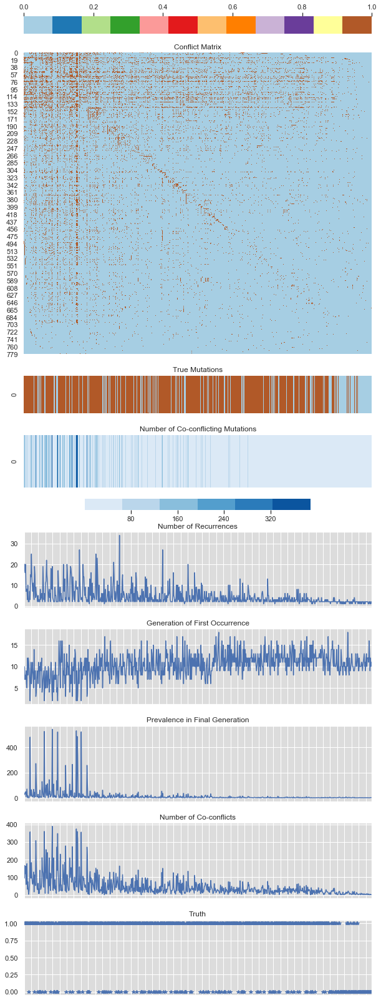

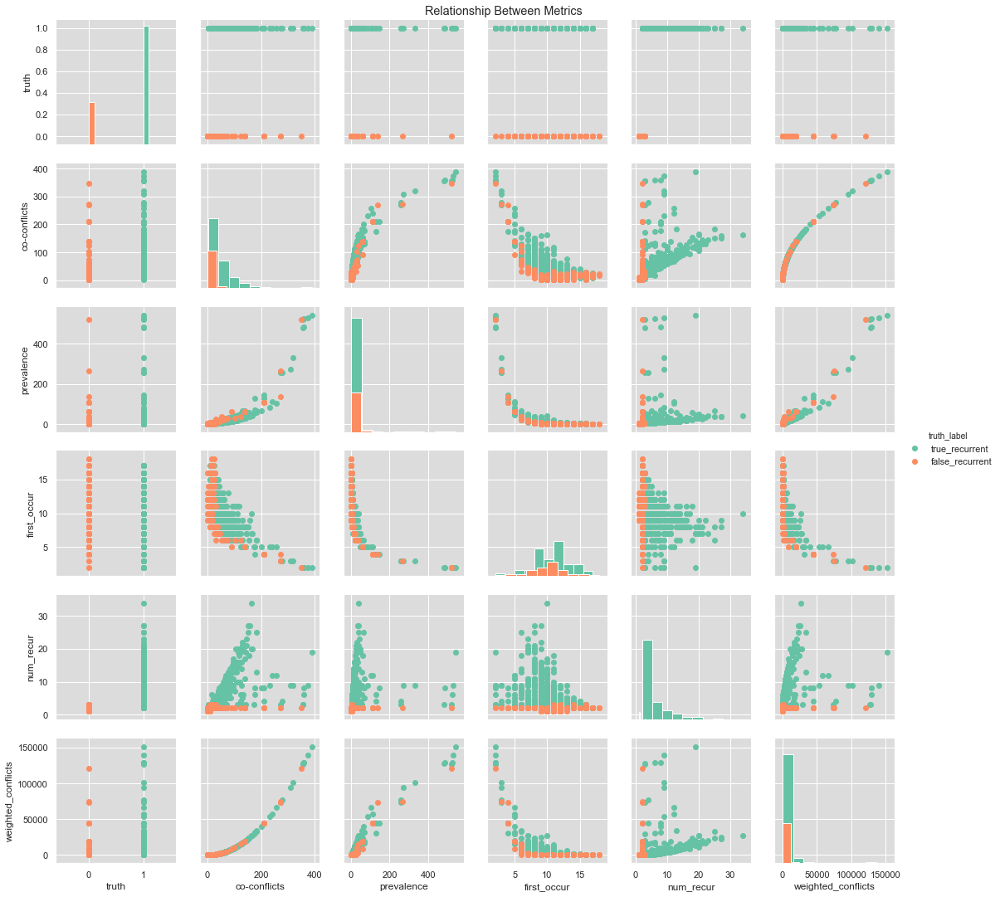

0.08415007591247559 fast?


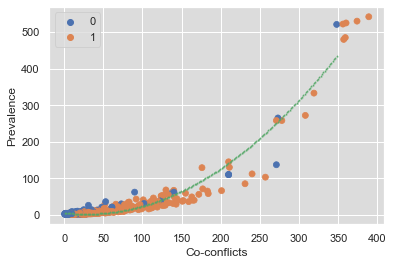

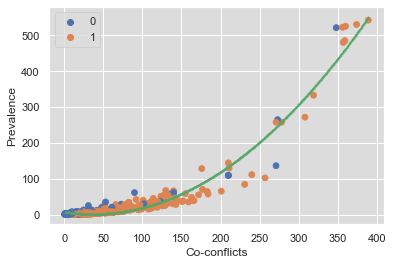

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(250,)
(436,)
(654,)
(820,)
(900,)
(953,)
(972,)
(989,)
(995,)
(997,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


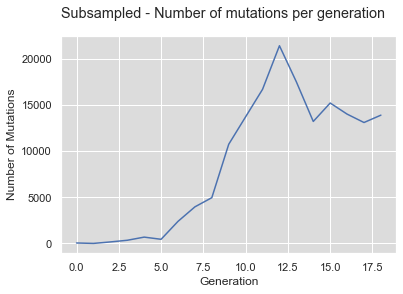

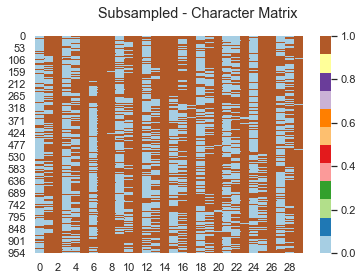

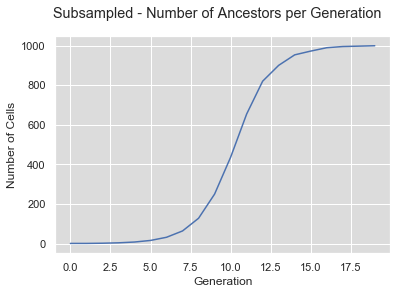

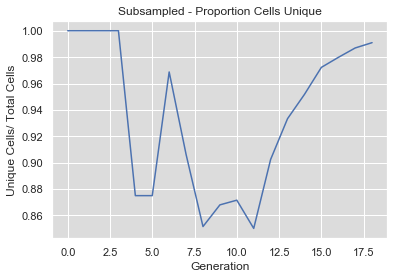

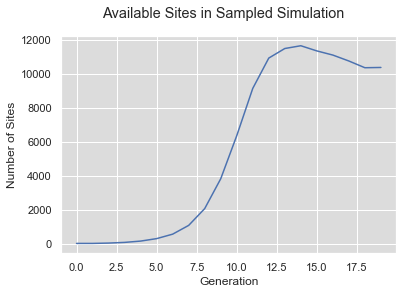

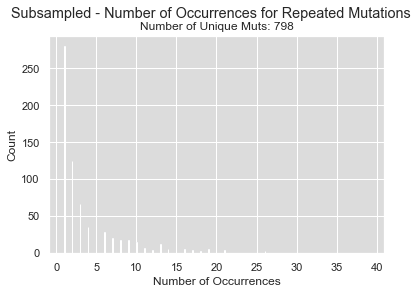

(999, 30)
Time 1: 0.018159866333007812
Compute dictionary: 27.380188941955566
Conflict matrix is symmetric?  True
Total time: 27.41121506690979
Number of true recurrent muts:  719
Number of detected recurrent muts:  950
Number of true recurrent muts not detected: 5 with prevalence [999, 999, 999, 999, 999]


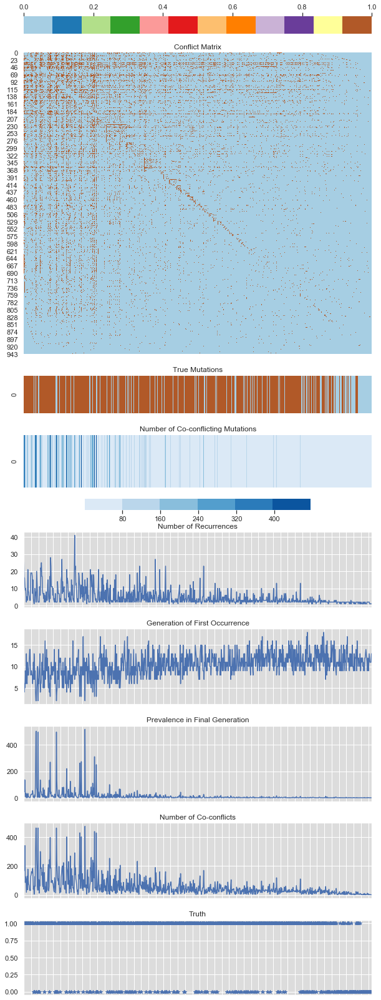

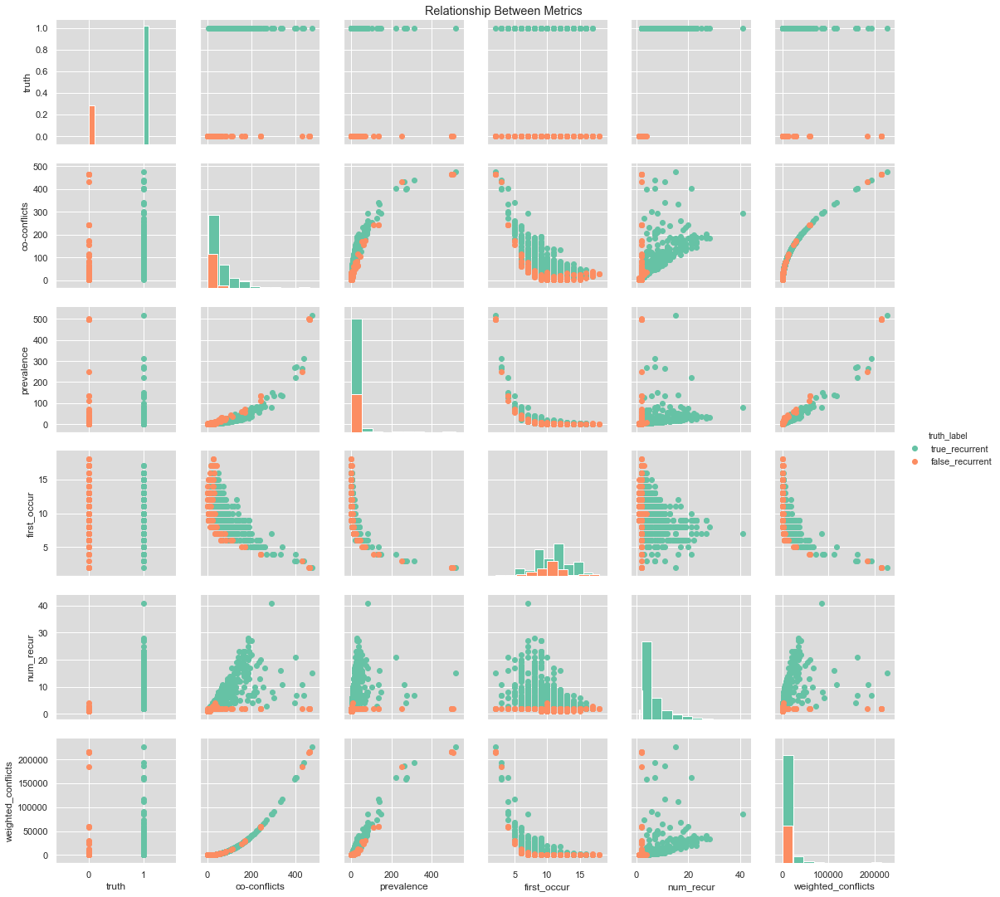

0.08607888221740723 fast?


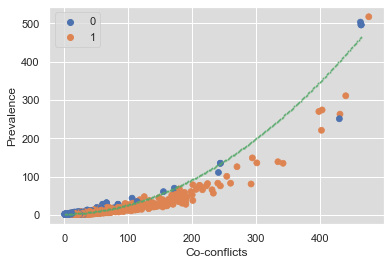

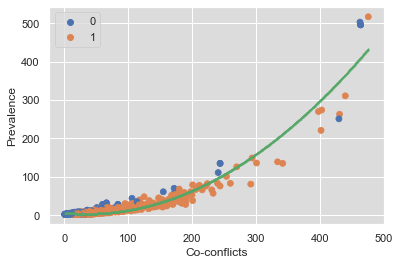

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(251,)
(443,)
(643,)
(800,)
(889,)
(940,)
(966,)
(987,)
(994,)
(998,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


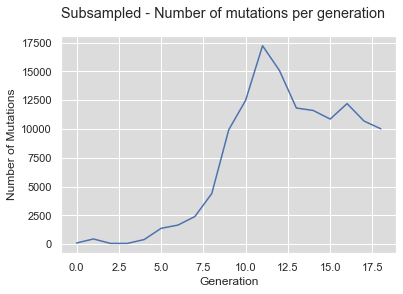

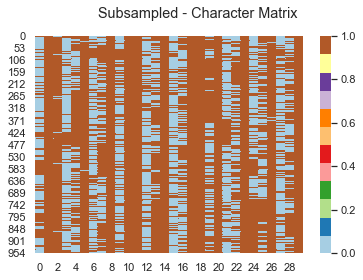

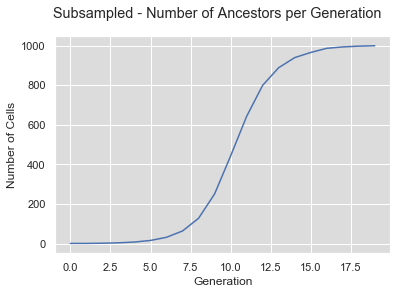

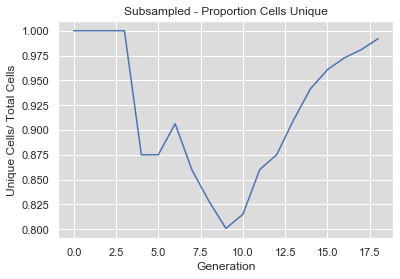

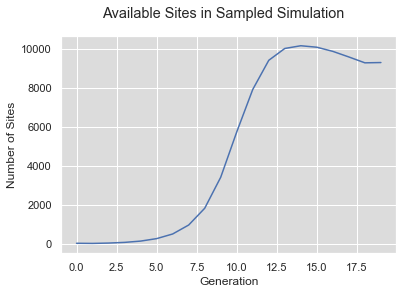

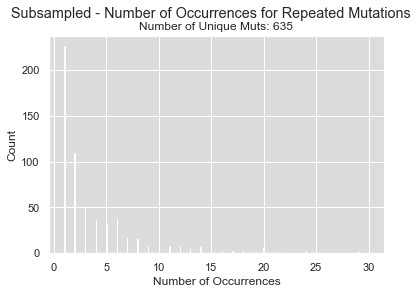

(1000, 30)
Time 1: 0.013415098190307617
Compute dictionary: 24.49067711830139
Conflict matrix is symmetric?  True
Total time: 24.51144313812256
Number of true recurrent muts:  604
Number of detected recurrent muts:  791
Number of true recurrent muts not detected: 2 with prevalence [1000, 1000]


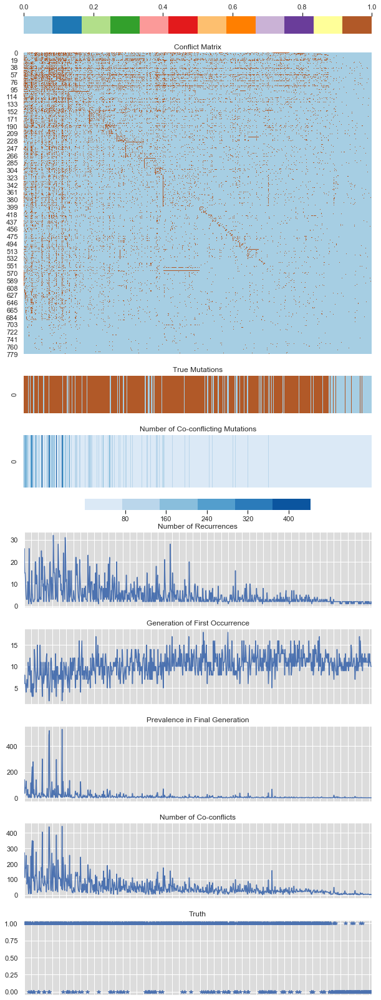

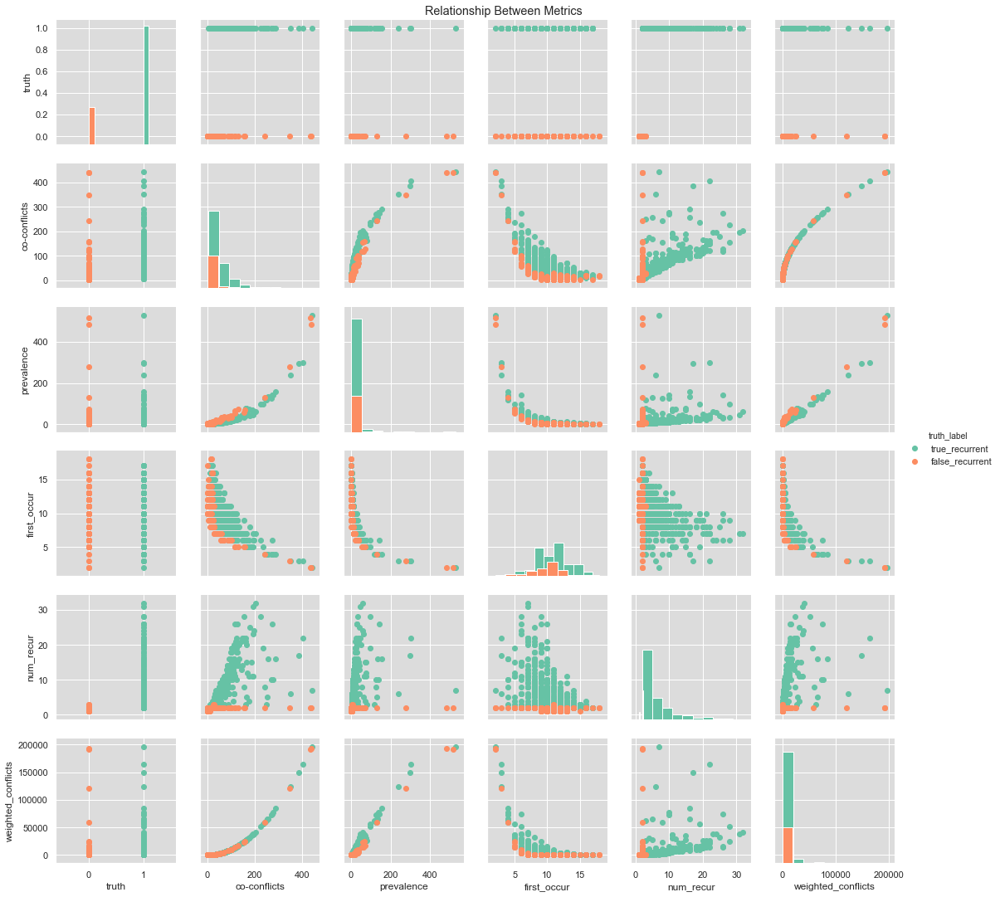

0.08273792266845703 fast?


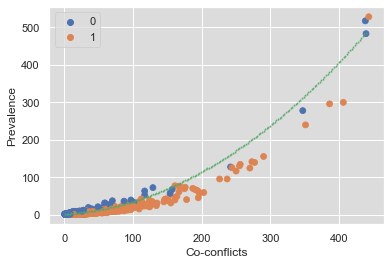

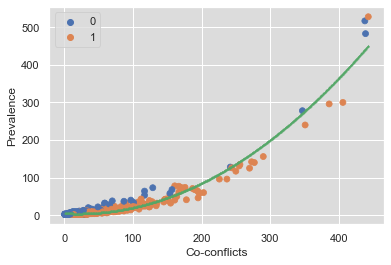

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(251,)
(444,)
(640,)
(795,)
(884,)
(942,)
(971,)
(986,)
(991,)
(995,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


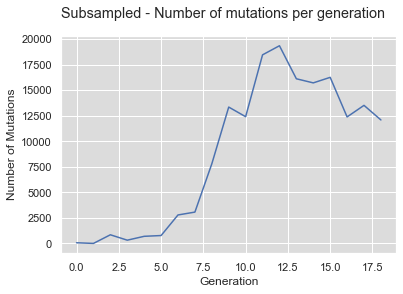

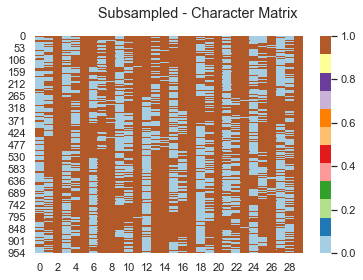

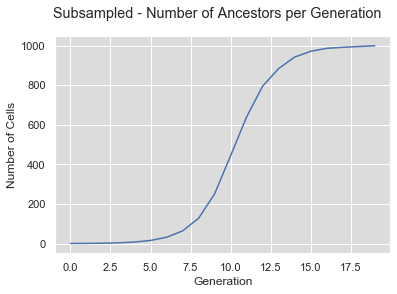

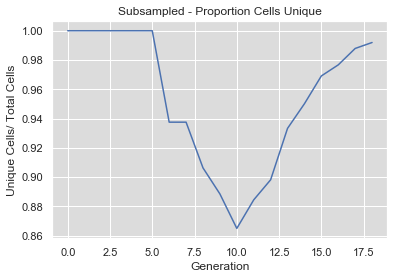

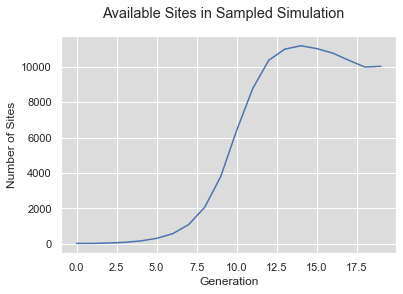

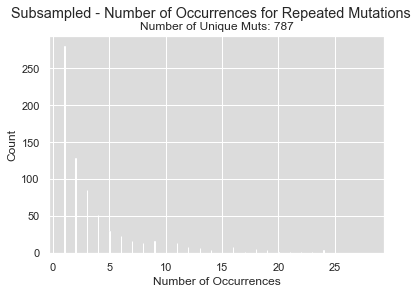

(999, 30)
Time 1: 0.019077062606811523
Compute dictionary: 30.91043710708618
Conflict matrix is symmetric?  True
Total time: 30.95171284675598
Number of true recurrent muts:  736
Number of detected recurrent muts:  1023
Number of true recurrent muts not detected: 1 with prevalence [999]


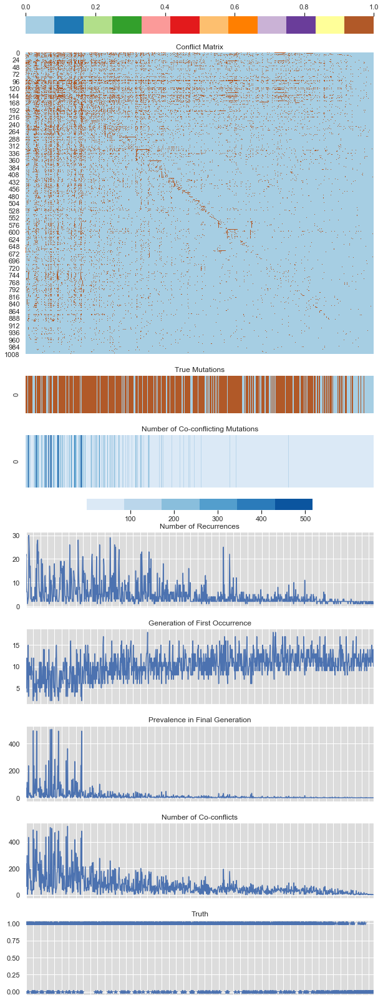

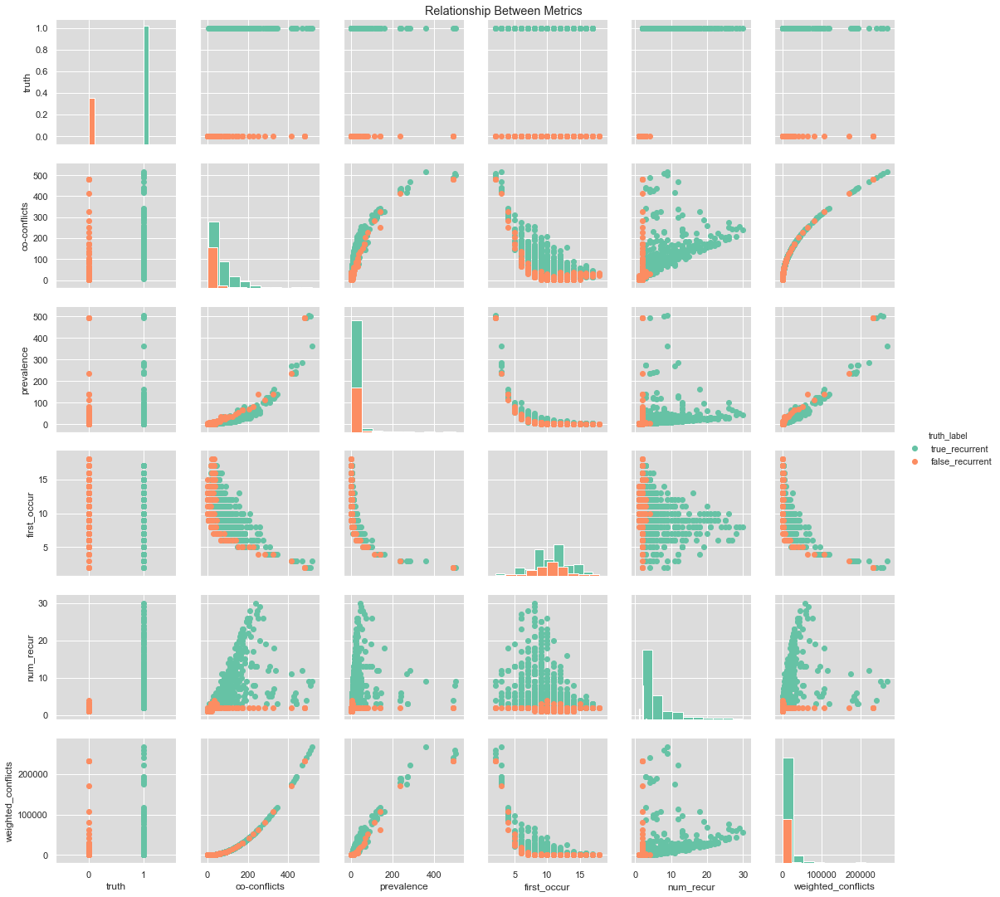

0.0797128677368164 fast?


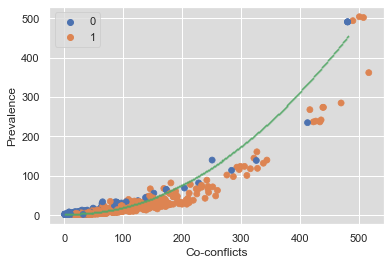

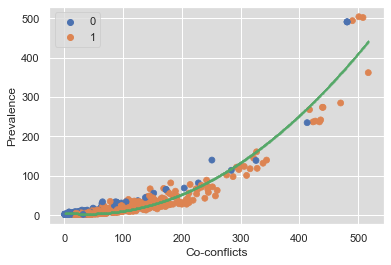

Label: sff
List of targets:  [(0, 0), (0, 1), (0, 2), (1, 0), (1, 1), (1, 2), (2, 0), (2, 1), (2, 2), (3, 0), (3, 1), (3, 2), (4, 0), (4, 1), (4, 2), (5, 0), (5, 1), (5, 2), (6, 0), (6, 1), (6, 2), (7, 0), (7, 1), (7, 2), (8, 0), (8, 1), (8, 2), (9, 0), (9, 1), (9, 2)]
ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(251,)
(441,)
(638,)
(789,)
(883,)
(941,)
(969,)
(988,)
(993,)
(999,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


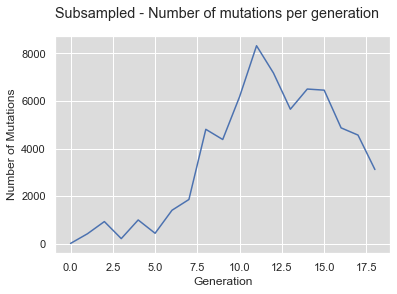

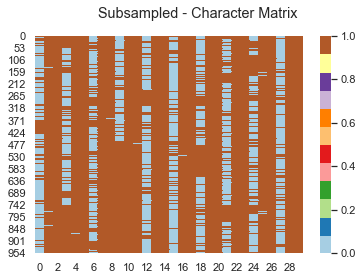

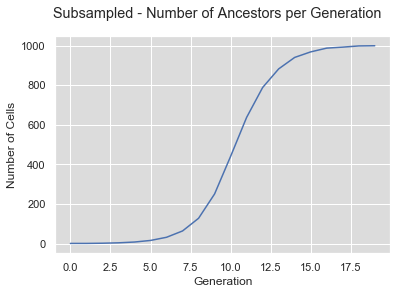

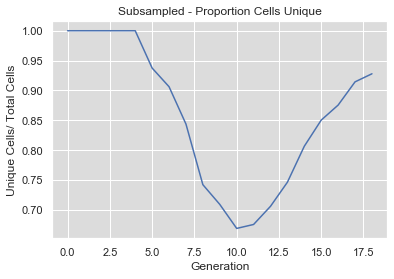

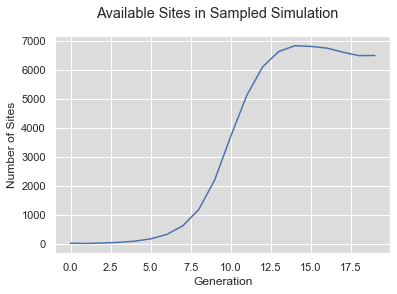

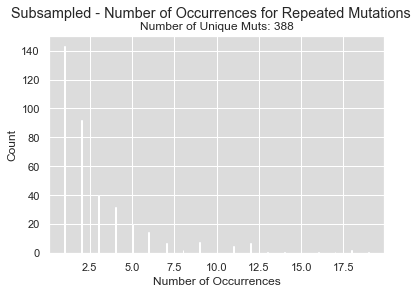

(1000, 30)
Time 1: 0.009860992431640625
Compute dictionary: 19.281584978103638
Conflict matrix is symmetric?  True
Total time: 19.2921199798584
Number of true recurrent muts:  384
Number of detected recurrent muts:  563
Number of true recurrent muts not detected: 3 with prevalence [1000, 1000, 1000]


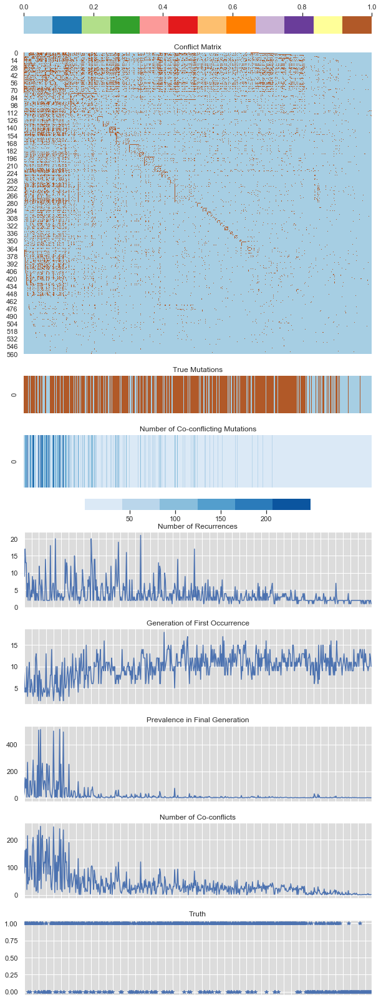

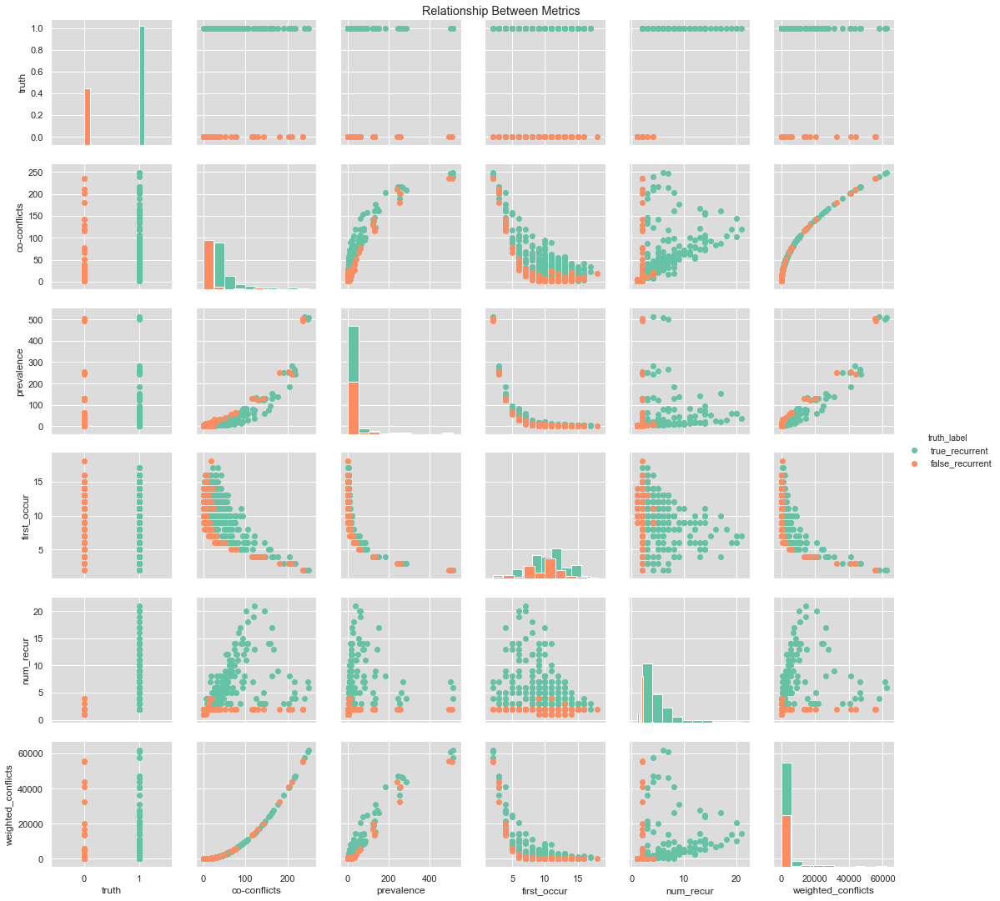

0.0797581672668457 fast?


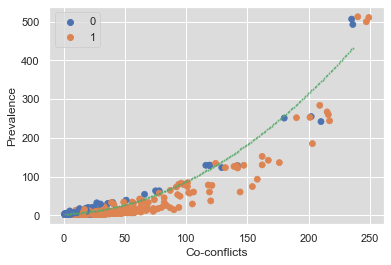

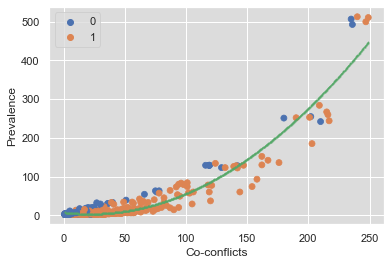

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(250,)
(445,)
(655,)
(800,)
(893,)
(942,)
(970,)
(986,)
(993,)
(998,)
(1000,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


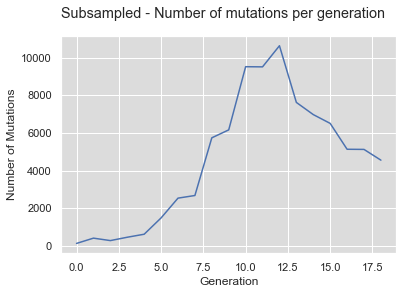

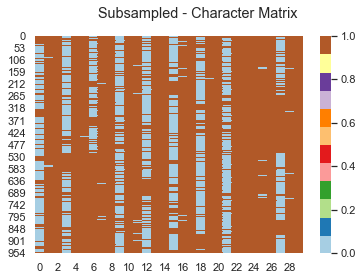

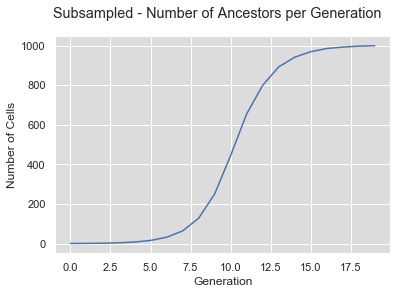

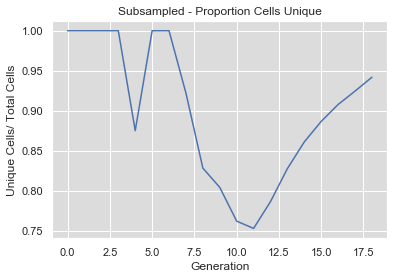

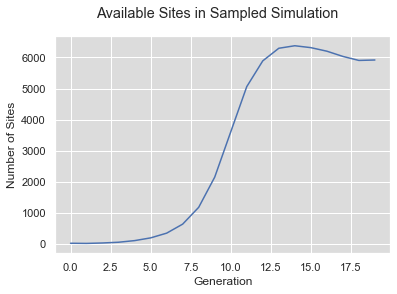

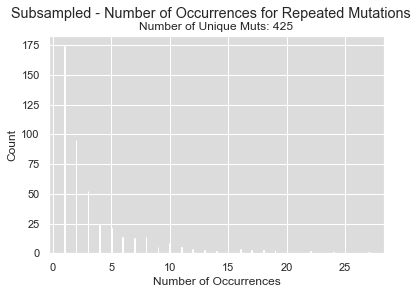

(1000, 30)
Time 1: 0.011874914169311523
Compute dictionary: 19612.14418697357
Conflict matrix is symmetric?  True
Total time: 19612.16051697731
Number of true recurrent muts:  456
Number of detected recurrent muts:  647
Number of true recurrent muts not detected: 3 with prevalence [1000, 1000, 1000]


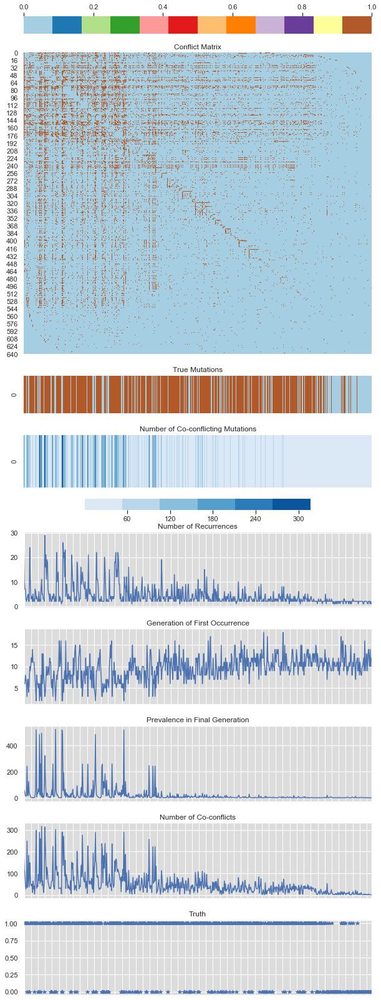

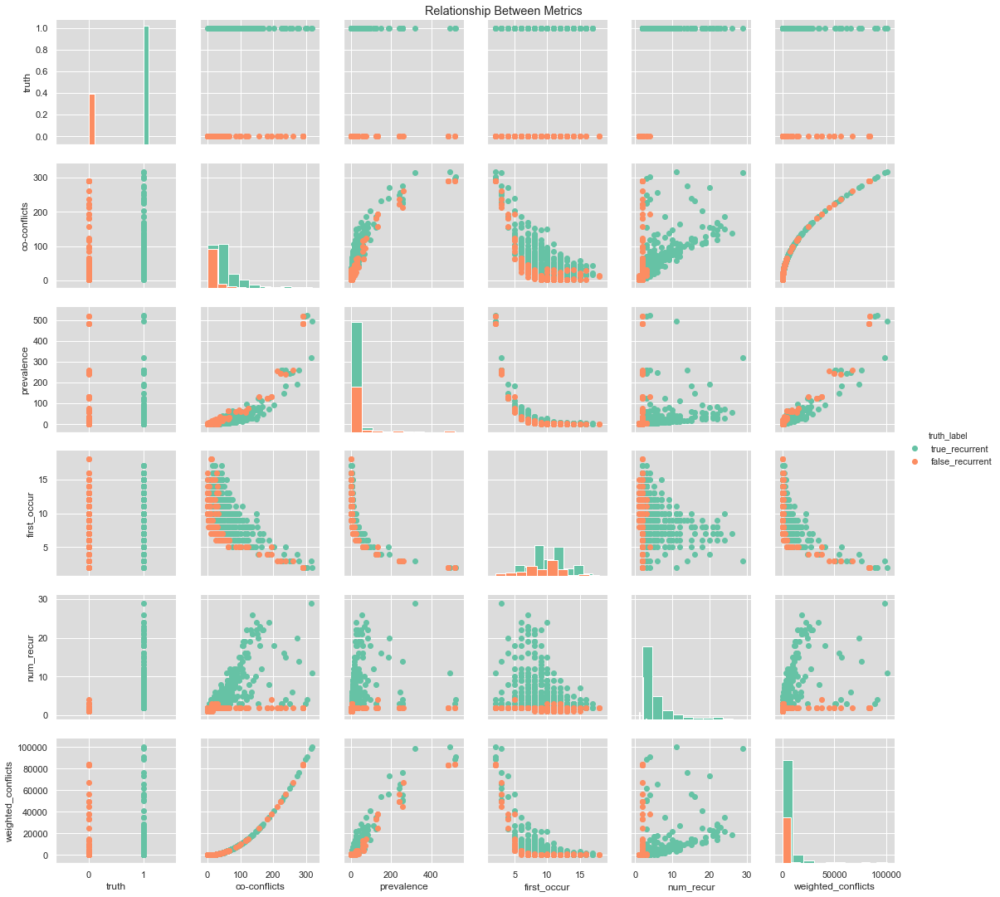

0.08607697486877441 fast?


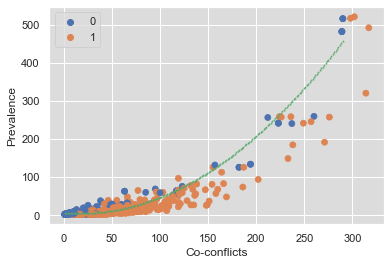

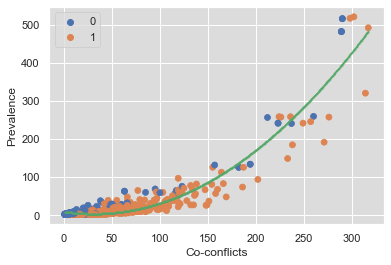

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(253,)
(443,)
(642,)
(800,)
(889,)
(941,)
(969,)
(988,)
(996,)
(997,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


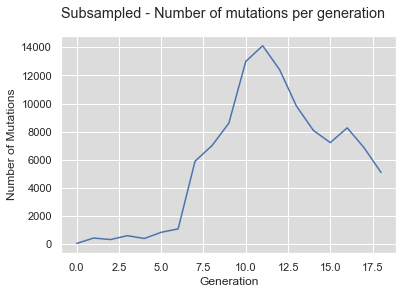

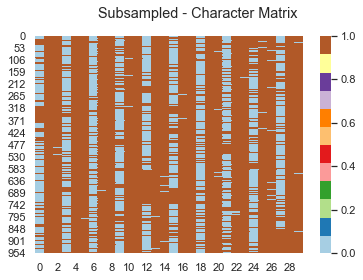

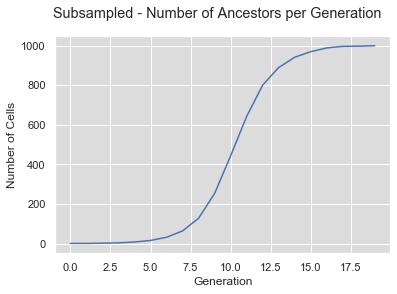

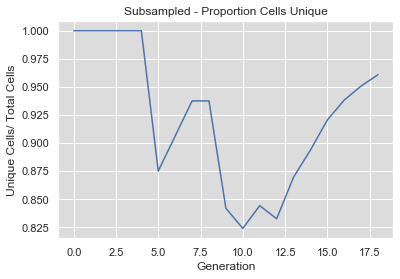

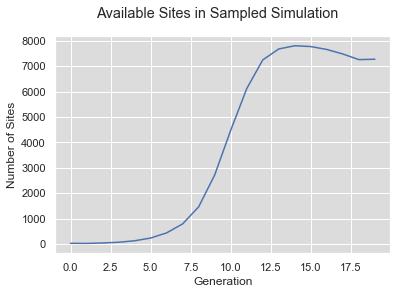

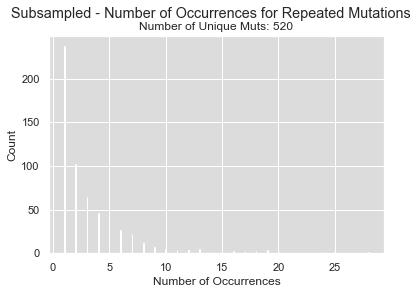

(999, 30)
Time 1: 0.013562917709350586
Compute dictionary: 22.172199010849
Conflict matrix is symmetric?  True
Total time: 22.194447994232178
Number of true recurrent muts:  587
Number of detected recurrent muts:  796
Number of true recurrent muts not detected: 3 with prevalence [999, 999, 999]


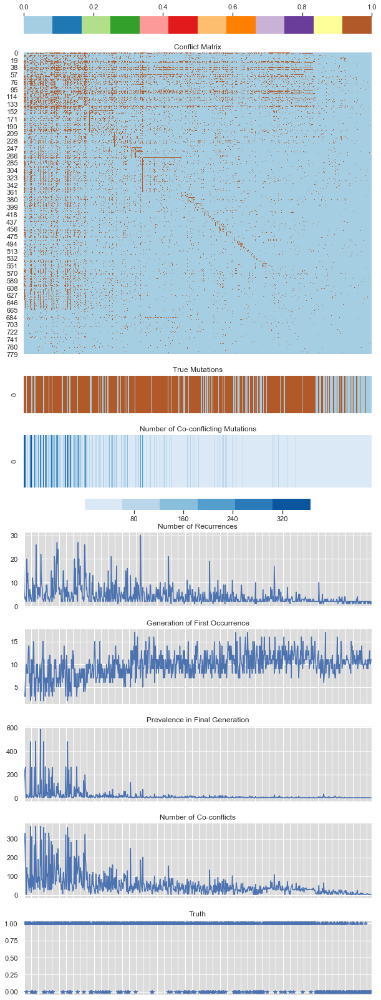

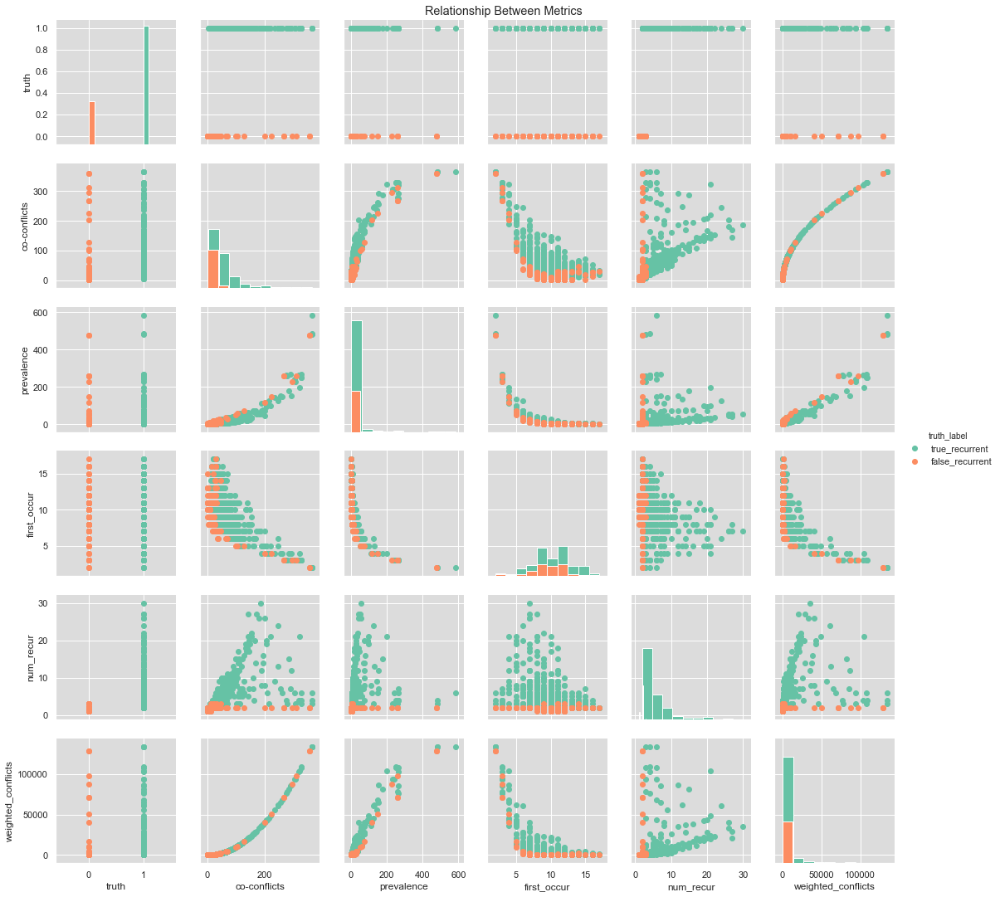

0.08232402801513672 fast?


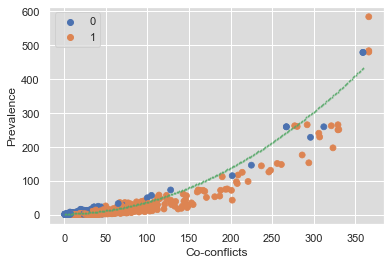

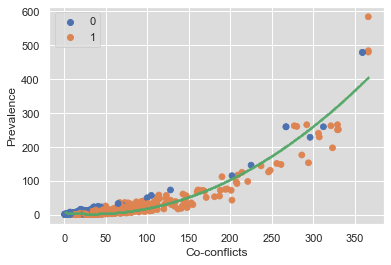

ix per gen
(1,)
(2,)
(4,)
(8,)
(16,)
(32,)
(64,)
(128,)
(251,)
(438,)
(634,)
(797,)
(899,)
(949,)
(977,)
(988,)
(994,)
(998,)
(999,)
(1000,)
Generation: 0
Generation: 1
Generation: 2
Generation: 3
Generation: 4
Generation: 5
Generation: 6
Generation: 7
Generation: 8
Generation: 9
Generation: 10
Generation: 11
Generation: 12
Generation: 13
Generation: 14
Generation: 15
Generation: 16
Generation: 17
Generation: 18


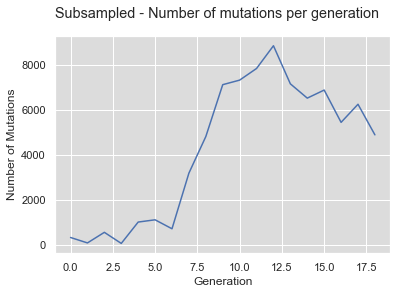

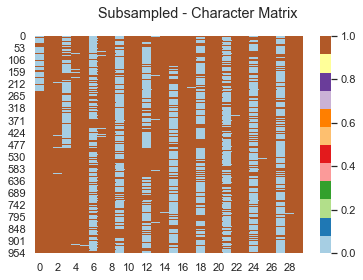

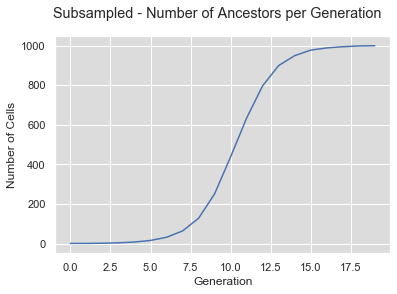

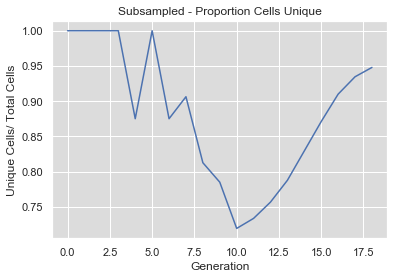

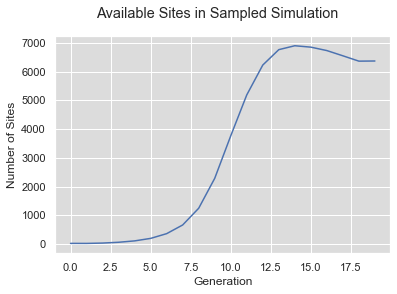

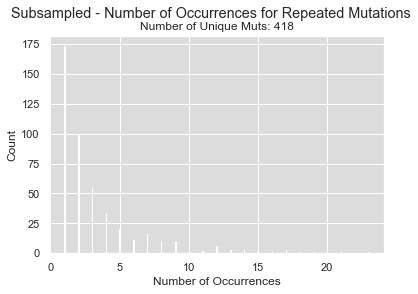

(999, 30)
Time 1: 0.010882854461669922


In [ ]:
simulation_list = []

for i, list_of_guides in enumerate(lists_of_guides):
    label = labels[i]
    print('Label:', label)

    # Each array has 3-6 targets, we insert ~10 arrays. This gives us 30-60 sites
    site_ix = 0
    target_distributions = {}
    speed = {}
    for guide in list_of_guides:
        dist = indel_distributions[guide]
        try:
            del dist['']
        except KeyError:
            pass
        distvals = np.array(sorted(list(dist.values()), reverse=True))
        distvals = distvals/distvals.sum()
        target_distributions[site_ix] = distvals
        if guide in slow_guides:
            speed[site_ix] = 'slow'
        elif guide in medium_guides:
            speed[site_ix] = 'medium'
        else:
            speed[site_ix] = 'fast'

        site_ix += 1

    num_targets = site_ix 
    num_edit_sites = num_targets * num_arrays

    import itertools
    targets = list(itertools.product(np.arange(num_arrays), np.arange(num_targets)))
    print('List of targets: ', targets)

    deletions = []
    mutation_probs = []
    for array, target in targets:
        deletions.append(target_distributions[target])
        mutation_probs.append(rate[speed[target]])
    
    deletions_probs = pd.DataFrame(deletions)
    deletions_probs = torch.DoubleTensor(deletions_probs.fillna(0.0).values)
    
    # Each edit site has a different mutation probability 
    mutation_probs= np.array(mutation_probs)

    
    for init_cells in [1, 10, 100, 1000]:
        for run in range(num_runs):
            simulation = lineageSimulationFast(label, tree_depth, 
                                           num_edit_sites, deletions_probs, 
                                           mutation_probs, init_cells=1, n_subsample=1000)



            print(simulation.subsample_time, 'fast?')

            try:
                # Summarize results
                # Plot a regression for the non-recurrent mutations
                X = simulation.conflict_matrix.sum(0)
                Y = simulation.prevalence_tape
                ix = np.array(simulation.truth_tape)==0

        #         from sklearn.linear_model import LinearRegression
        #         reg = LinearRegression().fit(X[ix].reshape(-1,1), Y[ix].reshape(-1,1))

                x = X[ix]
                y = Y[ix]

                new_x = np.linspace(min(x), max(x), num=np.size(x))
                coefs = np.polyfit(x,y,2)
                new_line = np.polyval(coefs, new_x)

                plt.figure()
                sns.scatterplot(X, Y, hue=simulation.truth_tape, 
                                cmap='Paired', edgecolor=None,)

                plt.scatter(new_x,new_line,c='g', marker='^', s=1)
                plt.xlabel('Co-conflicts')
                plt.ylabel('Prevalence')
                plt.show()
                plt.close()

                simulation.random_attr['coef'] = coefs


                simulation.random_attr['num_conflict'] = simulation.conflict_matrix.shape[0]

                x = X
                y = Y

                new_x = np.linspace(min(x), max(x), num=np.size(x))
                coefs = np.polyfit(x,y,2)
                new_line = np.polyval(coefs, new_x)

                plt.figure()
                sns.scatterplot(X, Y, hue=simulation.truth_tape, 
                                cmap='Paired', edgecolor=None,)

                plt.scatter(new_x,new_line,c='g', marker='^', s=1)
                plt.xlabel('Co-conflicts')
                plt.ylabel('Prevalence')
                plt.show()
                plt.close()

                simulation.random_attr['full_reg_coef'] = coefs

                simulation_list.append(simulation)
            except:
                print('Recurrent mutations not identified.')


In [13]:
simulation.init_cells

1